# 导入需要的所有库

In [1]:
import torch as th
from torch.autograd import Variable
import torch.nn as nn
import torch.nn.functional as F
from collections import namedtuple
import random
from copy import deepcopy
from torch.optim import Adam
import numpy as np
import gym
from gym.spaces import Discrete, Box
# from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt

# 定义环境

In [2]:
num_packets = 100000 # 一共生成多少个包 
num_load_balancers = 4 #均衡器的数量
num_servers = 8 #服务器的数量

In [3]:
# 代表包本身
class Packet:
    def __init__(self, ip, time_received, processing_time):
        self.ip = ip
        self.time_received = time_received # 每个包只保留被服务器接收的时间
        self.processing_time = processing_time # 每个包的处理时间
        self.waiting = False
    
    def __repr__(self):
        return " @time: " + str(round(self.time_received,3))

# 代表均衡器
class LoadBalancer:
    def __init__(self, ip):
        self.ip = ip
    
    def distribute(self, server, packet):
        return server.add_packet(packet)
    
    def __repr__(self):
        return "Load Balancer: " + str(self.ip)

# 代表服务器，假设服务器用的是FCFS，并且是non-preemptive
class Server:
    def __init__(self, ip, capacity):
        self.ip = ip
        self.capacity = capacity # 服务器队列的最大限制，最大吞入量
        self.queue = [] # 服务器的请求队列
        self.time_pointer = 0 # 记录相当于服务器而言的时间刻度，服务器只能处理这个时刻之后的包
        self.processed_number = 0 # 记录当前服务器已经处理的包的数量
        self.waiting=0
    
    def reset(self):
        self.queue.clear() #清空请求队列
        self.time_pointer = 0
        self.processed_number = 0
        self.waiting = 0
        
    def add_packet(self, packet):
        if len(self.queue) <= self.capacity: # 如果没有超过最大吞入量，则可以继续加
            packet.waiting = False
            self.queue.append(packet)
            # self.queue.sort(key=lambda x: x.time_received, reverse=False)
            return True
        else:
            packet.waiting = True
            self.queue.append(packet)
            return False
                
    # 还得改
    def process(self, current_time): # 处理当前时刻之前的所有包
        if current_time < self.time_pointer or len(self.queue) == 0:
            pass
        
        while(len(self.queue) > 0 and self.queue[0].time_received + self.queue[0].processing_time <= current_time ):
            self.processed_number += 1
            # if self.queue[0].time_received > self.time_pointer:
            #     self.time_pointer = self.queue[0].time_received + self.queue[0].processing_time
            # else:

            #     self.time_pointer += self.queue[0].processing_time
            
            # if self.queue[0].time_received + self.queue[0].processing_time
            if self.queue[0].waiting == True:
                self.waiting += current_time-self.queue[0].time_received
            self.queue.pop(0)
            
    def get_processed_number(self):
        return self.processed_number
    
    def __repr__(self):
        return str(self.queue)

In [4]:
class NetworkEnv(gym.Env):
    def __init__(self, num_packets = 0, num_servers=0, num_balancers=0, collaborative=True, server_capacity=None):
        assert num_servers == len(server_capacity)
        
        self.packets = [Packet(ip=i, time_received=random.randrange(0,1), processing_time=random.gauss(0.004,0.002)) for i in range(num_packets)]
        self.packets.sort(key=lambda x: x.time_received, reverse=False)
        
        self.server_capacity = server_capacity # 记录所有server的最大的吞入量

        self.n = num_balancers # agents的数量，也就是均衡器的数量
        self.shared_reward = collaborative #是否是合作模式
        self.time = 0 # 当前的时刻
        self.agents = [LoadBalancer(i) for i in range(num_balancers)]
        self.servers = [Server(i, self.server_capacity[i]) for i in range(num_servers)]
        self.waiting_packets = []
        self.index = 0
        
    def step(self, action_n):
        info = {}
        
        # self.time += 0.004
        # 这一段时间内所有的packet都拿出来然后按照给对应的balancer
        packet=[]+self.waiting_packets
        self.waiting_packets=[]
        mini = 10
        for p in self.packets[self.index:]:
            if p.time_received < self.time:
                packet.append(p)
                self.index += 1
                mini = min(p.processing_time, mini)
            else:
                break

        self.time += min(mini,0.004) #环境时间每次加处理最短的时间
        packet.sort(key=lambda x: x.time_received, reverse=False)        
        # 把包按照他们的ip平均分配给均衡器，再由均衡器按照他们的action跟配给对应的server
        for p in packet:
            lb_id = p.ip % self.n
            self.agents[lb_id].distribute(self.servers[action_n[lb_id]], p)
            # if bol == False:
            #     self.waiting_packets.append(p) #没有分配成功的包进入等待 （还有个想法：给每个包一个bol，分配成功TRUE，分配失败FALSE，之后只计算等待的包的时间，现在是计算所有包的等待时间）
                # print(len(self.waiting_packets))
            
        # 让每个server进行process
        for s in self.servers:
            s.process(self.time)
            
        done = (self.time >= self.packets[-1].time_received)
        
        temp = []
        for s in self.servers:
            temp.append(len(s.queue))
            temp.append(s.time_pointer)
            #temp.append(s.get_processed_number())
        obs = [temp] * self.n
        
        reward = []
        if done:
            reward = [-sum([s.waiting  for s in self.servers])/len(self.servers)] * self.n
            # reward = [len(self.waiting_packets)]* self.n
        else:
            reward = [0] * self.n
        
        
        return obs, reward, done, info
    
    def reset(self):
        self.packets = [Packet(ip=i, time_received=random.randrange(0,10), processing_time=random.gauss(0.004,0.002)) for i in range(num_packets)]
        self.packets.sort(key=lambda x: x.time_received, reverse=False)
        self.time = 0 # 当前的时刻
        self.index = 0
        # self.agents = [LoadBalancer(i) for i in range(self.n)]
        # self.servers = [s.reset() for s in self.servers]
        temp = []
        for s in self.servers:
            s.reset()
            temp.append(len(s.queue))
            temp.append(s.waiting)
            # temp.append(s.get_processed_number())
        obs = [temp] * self.n
        return obs

In [5]:
env = NetworkEnv(num_packets=num_packets, num_servers=num_servers, num_balancers=num_load_balancers, collaborative=True, server_capacity=[500,100,200,200,1000,500,600,100])

In [6]:
episodes = 10
for e in range(1, episodes + 1):
    state = env.reset()
    done = False
    score = 0 # this is the return
    
    while not done:
        action_n = [random.randint(0, num_servers - 1) for i in range(env.n)]
        obs, reward, done, info = env.step(action_n)
        score += reward[0]
    print('Episode: {} Score: {}'.format(e, score))

Episode: 1 Score: -127.74003651360513
Episode: 2 Score: -120.85590479822939
Episode: 3 Score: -115.69321583459423
Episode: 4 Score: -125.35940909353923
Episode: 5 Score: -120.63160332839473
Episode: 6 Score: -124.29270662279032
Episode: 7 Score: -130.3129021764074
Episode: 8 Score: -118.61900748100258
Episode: 9 Score: -120.62820143647787
Episode: 10 Score: -119.6466031801584


# 将MADDPG加入到当前环境中

In [7]:
Experience = namedtuple('Experience', ('states', 'actions', 'next_states', 'rewards'))
scale_reward = 0.01

In [8]:
class ReplayMemory:
    def __init__(self, capacity):
        self.capacity = capacity
        self.memory = []
        self.position = 0

    def push(self, *args):
        if len(self.memory) < self.capacity:
            self.memory.append(None)
        self.memory[self.position] = Experience(*args)
        self.position = (self.position + 1) % self.capacity

    def sample(self, batch_size):
        return random.sample(self.memory, batch_size)

    def __len__(self):
        return len(self.memory)

In [9]:
class Critic(nn.Module):
    def __init__(self, n_agent, dim_observation, dim_action):
        super(Critic, self).__init__()
        self.n_agent = n_agent
        self.dim_observation = dim_observation
        self.dim_action = dim_action
        obs_dim = self.dim_observation * n_agent
        act_dim = self.dim_action * n_agent

        self.FC1 = nn.Linear(obs_dim, 64)
        self.FC2 = nn.Linear(64+act_dim, 64)
        self.FC3 = nn.Linear(64, 64)
        self.FC4 = nn.Linear(64, 1)

    # obs: batch_size * obs_dim
    def forward(self, obs, acts):
        result = F.relu(self.FC1(obs))
        combined = th.cat([result, acts], 1)
        result = F.relu(self.FC2(combined))
        return self.FC4(F.relu(self.FC3(result)))


class Actor(nn.Module):
    def __init__(self, dim_observation, dim_action):
        super(Actor, self).__init__()
        self.FC1 = nn.Linear(dim_observation, 64)
        self.FC2 = nn.Linear(64, 64)
        self.FC3 = nn.Linear(64, dim_action)

    # action output between -2 and 2
    def forward(self, obs):
        result = F.relu(self.FC1(obs))
        result = F.relu(self.FC2(result))
        result = self.FC3(result) # 为什么不用relu呢
        return result

In [10]:
def sample_gumbel(shape, eps=1e-20):
    U = th.rand(shape)
    '''
    if th.cuda:
         U = U.cuda ()
    '''
    return -th.log(-th.log(U + eps) + eps)


def gumbel_softmax_sample(logits, temperature):
    y = logits + sample_gumbel(logits.size())
    return F.softmax(y / temperature, dim=-1)


def gumbel_softmax(logits, temperature=1.5):
   
    y = gumbel_softmax_sample(logits, temperature)

    return y

In [11]:
def soft_update(target, source, t):
    for target_param, source_param in zip(target.parameters(), source.parameters()):
        target_param.data.copy_((1 - t) * target_param.data + t * source_param.data)
    
def hard_update(target, source):
    for target_param, source_param in zip(target.parameters(), source.parameters()):
        target_param.data.copy_(source_param.data)

class MADDPG:
    def __init__(self, n_agents, dim_obs, dim_act, batch_size, capacity, episodes_before_train):
        self.actors = [Actor(dim_obs, dim_act) for i in range(n_agents)]
        self.critics = [Critic(n_agents, dim_obs, dim_act) for i in range(n_agents)]
        self.actors_target = deepcopy(self.actors)
        self.critics_target = deepcopy(self.critics)
        self.n_agents = n_agents
        self.n_states = dim_obs
        self.n_actions = dim_act
        self.memory = ReplayMemory(capacity)
        self.batch_size = batch_size
        self.use_cuda = th.cuda.is_available()
        self.episodes_before_train = episodes_before_train

        self.GAMMA = 0.95
        self.tau = 0.01

        self.var = [1.0 for i in range(n_agents)]
        self.critic_optimizer = [Adam(x.parameters(), lr=0.001) for x in self.critics]
        self.actor_optimizer = [Adam(x.parameters(), lr=0.0001) for x in self.actors]

        if self.use_cuda:
            for x in self.actors:
                x.cuda()
            for x in self.critics:
                x.cuda()
            for x in self.actors_target:
                x.cuda()
            for x in self.critics_target:
                x.cuda()

        self.steps_done = 0
        self.episode_done = 0

    def update_policy(self):
        # do not train until exploration is enough
        if self.episode_done <= self.episodes_before_train:
            return None, None

        ByteTensor = th.cuda.ByteTensor if self.use_cuda else th.ByteTensor
        FloatTensor = th.cuda.FloatTensor if self.use_cuda else th.FloatTensor

        c_loss = []
        a_loss = []
        for agent in range(self.n_agents):
            transitions = self.memory.sample(self.batch_size)
            batch = Experience(*zip(*transitions))
            non_final_mask = ByteTensor(list(map(lambda s: s is not None, batch.next_states)))
            # state_batch: batch_size x n_agents x dim_obs
            # state_batch = th.stack(batch.states).type(FloatTensor)
            state_batch = th.stack(batch.states)
            # action_batch = th.stack(batch.actions).type(FloatTensor)
            action_batch = th.stack(batch.actions)
            # reward_batch = th.stack(batch.rewards).type(FloatTensor)
            reward_batch = th.stack(batch.rewards)
            # : (batch_size_non_final) x n_agents x dim_obs
            non_final_next_states = th.stack([s for s in batch.next_states if s is not None]).type(FloatTensor)

            # for current agent
            whole_state = state_batch.view(self.batch_size, -1)
            whole_action = action_batch.view(self.batch_size, -1)
            self.critic_optimizer[agent].zero_grad()
            current_Q = self.critics[agent](whole_state, whole_action)

            non_final_next_actions = [self.actors_target[i](non_final_next_states[:, i,:]) for i in range(self.n_agents)]
            non_final_next_actions = th.stack(non_final_next_actions)
            non_final_next_actions = (non_final_next_actions.transpose(0, 1).contiguous())

            target_Q = th.zeros(self.batch_size).type(FloatTensor)

            target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states), 
                                                                  non_final_next_actions.view(-1, self.n_agents * self.n_actions)).squeeze()
            # scale_reward: to scale reward in Q functions

            target_Q = (target_Q.unsqueeze(1) * self.GAMMA) + (reward_batch[:, agent].unsqueeze(1) * scale_reward)

            loss_Q = nn.MSELoss()(current_Q, target_Q.detach())
            loss_Q.backward() #retain_graph=True
            self.critic_optimizer[agent].step()

            self.actor_optimizer[agent].zero_grad()
            state_i = state_batch[:, agent, :]
            action_i = self.actors[agent](state_i)
            action_i = gumbel_softmax(action_i)
            ac = action_batch.clone()
            ac[:, agent, :] = action_i
            whole_action = ac.view(self.batch_size, -1)
            actor_loss = -self.critics[agent](whole_state, whole_action)
            actor_loss = actor_loss.mean()
            actor_loss.backward()
            self.actor_optimizer[agent].step()
            c_loss.append(loss_Q)
            a_loss.append(actor_loss)

        if self.steps_done % 50 == 0 and self.steps_done > 0:
            for i in range(self.n_agents):
                soft_update(self.critics_target[i], self.critics[i], self.tau)
                soft_update(self.actors_target[i], self.actors[i], self.tau)

        return c_loss, a_loss

    def select_action(self, state_batch):
        # state_batch: n_agents x state_dim
        actions = th.zeros(self.n_agents, self.n_actions)
        FloatTensor = th.cuda.FloatTensor if self.use_cuda else th.FloatTensor
        for i in range(self.n_agents):
            sb = state_batch[i, :].detach()
            act = self.actors[i](sb.unsqueeze(0)).squeeze()
            act = gumbel_softmax(act)
            actions[i, :] = act
        self.steps_done += 1

        return actions.detach()

In [12]:
reward_record = []

np.random.seed(1234)
th.manual_seed(1234)
n_agents = num_load_balancers
n_states = 16
n_actions = num_servers
capacity = 1000000
batch_size = 64

n_episode = 20000
max_steps = 100
episodes_before_train = 50

win = None
param = None
# model_save_name = 'classifier_modified_env1.pt'
PATH = "./classifier_modified_env_3_15.pt" 

maddpg = MADDPG(n_agents, n_states, n_actions, batch_size, capacity, episodes_before_train)


FloatTensor = th.cuda.FloatTensor if maddpg.use_cuda else th.FloatTensor

In [13]:
'''
checkpoint = th.load(PATH)
epoch = checkpoint['epoch']
for i in range(len(maddpg.actors)):
  maddpg.actors[i].load_state_dict(checkpoint['acotr_state_dict'][i][0])
  maddpg.critics[i].load_state_dict(checkpoint['critic_state_dict'][i][0])
  maddpg.actors_target[i].load_state_dict(checkpoint['acotr_target_state_dict'][i][0]) 
  maddpg.critics_target[i].load_state_dict(checkpoint['critic_target_state_dict'][i][0]) 
  maddpg.actor_optimizer[i].load_state_dict(checkpoint['actor_optimizer_state_dict'][i][0]) 
  maddpg.critic_optimizer[i].load_state_dict(checkpoint['critic_optimizer_state_dict'][i][0])
'''

"\ncheckpoint = th.load(PATH)\nepoch = checkpoint['epoch']\nfor i in range(len(maddpg.actors)):\n  maddpg.actors[i].load_state_dict(checkpoint['acotr_state_dict'][i][0])\n  maddpg.critics[i].load_state_dict(checkpoint['critic_state_dict'][i][0])\n  maddpg.actors_target[i].load_state_dict(checkpoint['acotr_target_state_dict'][i][0]) \n  maddpg.critics_target[i].load_state_dict(checkpoint['critic_target_state_dict'][i][0]) \n  maddpg.actor_optimizer[i].load_state_dict(checkpoint['actor_optimizer_state_dict'][i][0]) \n  maddpg.critic_optimizer[i].load_state_dict(checkpoint['critic_optimizer_state_dict'][i][0])\n"

Episode: 0, reward = -118.117195


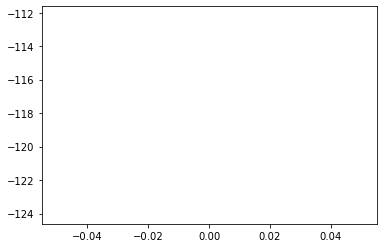

Episode: 1, reward = -124.613289


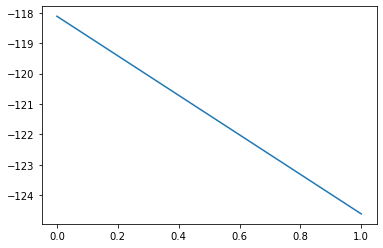

Episode: 2, reward = -122.569740


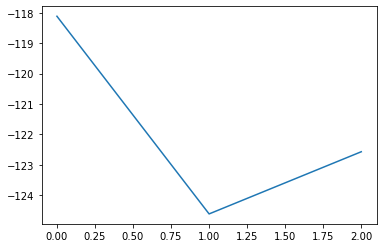

Episode: 3, reward = -125.117928


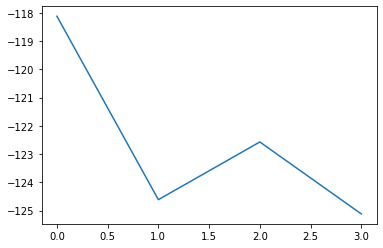

Episode: 4, reward = -123.290848


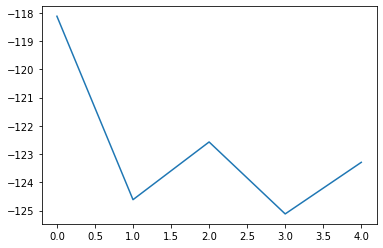

Episode: 5, reward = -126.274712


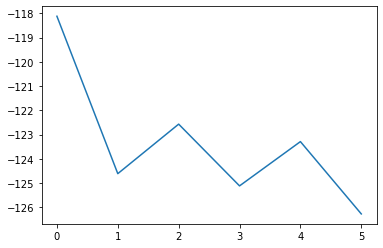

Episode: 6, reward = -125.478172


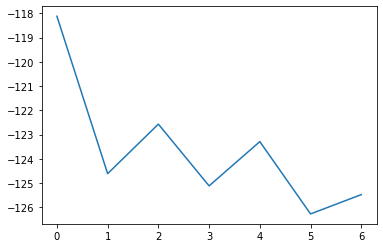

Episode: 7, reward = -122.972786


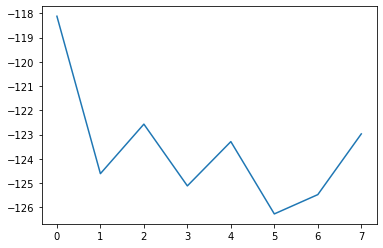

Episode: 8, reward = -123.139656


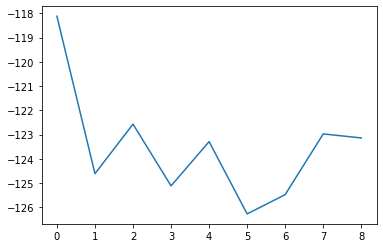

Episode: 9, reward = -120.175720


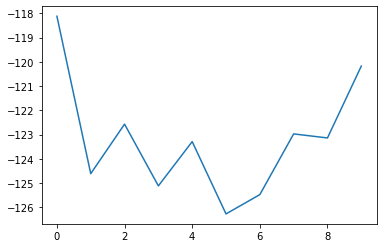

Episode: 10, reward = -124.609848


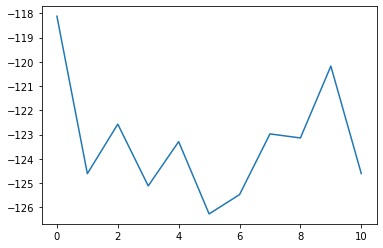

Episode: 11, reward = -124.279282


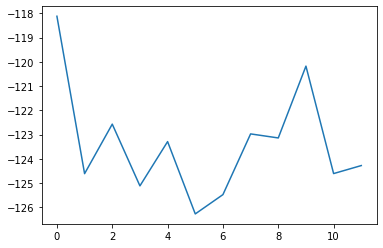

Episode: 12, reward = -123.749657


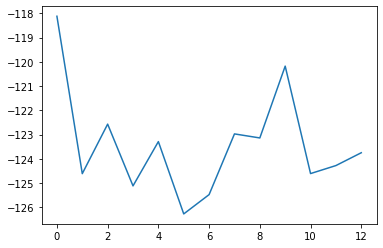

Episode: 13, reward = -123.061150


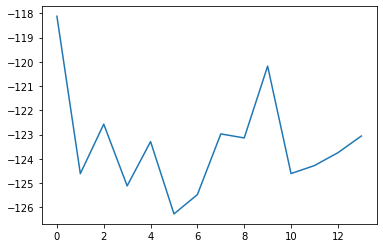

Episode: 14, reward = -124.937889


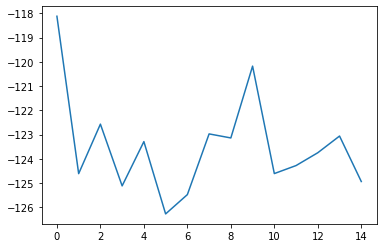

Episode: 15, reward = -117.772804


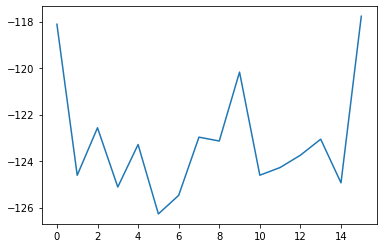

Episode: 16, reward = -125.568024


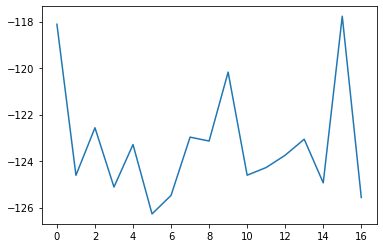

Episode: 17, reward = -125.069817


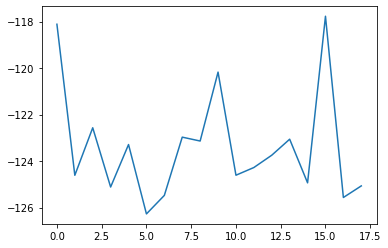

Episode: 18, reward = -122.421318


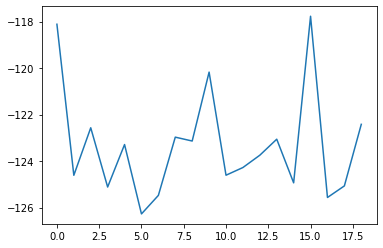

Episode: 19, reward = -128.592316


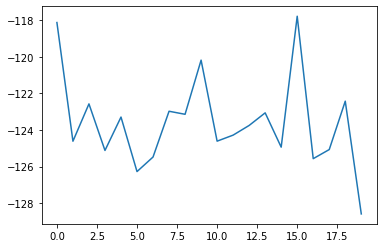

Episode: 20, reward = -129.606155


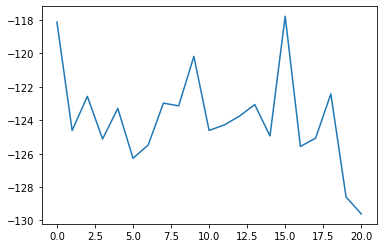

Episode: 21, reward = -121.268044


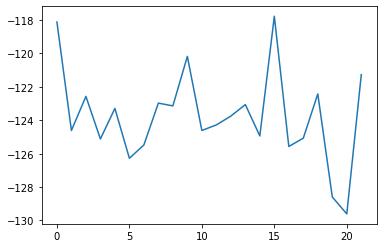

Episode: 22, reward = -120.523941


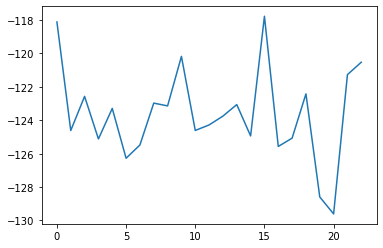

Episode: 23, reward = -125.399254


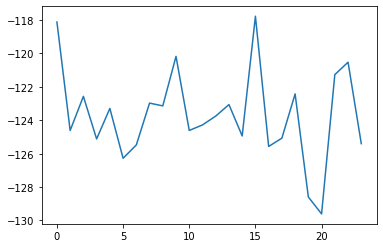

Episode: 24, reward = -121.027611


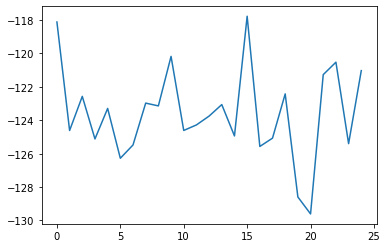

Episode: 25, reward = -126.520042


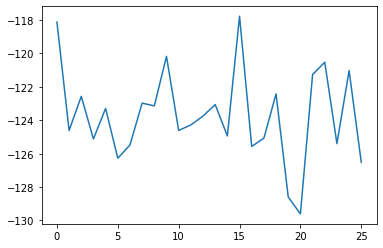

Episode: 26, reward = -122.658890


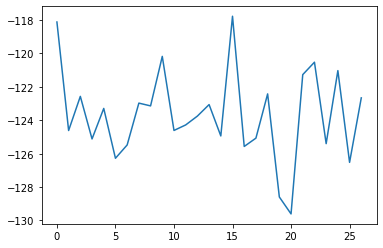

Episode: 27, reward = -118.718781


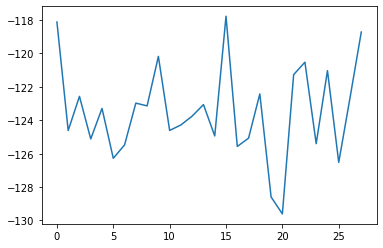

Episode: 28, reward = -121.454865


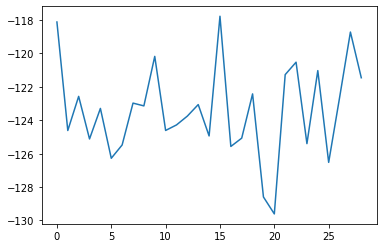

Episode: 29, reward = -129.968842


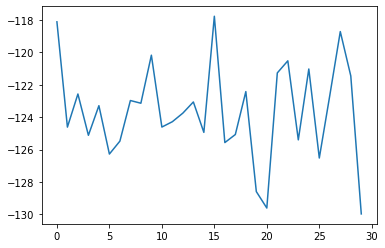

Episode: 30, reward = -130.638031


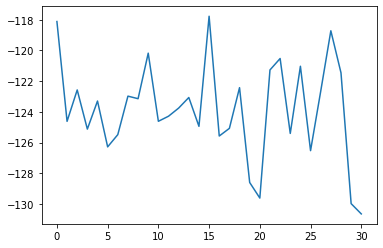

Episode: 31, reward = -122.833870


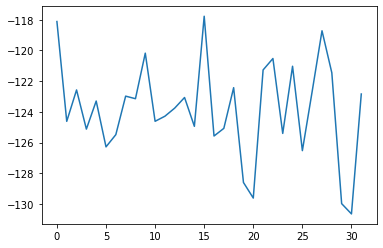

Episode: 32, reward = -122.728981


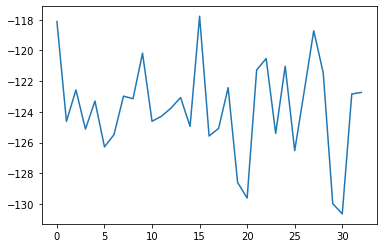

Episode: 33, reward = -130.354324


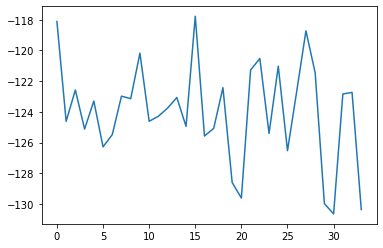

Episode: 34, reward = -125.281601


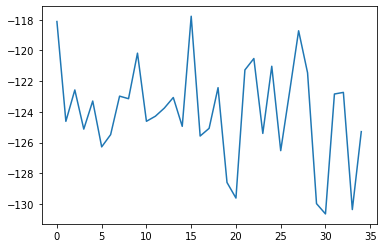

Episode: 35, reward = -123.492287


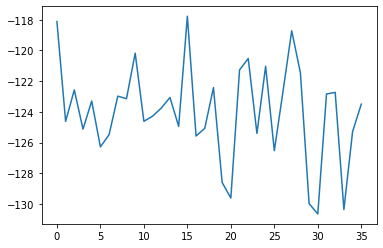

Episode: 36, reward = -125.930786


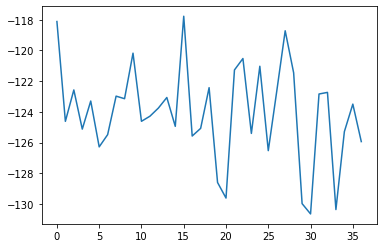

Episode: 37, reward = -124.909149


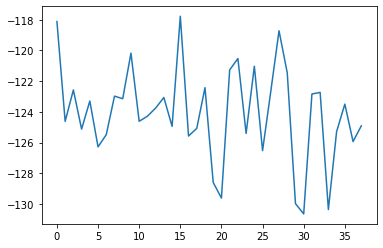

Episode: 38, reward = -127.399796


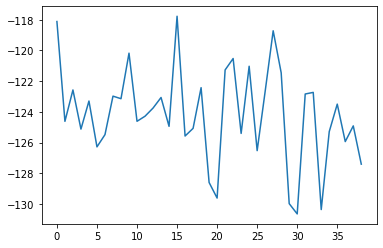

Episode: 39, reward = -123.004517


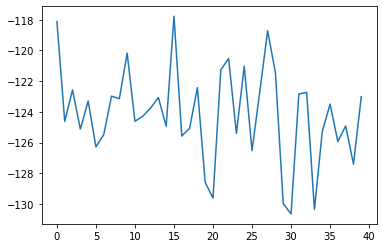

Episode: 40, reward = -120.717247


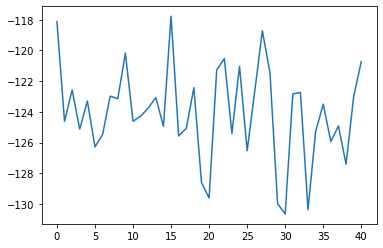

Episode: 41, reward = -122.949654


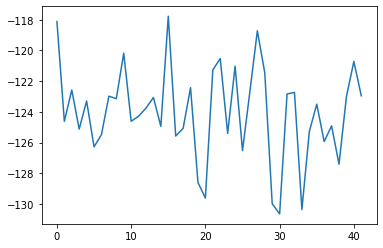

Episode: 42, reward = -128.963562


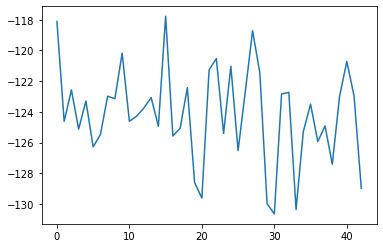

Episode: 43, reward = -123.036240


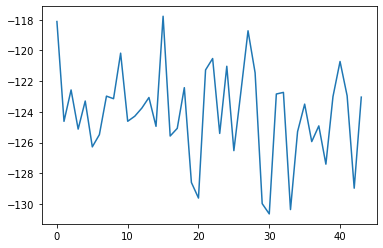

Episode: 44, reward = -129.986282


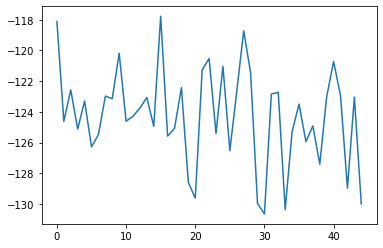

Episode: 45, reward = -127.785942


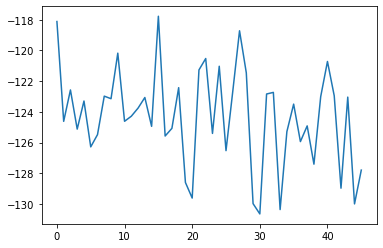

Episode: 46, reward = -123.443779


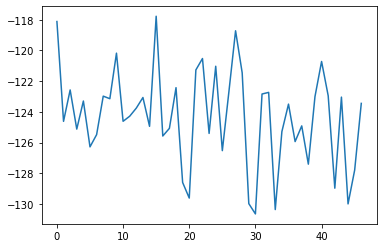

Episode: 47, reward = -124.031441


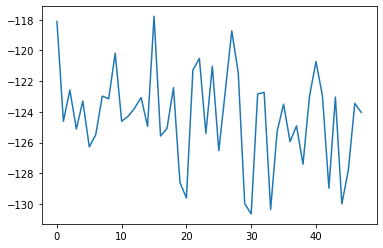

Episode: 48, reward = -123.276207


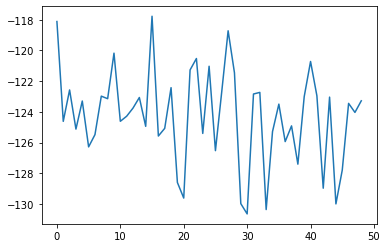

Episode: 49, reward = -122.252083


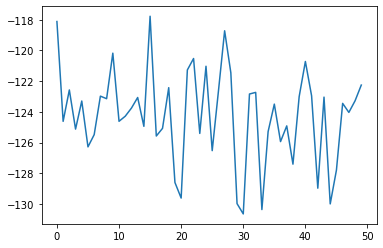

training now begins...
MADDPG on Network Balancing
scale_reward=0.010000
agent=4 
lr=0.001, 0.0001, sensor_range=0.3
servers=8
Episode: 50, reward = -128.315491


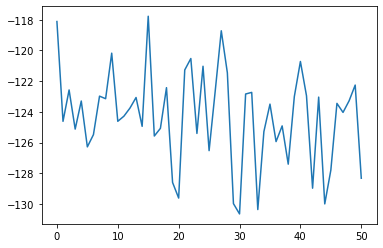

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 51, reward = -125.901764


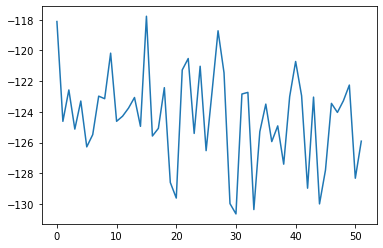

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 52, reward = -128.636368


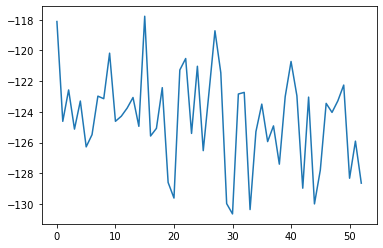

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 53, reward = -129.463760


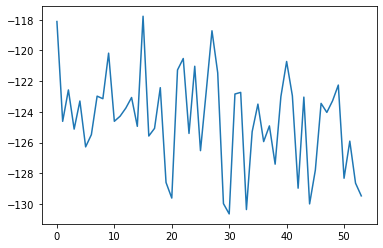

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 54, reward = -126.832573


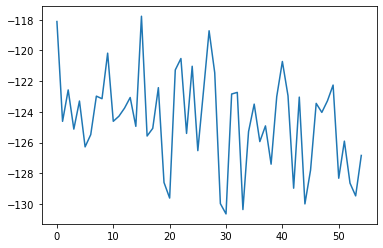

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 55, reward = -127.280441


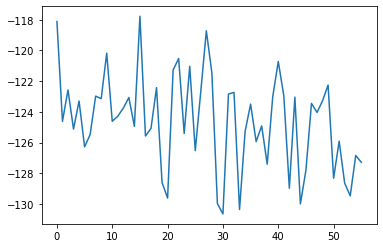

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 56, reward = -129.977829


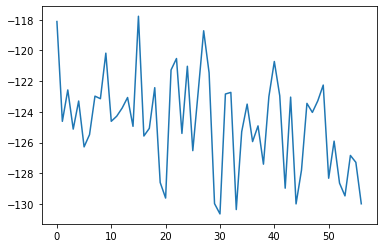

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 57, reward = -128.112671


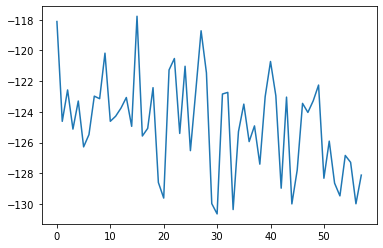

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 58, reward = -125.721359


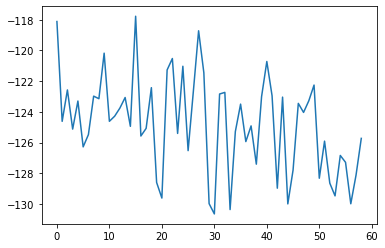

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 59, reward = -128.178619


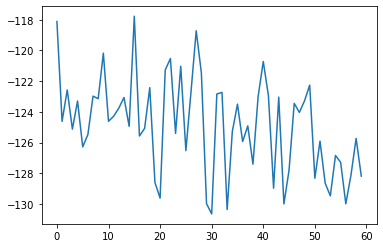

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 60, reward = -124.866234


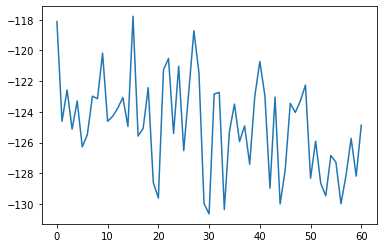

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 61, reward = -127.024971


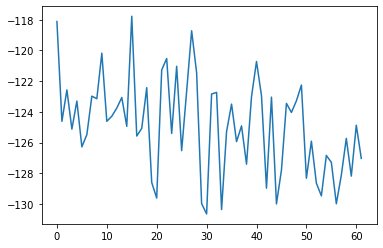

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 62, reward = -123.559532


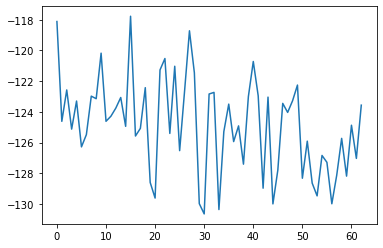

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 63, reward = -124.003716


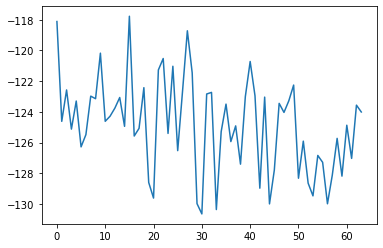

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 64, reward = -130.763763


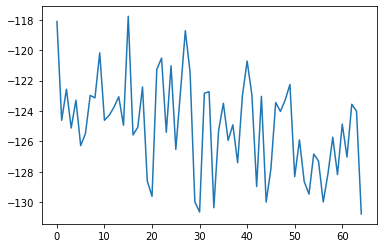

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 65, reward = -127.624535


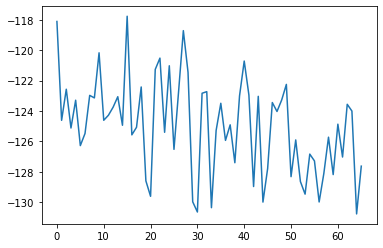

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 66, reward = -125.676392


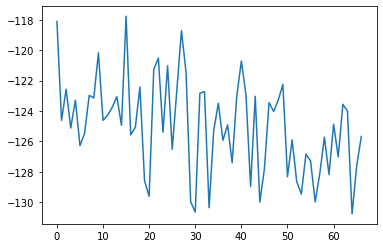

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 67, reward = -126.613770


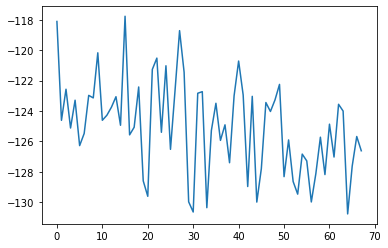

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 68, reward = -127.642548


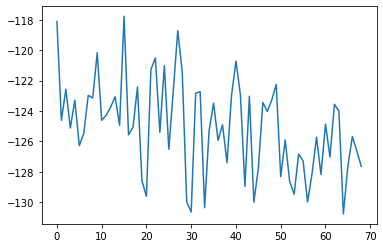

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 69, reward = -127.284386


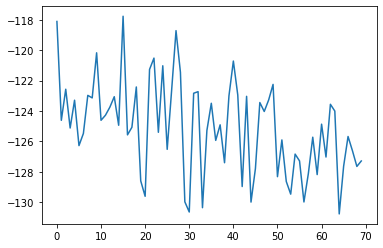

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 70, reward = -127.222153


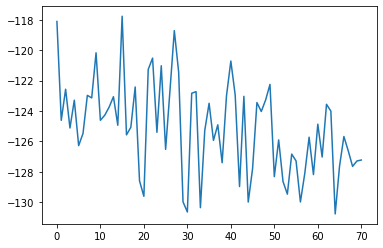

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 71, reward = -127.738838


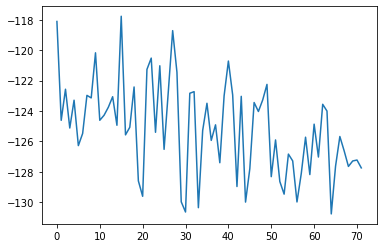

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 72, reward = -119.881218


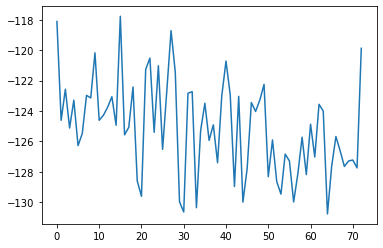

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 73, reward = -123.577782


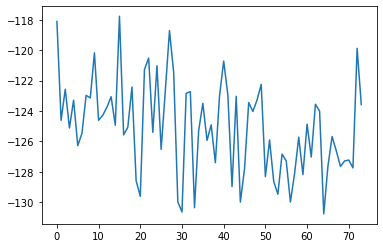

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 74, reward = -121.670799


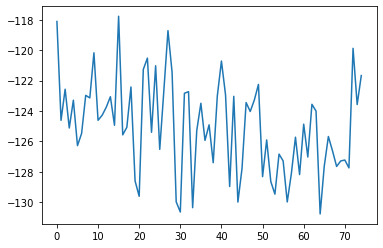

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 75, reward = -128.372635


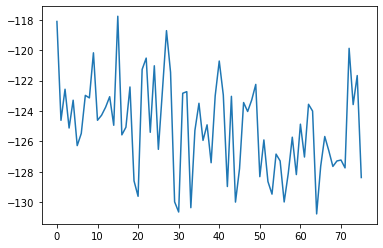

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 76, reward = -123.448074


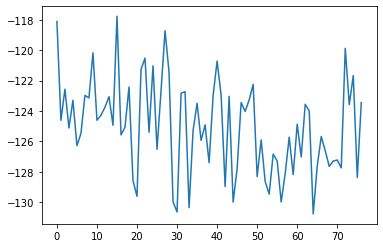

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 77, reward = -127.384384


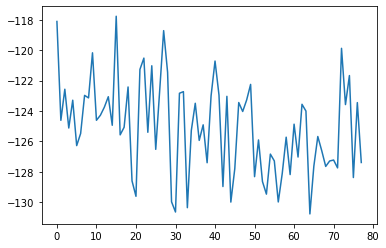

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 78, reward = -125.077499


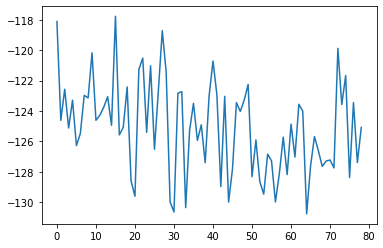

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 79, reward = -123.508804


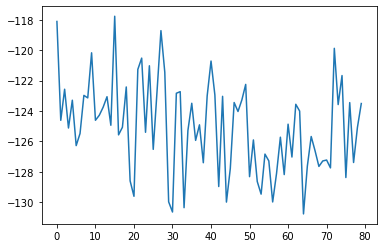

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 80, reward = -126.013527


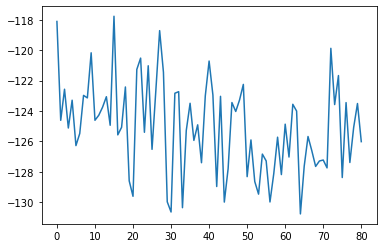

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 81, reward = -121.750893


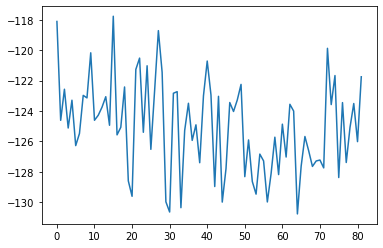

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 82, reward = -120.663322


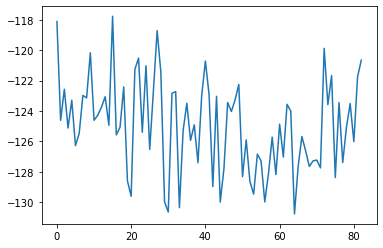

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 83, reward = -122.777756


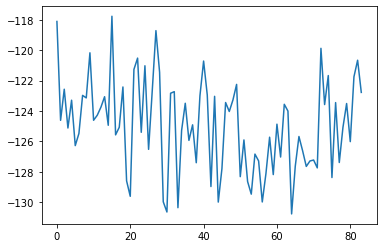

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 84, reward = -124.607605


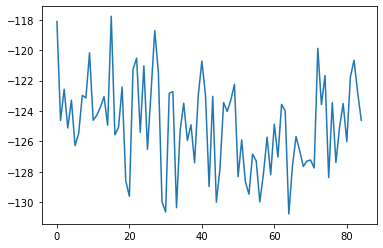

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 85, reward = -120.713806


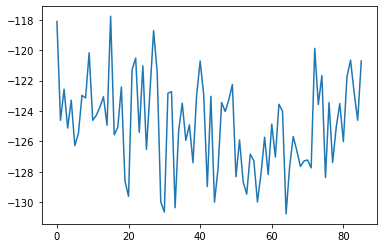

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 86, reward = -122.494377


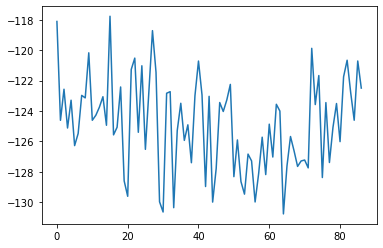

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 87, reward = -128.914139


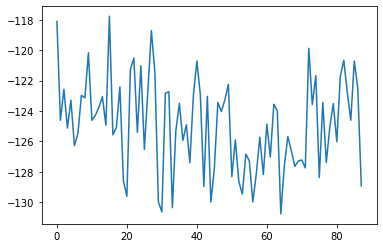

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 88, reward = -127.132225


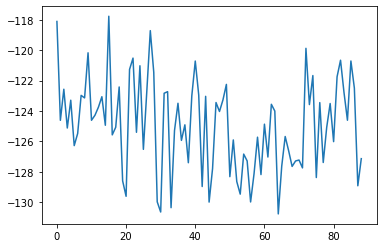

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 89, reward = -128.015686


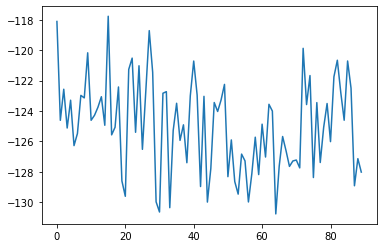

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 90, reward = -127.289398


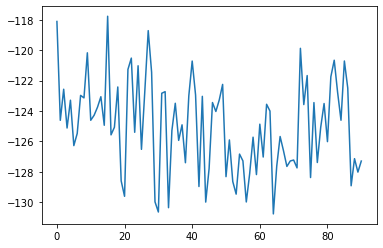

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 91, reward = -119.976509


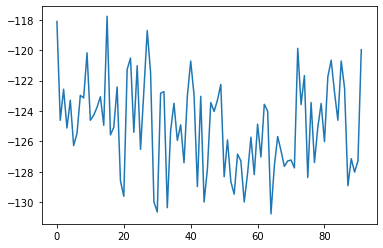

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 92, reward = -123.961166


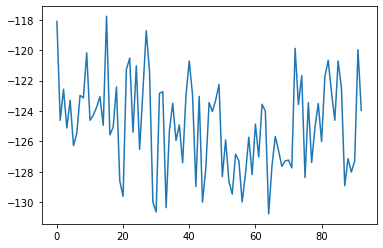

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 93, reward = -116.119034


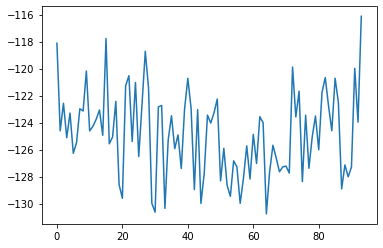

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 94, reward = -117.931580


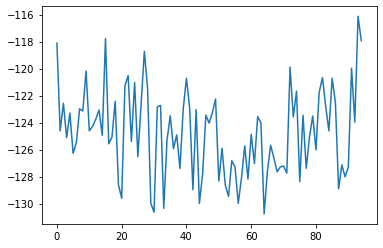

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 95, reward = -116.915565


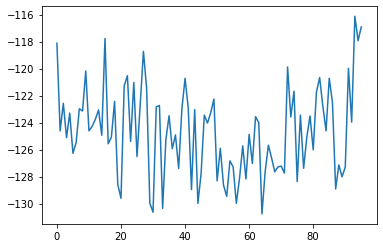

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 96, reward = -118.349060


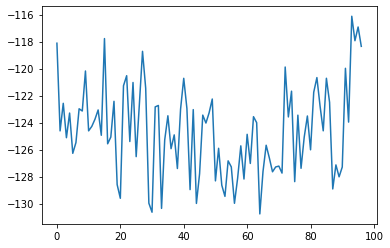

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 97, reward = -118.212296


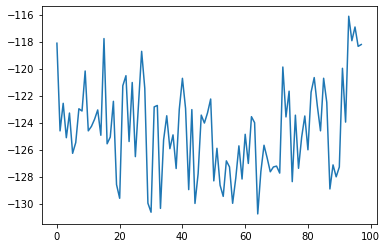

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 98, reward = -115.620117


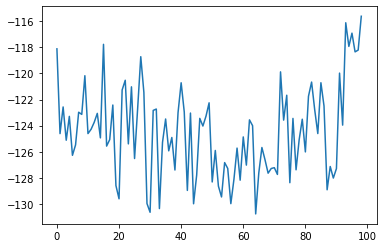

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 99, reward = -114.671677


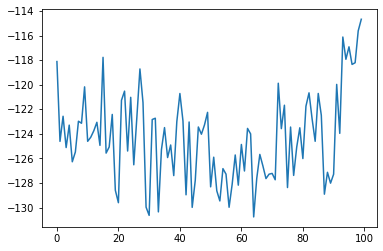

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 100, reward = -122.346962


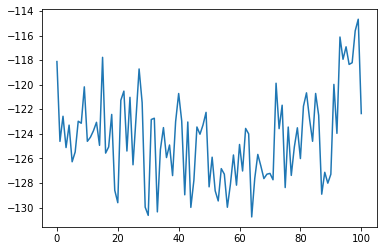

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 101, reward = -127.200752


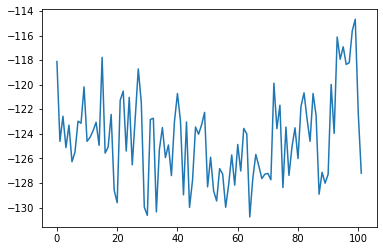

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 102, reward = -124.660088


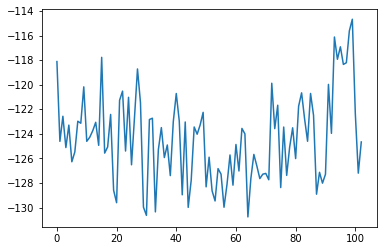

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 103, reward = -129.912842


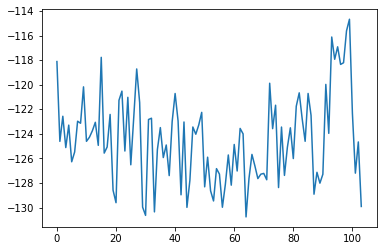

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 104, reward = -129.638229


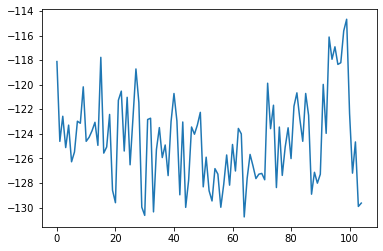

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 105, reward = -123.245995


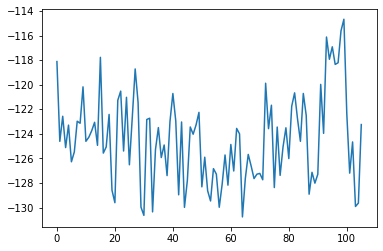

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 106, reward = -127.459824


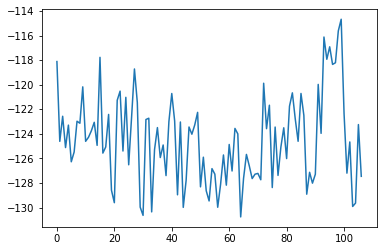

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 107, reward = -127.845718


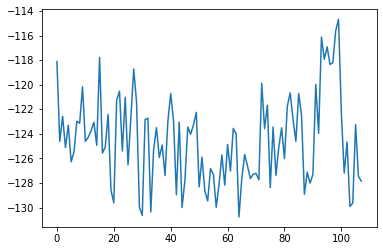

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 108, reward = -128.813629


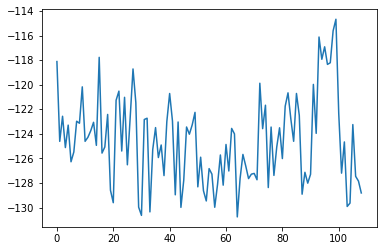

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 109, reward = -128.778961


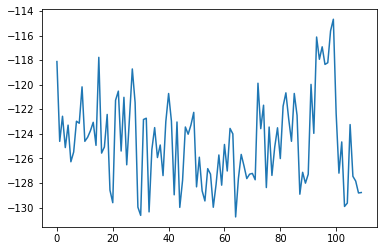

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 110, reward = -129.090240


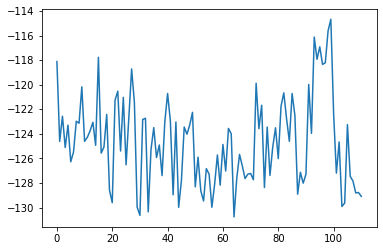

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 111, reward = -129.850906


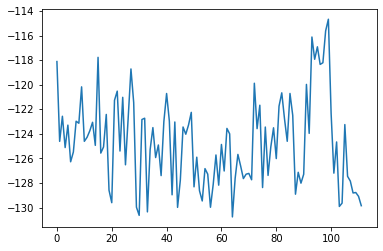

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 112, reward = -126.782249


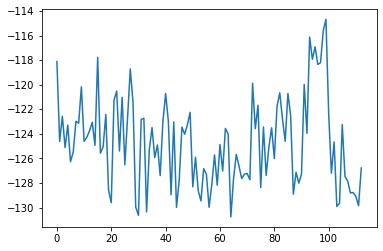

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 113, reward = -129.320389


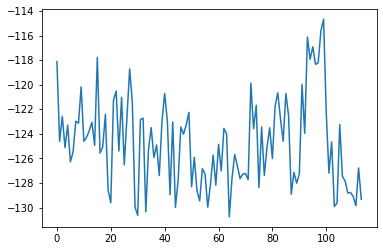

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 114, reward = -127.262474


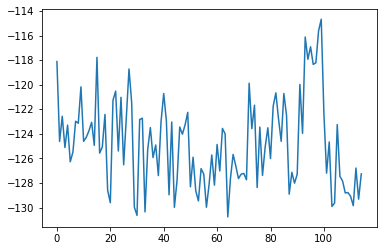

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 115, reward = -125.690430


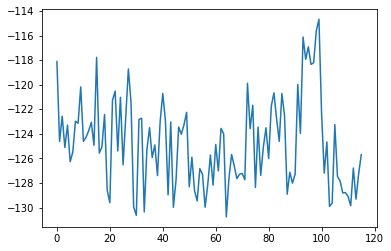

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 116, reward = -125.334946


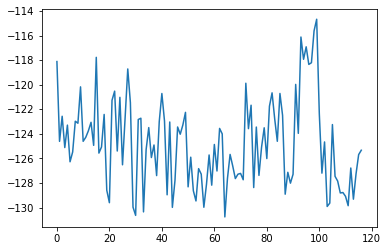

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 117, reward = -127.097717


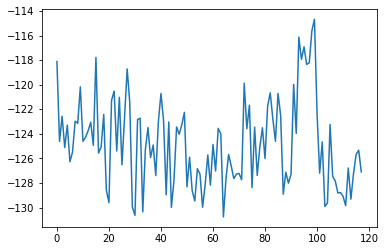

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 118, reward = -128.631912


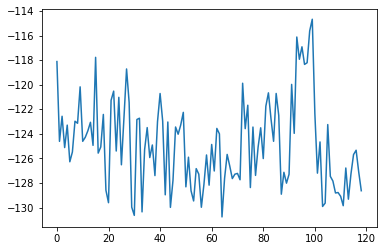

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 119, reward = -122.165886


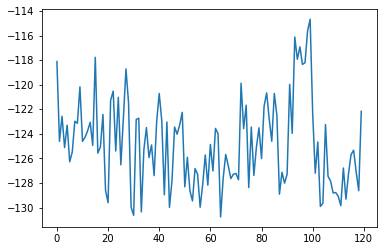

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 120, reward = -128.734268


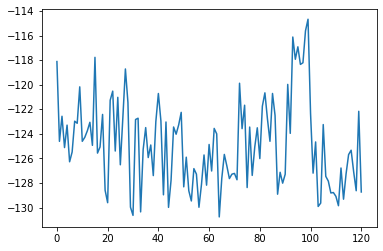

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 121, reward = -123.497635


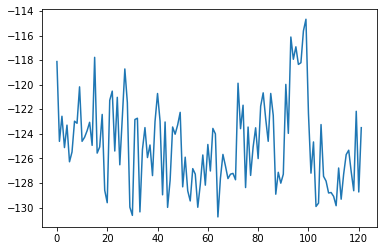

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 122, reward = -124.449333


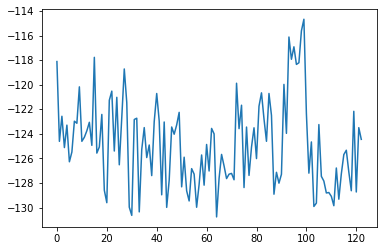

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 123, reward = -126.227722


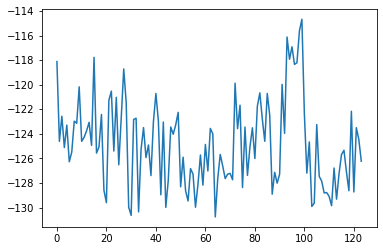

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 124, reward = -128.920395


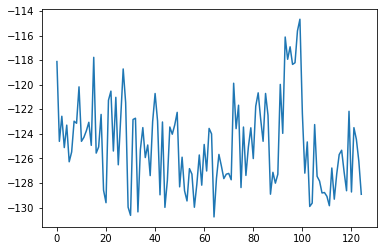

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 125, reward = -123.956863


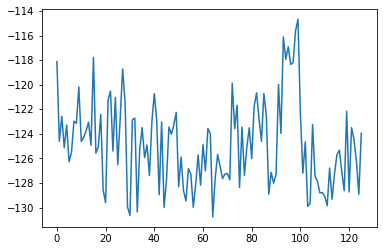

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 126, reward = -124.199448


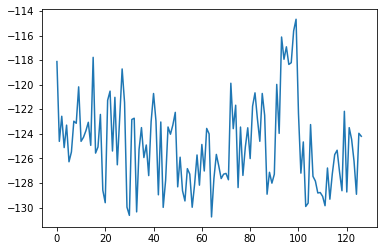

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 127, reward = -127.366745


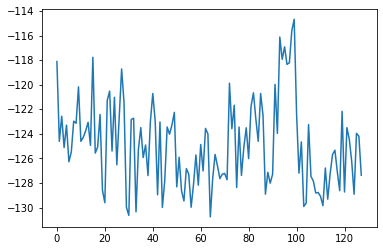

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 128, reward = -125.056183


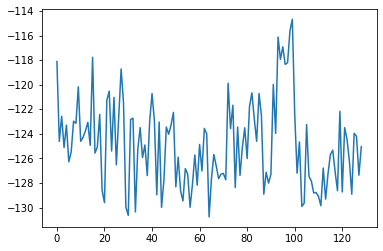

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 129, reward = -122.213120


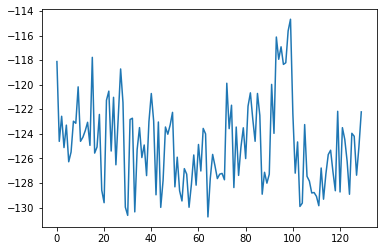

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 130, reward = -124.674500


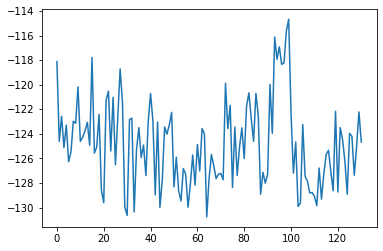

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 131, reward = -126.862892


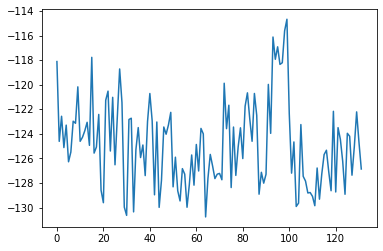

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 132, reward = -129.209137


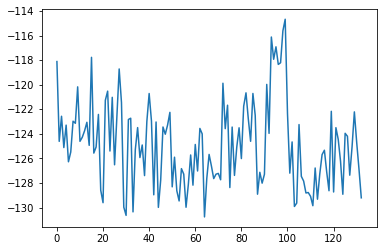

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 133, reward = -123.205093


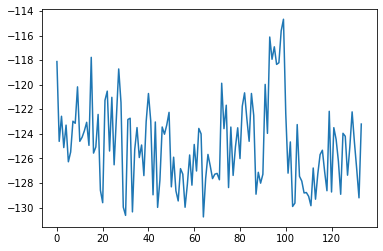

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 134, reward = -125.210777


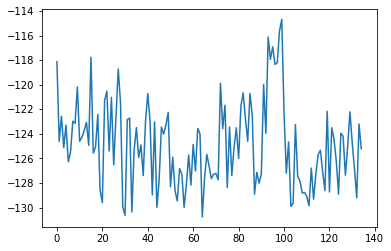

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 135, reward = -129.259903


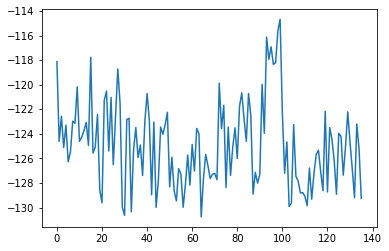

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 136, reward = -129.268311


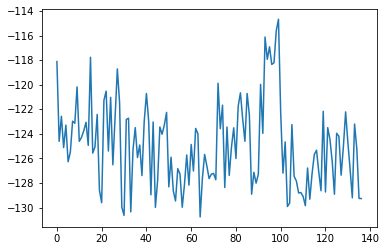

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 137, reward = -127.756660


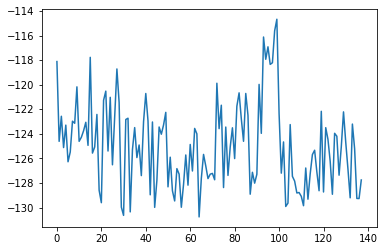

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 138, reward = -129.216461


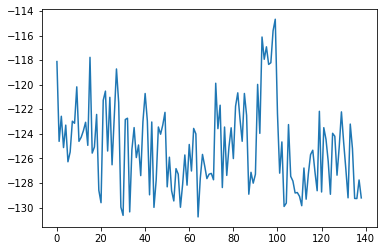

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 139, reward = -127.363892


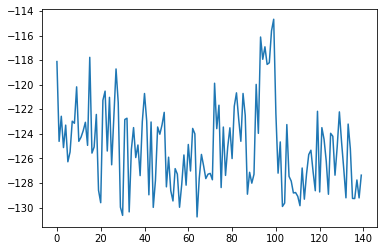

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 140, reward = -125.018974


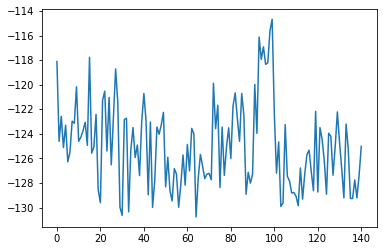

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 141, reward = -127.351883


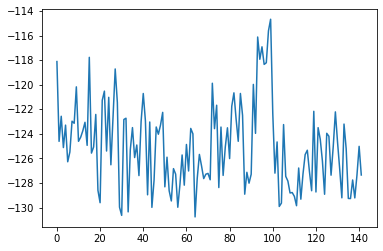

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 142, reward = -125.691879


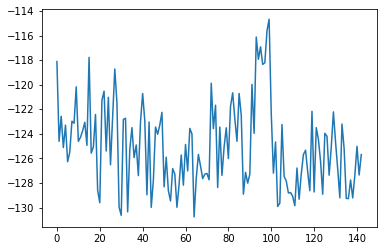

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 143, reward = -124.050110


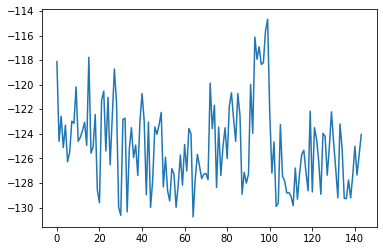

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 144, reward = -122.295425


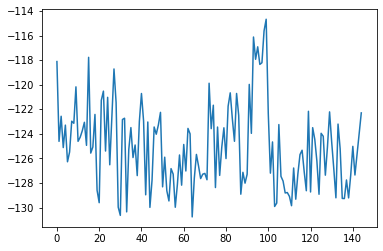

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 145, reward = -126.022545


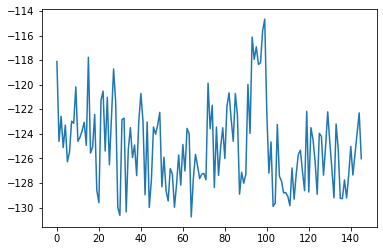

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 146, reward = -126.193451


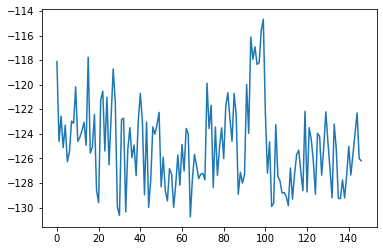

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 147, reward = -127.361656


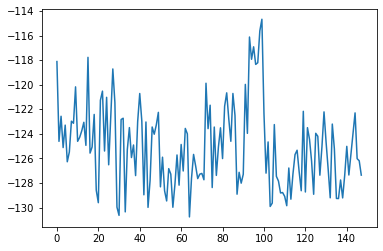

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 148, reward = -127.139503


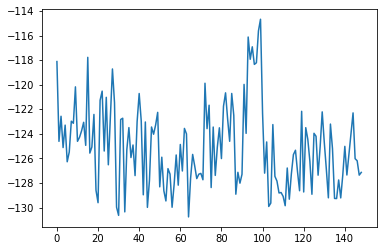

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 149, reward = -128.866592


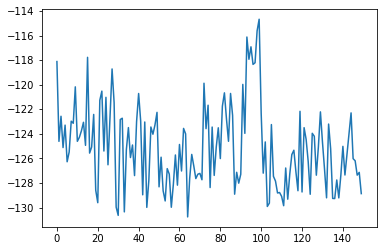

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 150, reward = -124.000572


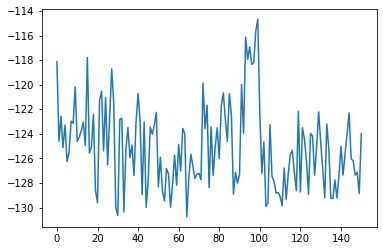

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 151, reward = -132.591614


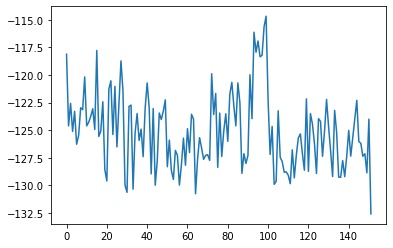

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 152, reward = -123.106567


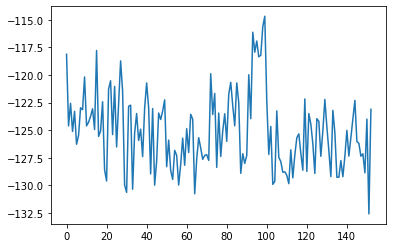

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 153, reward = -126.110023


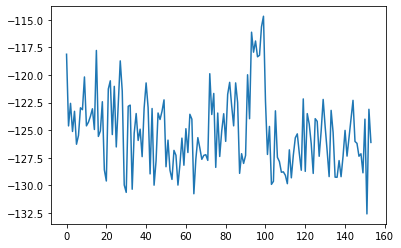

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 154, reward = -128.897919


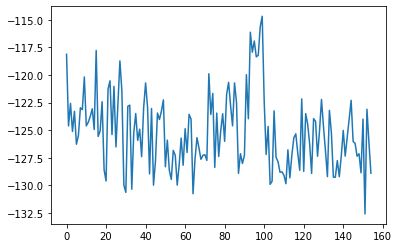

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 155, reward = -123.942352


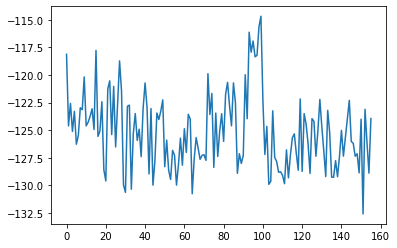

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 156, reward = -124.175110


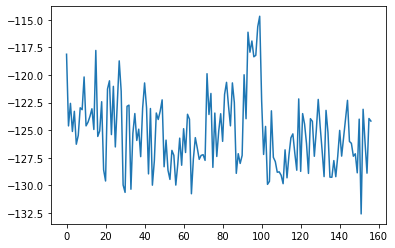

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 157, reward = -120.115295


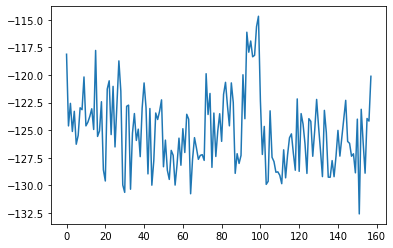

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 158, reward = -126.203079


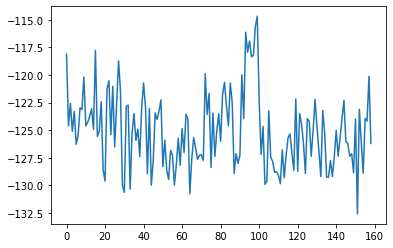

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 159, reward = -127.614883


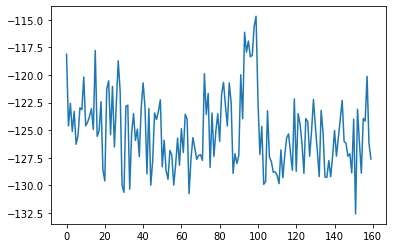

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 160, reward = -133.320099


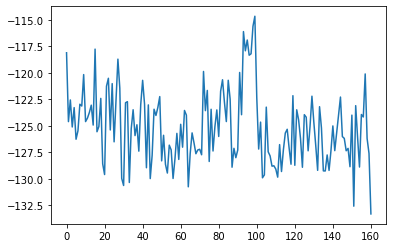

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 161, reward = -128.751602


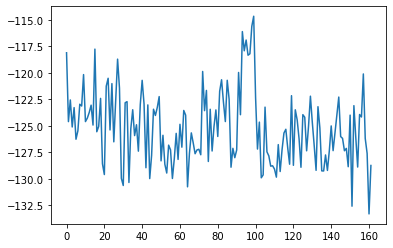

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 162, reward = -136.031631


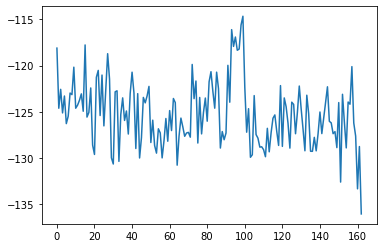

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 163, reward = -133.981110


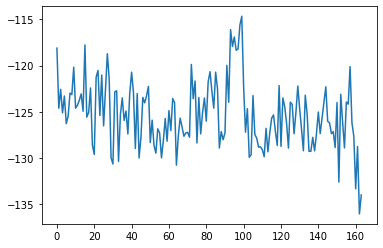

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 164, reward = -131.014816


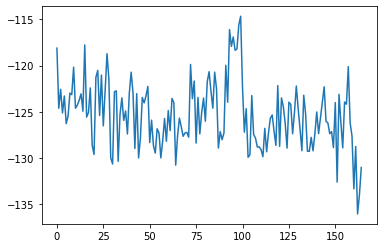

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 165, reward = -132.649368


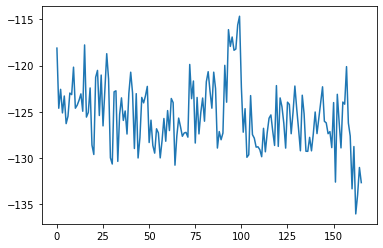

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 166, reward = -135.658005


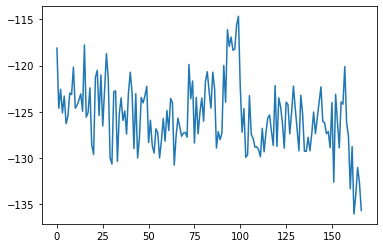

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 167, reward = -136.808044


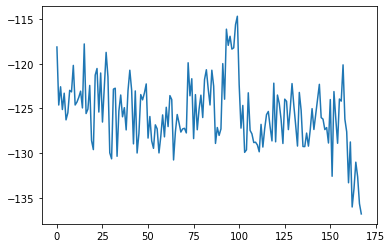

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 168, reward = -135.185989


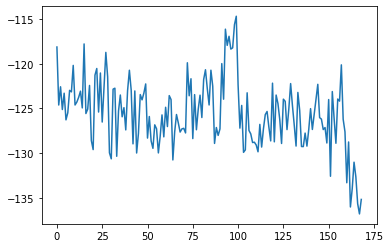

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 169, reward = -130.638580


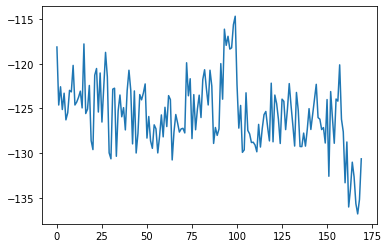

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 170, reward = -137.453079


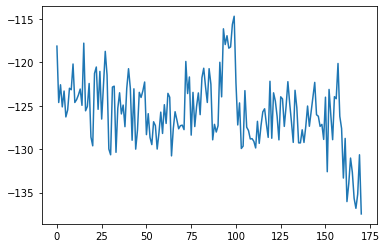

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 171, reward = -136.163376


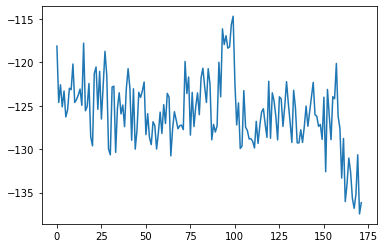

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 172, reward = -132.948547


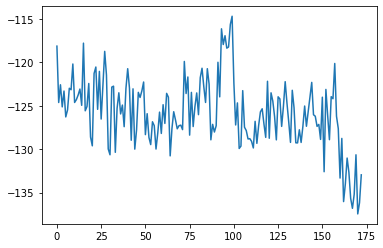

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 173, reward = -130.889999


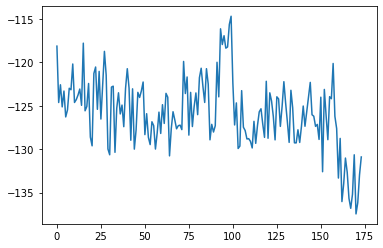

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 174, reward = -132.800949


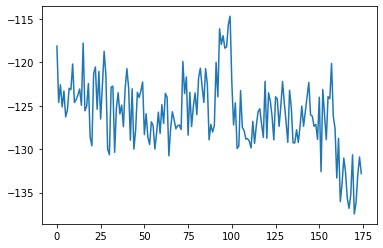

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 175, reward = -133.914688


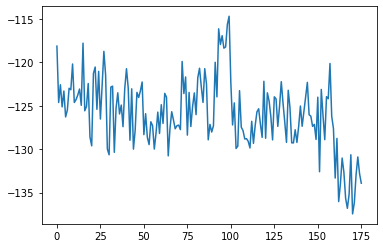

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 176, reward = -128.601685


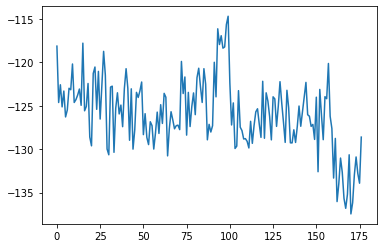

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 177, reward = -128.983368


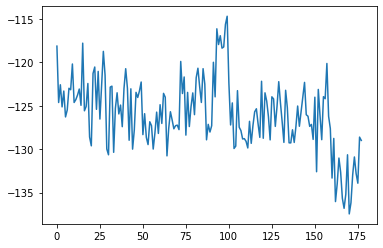

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 178, reward = -136.365036


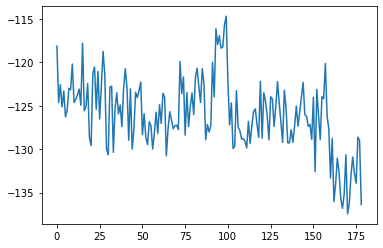

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 179, reward = -140.164047


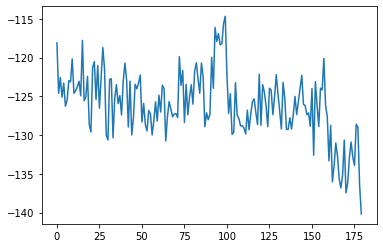

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 180, reward = -134.778152


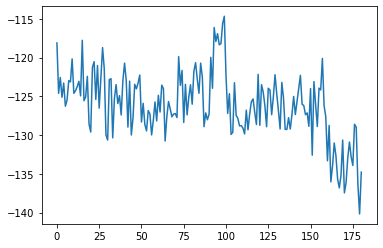

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 181, reward = -134.132950


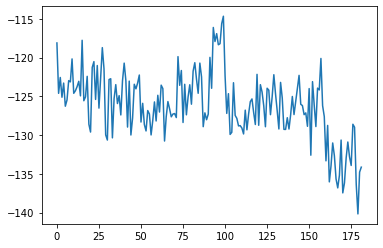

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 182, reward = -130.469528


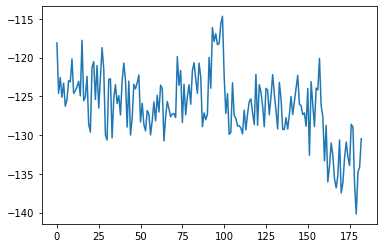

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 183, reward = -127.424217


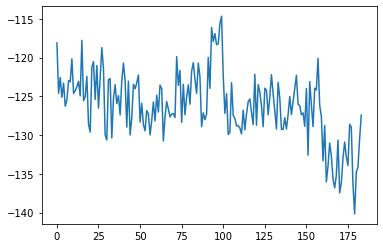

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 184, reward = -135.498260


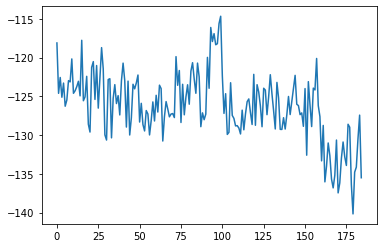

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 185, reward = -125.250648


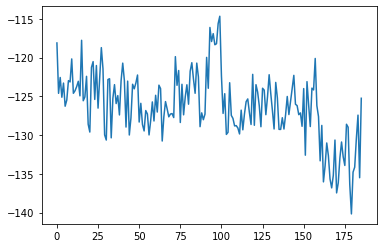

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 186, reward = -124.451309


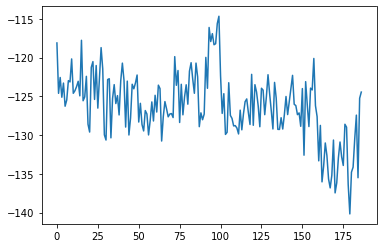

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 187, reward = -135.043671


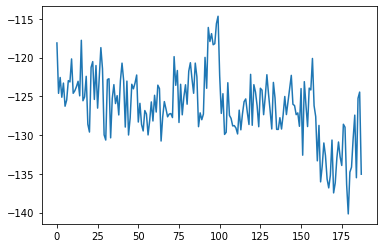

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 188, reward = -137.903275


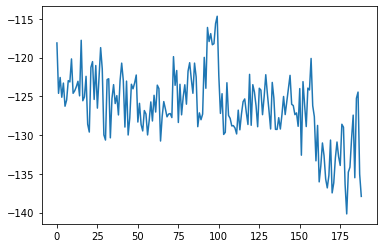

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 189, reward = -133.616196


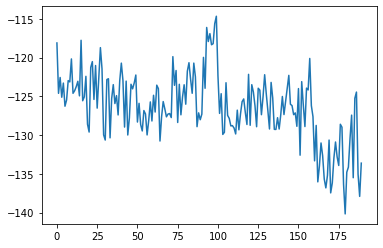

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 190, reward = -140.775177


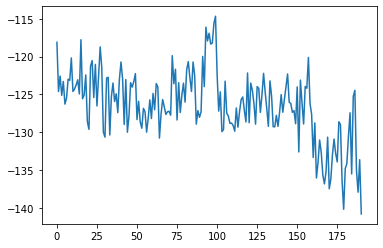

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 191, reward = -141.013794


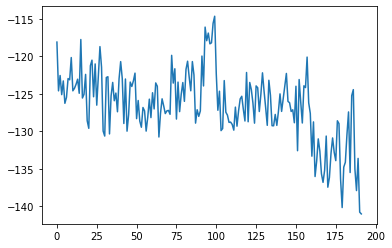

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 192, reward = -137.954254


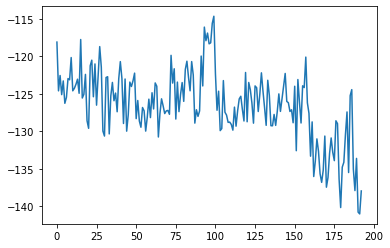

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 193, reward = -136.850540


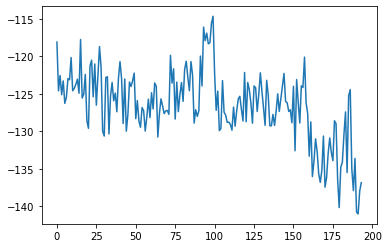

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 194, reward = -135.607193


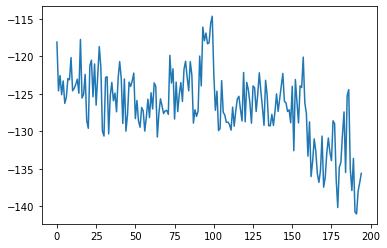

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 195, reward = -130.188644


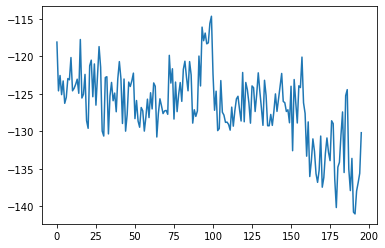

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 196, reward = -138.475845


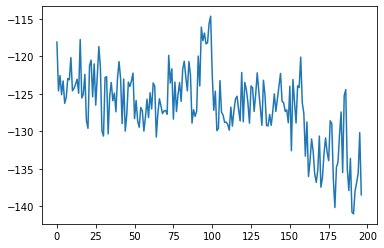

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 197, reward = -135.254425


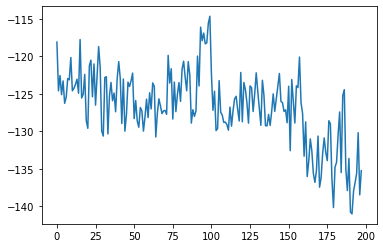

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 198, reward = -134.457474


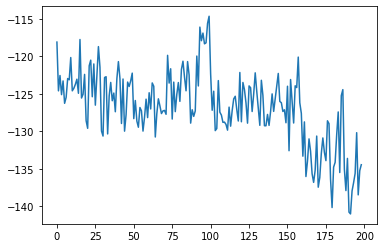

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 199, reward = -132.766327


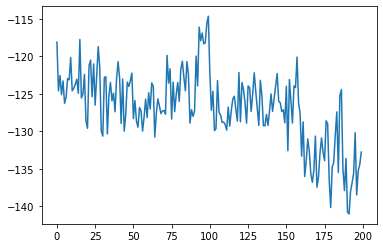

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 200, reward = -139.170654


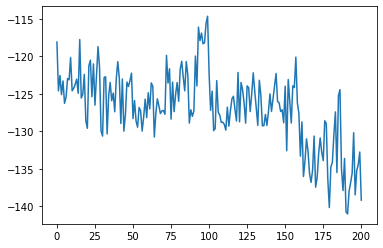

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 201, reward = -137.035126


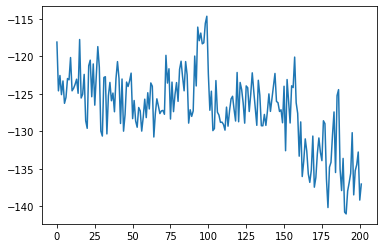

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 202, reward = -136.893326


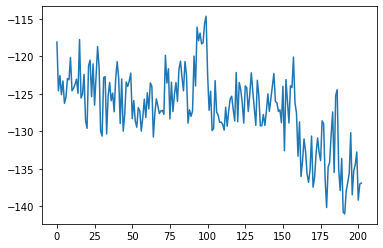

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 203, reward = -141.530518


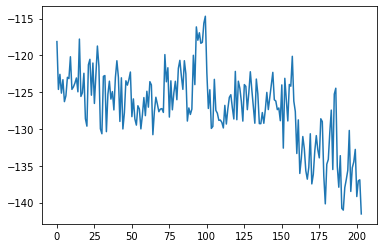

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 204, reward = -139.711060


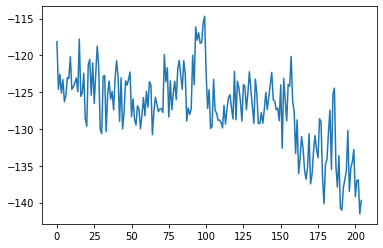

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 205, reward = -139.243561


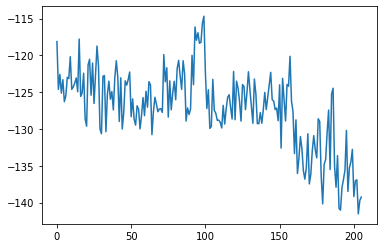

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 206, reward = -133.946518


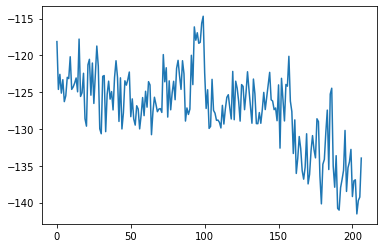

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 207, reward = -139.722534


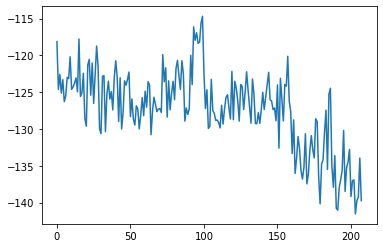

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 208, reward = -135.424911


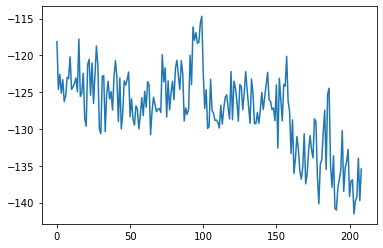

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 209, reward = -137.304825


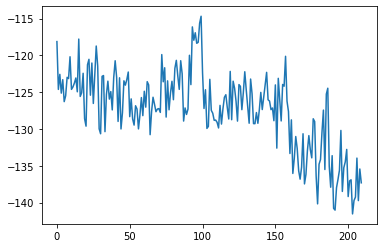

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 210, reward = -135.099838


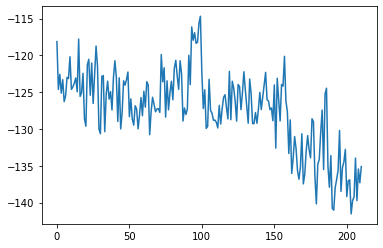

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 211, reward = -133.364655


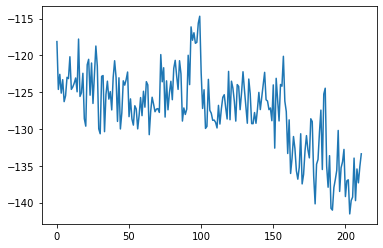

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 212, reward = -136.611740


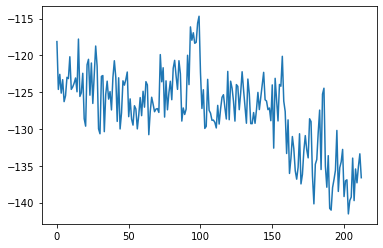

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 213, reward = -138.128281


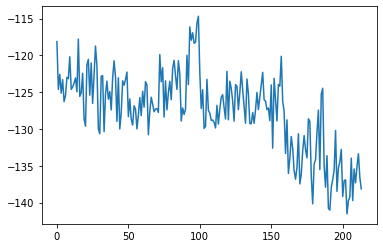

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 214, reward = -138.465485


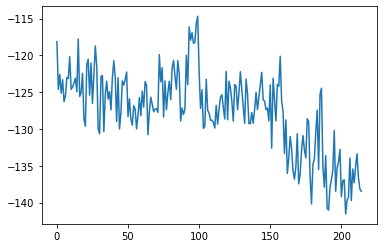

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 215, reward = -139.276672


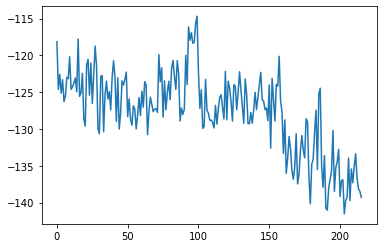

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 216, reward = -138.410233


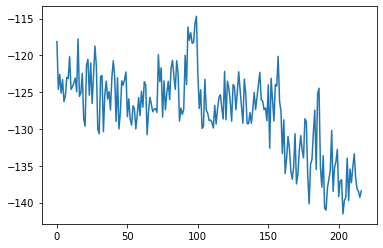

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 217, reward = -139.018616


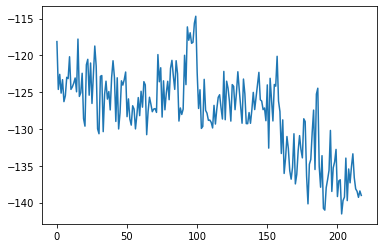

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 218, reward = -138.152435


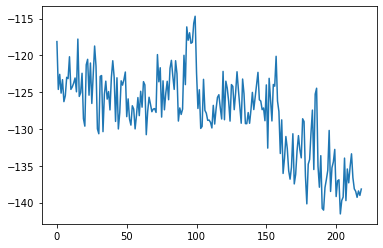

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 219, reward = -136.077332


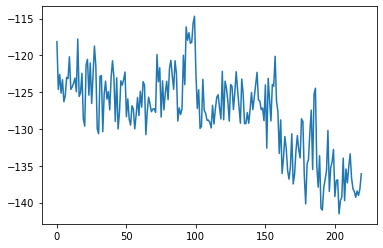

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 220, reward = -138.247192


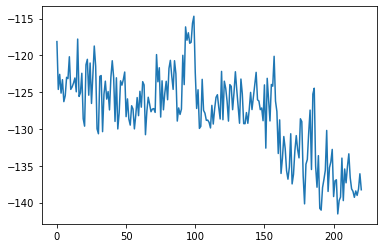

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 221, reward = -133.450378


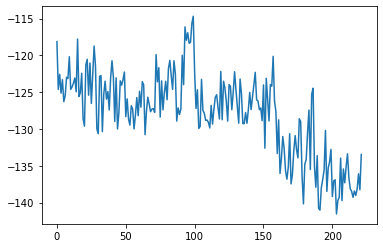

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 222, reward = -138.093811


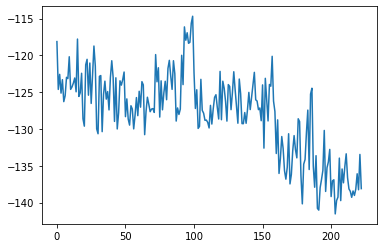

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 223, reward = -135.513748


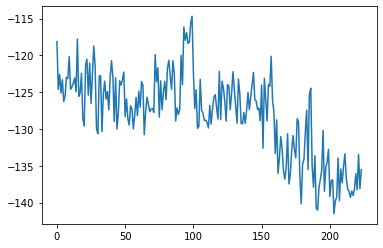

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 224, reward = -134.936859


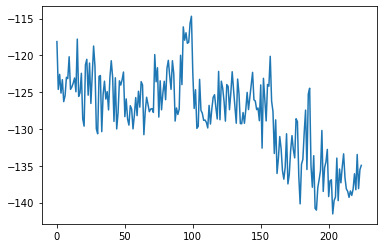

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 225, reward = -138.350433


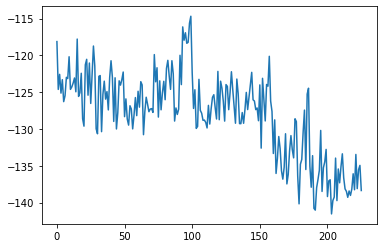

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 226, reward = -138.479126


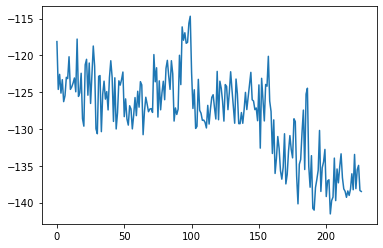

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 227, reward = -138.258987


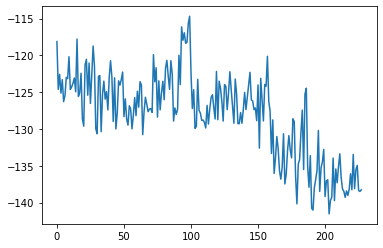

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 228, reward = -136.238647


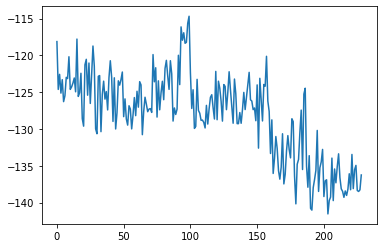

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 229, reward = -138.530212


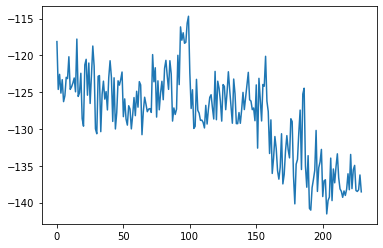

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 230, reward = -138.178680


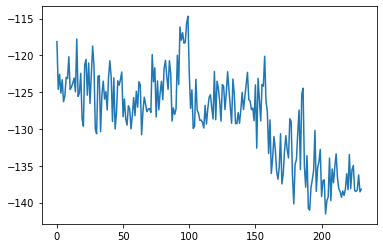

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 231, reward = -134.592819


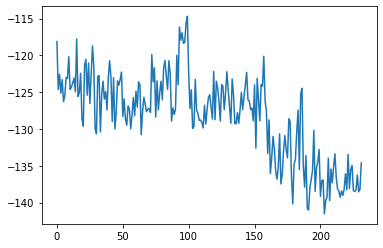

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 232, reward = -138.915771


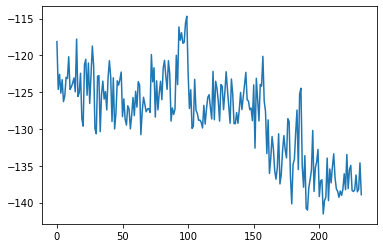

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 233, reward = -139.990219


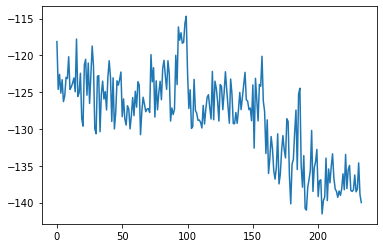

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 234, reward = -138.156509


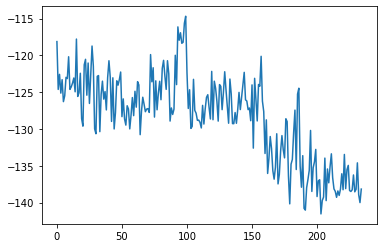

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 235, reward = -140.808182


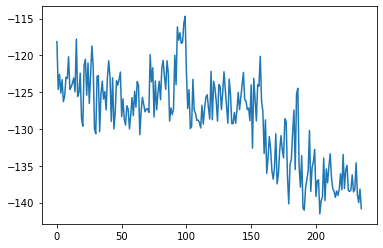

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 236, reward = -137.285202


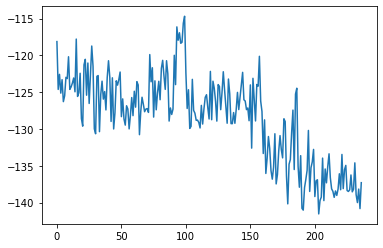

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 237, reward = -138.586502


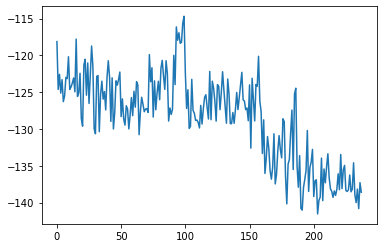

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 238, reward = -133.119781


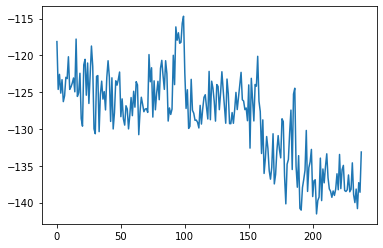

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 239, reward = -143.002441


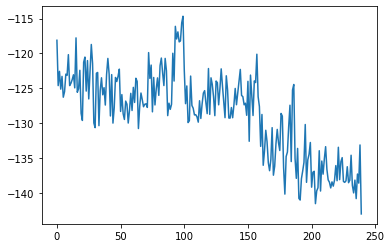

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 240, reward = -134.105789


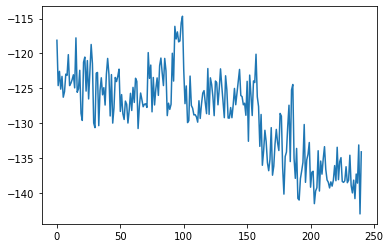

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 241, reward = -136.309097


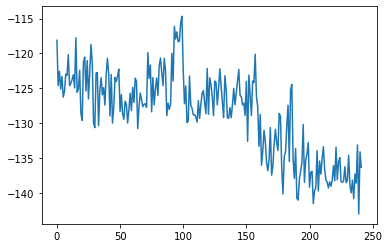

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 242, reward = -134.533142


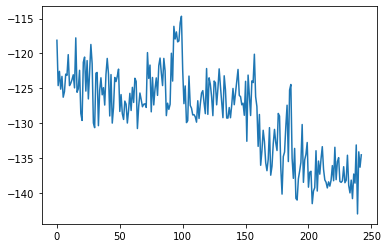

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 243, reward = -143.532242


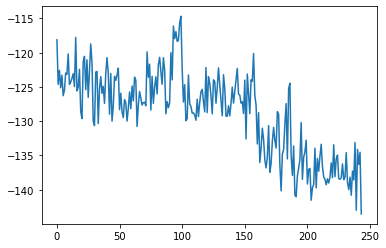

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 244, reward = -141.575302


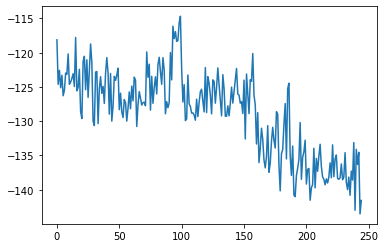

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 245, reward = -136.639572


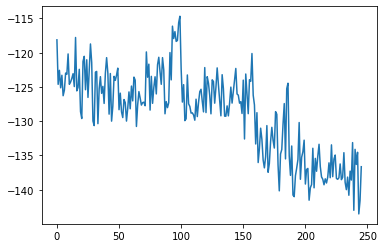

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 246, reward = -135.663284


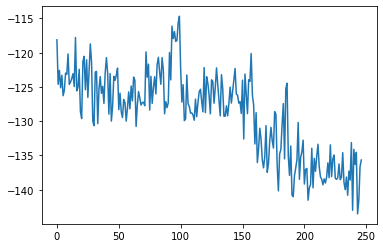

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 247, reward = -136.241592


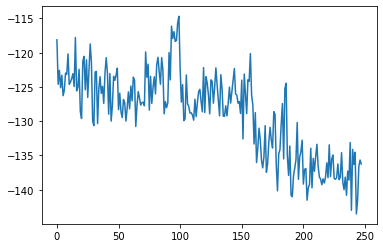

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 248, reward = -138.387619


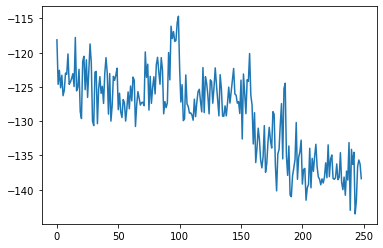

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 249, reward = -139.389557


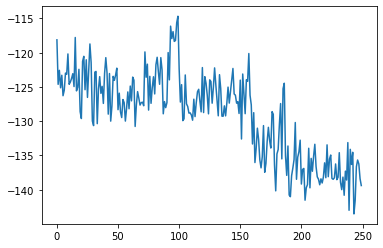

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 250, reward = -137.382446


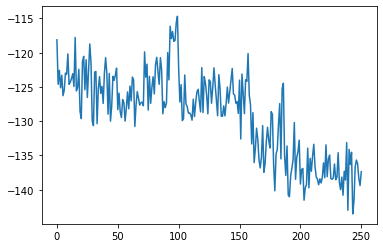

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 251, reward = -137.199783


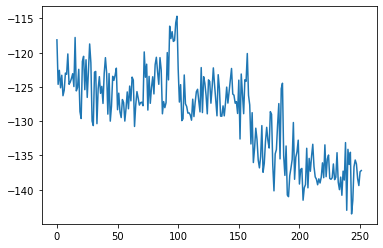

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 252, reward = -137.977066


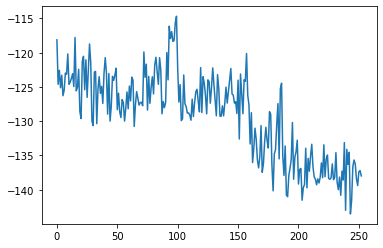

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 253, reward = -133.656082


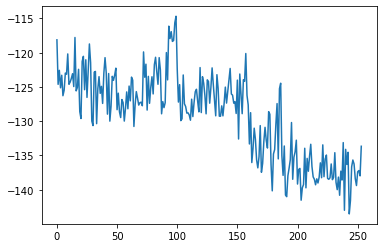

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 254, reward = -137.089691


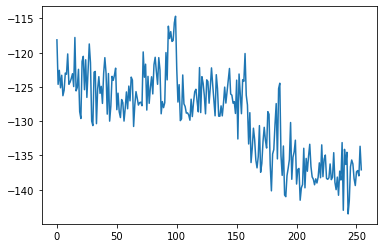

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 255, reward = -133.195160


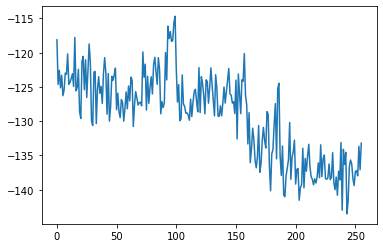

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 256, reward = -131.744934


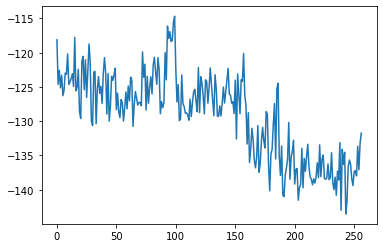

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 257, reward = -139.367340


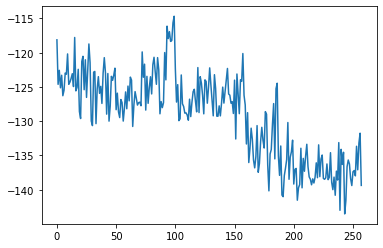

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 258, reward = -134.901718


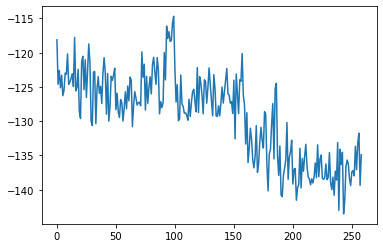

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 259, reward = -132.969803


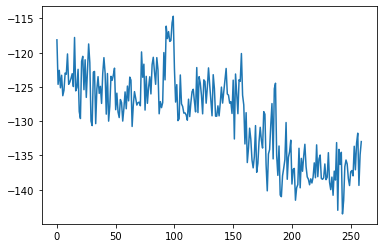

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 260, reward = -140.358124


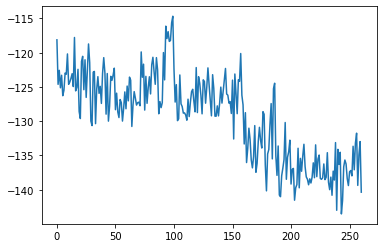

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 261, reward = -132.915146


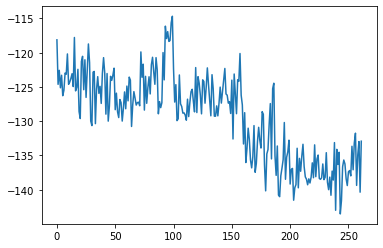

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 262, reward = -137.270752


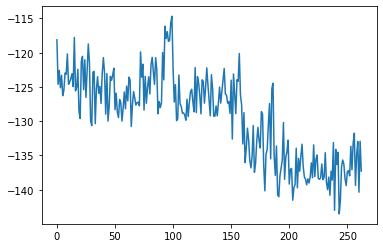

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 263, reward = -140.552094


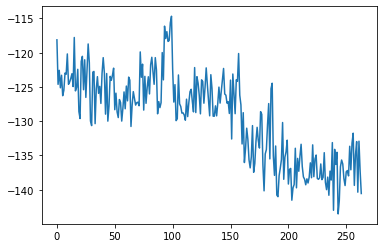

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 264, reward = -136.004623


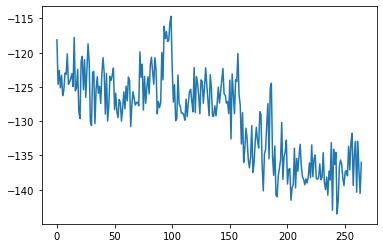

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 265, reward = -139.035568


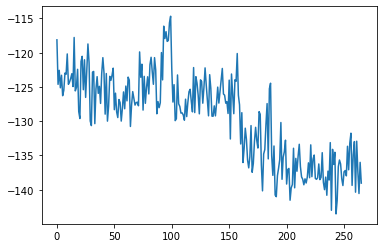

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 266, reward = -134.898315


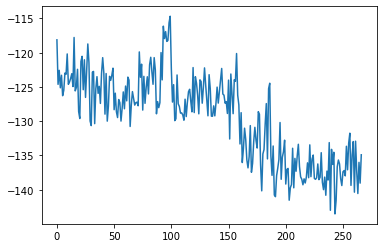

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 267, reward = -134.612228


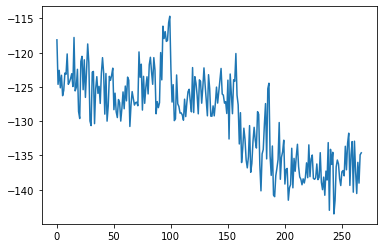

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 268, reward = -134.728943


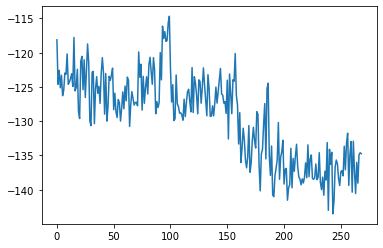

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 269, reward = -138.682892


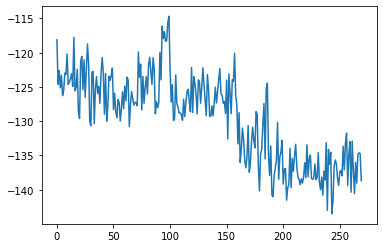

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 270, reward = -132.686310


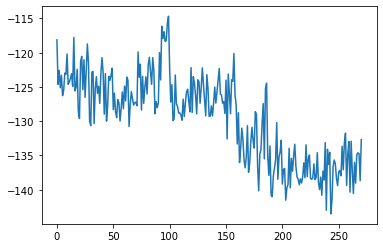

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 271, reward = -125.891983


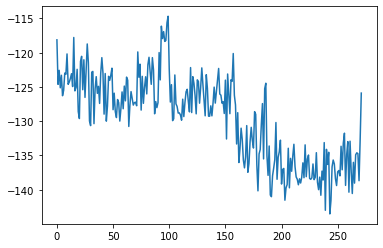

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 272, reward = -124.029549


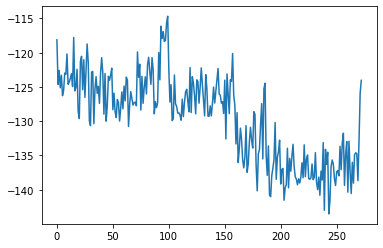

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 273, reward = -128.117065


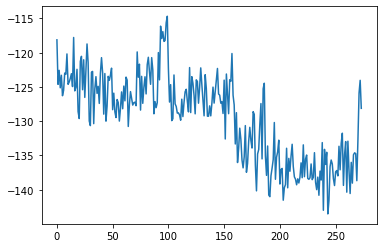

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 274, reward = -120.052216


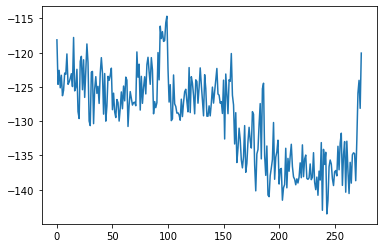

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 275, reward = -133.705872


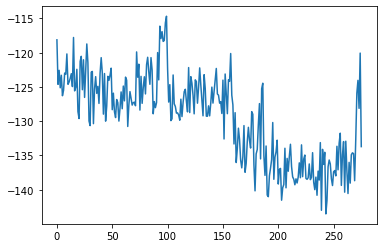

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 276, reward = -124.342018


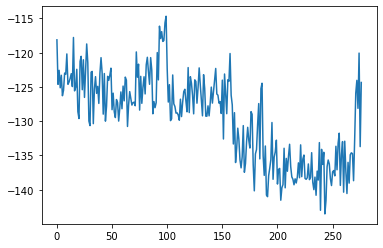

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 277, reward = -120.687744


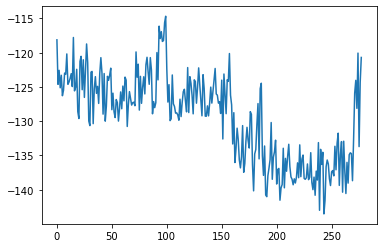

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 278, reward = -125.056259


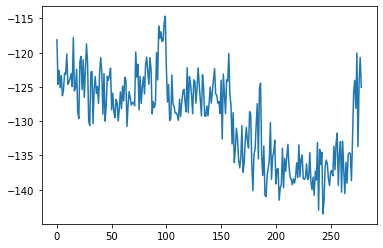

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 279, reward = -123.952644


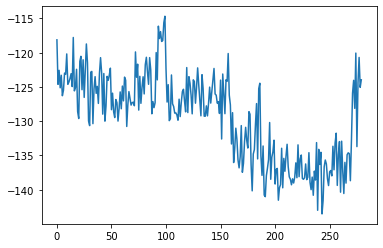

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 280, reward = -127.475098


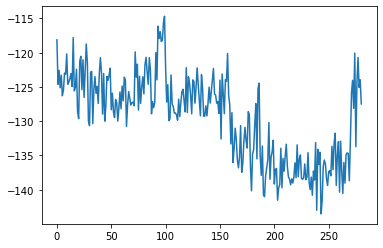

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 281, reward = -128.325394


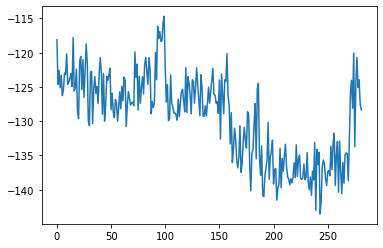

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 282, reward = -123.638077


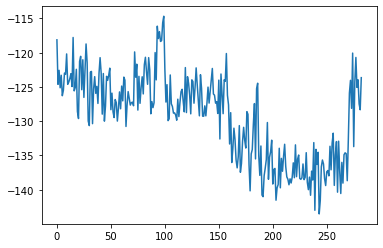

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 283, reward = -125.002808


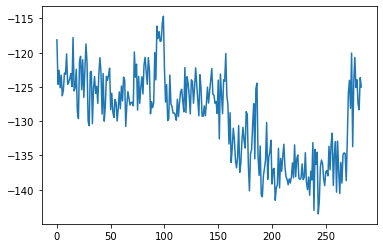

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 284, reward = -130.423553


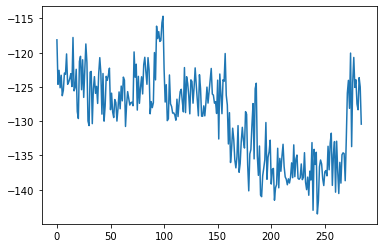

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 285, reward = -122.220642


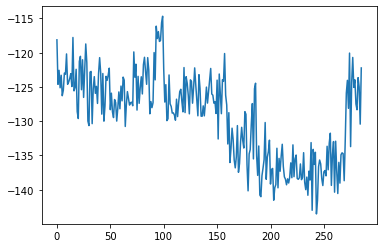

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 286, reward = -123.129913


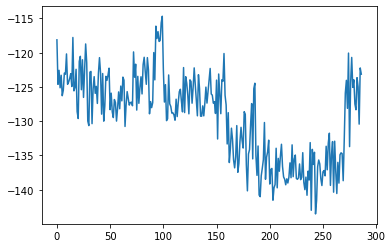

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 287, reward = -127.965599


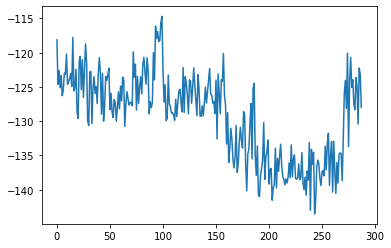

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 288, reward = -127.349274


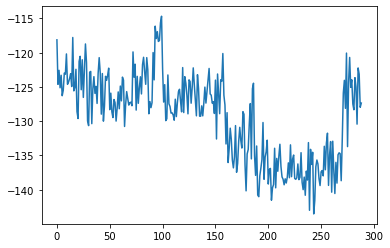

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 289, reward = -124.717308


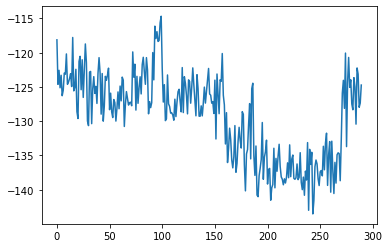

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 290, reward = -126.989319


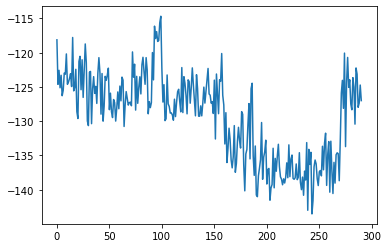

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 291, reward = -125.985878


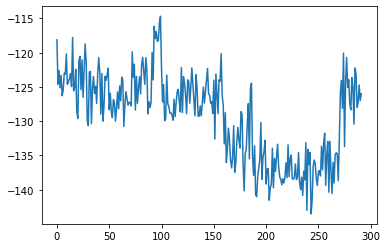

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 292, reward = -123.953194


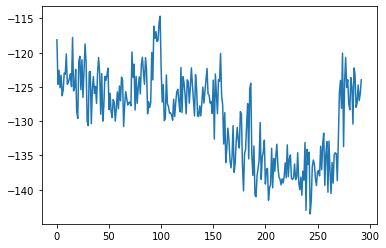

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 293, reward = -123.643700


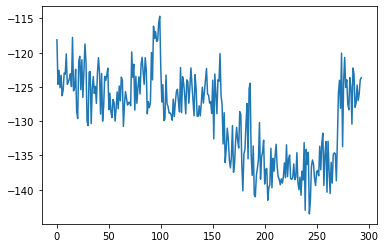

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 294, reward = -125.742813


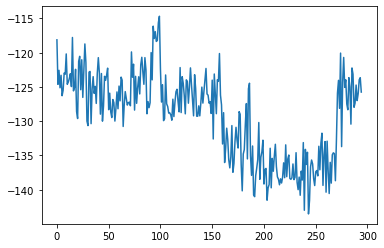

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 295, reward = -126.007370


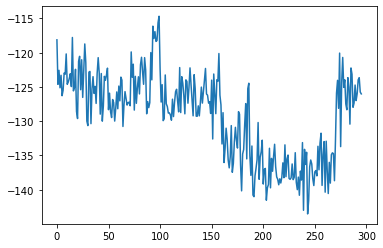

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 296, reward = -123.063057


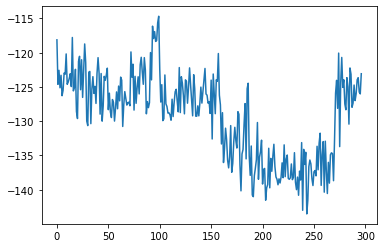

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 297, reward = -124.169243


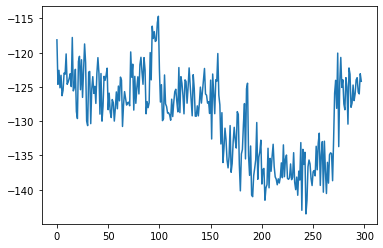

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 298, reward = -125.980186


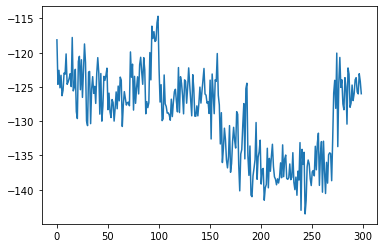

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 299, reward = -133.269501


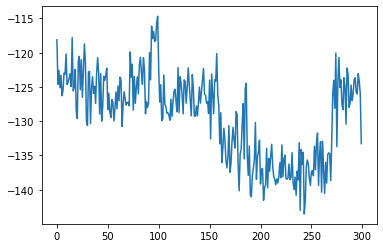

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 300, reward = -122.676666


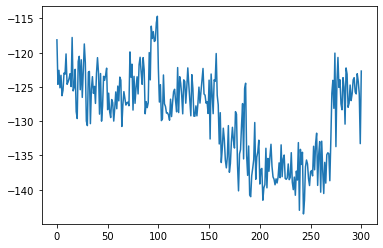

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 301, reward = -125.996483


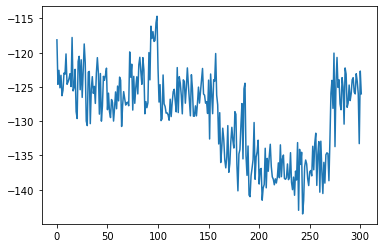

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 302, reward = -125.644508


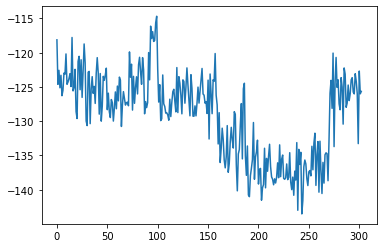

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 303, reward = -122.686020


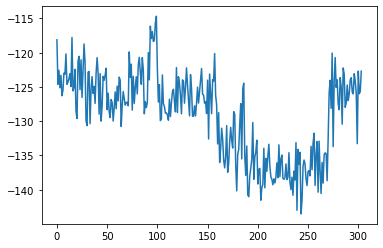

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 304, reward = -124.985641


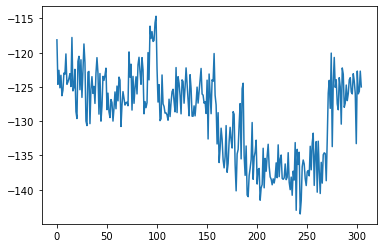

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 305, reward = -122.852470


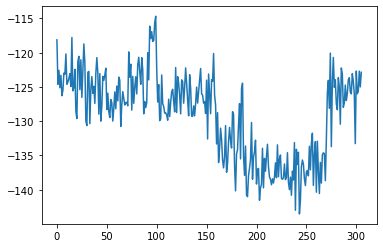

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 306, reward = -121.945801


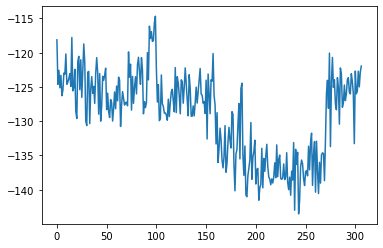

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 307, reward = -124.857903


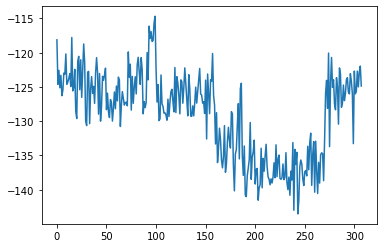

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 308, reward = -132.816147


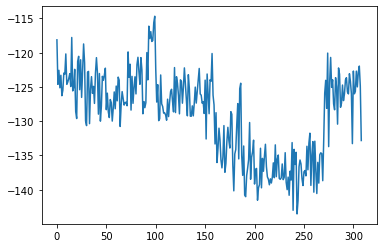

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 309, reward = -127.718468


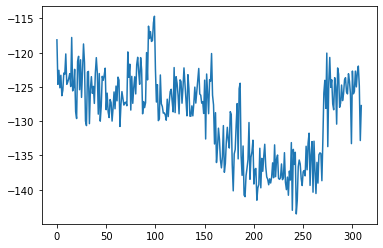

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 310, reward = -124.120872


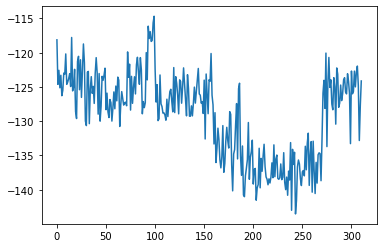

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 311, reward = -126.111237


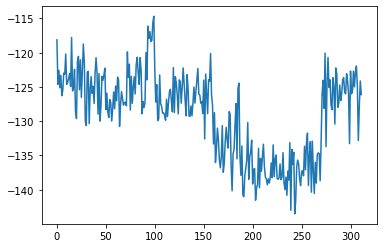

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 312, reward = -129.987305


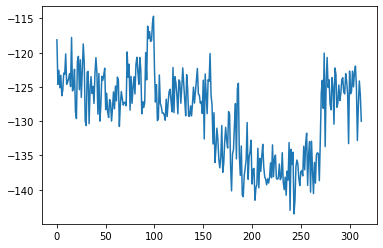

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 313, reward = -126.107826


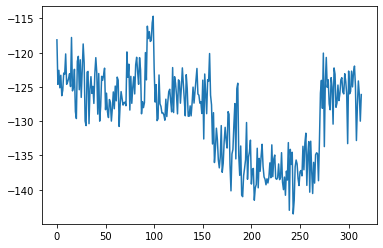

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 314, reward = -126.015427


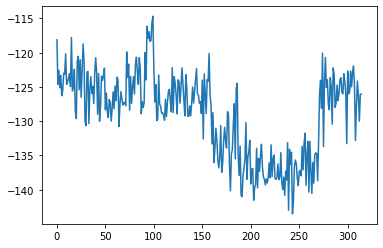

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 315, reward = -125.654243


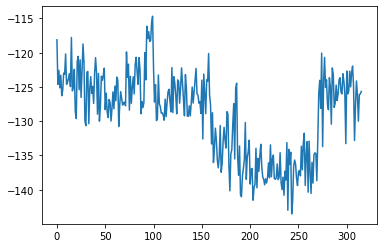

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 316, reward = -125.173508


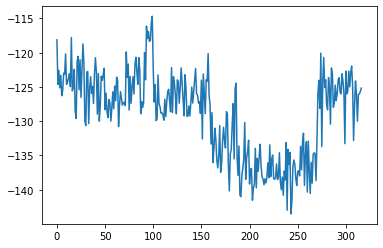

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 317, reward = -122.732056


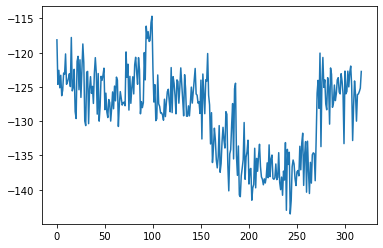

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 318, reward = -129.125885


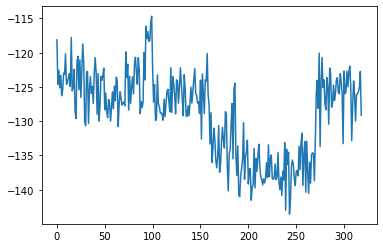

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 319, reward = -125.333389


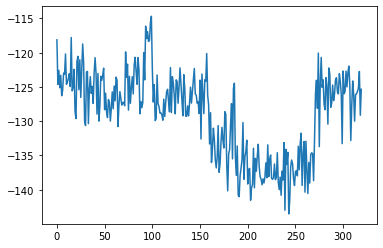

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 320, reward = -119.006523


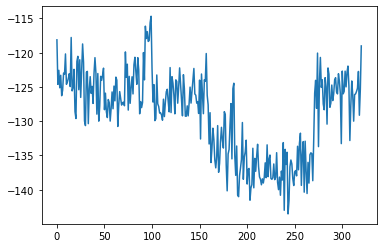

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 321, reward = -132.767578


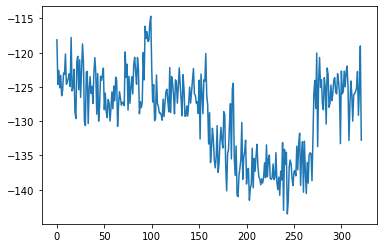

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 322, reward = -128.281128


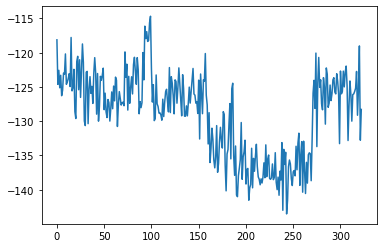

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 323, reward = -130.282196


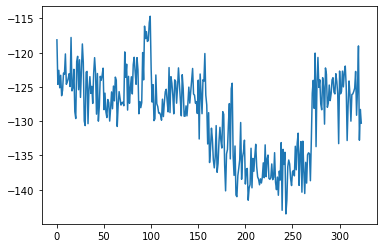

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 324, reward = -124.842041


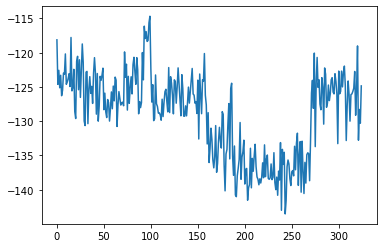

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 325, reward = -125.032104


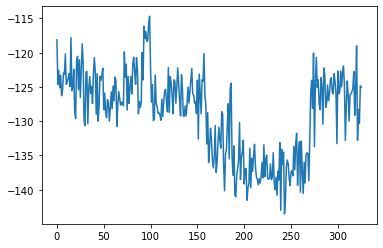

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 326, reward = -126.443176


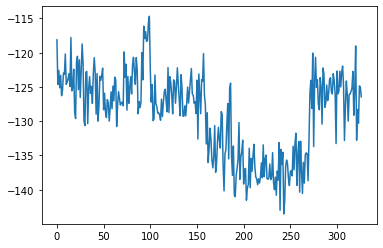

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 327, reward = -121.968407


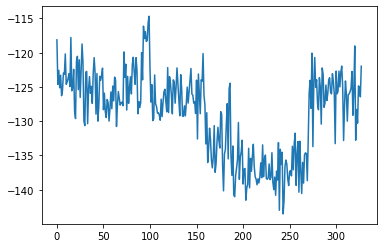

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 328, reward = -126.690376


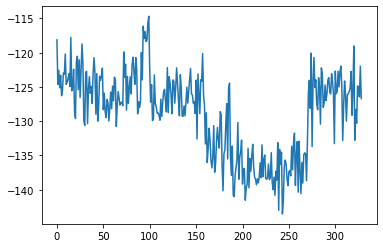

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 329, reward = -126.890572


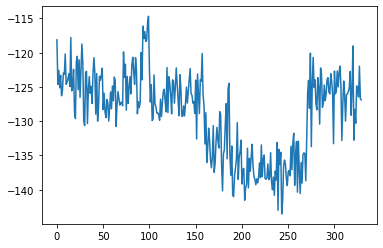

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 330, reward = -124.512245


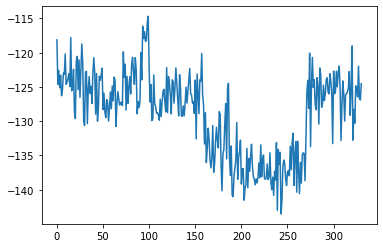

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 331, reward = -130.185181


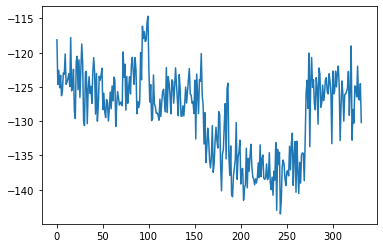

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 332, reward = -127.078079


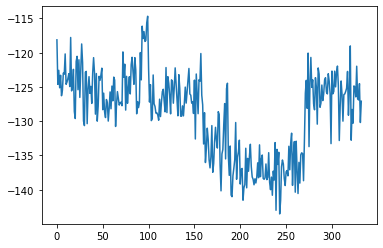

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 333, reward = -124.570122


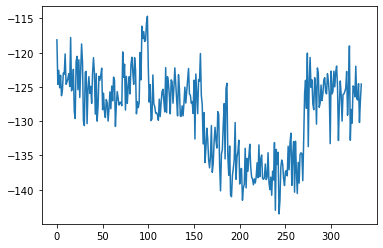

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 334, reward = -130.136597


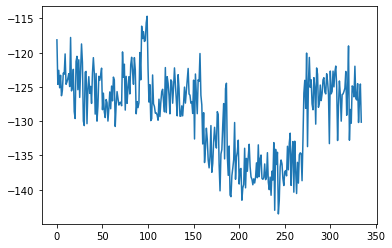

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 335, reward = -125.877457


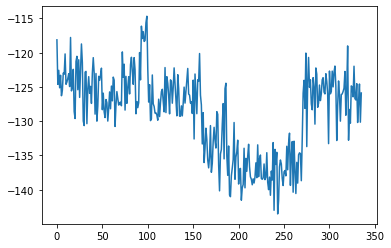

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 336, reward = -125.072899


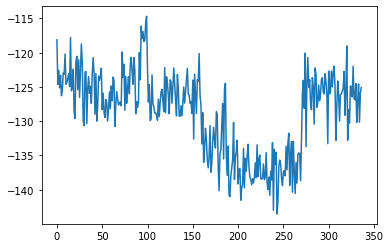

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 337, reward = -126.236115


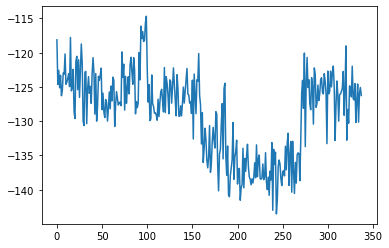

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 338, reward = -124.201233


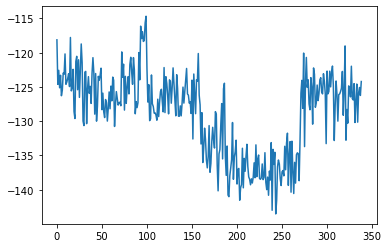

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 339, reward = -121.171463


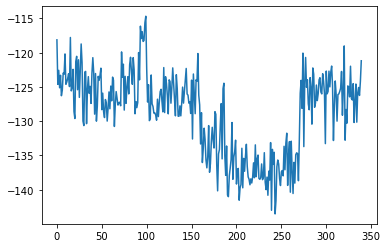

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 340, reward = -125.769539


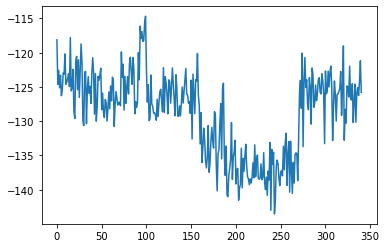

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 341, reward = -125.520363


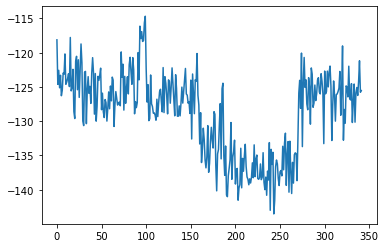

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 342, reward = -124.627167


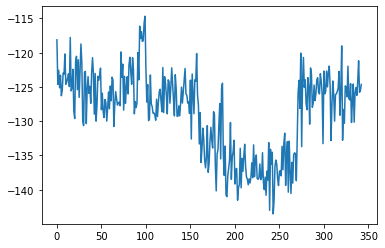

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 343, reward = -125.055527


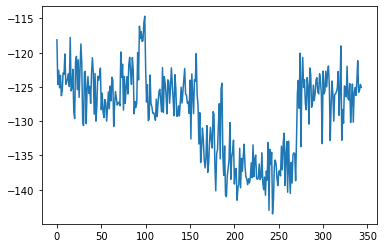

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 344, reward = -122.984802


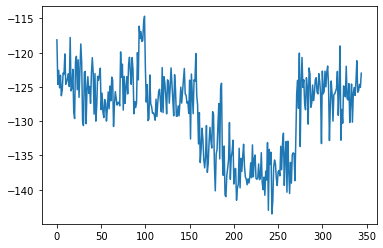

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 345, reward = -129.494949


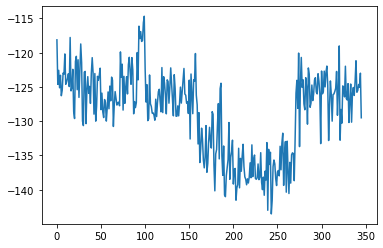

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 346, reward = -129.382324


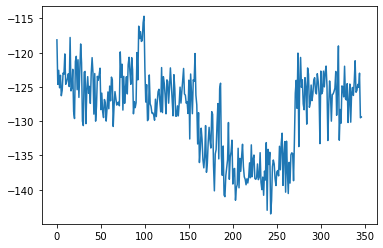

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 347, reward = -123.747284


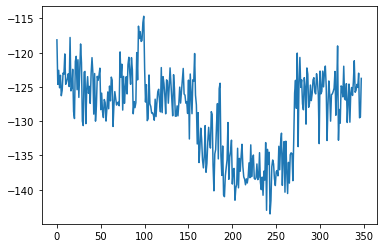

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 348, reward = -124.910950


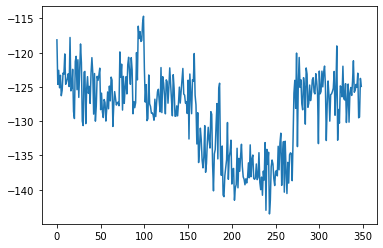

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 349, reward = -124.943123


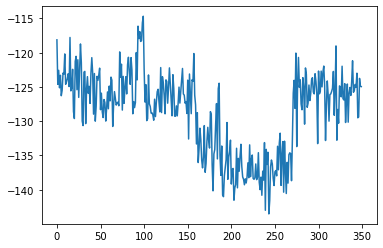

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 350, reward = -120.050133


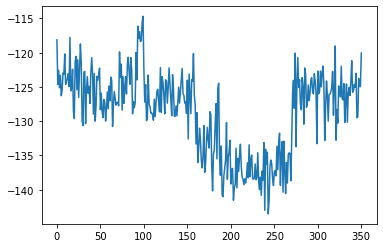

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 351, reward = -123.600357


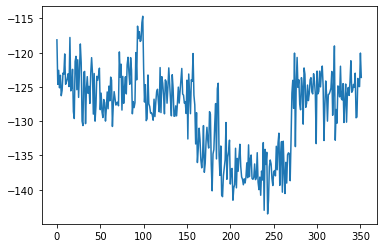

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 352, reward = -125.170616


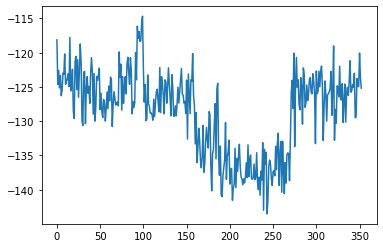

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 353, reward = -128.531830


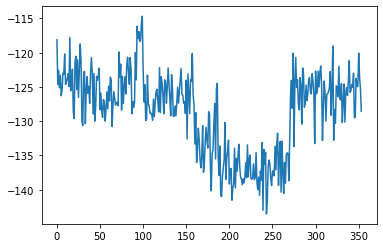

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 354, reward = -128.254913


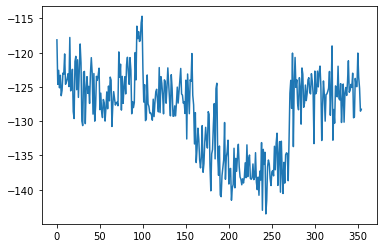

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 355, reward = -123.113953


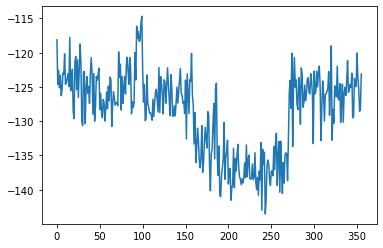

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 356, reward = -126.295410


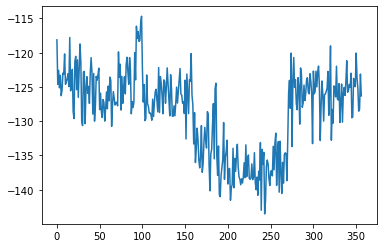

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 357, reward = -124.228836


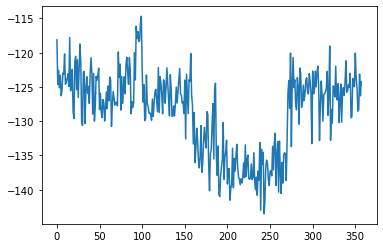

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 358, reward = -126.600426


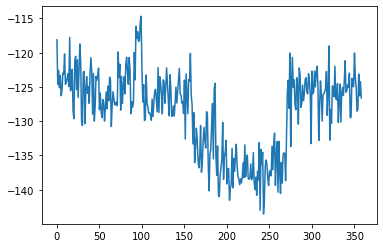

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 359, reward = -127.881752


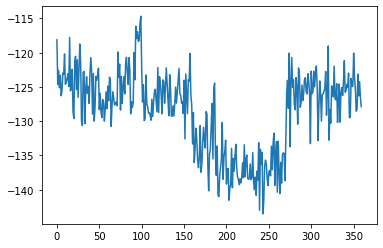

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 360, reward = -126.940674


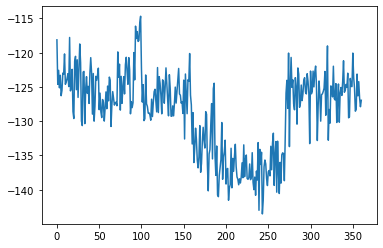

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 361, reward = -125.200996


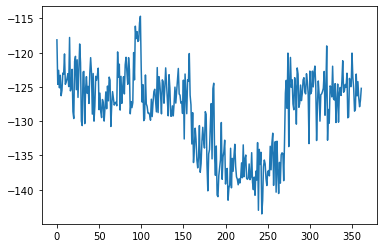

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 362, reward = -130.461639


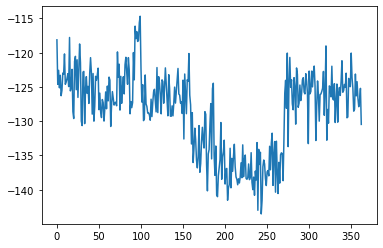

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 363, reward = -125.431778


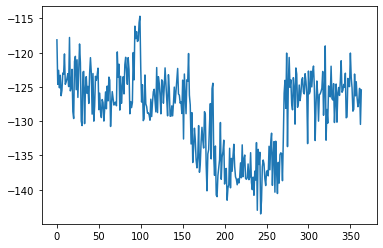

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 364, reward = -124.966797


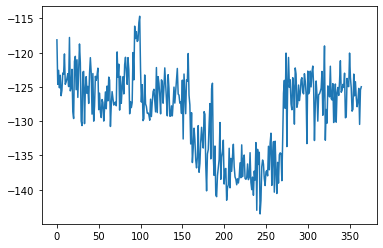

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 365, reward = -128.996689


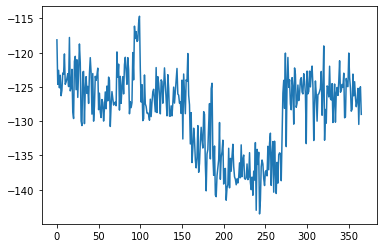

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 366, reward = -128.619400


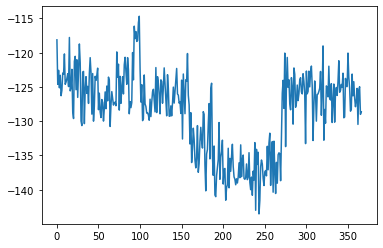

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 367, reward = -126.718643


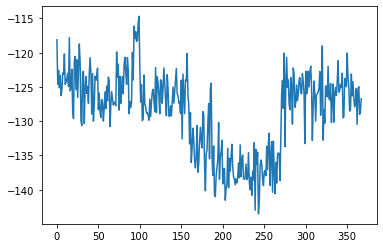

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 368, reward = -132.156647


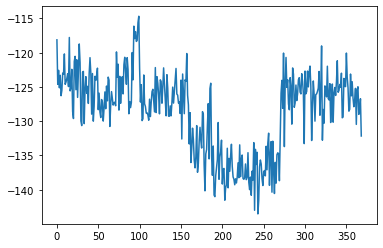

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 369, reward = -125.771645


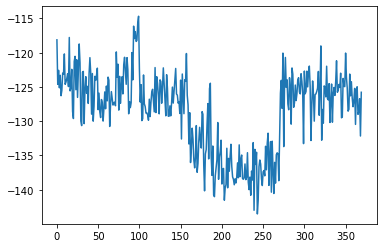

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 370, reward = -126.479553


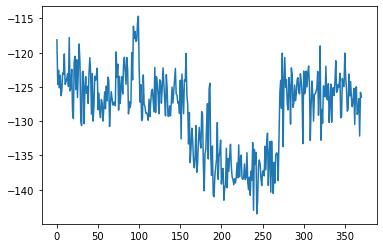

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 371, reward = -125.536308


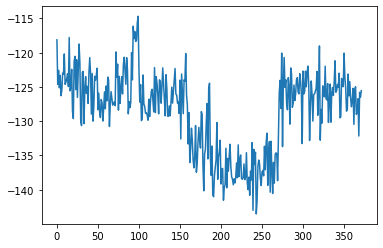

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 372, reward = -126.346825


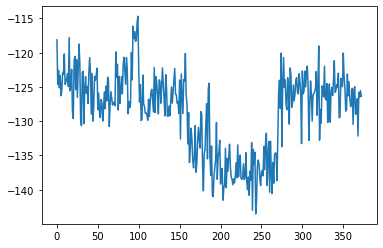

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 373, reward = -128.480682


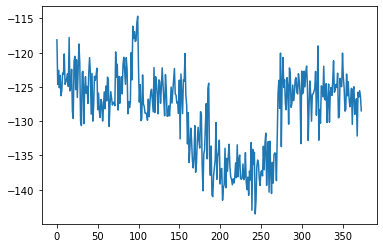

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 374, reward = -126.203842


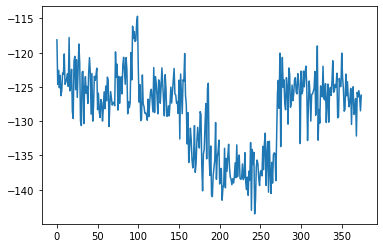

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 375, reward = -127.142227


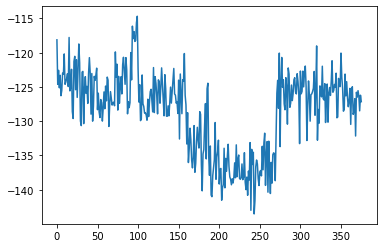

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 376, reward = -123.127342


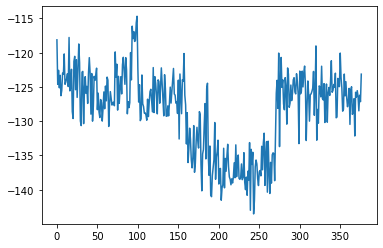

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 377, reward = -127.981407


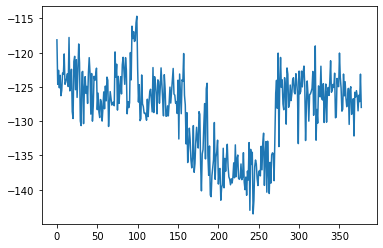

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 378, reward = -125.991264


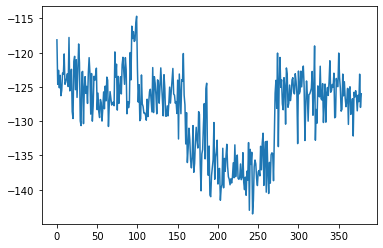

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 379, reward = -127.480362


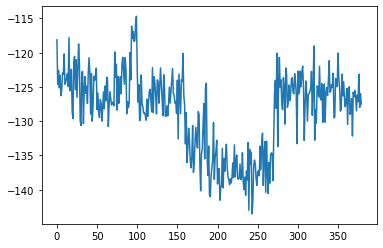

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 380, reward = -127.535721


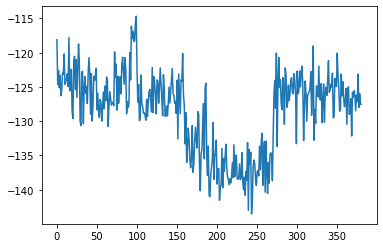

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 381, reward = -123.409828


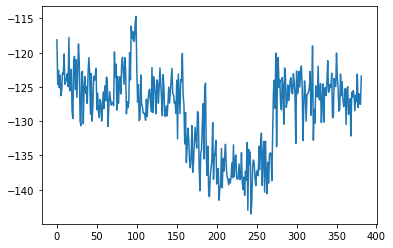

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 382, reward = -127.295792


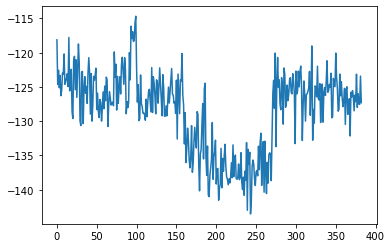

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 383, reward = -120.902748


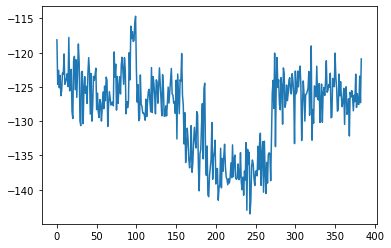

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 384, reward = -132.412811


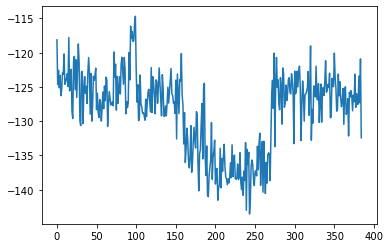

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 385, reward = -129.466904


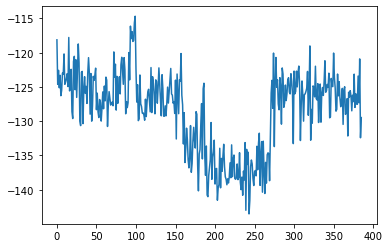

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 386, reward = -119.876419


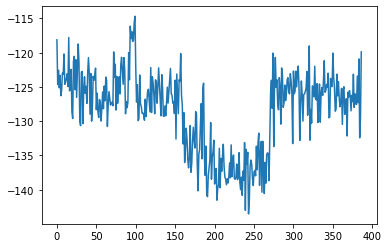

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 387, reward = -125.109467


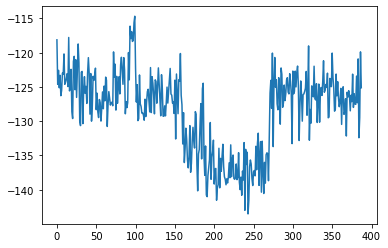

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 388, reward = -122.014252


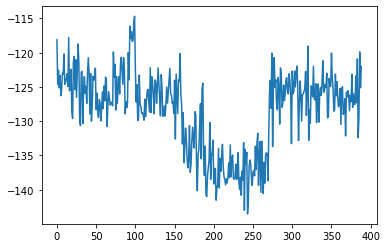

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 389, reward = -126.226913


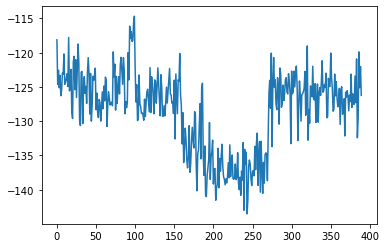

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 390, reward = -124.049286


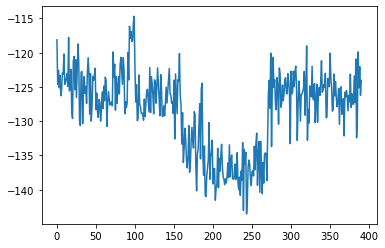

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 391, reward = -120.982231


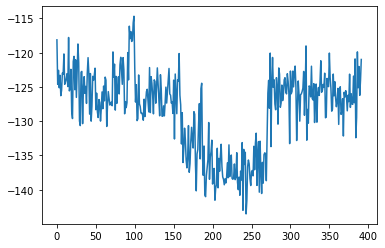

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 392, reward = -125.817841


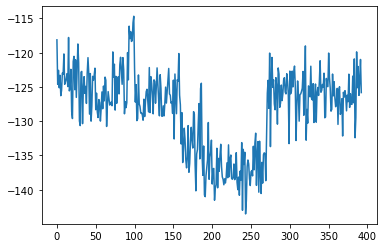

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 393, reward = -130.813446


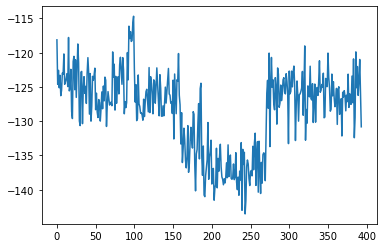

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 394, reward = -126.977325


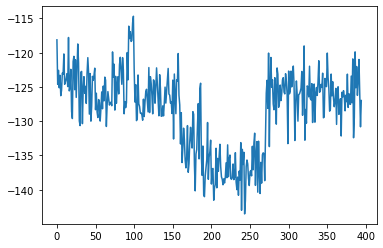

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 395, reward = -126.023132


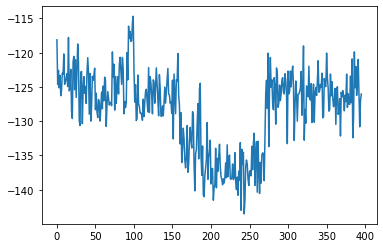

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 396, reward = -125.046783


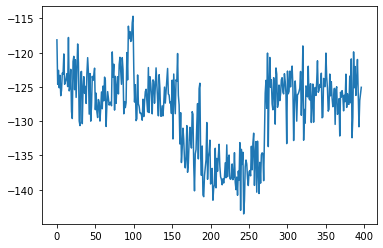

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 397, reward = -125.233971


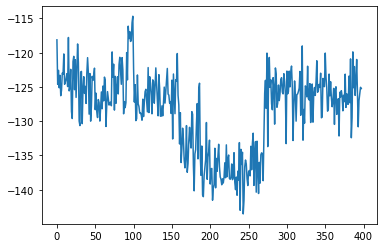

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 398, reward = -126.803253


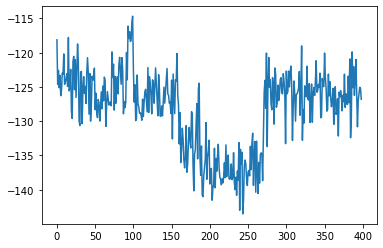

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 399, reward = -126.419479


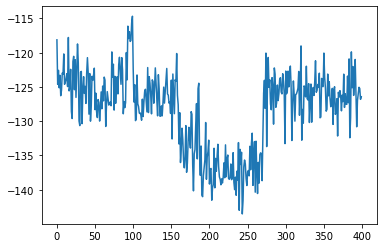

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 400, reward = -124.181152


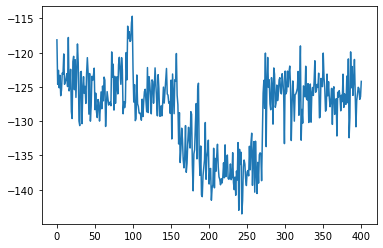

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 401, reward = -122.984764


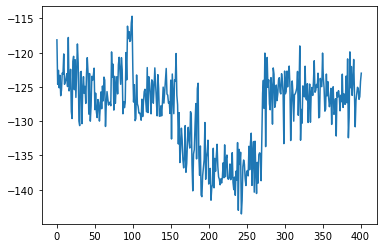

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 402, reward = -127.068985


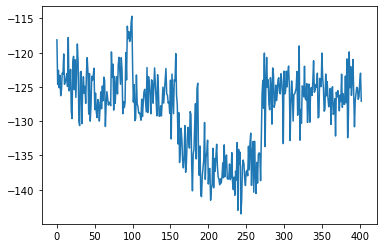

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 403, reward = -126.615303


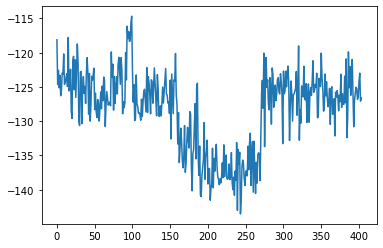

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 404, reward = -125.213837


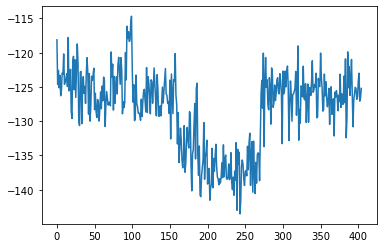

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 405, reward = -132.154404


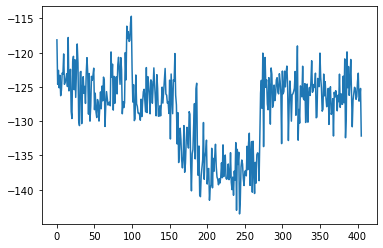

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 406, reward = -121.265999


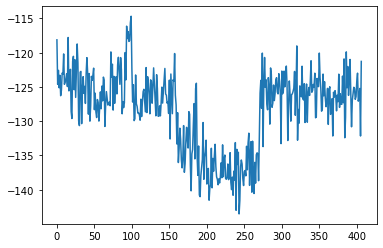

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 407, reward = -124.397705


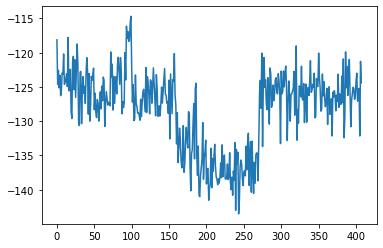

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 408, reward = -126.727890


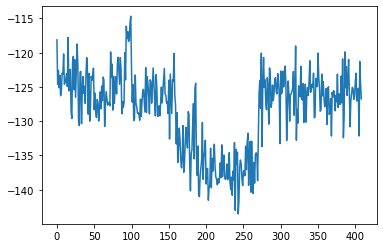

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 409, reward = -127.070747


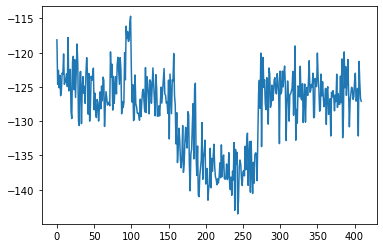

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 410, reward = -129.324112


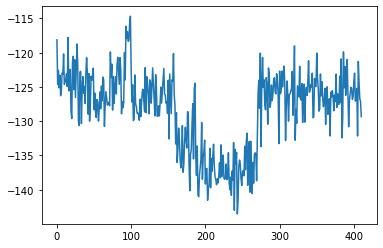

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 411, reward = -119.768929


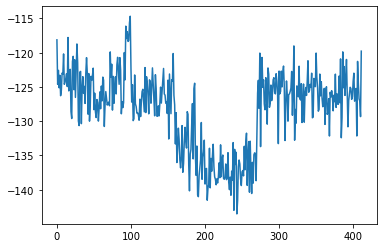

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 412, reward = -125.669319


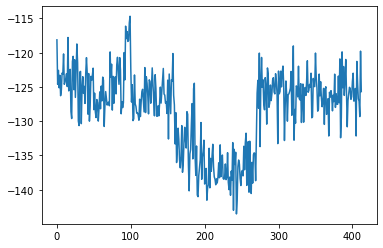

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 413, reward = -129.644562


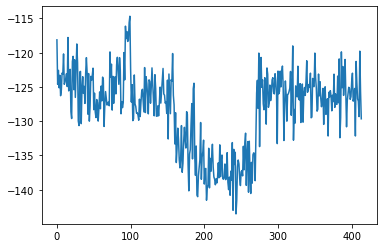

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 414, reward = -128.328659


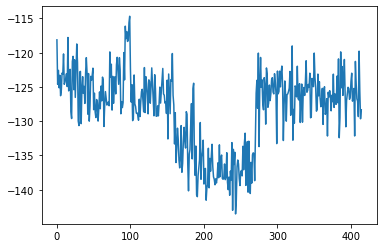

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 415, reward = -122.986923


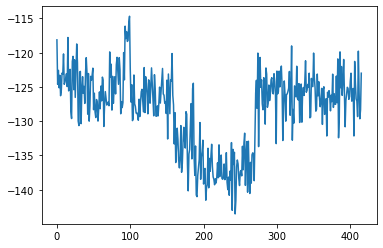

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 416, reward = -122.868401


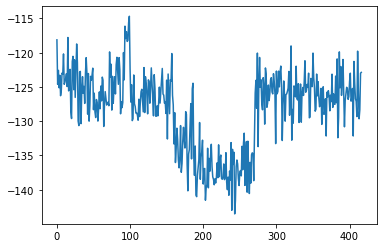

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 417, reward = -125.779549


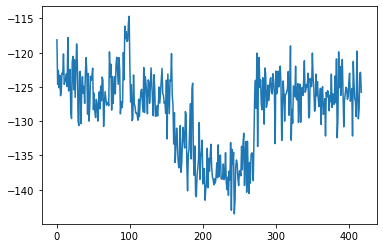

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 418, reward = -125.409889


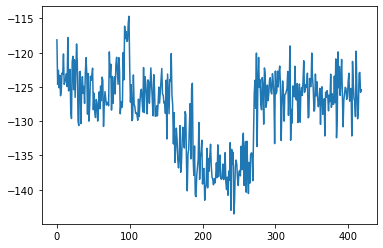

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 419, reward = -129.494232


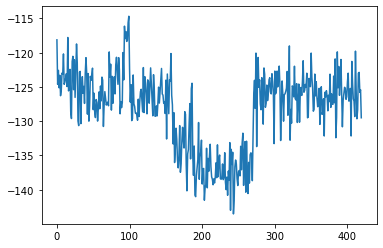

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 420, reward = -133.347656


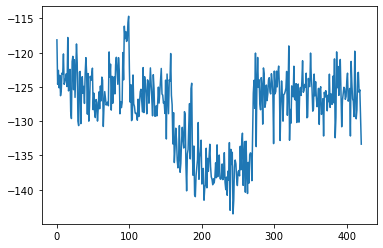

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 421, reward = -124.507042


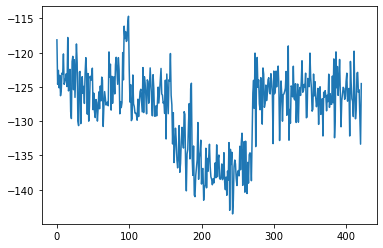

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 422, reward = -123.457970


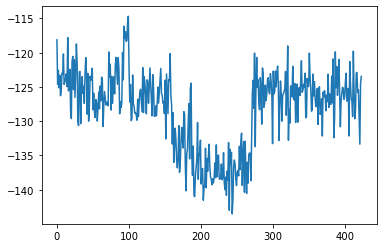

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 423, reward = -124.761177


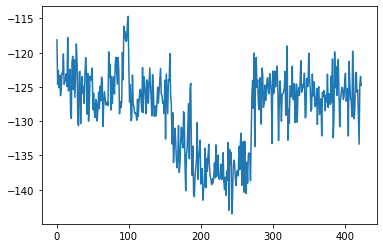

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 424, reward = -121.874557


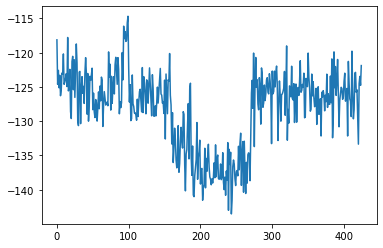

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 425, reward = -125.934196


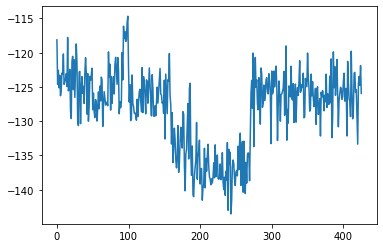

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 426, reward = -128.012848


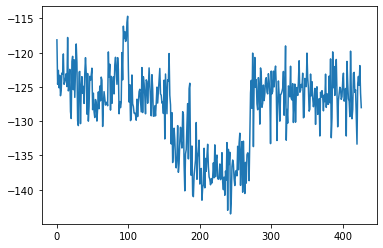

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 427, reward = -128.369156


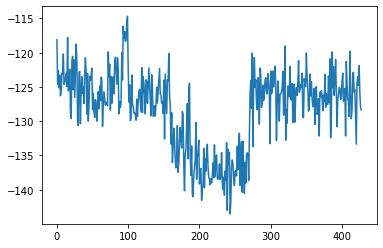

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 428, reward = -125.991966


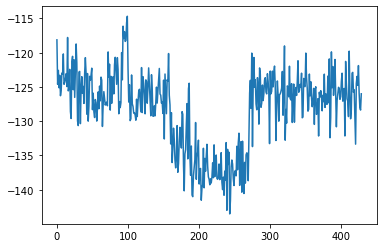

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 429, reward = -124.753265


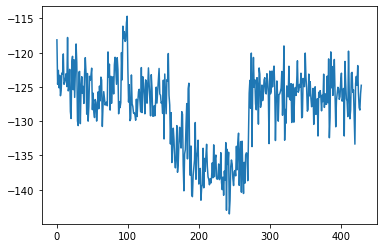

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 430, reward = -126.812096


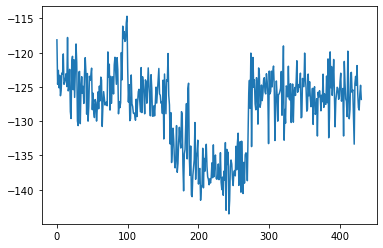

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 431, reward = -130.232788


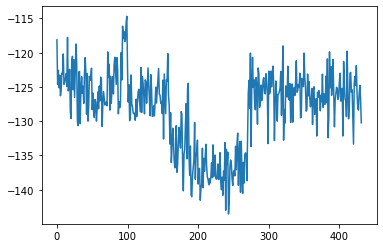

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 432, reward = -123.350334


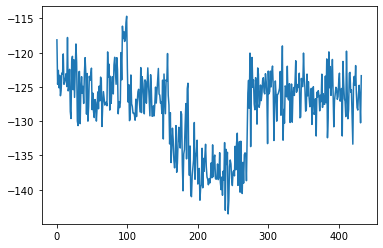

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 433, reward = -130.116806


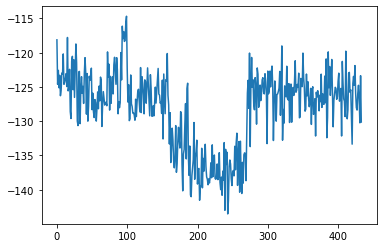

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 434, reward = -127.593636


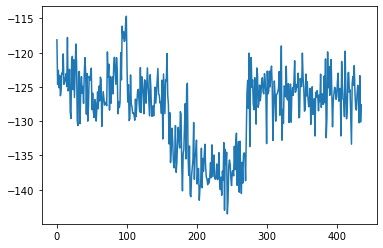

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 435, reward = -131.424835


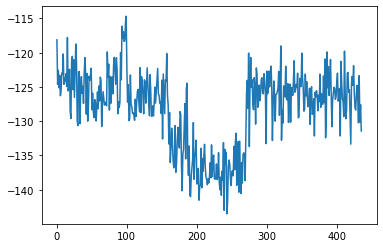

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 436, reward = -124.327171


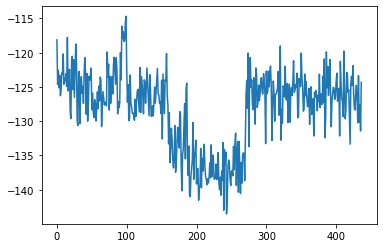

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 437, reward = -120.871872


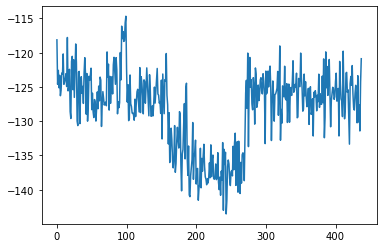

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 438, reward = -126.531494


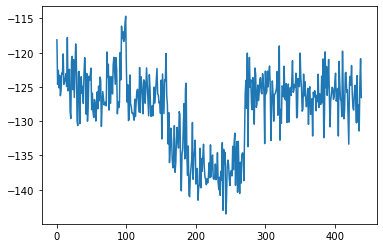

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 439, reward = -123.786972


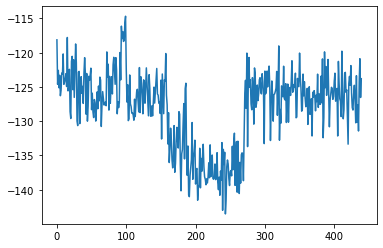

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 440, reward = -125.514412


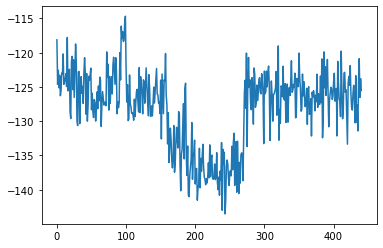

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 441, reward = -125.050697


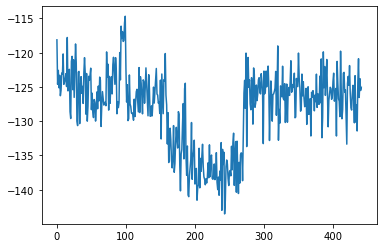

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 442, reward = -128.568268


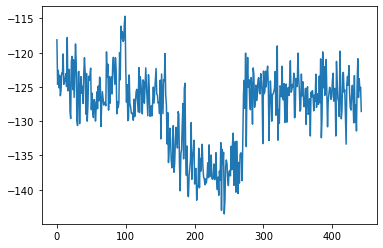

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 443, reward = -122.814690


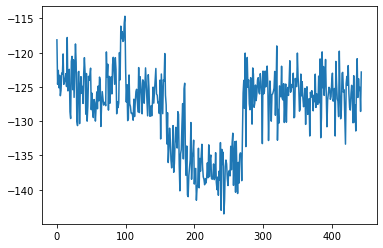

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 444, reward = -123.455452


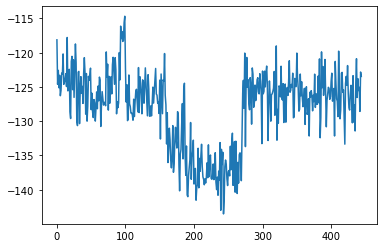

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 445, reward = -128.135117


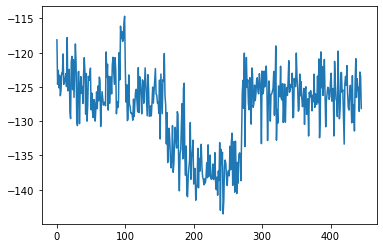

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 446, reward = -121.411209


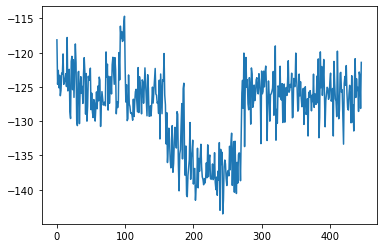

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 447, reward = -128.414398


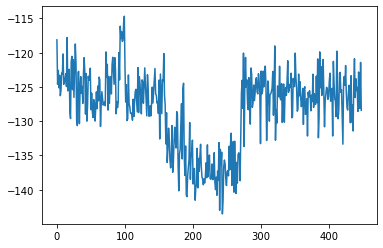

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 448, reward = -123.487968


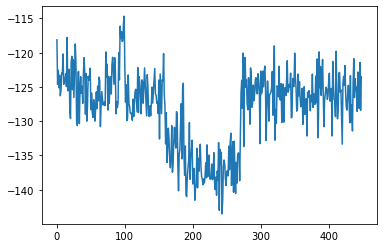

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 449, reward = -127.229713


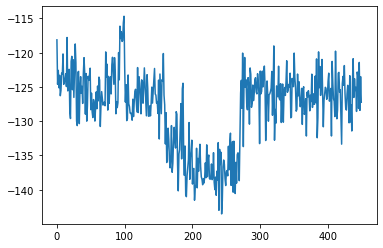

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 450, reward = -128.847504


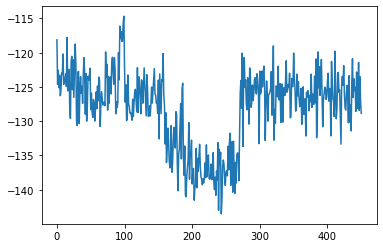

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 451, reward = -128.622421


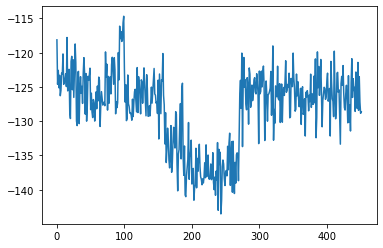

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 452, reward = -127.414391


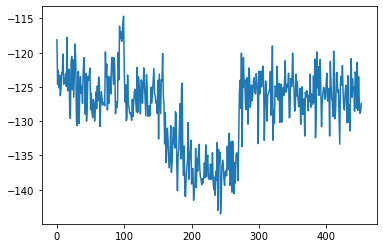

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 453, reward = -125.005531


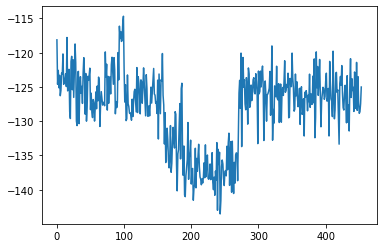

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 454, reward = -129.364136


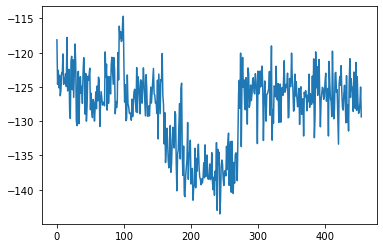

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 455, reward = -130.245026


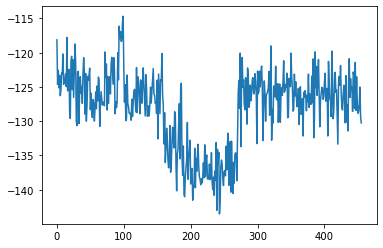

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 456, reward = -126.814400


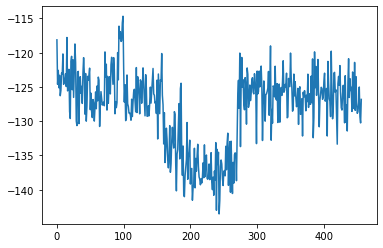

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 457, reward = -124.511871


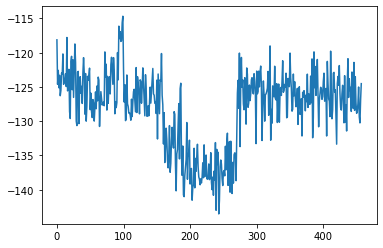

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 458, reward = -129.874771


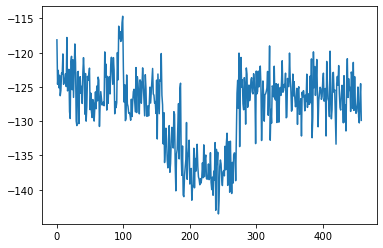

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 459, reward = -127.073753


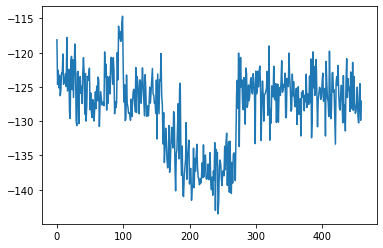

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 460, reward = -128.166275


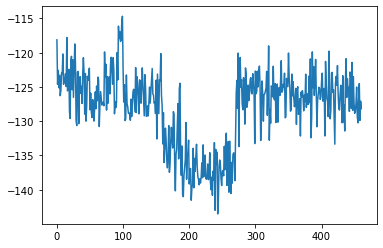

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 461, reward = -127.125618


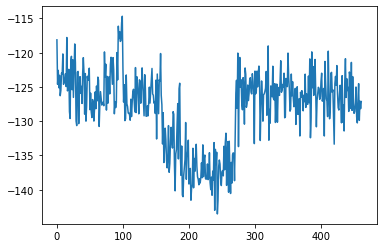

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 462, reward = -128.242661


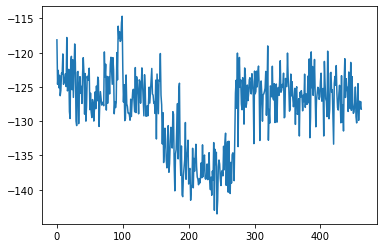

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 463, reward = -124.614395


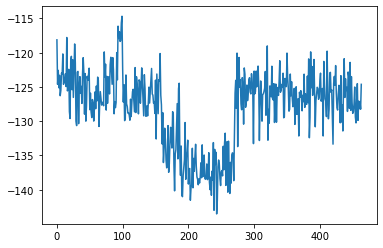

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 464, reward = -126.362480


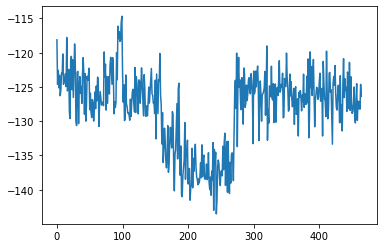

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 465, reward = -123.785385


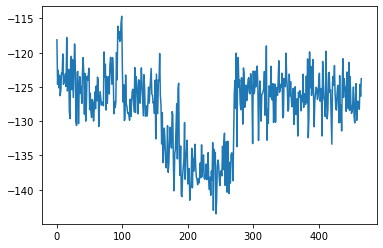

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 466, reward = -122.961548


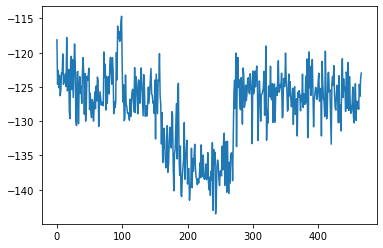

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 467, reward = -129.328705


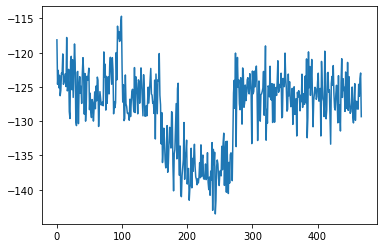

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 468, reward = -125.100594


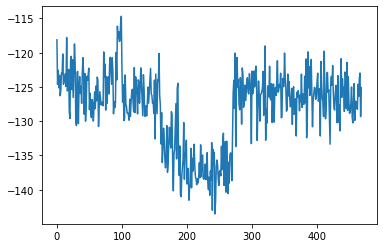

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 469, reward = -127.425446


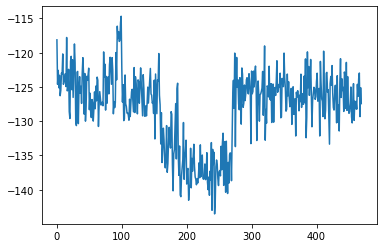

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 470, reward = -124.291145


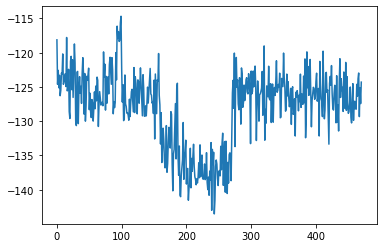

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 471, reward = -122.576546


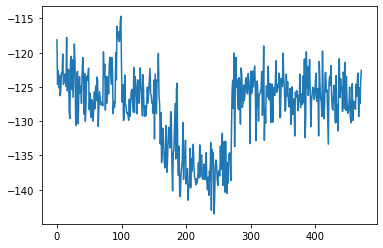

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 472, reward = -126.089790


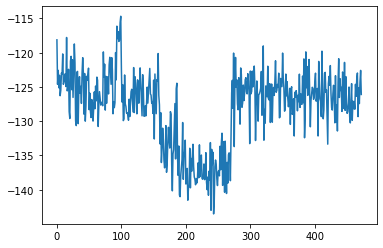

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 473, reward = -117.222260


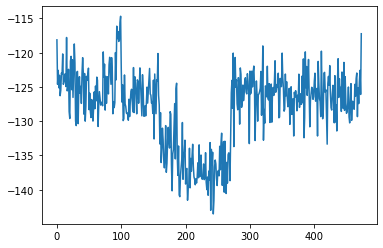

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 474, reward = -126.246681


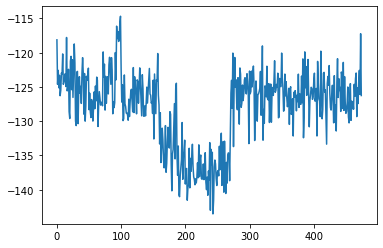

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 475, reward = -126.152260


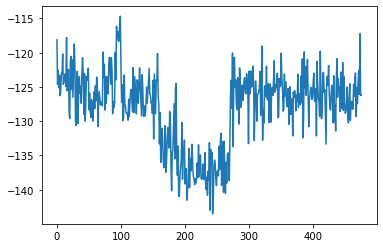

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 476, reward = -128.002502


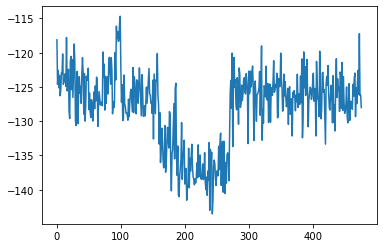

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 477, reward = -122.401077


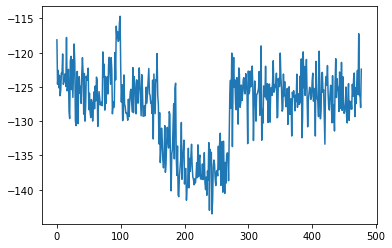

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 478, reward = -126.699959


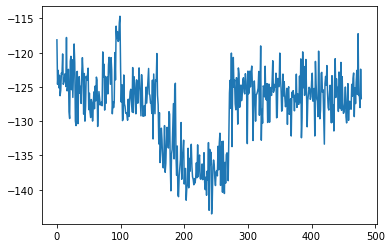

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 479, reward = -126.007896


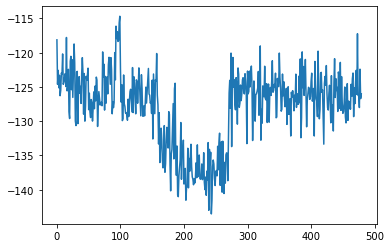

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 480, reward = -126.233582


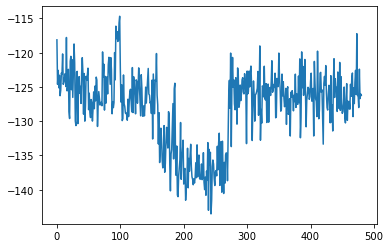

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 481, reward = -133.372604


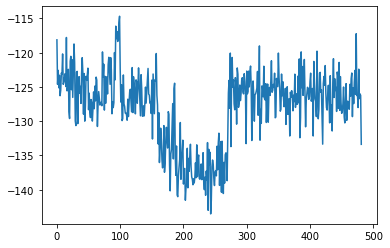

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 482, reward = -125.551407


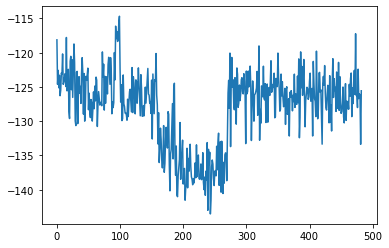

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 483, reward = -125.406891


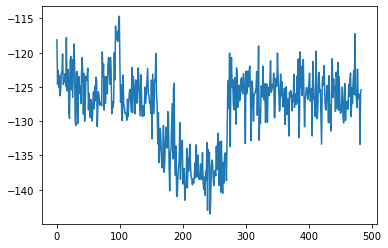

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 484, reward = -126.683037


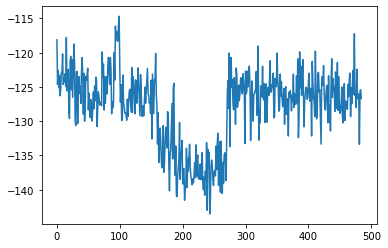

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 485, reward = -124.880875


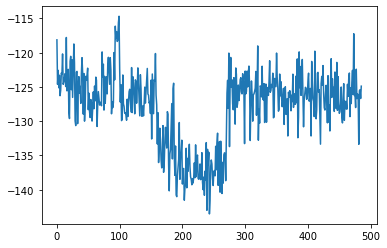

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 486, reward = -125.229568


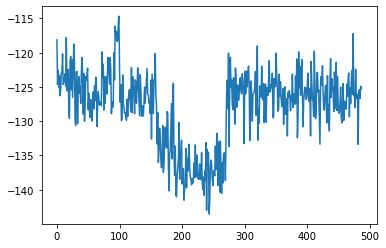

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 487, reward = -126.593842


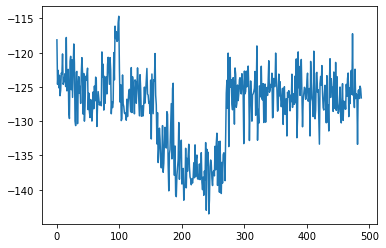

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 488, reward = -128.234558


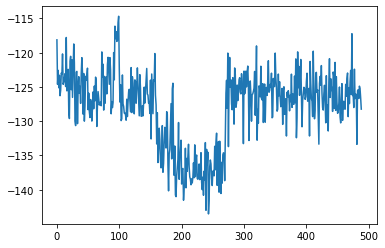

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 489, reward = -127.246902


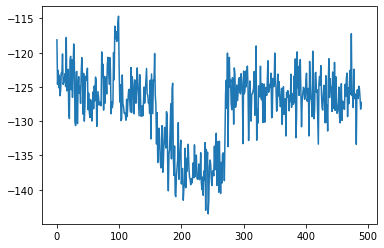

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 490, reward = -127.471970


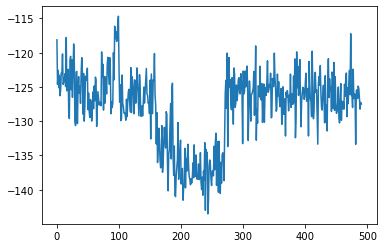

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 491, reward = -129.534256


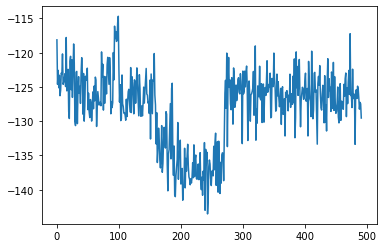

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 492, reward = -124.856026


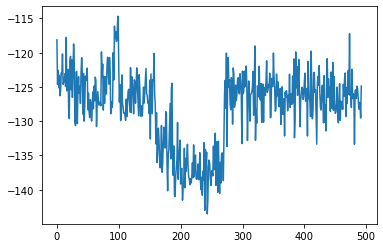

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 493, reward = -122.905266


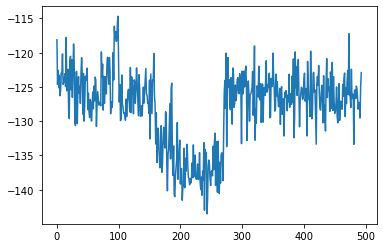

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 494, reward = -125.694786


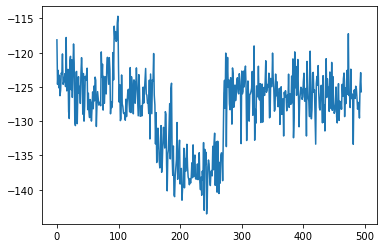

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 495, reward = -127.950417


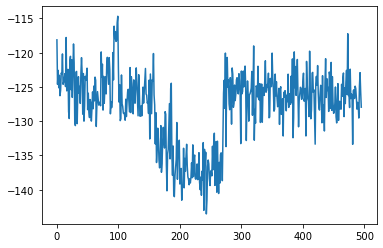

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 496, reward = -128.728470


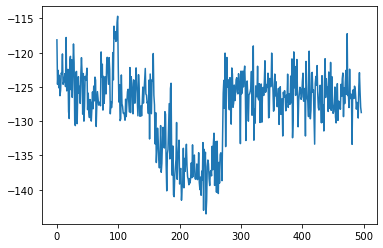

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 497, reward = -126.911224


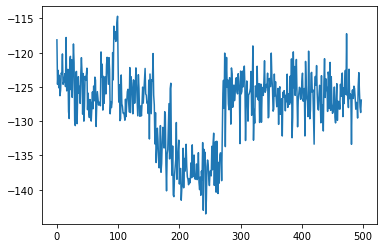

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 498, reward = -127.819710


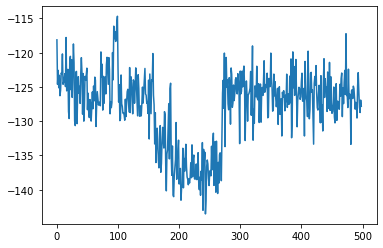

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 499, reward = -127.459862


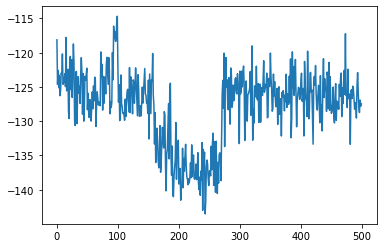

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 500, reward = -129.213486


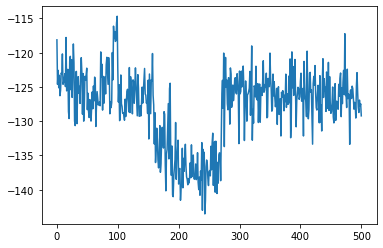

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 501, reward = -124.718430


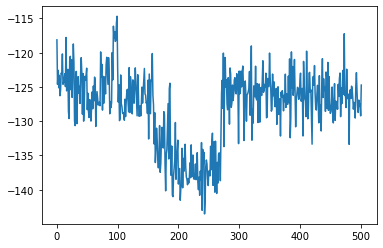

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 502, reward = -129.989624


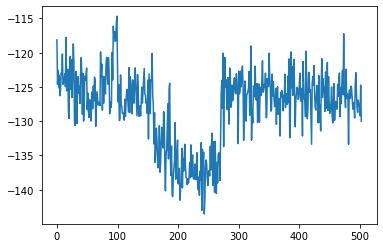

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 503, reward = -127.215691


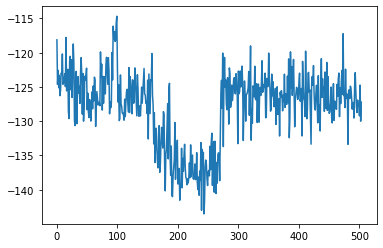

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 504, reward = -124.164452


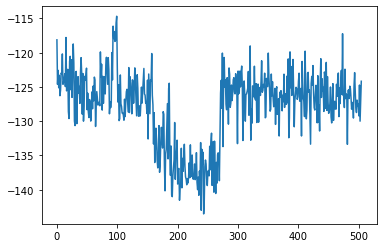

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 505, reward = -117.993149


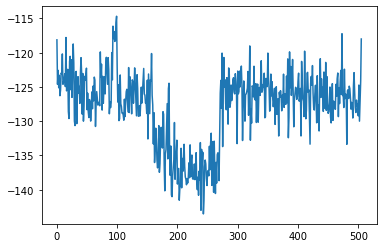

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 506, reward = -131.391846


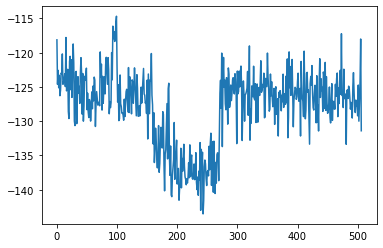

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 507, reward = -124.532463


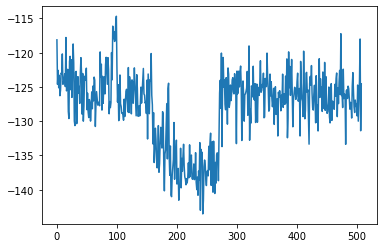

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 508, reward = -123.653252


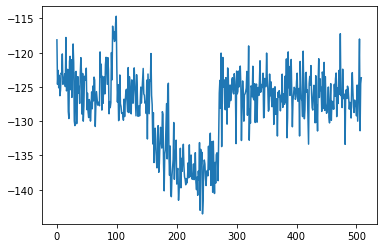

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 509, reward = -124.852310


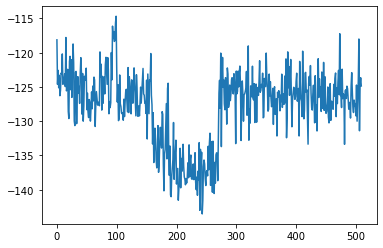

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 510, reward = -125.903275


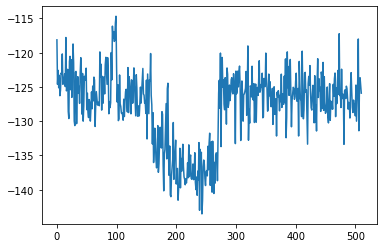

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 511, reward = -122.618500


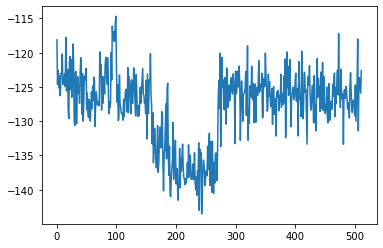

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 512, reward = -121.784492


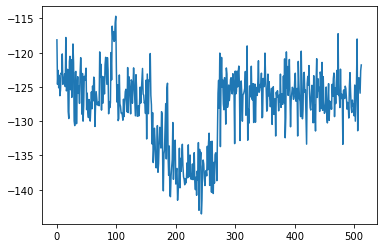

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 513, reward = -126.407623


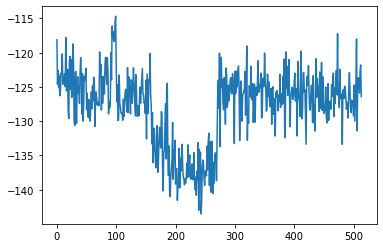

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 514, reward = -126.425980


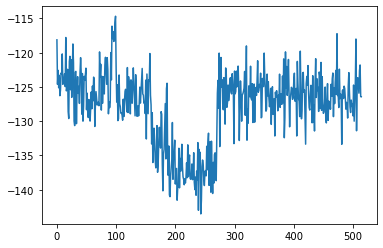

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 515, reward = -131.066513


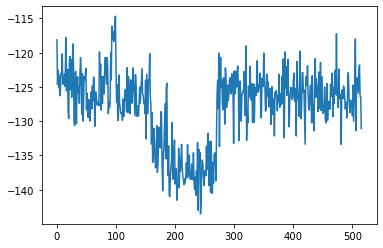

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 516, reward = -128.529480


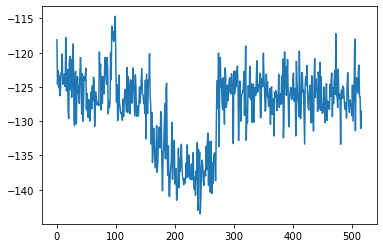

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 517, reward = -130.628662


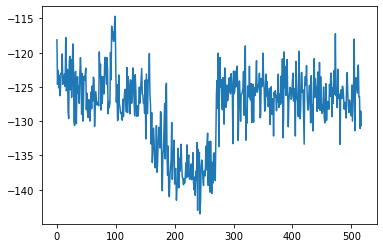

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 518, reward = -123.699104


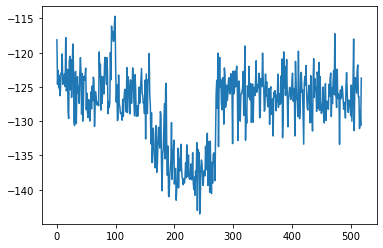

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 519, reward = -126.343155


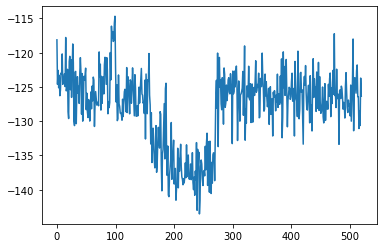

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 520, reward = -123.034645


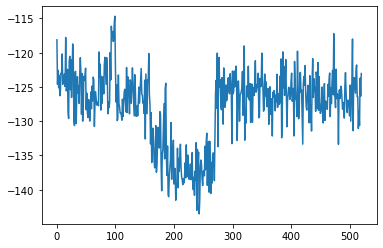

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 521, reward = -127.244209


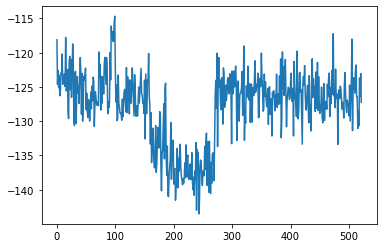

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 522, reward = -127.082298


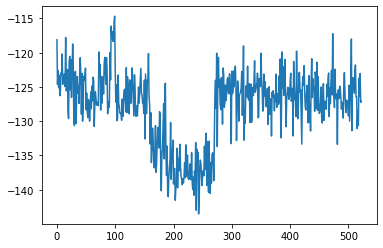

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 523, reward = -126.112572


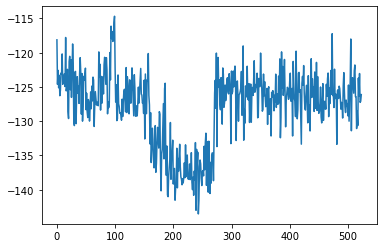

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 524, reward = -129.403503


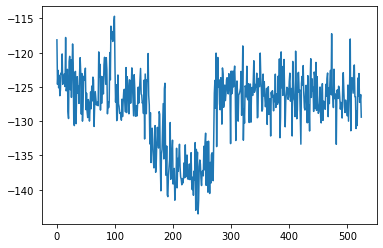

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 525, reward = -127.411392


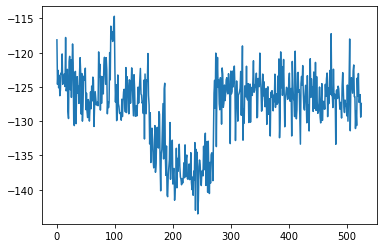

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 526, reward = -131.526184


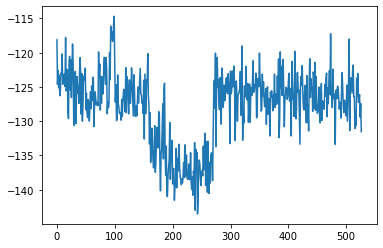

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 527, reward = -126.792290


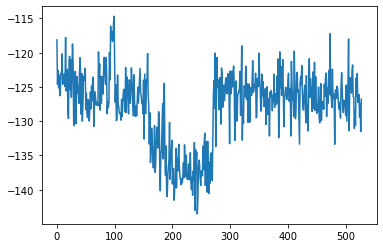

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 528, reward = -125.449272


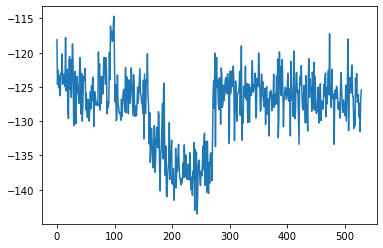

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 529, reward = -126.555252


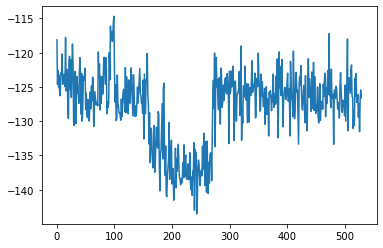

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 530, reward = -124.599174


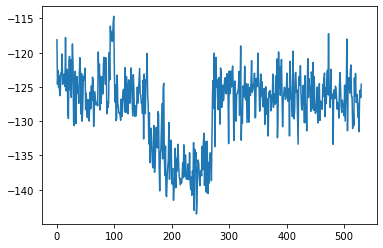

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 531, reward = -128.716766


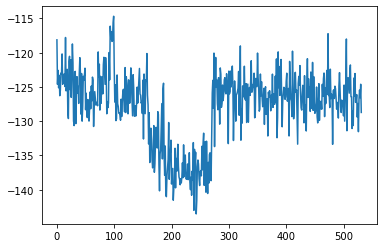

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 532, reward = -128.900436


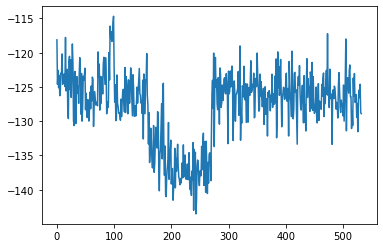

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 533, reward = -121.332611


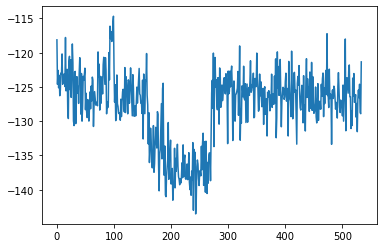

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 534, reward = -123.936028


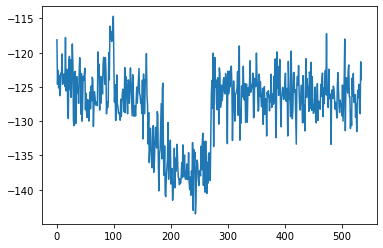

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 535, reward = -126.534691


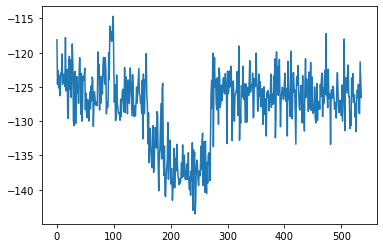

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 536, reward = -124.683960


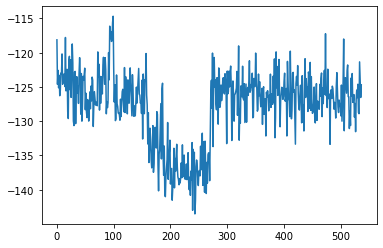

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 537, reward = -126.793587


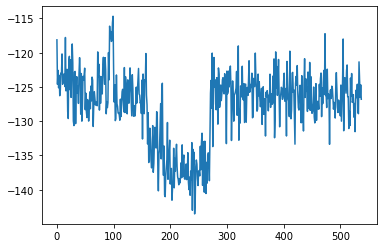

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 538, reward = -129.069534


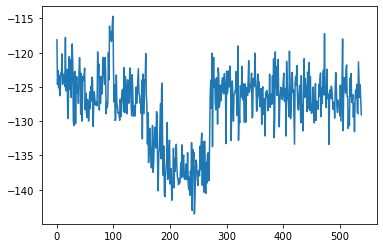

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 539, reward = -124.470848


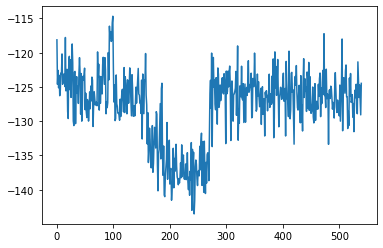

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 540, reward = -128.914291


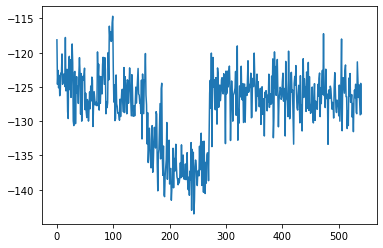

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 541, reward = -125.651833


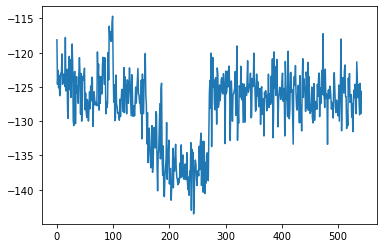

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 542, reward = -127.002815


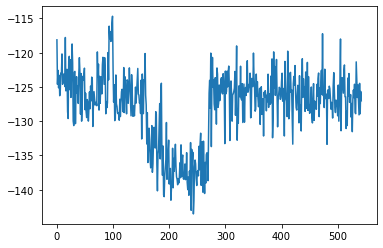

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 543, reward = -131.448242


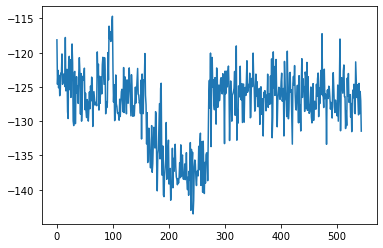

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 544, reward = -127.269440


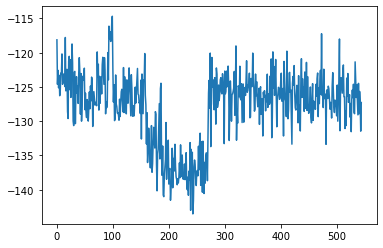

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 545, reward = -126.618538


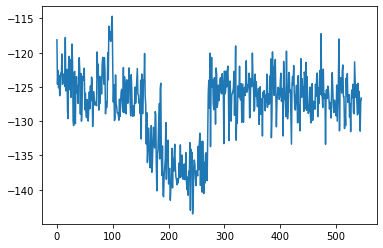

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 546, reward = -126.318970


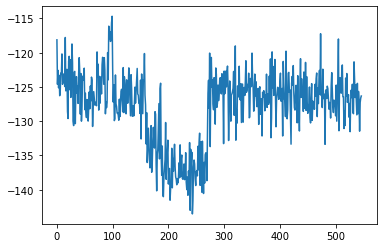

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 547, reward = -129.610733


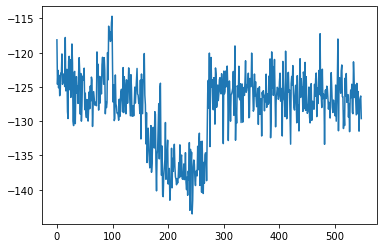

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 548, reward = -128.124268


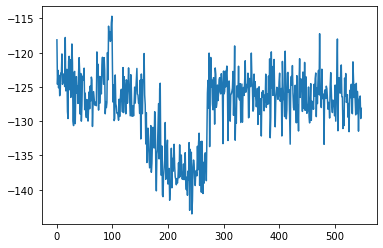

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 549, reward = -124.955330


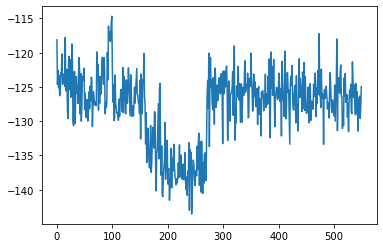

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 550, reward = -124.388649


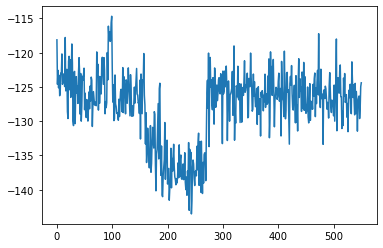

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 551, reward = -124.893463


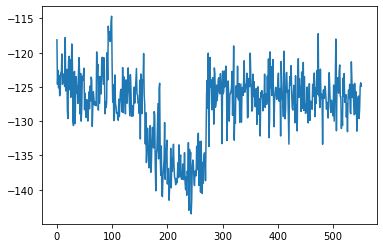

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 552, reward = -128.792694


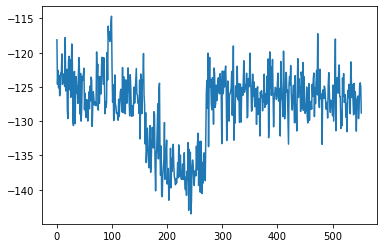

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 553, reward = -129.203659


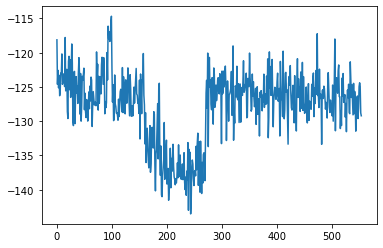

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 554, reward = -127.780434


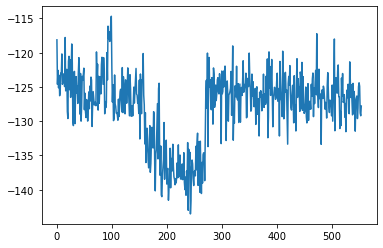

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 555, reward = -124.252762


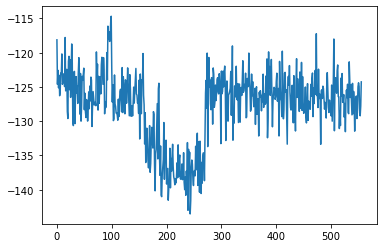

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 556, reward = -128.294846


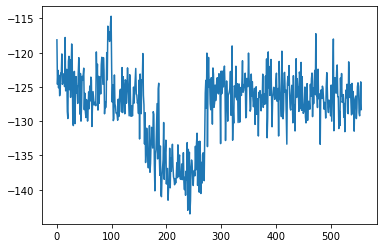

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 557, reward = -128.267792


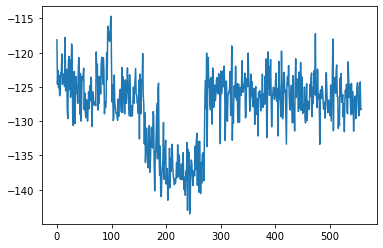

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 558, reward = -126.008255


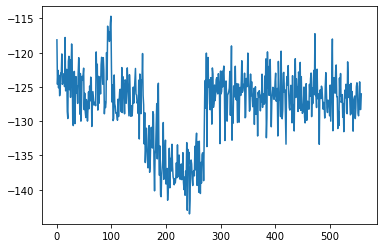

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 559, reward = -128.009277


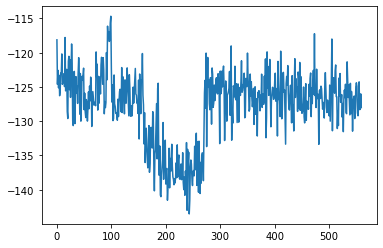

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 560, reward = -127.271065


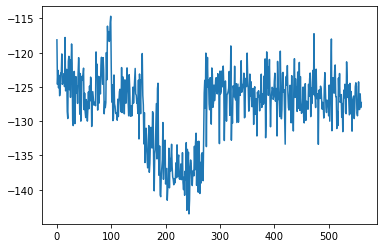

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 561, reward = -119.692749


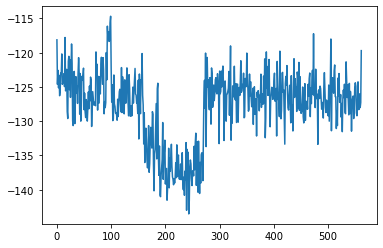

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 562, reward = -124.311729


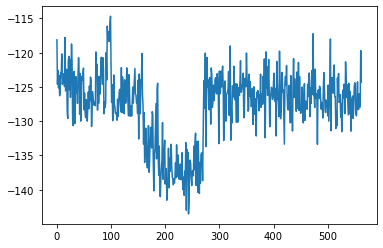

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 563, reward = -126.657684


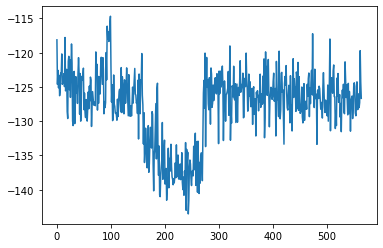

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 564, reward = -125.707344


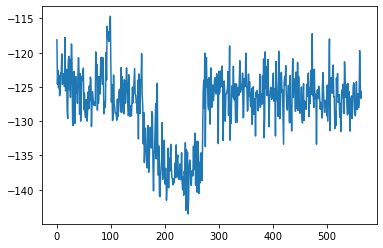

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 565, reward = -123.536461


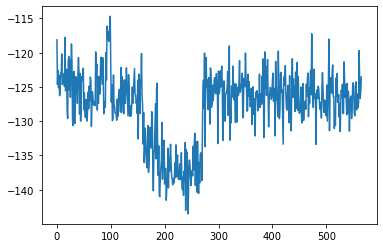

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 566, reward = -124.544823


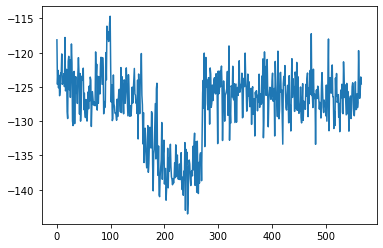

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 567, reward = -119.059998


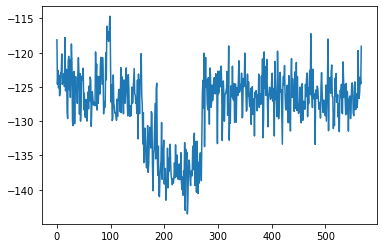

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 568, reward = -127.027870


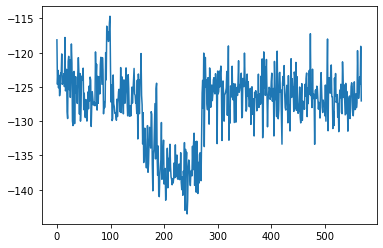

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 569, reward = -123.933380


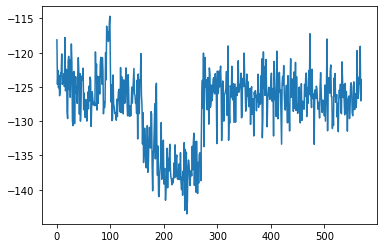

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 570, reward = -128.210983


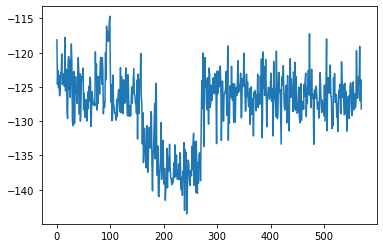

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 571, reward = -124.104416


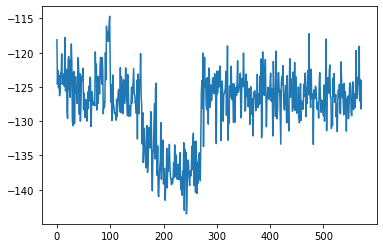

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 572, reward = -124.921494


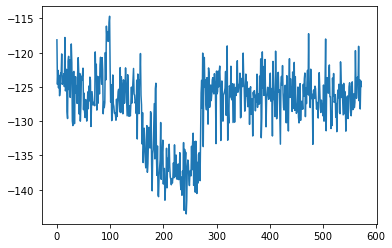

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 573, reward = -127.597679


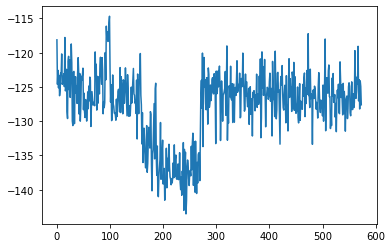

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 574, reward = -125.105919


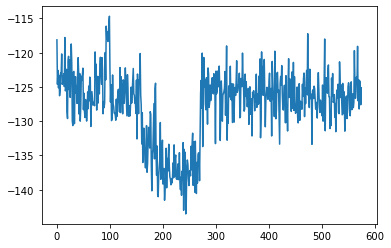

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 575, reward = -123.199898


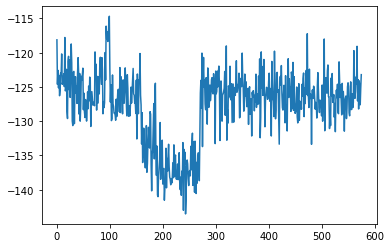

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 576, reward = -126.063095


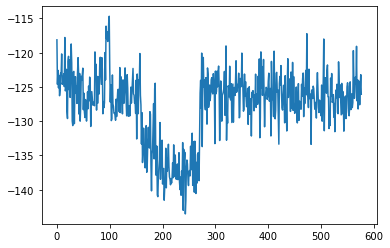

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 577, reward = -132.386826


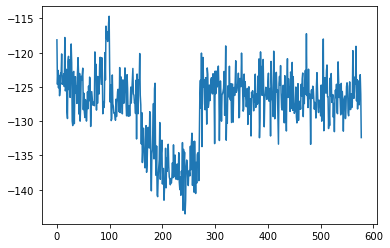

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 578, reward = -119.284149


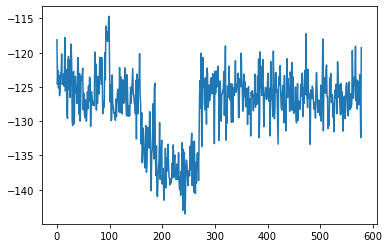

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 579, reward = -125.401672


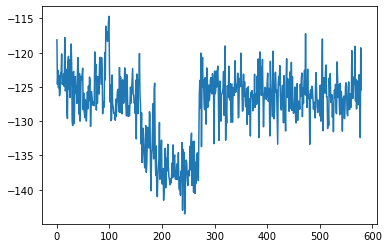

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 580, reward = -128.128799


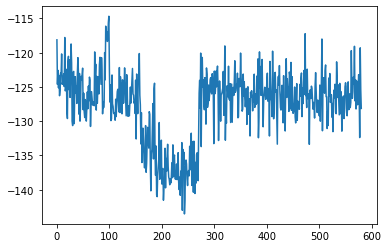

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 581, reward = -122.706558


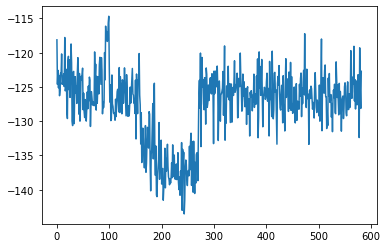

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 582, reward = -124.923317


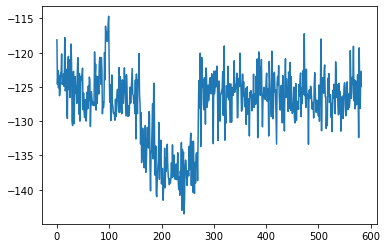

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 583, reward = -130.289185


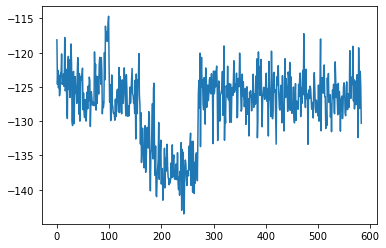

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 584, reward = -129.725037


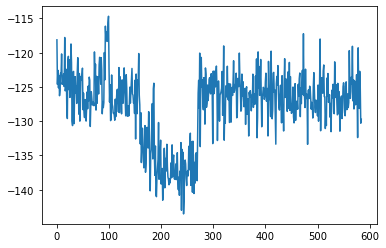

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 585, reward = -129.095108


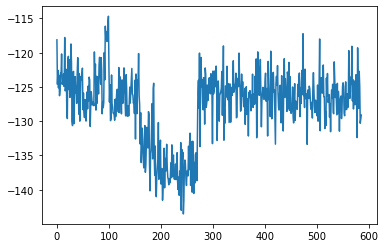

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 586, reward = -124.940895


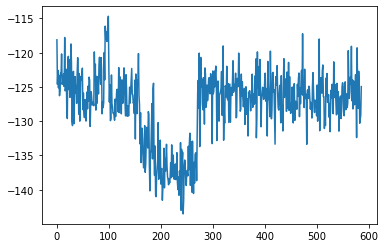

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 587, reward = -120.908592


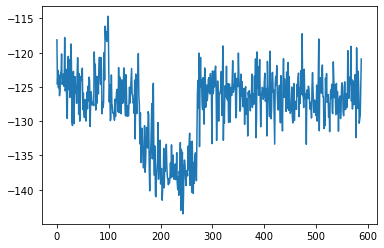

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 588, reward = -124.639771


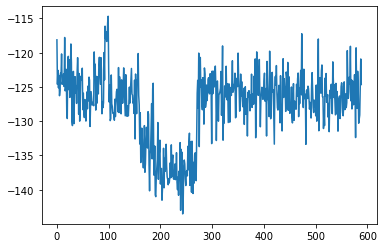

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 589, reward = -128.018570


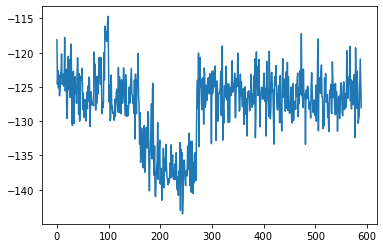

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 590, reward = -125.645790


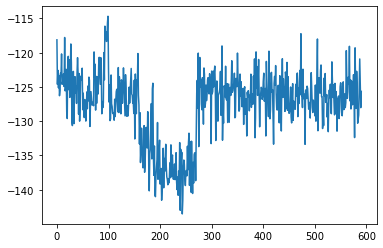

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 591, reward = -124.474602


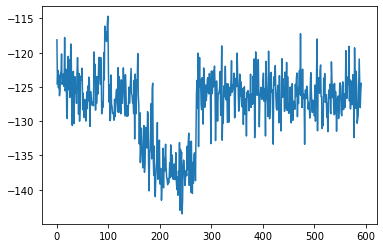

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 592, reward = -126.007912


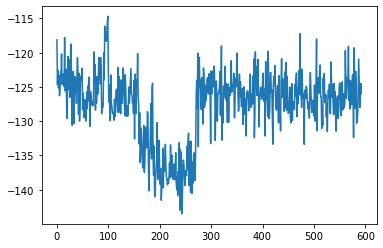

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 593, reward = -127.000267


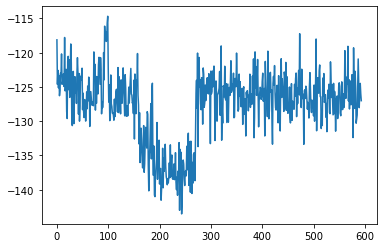

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 594, reward = -131.610901


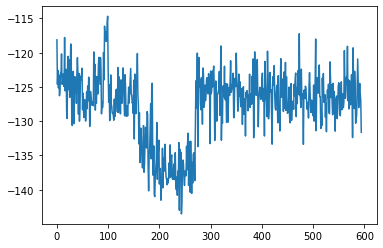

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 595, reward = -129.096695


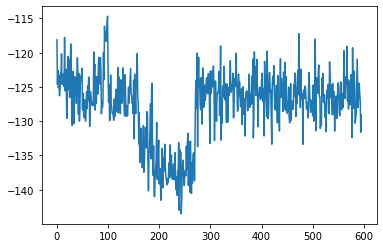

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 596, reward = -123.132538


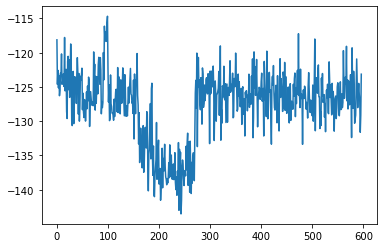

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 597, reward = -128.688065


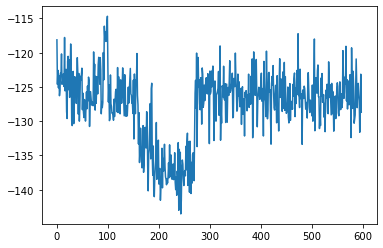

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 598, reward = -125.228966


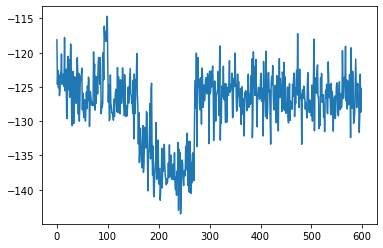

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 599, reward = -124.528206


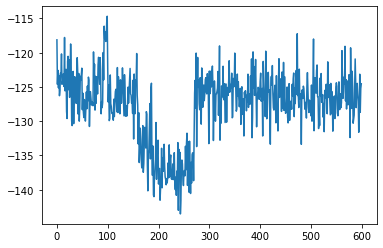

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 600, reward = -125.388466


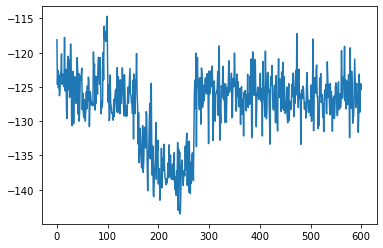

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 601, reward = -127.396240


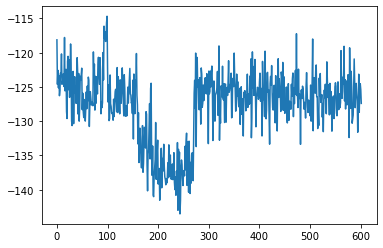

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 602, reward = -126.382919


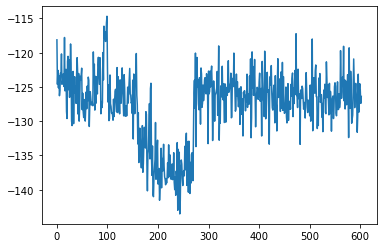

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 603, reward = -129.572632


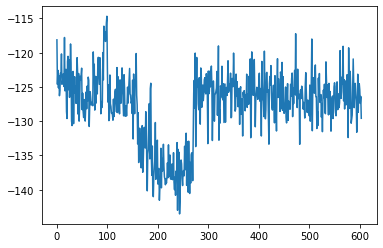

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 604, reward = -124.227776


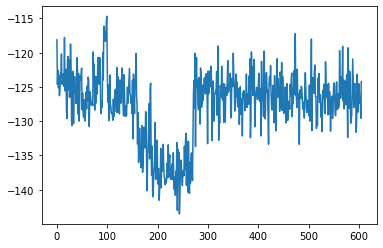

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 605, reward = -126.235542


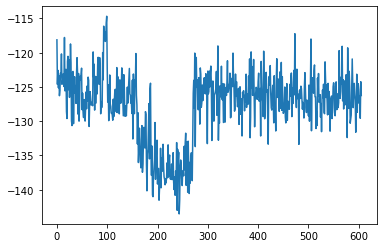

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 606, reward = -128.486023


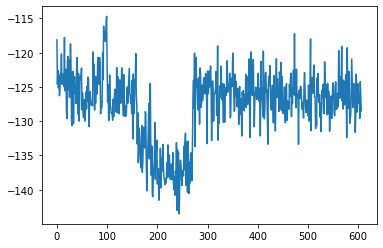

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 607, reward = -124.999138


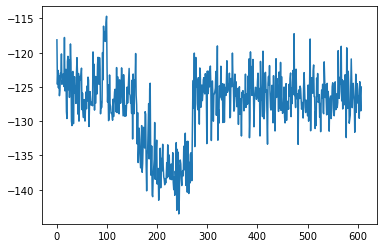

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 608, reward = -125.842552


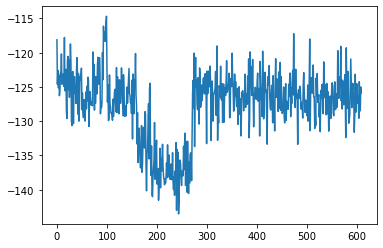

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 609, reward = -124.057381


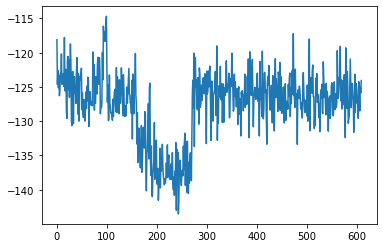

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 610, reward = -130.552567


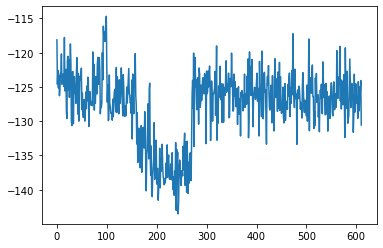

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 611, reward = -130.186386


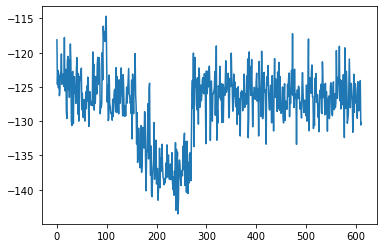

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 612, reward = -124.063683


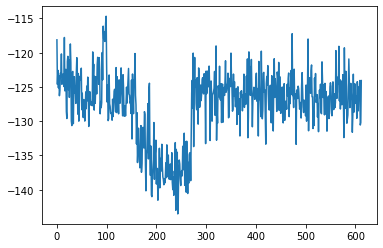

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 613, reward = -122.980461


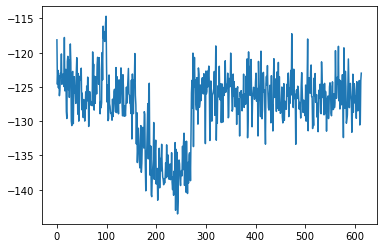

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 614, reward = -126.212288


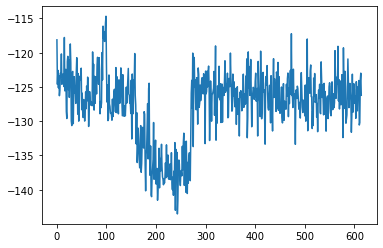

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 615, reward = -130.455963


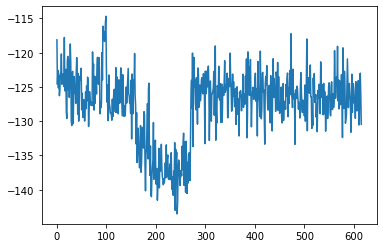

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 616, reward = -126.024467


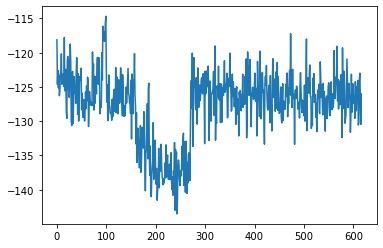

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 617, reward = -127.710892


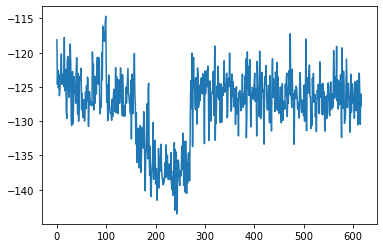

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 618, reward = -125.522713


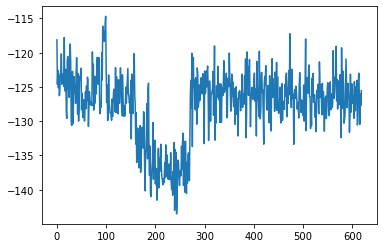

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 619, reward = -128.286880


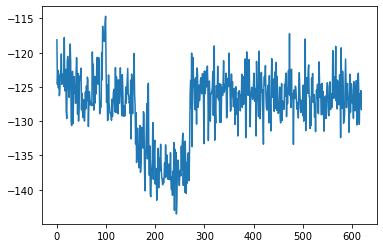

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 620, reward = -124.298012


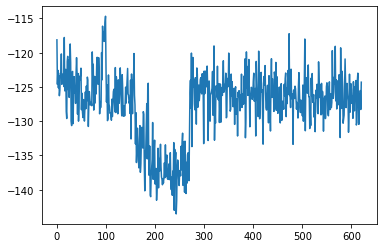

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 621, reward = -124.385147


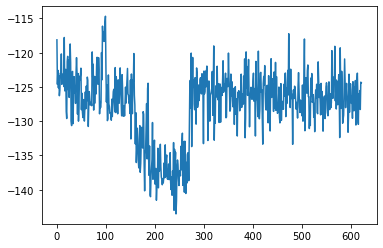

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 622, reward = -123.154533


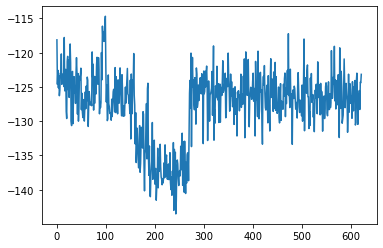

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 623, reward = -136.622070


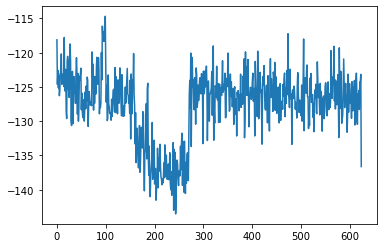

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 624, reward = -139.442413


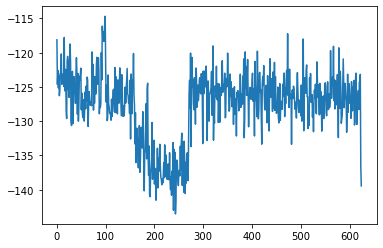

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 625, reward = -135.323044


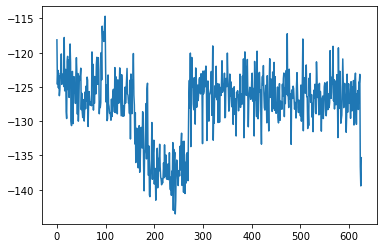

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 626, reward = -132.962784


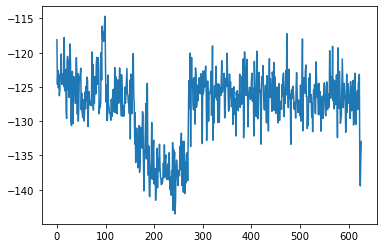

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 627, reward = -139.246262


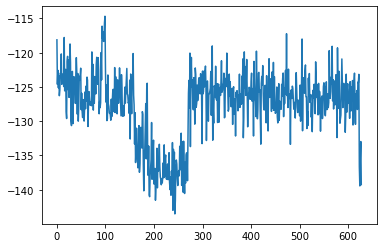

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 628, reward = -133.938370


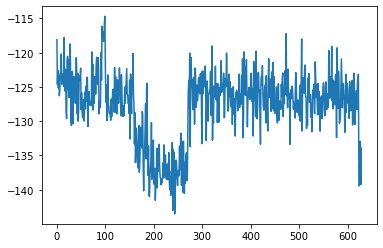

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 629, reward = -134.942627


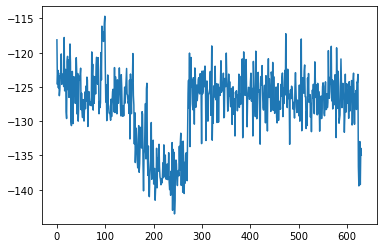

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 630, reward = -135.109940


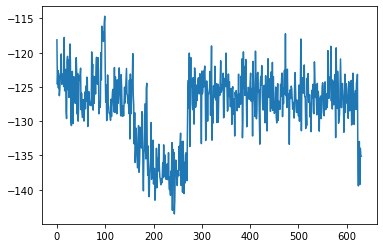

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 631, reward = -137.778061


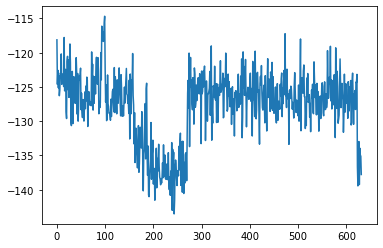

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 632, reward = -138.207306


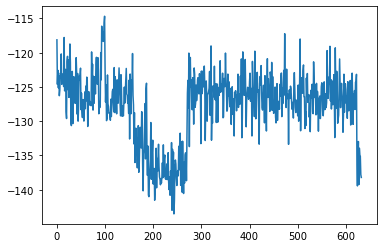

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 633, reward = -144.270905


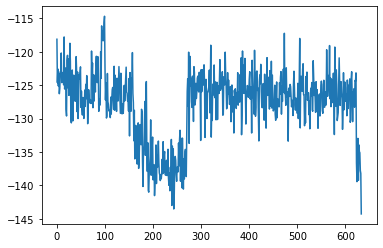

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 634, reward = -138.129150


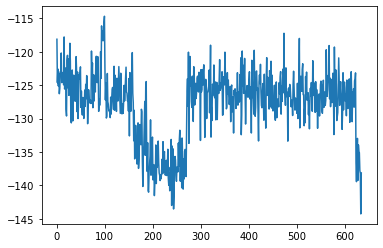

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 635, reward = -135.785294


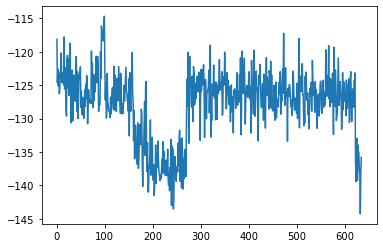

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 636, reward = -141.493484


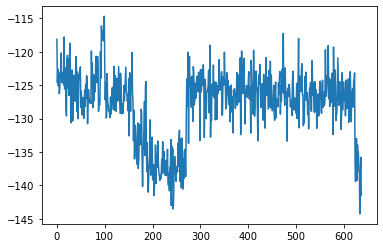

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 637, reward = -135.429047


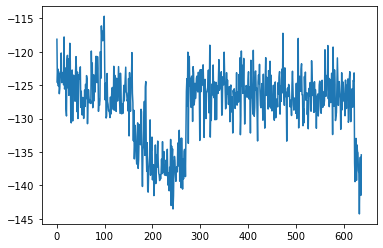

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 638, reward = -139.347519


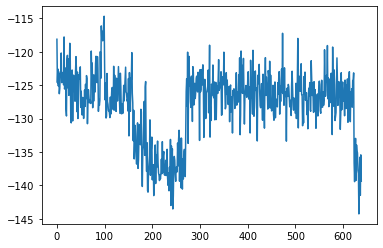

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 639, reward = -139.146667


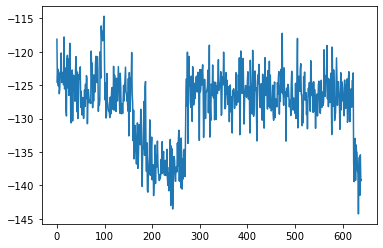

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 640, reward = -135.255096


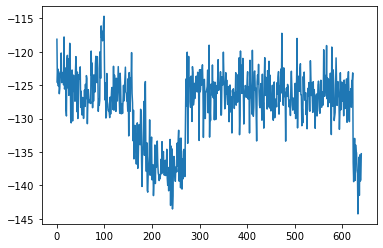

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 641, reward = -136.756943


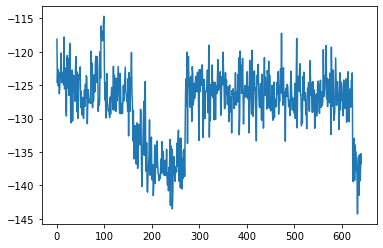

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 642, reward = -137.624176


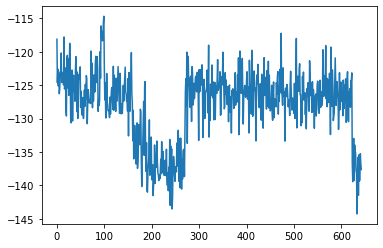

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 643, reward = -127.947021


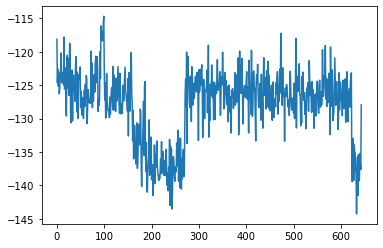

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 644, reward = -133.940720


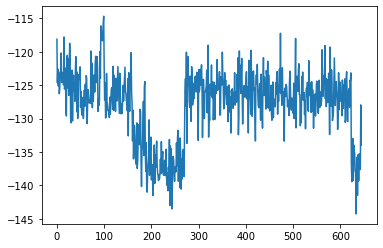

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 645, reward = -138.276810


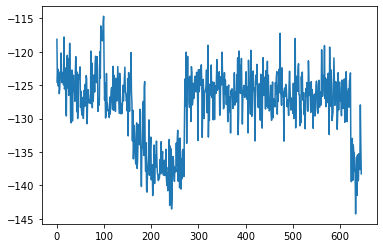

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 646, reward = -141.949570


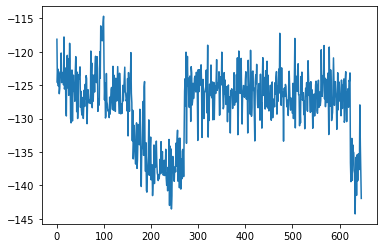

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 647, reward = -141.214539


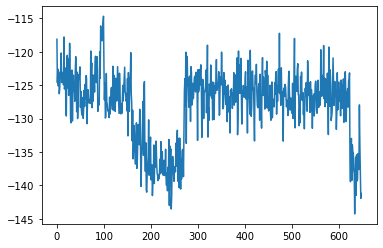

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 648, reward = -140.133453


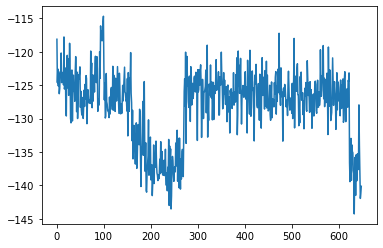

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 649, reward = -133.364105


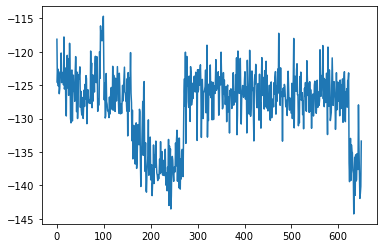

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 650, reward = -138.350494


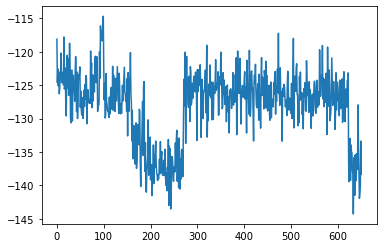

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 651, reward = -140.177261


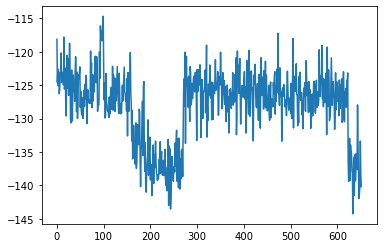

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 652, reward = -141.366959


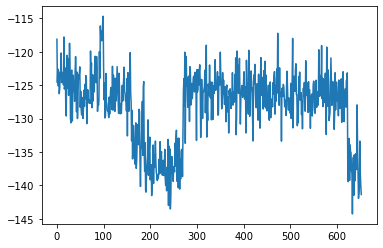

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 653, reward = -138.352081


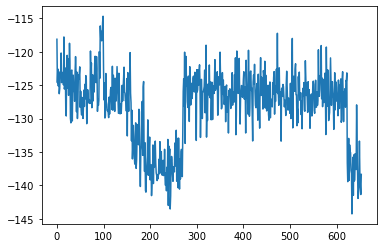

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 654, reward = -137.000122


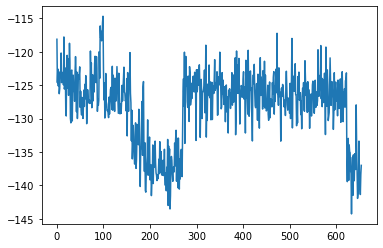

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 655, reward = -134.527512


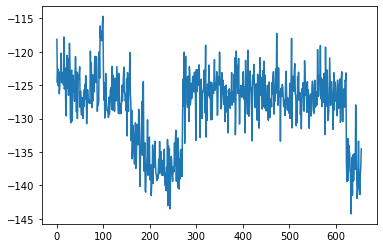

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 656, reward = -138.707077


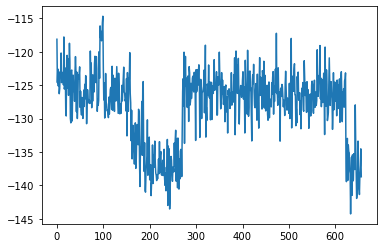

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 657, reward = -136.269394


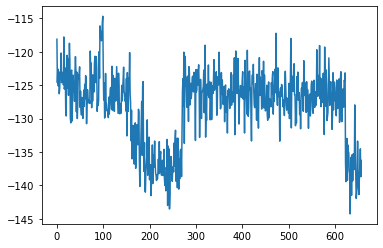

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 658, reward = -137.348862


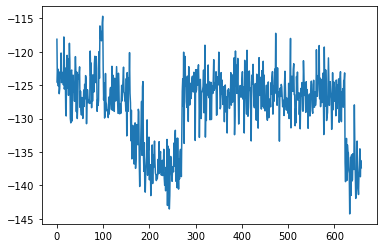

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 659, reward = -133.668900


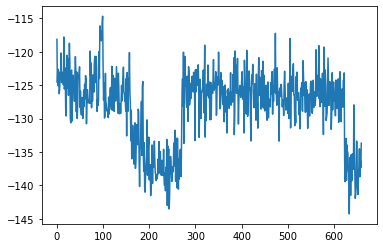

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 660, reward = -137.463333


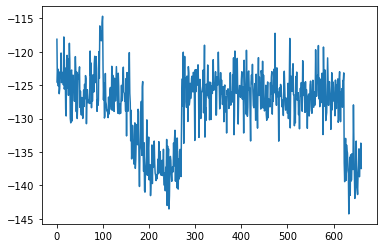

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 661, reward = -140.866150


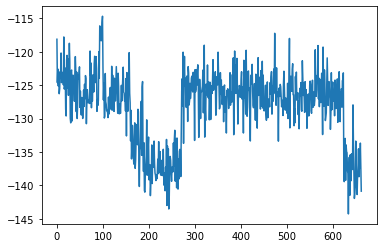

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 662, reward = -135.842941


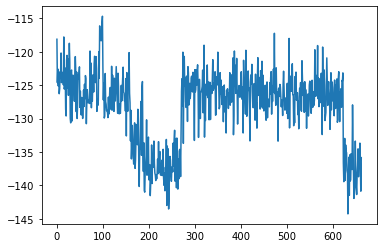

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 663, reward = -134.808365


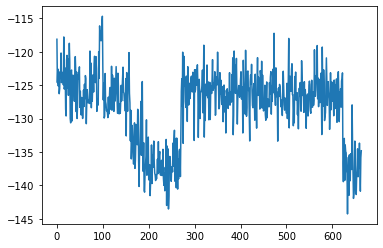

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 664, reward = -135.099167


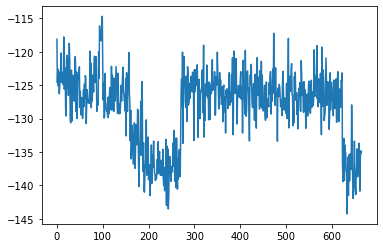

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 665, reward = -134.774277


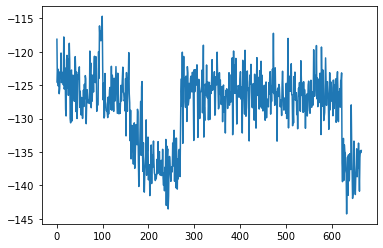

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 666, reward = -137.882080


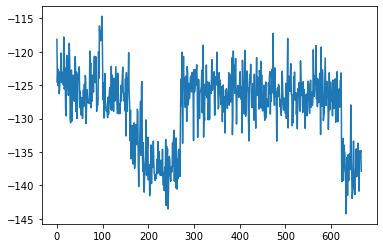

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 667, reward = -132.040619


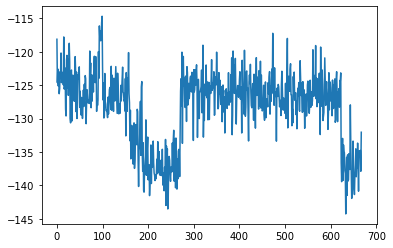

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 668, reward = -132.773376


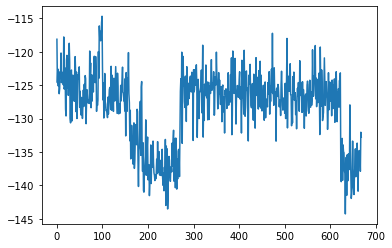

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 669, reward = -139.112030


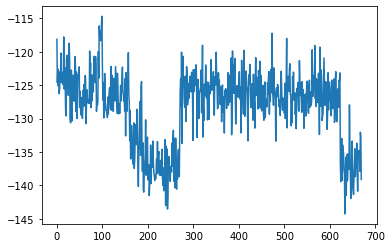

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 670, reward = -138.336761


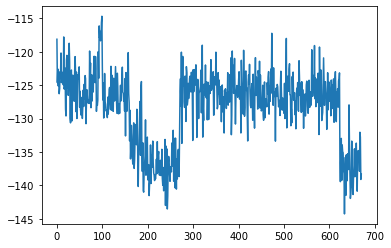

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 671, reward = -137.534943


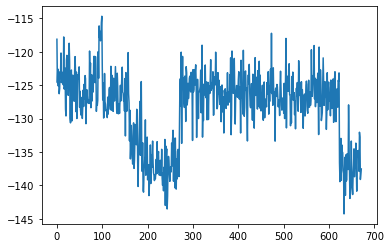

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 672, reward = -136.305542


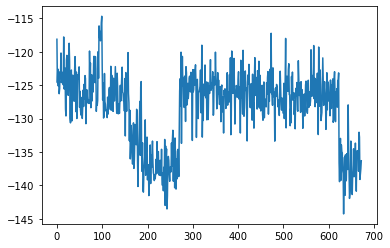

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 673, reward = -131.843430


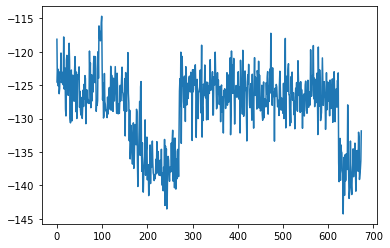

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 674, reward = -134.963379


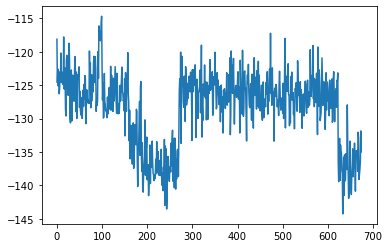

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 675, reward = -133.436371


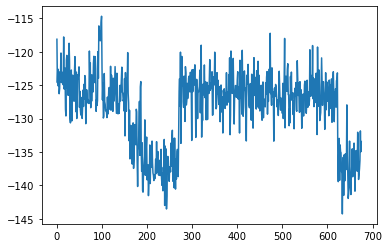

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 676, reward = -137.196793


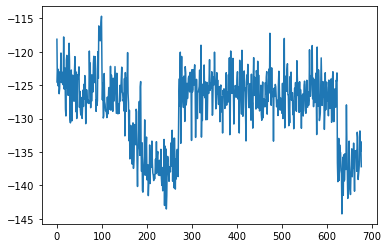

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 677, reward = -138.655762


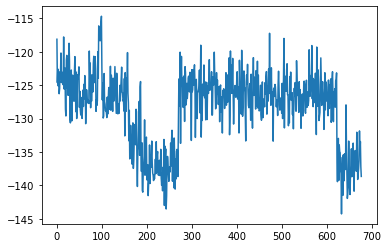

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 678, reward = -135.839401


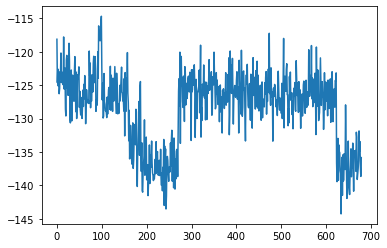

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 679, reward = -135.959061


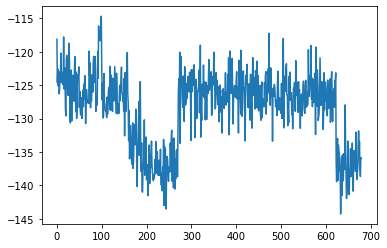

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 680, reward = -135.676575


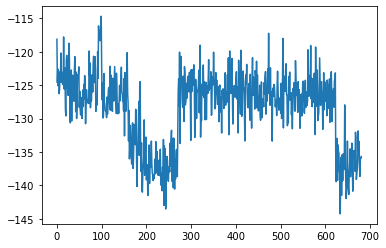

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 681, reward = -131.919220


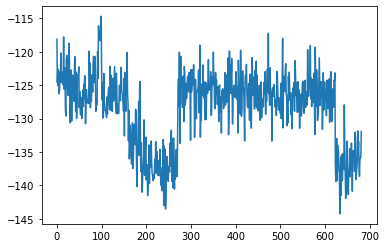

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 682, reward = -131.815369


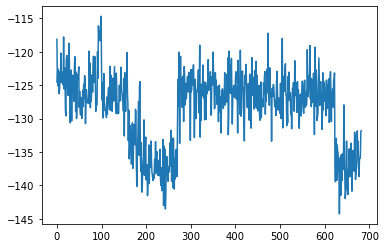

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 683, reward = -133.263992


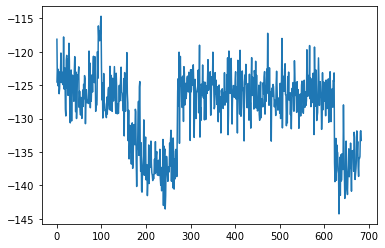

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 684, reward = -131.902496


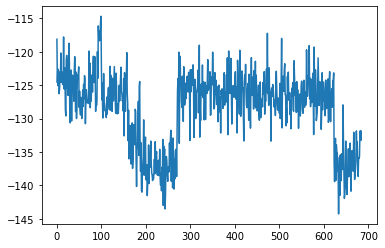

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 685, reward = -139.278656


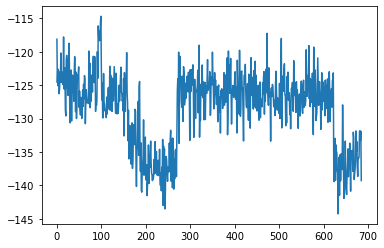

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 686, reward = -134.970627


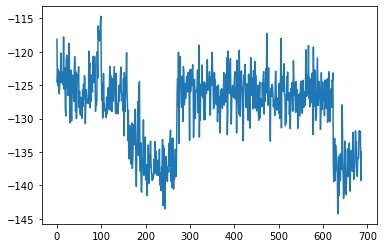

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 687, reward = -142.878693


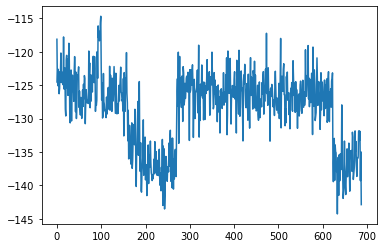

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 688, reward = -137.776260


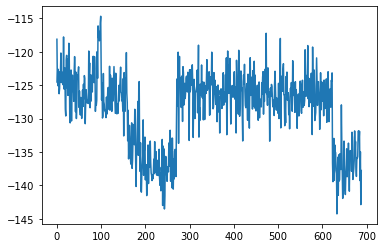

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 689, reward = -135.990204


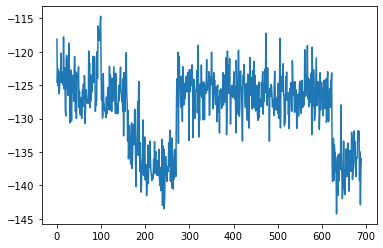

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 690, reward = -136.910126


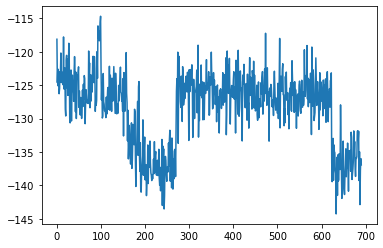

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 691, reward = -137.248154


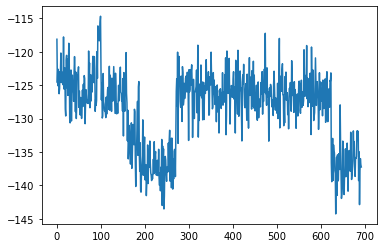

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 692, reward = -138.931885


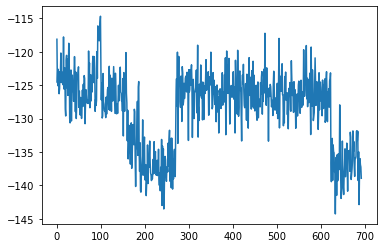

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 693, reward = -139.334137


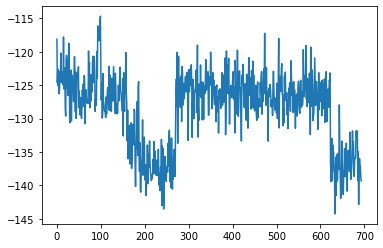

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 694, reward = -138.333069


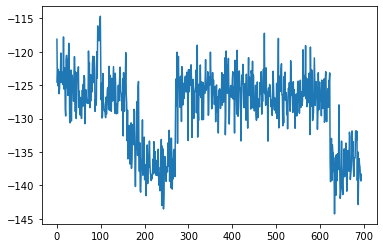

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 695, reward = -136.071579


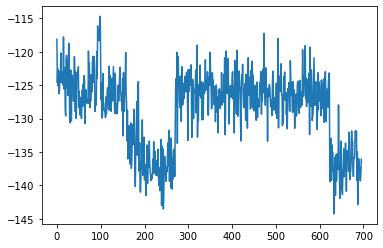

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 696, reward = -132.214294


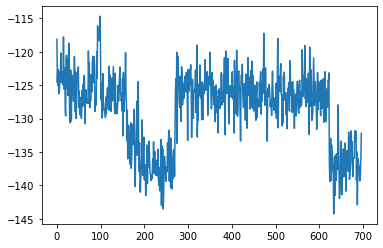

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 697, reward = -136.873901


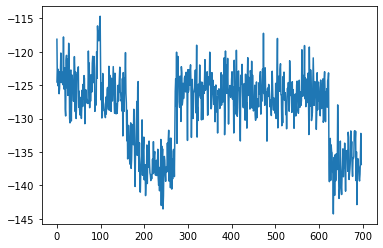

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 698, reward = -136.717926


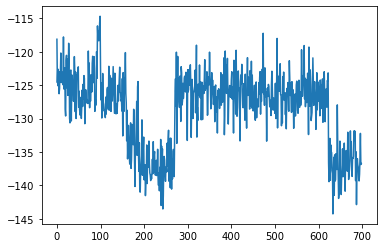

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 699, reward = -134.757324


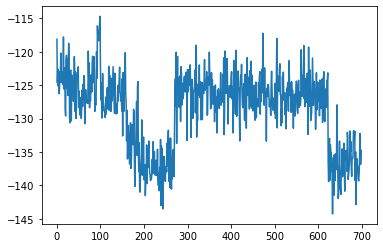

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 700, reward = -135.378754


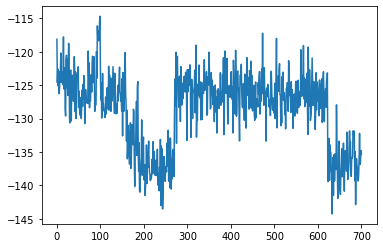

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 701, reward = -140.802689


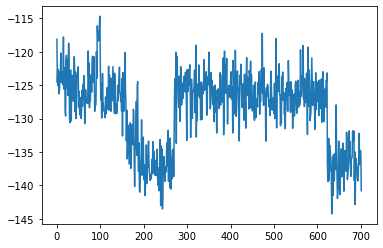

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 702, reward = -138.088257


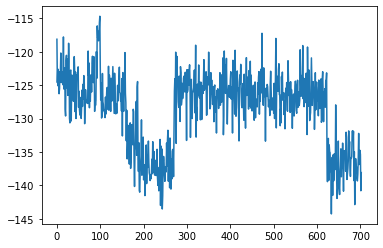

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 703, reward = -139.804718


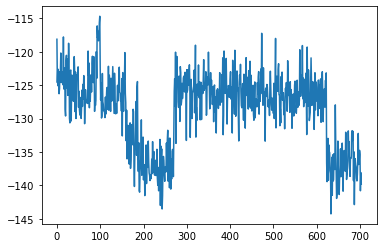

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 704, reward = -129.850342


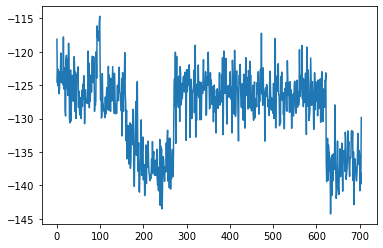

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 705, reward = -128.761154


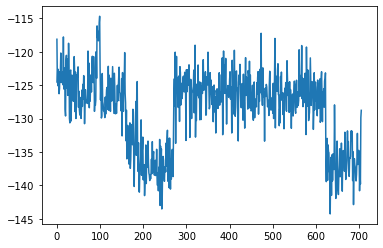

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 706, reward = -129.951782


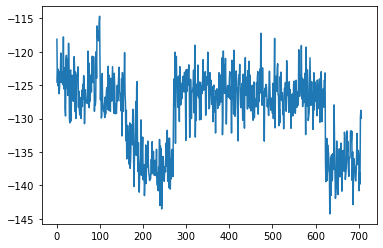

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 707, reward = -127.437897


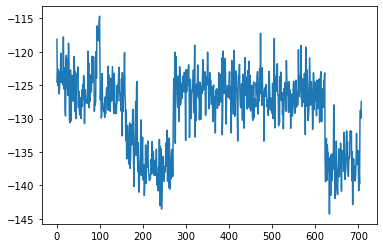

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 708, reward = -129.600388


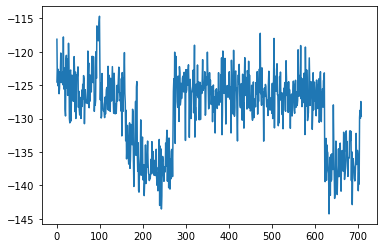

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 709, reward = -125.180397


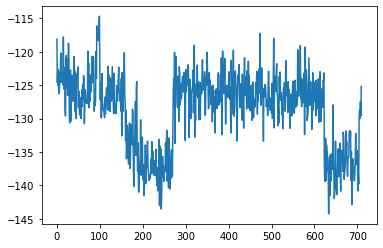

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 710, reward = -135.387222


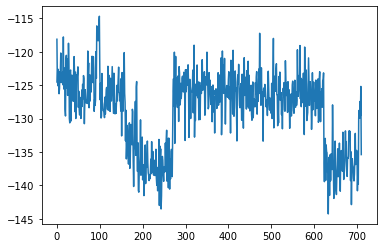

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 711, reward = -123.297874


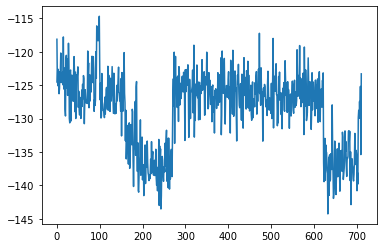

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 712, reward = -133.591537


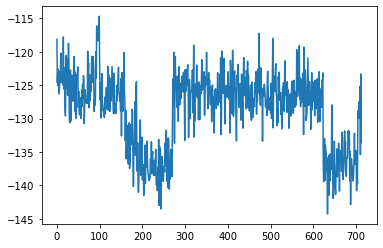

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 713, reward = -129.588120


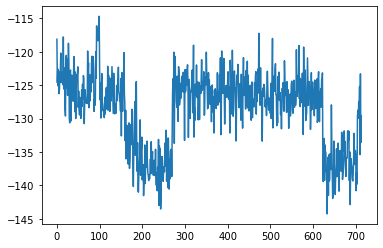

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 714, reward = -128.137344


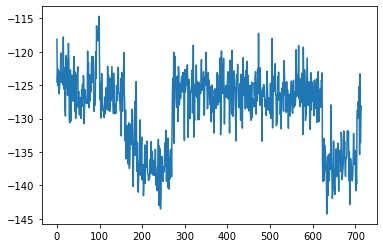

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 715, reward = -127.359360


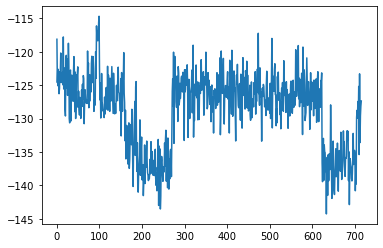

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 716, reward = -132.425735


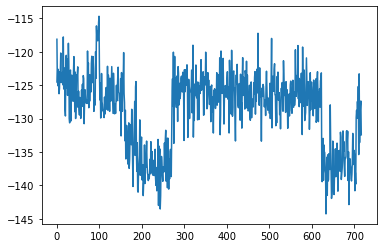

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 717, reward = -135.062454


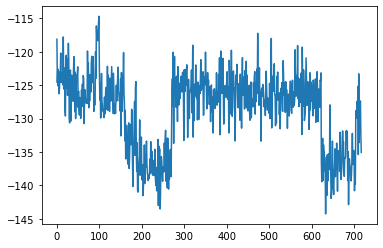

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 718, reward = -130.630173


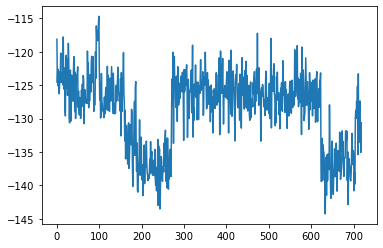

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 719, reward = -126.348495


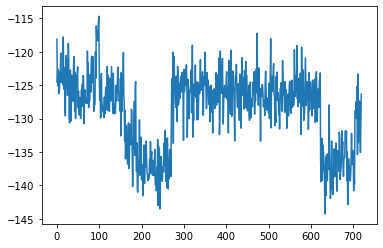

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 720, reward = -132.494080


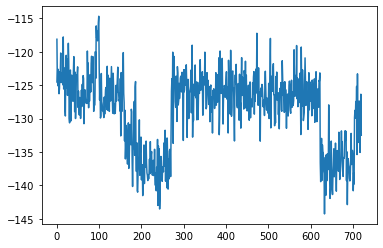

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 721, reward = -134.543533


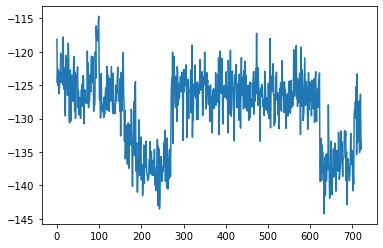

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 722, reward = -128.951126


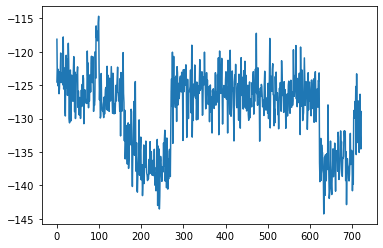

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 723, reward = -129.688568


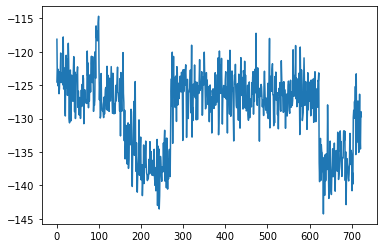

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 724, reward = -129.951019


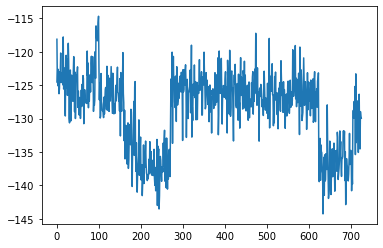

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 725, reward = -131.089691


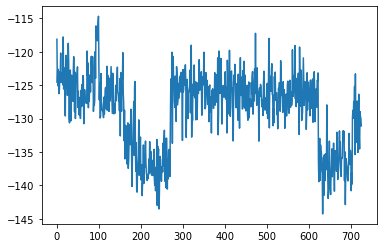

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 726, reward = -132.530151


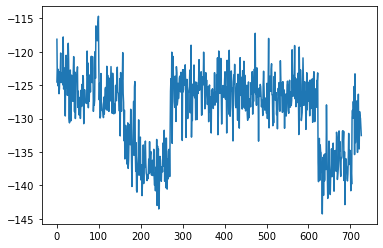

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 727, reward = -128.476669


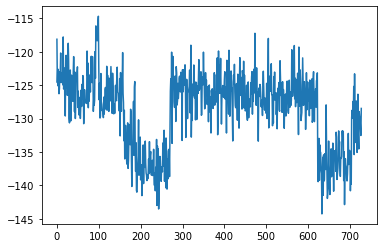

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 728, reward = -129.000458


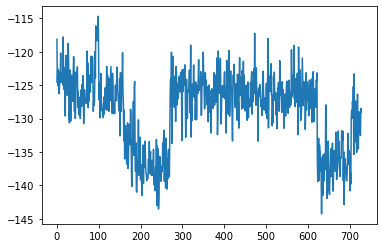

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 729, reward = -128.421204


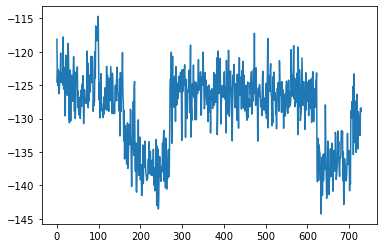

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 730, reward = -130.540985


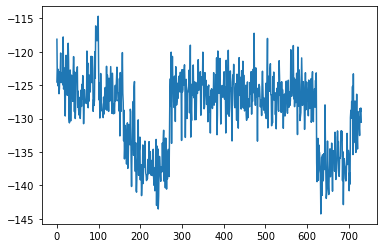

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 731, reward = -131.620438


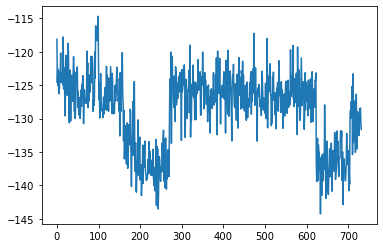

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 732, reward = -133.698502


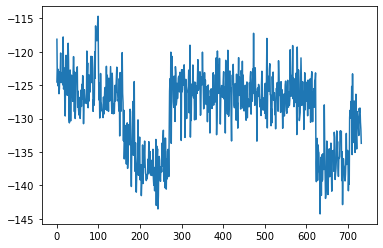

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 733, reward = -133.502380


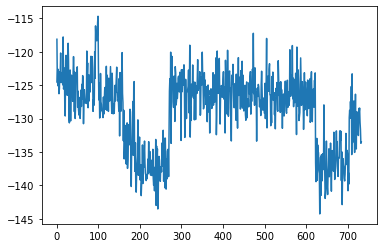

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 734, reward = -131.673553


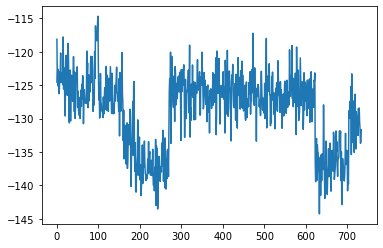

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 735, reward = -129.726212


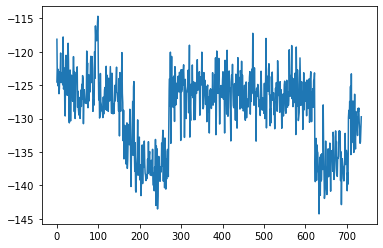

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 736, reward = -132.423004


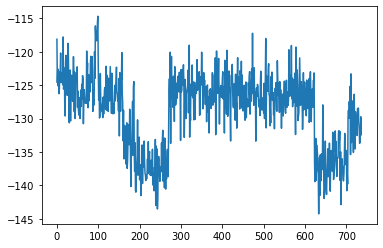

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 737, reward = -131.015579


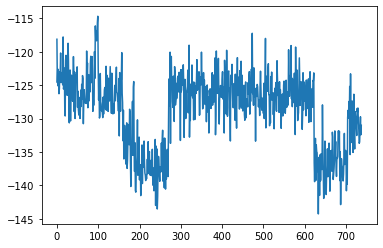

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 738, reward = -126.957550


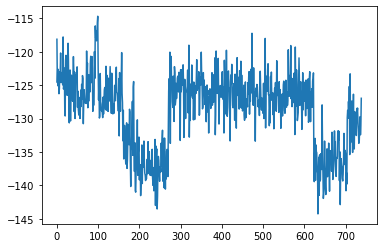

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 739, reward = -131.355667


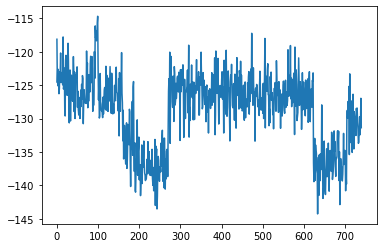

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 740, reward = -129.256180


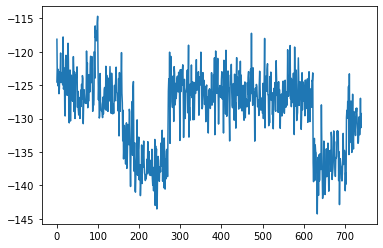

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 741, reward = -126.023811


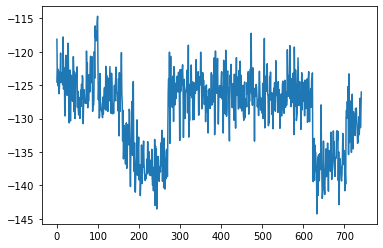

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 742, reward = -131.139664


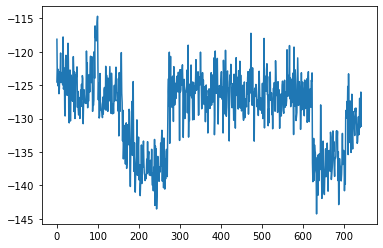

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 743, reward = -133.179321


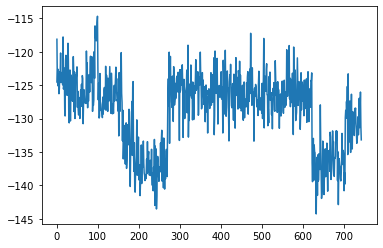

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 744, reward = -128.064148


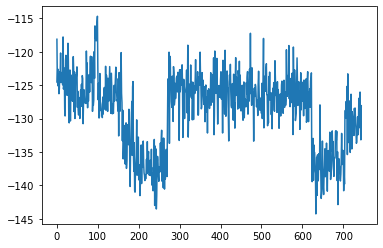

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 745, reward = -128.339050


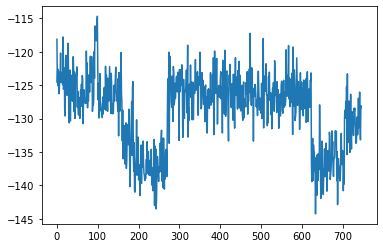

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 746, reward = -129.485153


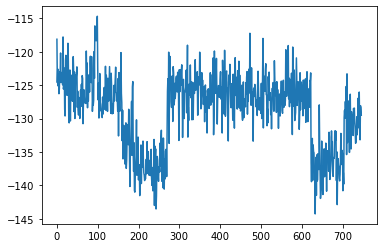

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 747, reward = -132.519958


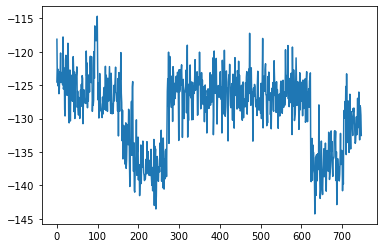

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 748, reward = -129.415146


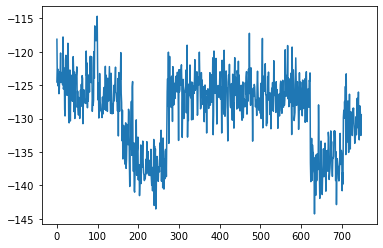

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 749, reward = -131.761398


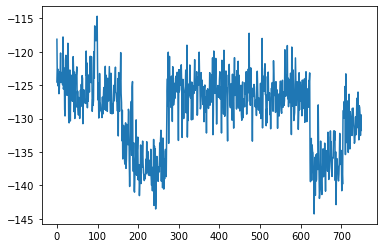

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 750, reward = -132.130005


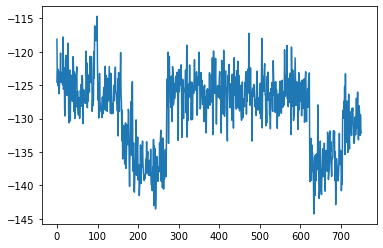

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 751, reward = -128.885086


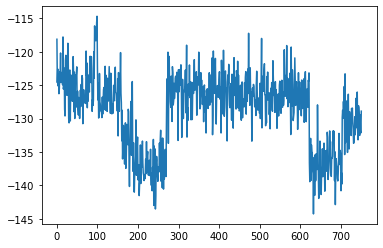

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 752, reward = -129.984131


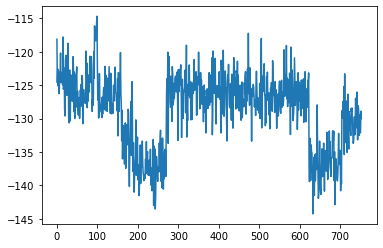

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 753, reward = -128.600204


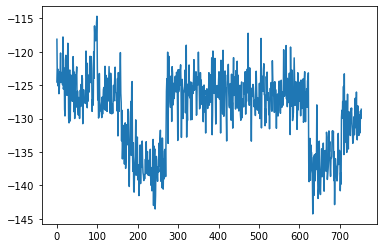

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 754, reward = -129.951431


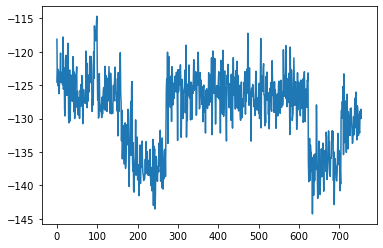

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 755, reward = -135.209732


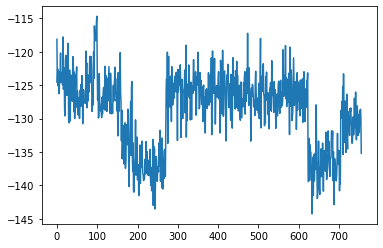

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 756, reward = -131.985718


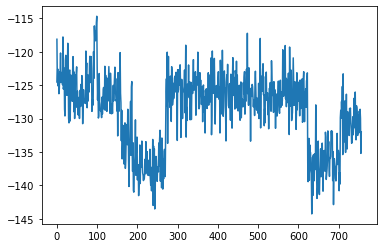

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 757, reward = -131.926315


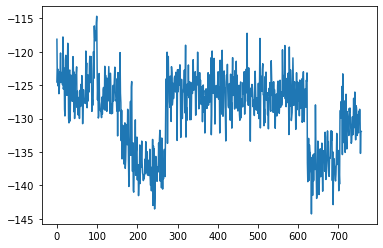

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 758, reward = -130.341736


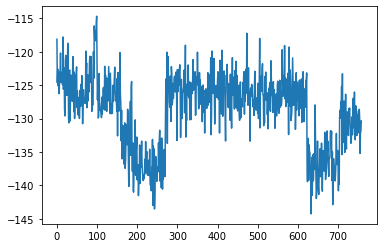

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 759, reward = -132.297943


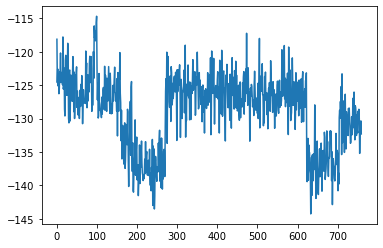

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 760, reward = -131.279770


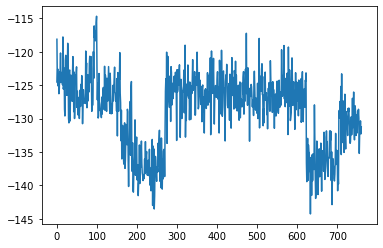

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 761, reward = -129.300568


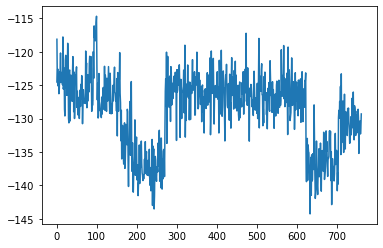

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 762, reward = -129.868103


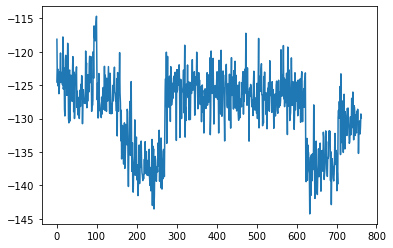

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 763, reward = -130.799377


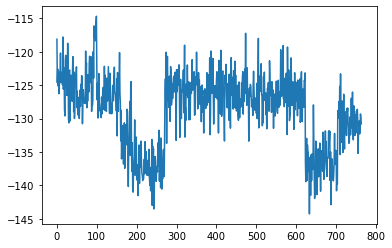

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 764, reward = -128.560272


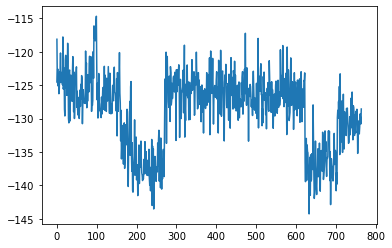

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 765, reward = -131.008362


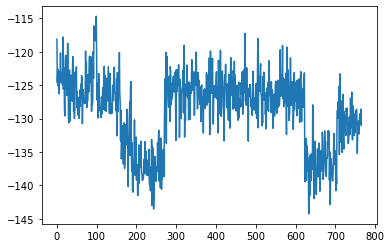

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 766, reward = -130.913513


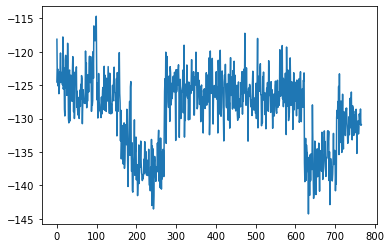

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 767, reward = -128.930038


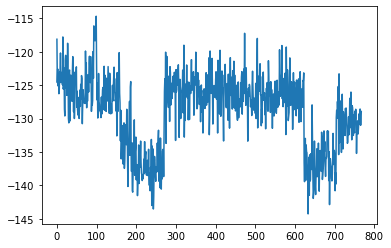

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 768, reward = -134.298691


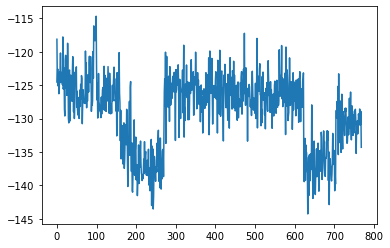

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 769, reward = -129.836502


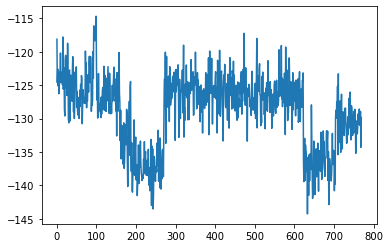

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 770, reward = -128.020905


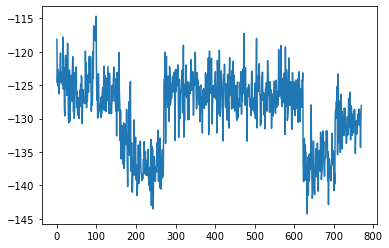

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 771, reward = -133.049896


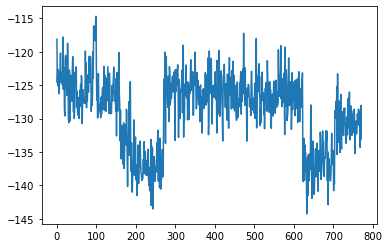

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 772, reward = -134.888870


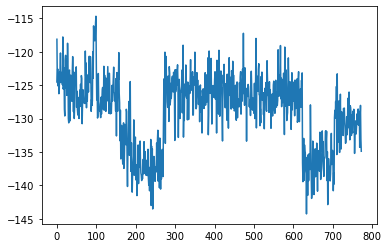

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 773, reward = -127.174515


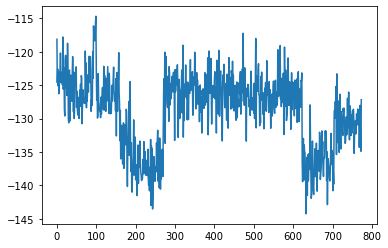

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 774, reward = -128.427979


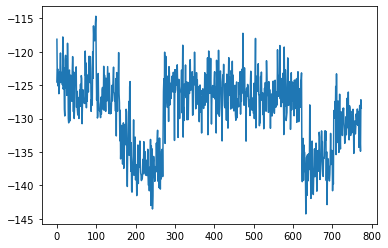

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 775, reward = -129.979095


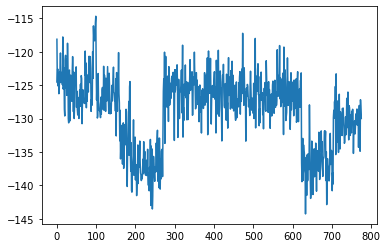

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 776, reward = -132.032425


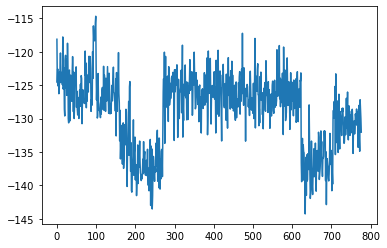

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 777, reward = -131.652039


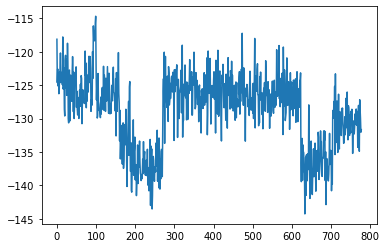

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 778, reward = -130.096817


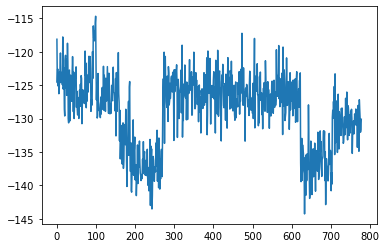

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 779, reward = -129.632294


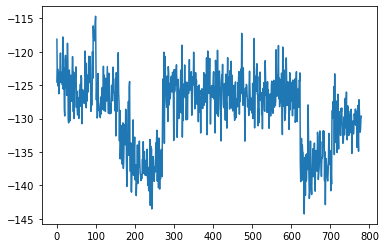

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 780, reward = -130.317795


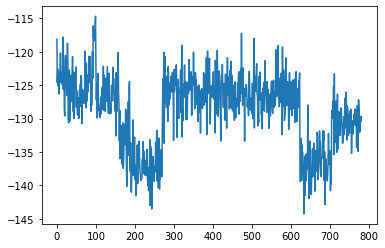

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 781, reward = -135.832855


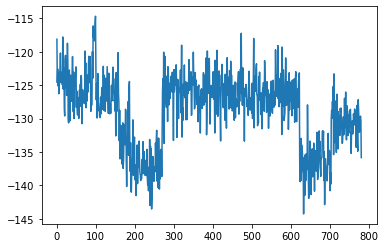

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 782, reward = -132.923584


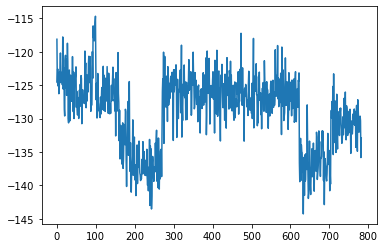

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 783, reward = -132.133759


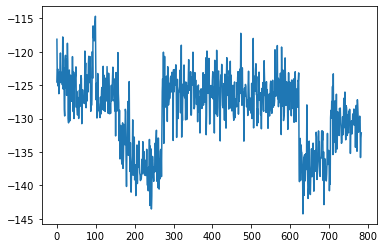

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 784, reward = -129.822586


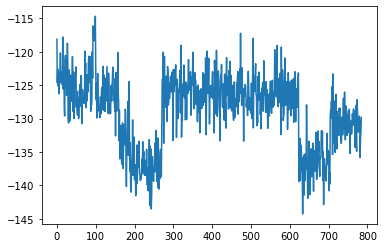

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 785, reward = -132.779099


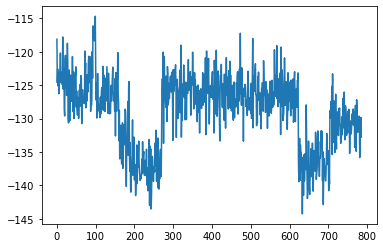

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 786, reward = -135.473221


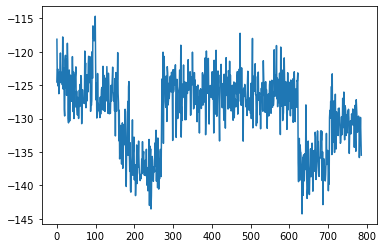

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 787, reward = -134.212051


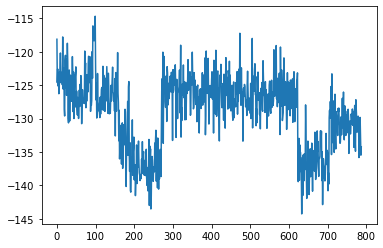

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 788, reward = -126.827049


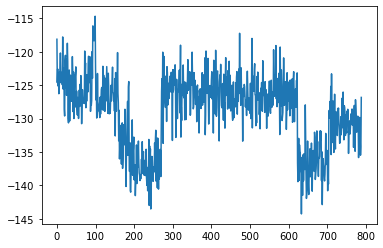

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 789, reward = -125.189049


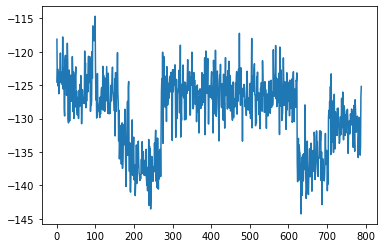

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 790, reward = -128.217072


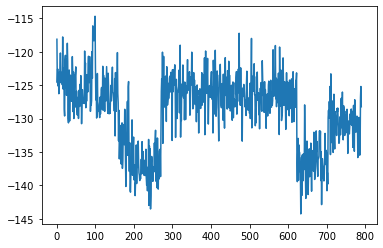

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 791, reward = -127.451920


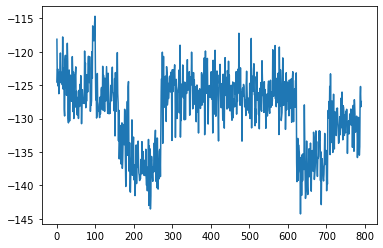

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 792, reward = -126.074219


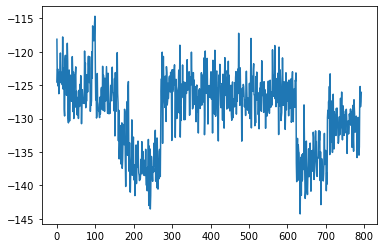

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 793, reward = -132.128021


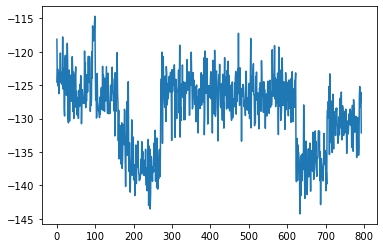

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 794, reward = -127.484077


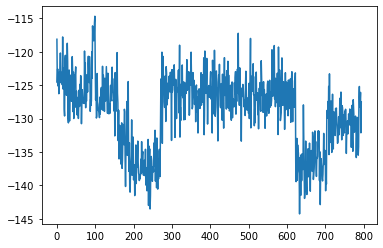

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 795, reward = -131.339630


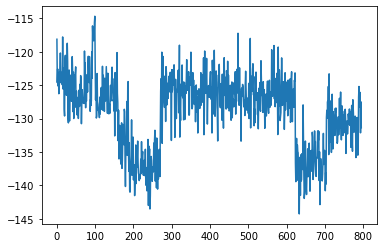

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 796, reward = -129.092911


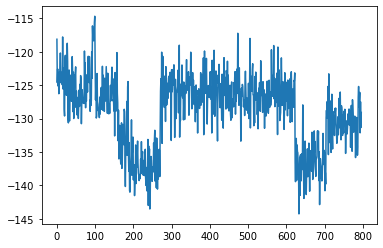

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 797, reward = -131.832275


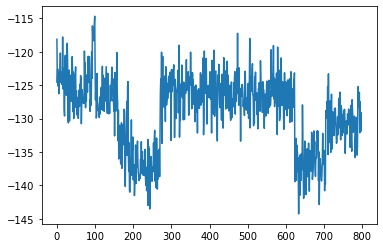

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 798, reward = -124.544968


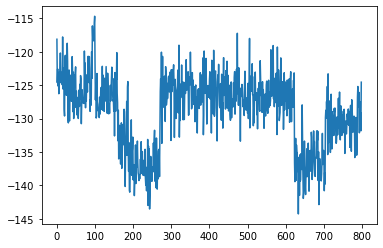

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 799, reward = -131.918945


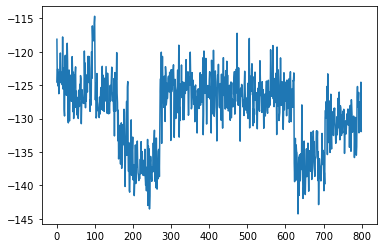

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 800, reward = -126.714424


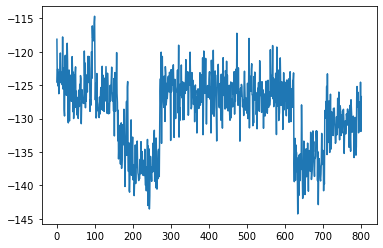

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 801, reward = -129.220718


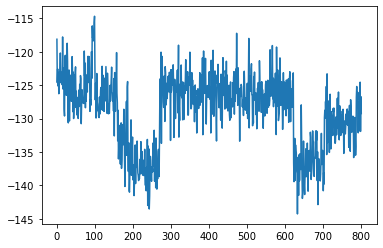

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 802, reward = -129.075562


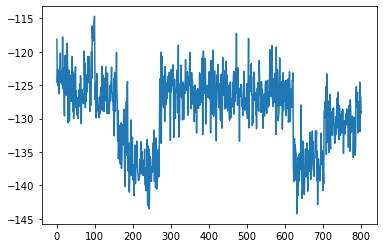

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 803, reward = -133.483612


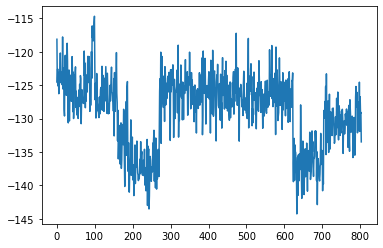

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 804, reward = -129.273972


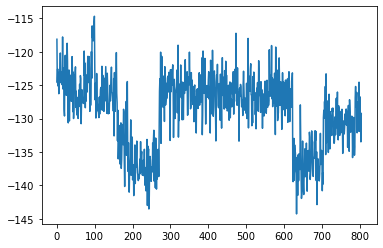

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 805, reward = -130.342316


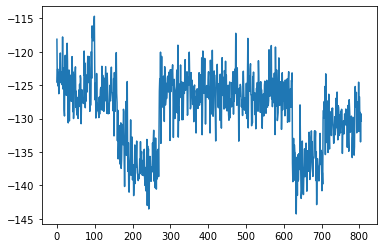

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 806, reward = -135.301392


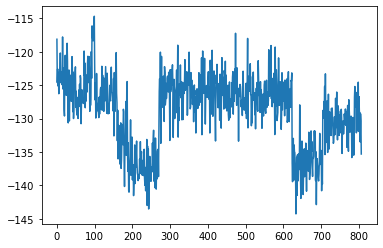

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 807, reward = -132.491638


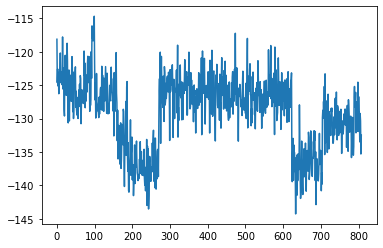

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 808, reward = -128.039520


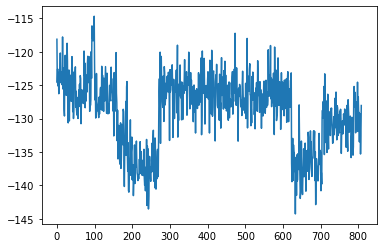

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 809, reward = -131.019165


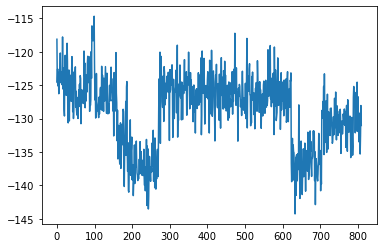

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 810, reward = -129.750351


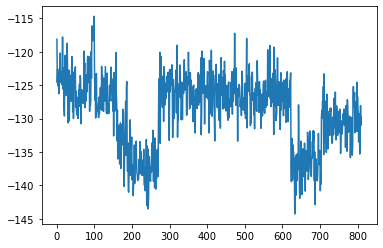

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 811, reward = -132.067139


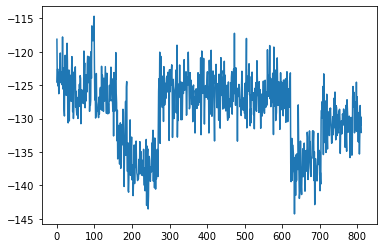

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 812, reward = -128.483093


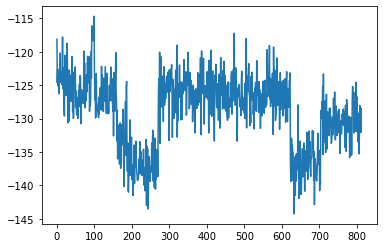

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 813, reward = -131.412827


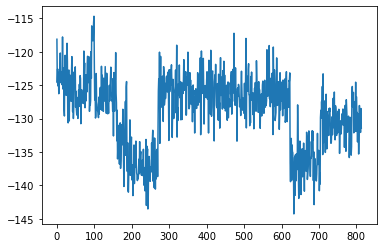

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 814, reward = -133.169067


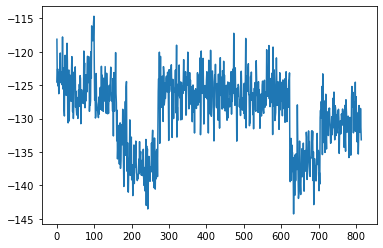

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 815, reward = -125.701584


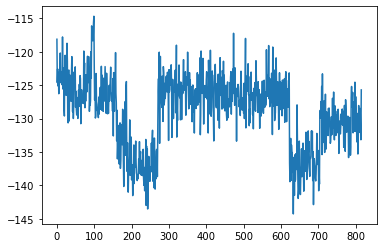

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 816, reward = -135.954330


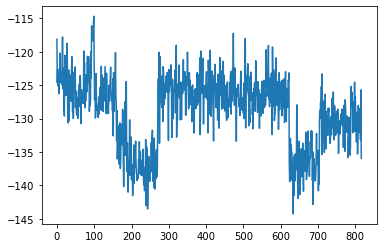

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 817, reward = -134.163254


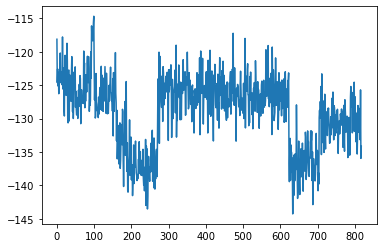

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 818, reward = -129.387741


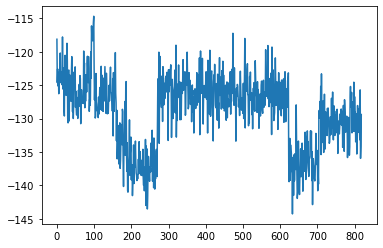

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 819, reward = -134.315536


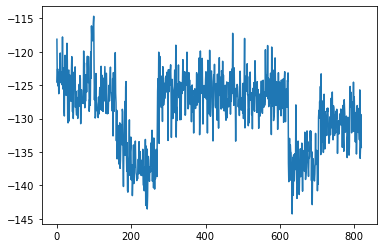

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 820, reward = -131.765625


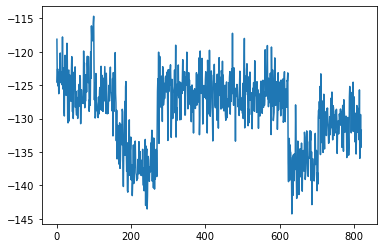

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 821, reward = -122.352776


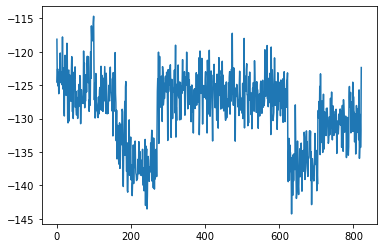

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 822, reward = -133.256393


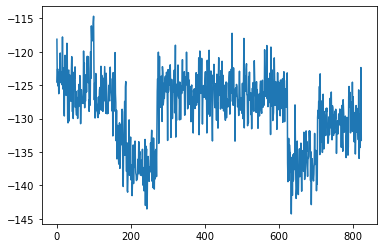

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 823, reward = -130.673798


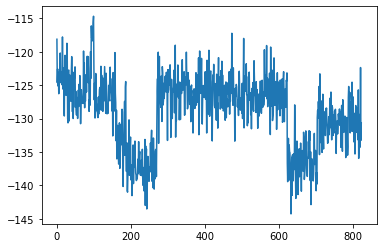

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 824, reward = -135.481659


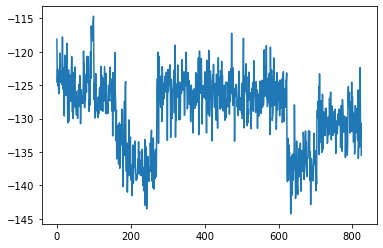

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 825, reward = -130.317703


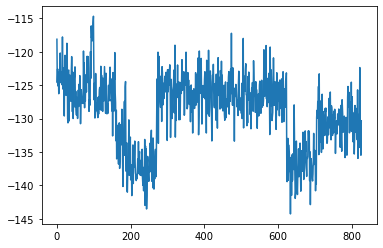

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 826, reward = -130.913101


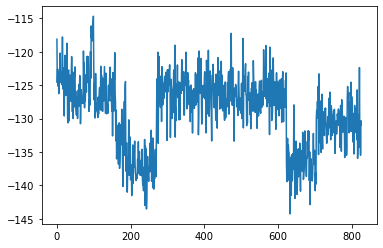

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 827, reward = -132.190811


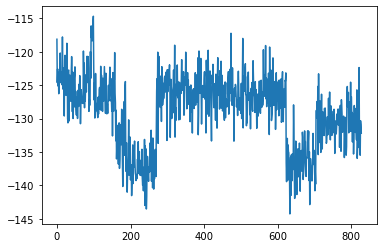

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 828, reward = -133.056168


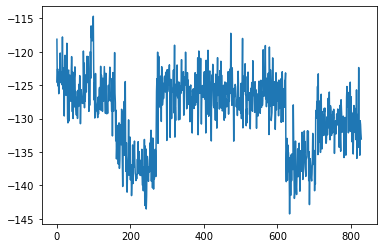

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 829, reward = -126.813049


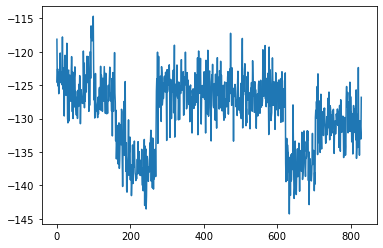

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 830, reward = -131.920486


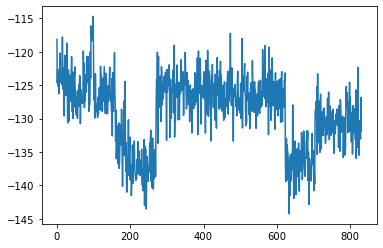

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 831, reward = -134.462738


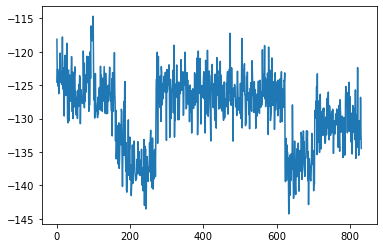

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 832, reward = -130.876556


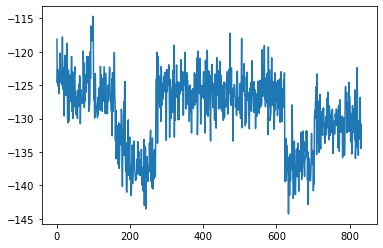

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 833, reward = -134.243469


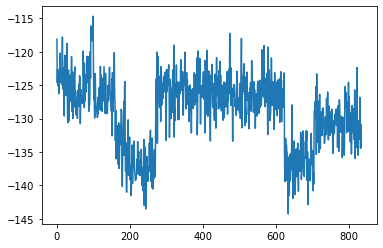

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 834, reward = -127.944107


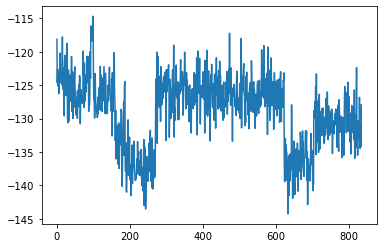

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 835, reward = -131.969360


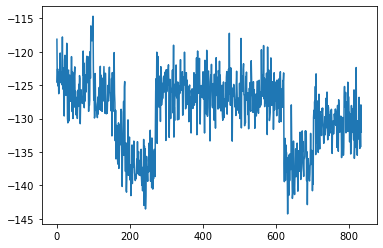

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 836, reward = -132.422394


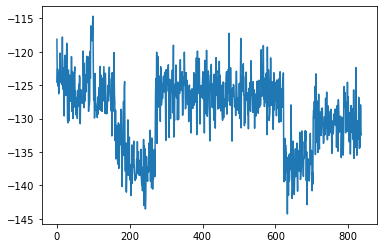

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 837, reward = -133.559204


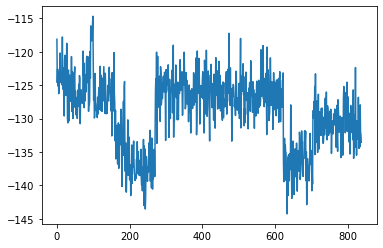

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 838, reward = -129.695602


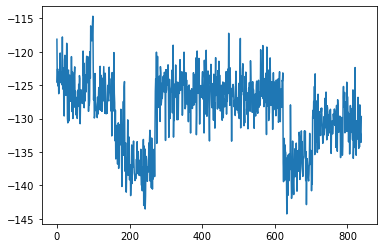

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 839, reward = -131.257935


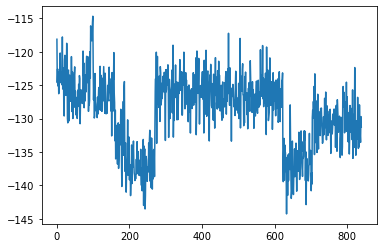

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 840, reward = -128.717392


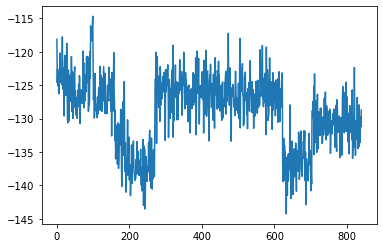

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 841, reward = -132.524750


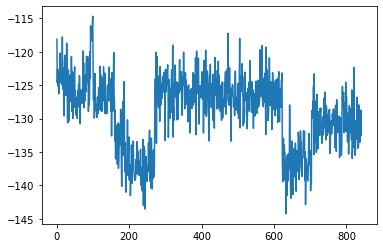

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 842, reward = -124.901291


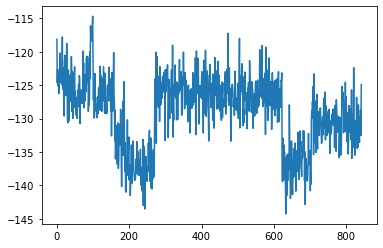

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 843, reward = -130.418274


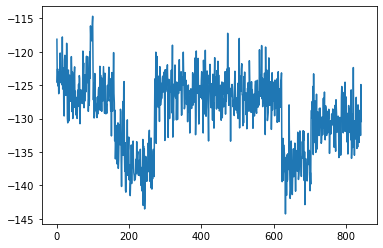

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 844, reward = -129.044617


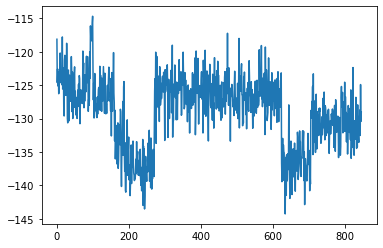

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 845, reward = -130.433380


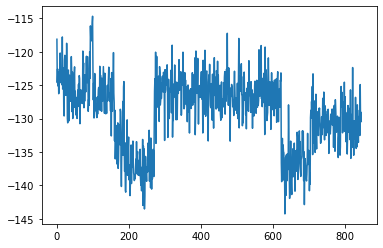

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 846, reward = -132.833969


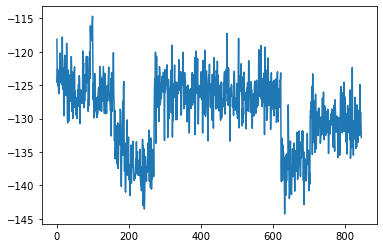

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 847, reward = -128.331070


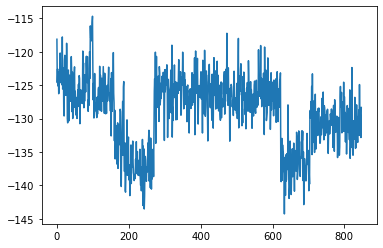

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 848, reward = -139.522522


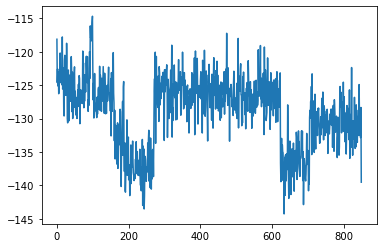

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 849, reward = -130.980453


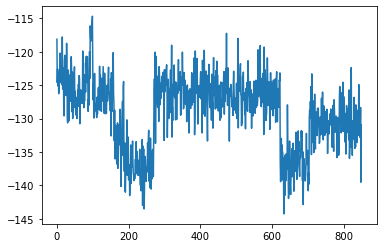

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 850, reward = -129.511505


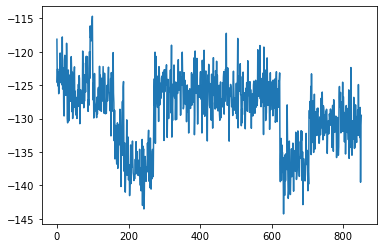

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 851, reward = -129.871765


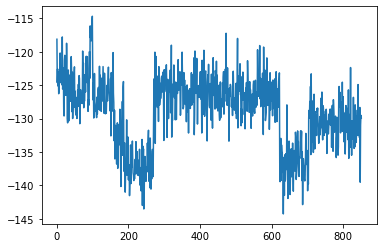

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 852, reward = -134.675842


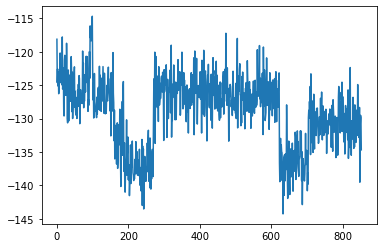

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 853, reward = -130.044403


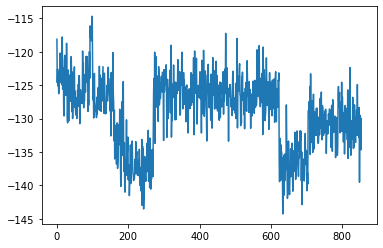

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 854, reward = -128.277512


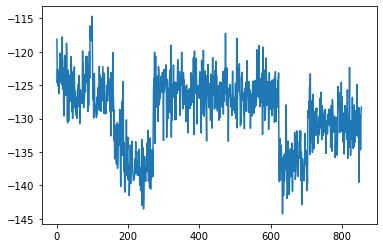

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 855, reward = -131.591599


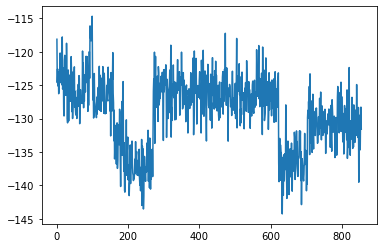

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 856, reward = -129.514359


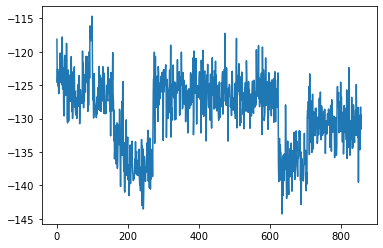

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 857, reward = -131.928070


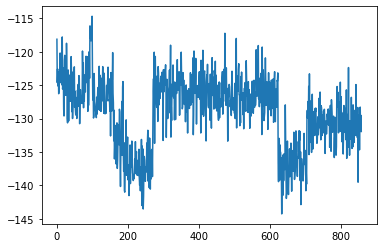

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 858, reward = -126.498833


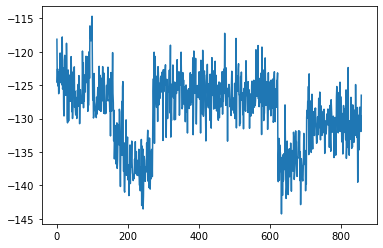

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 859, reward = -134.799377


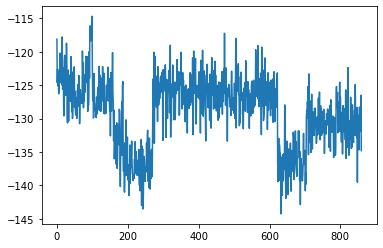

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 860, reward = -128.253830


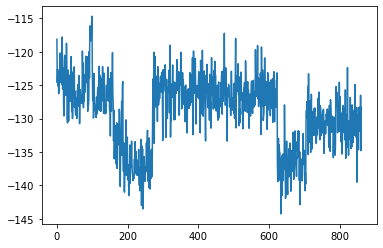

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 861, reward = -132.551422


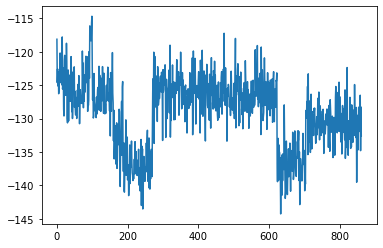

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 862, reward = -133.230682


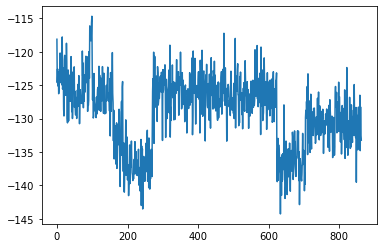

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 863, reward = -131.495834


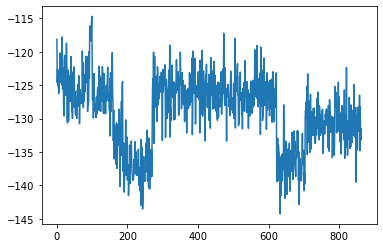

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 864, reward = -131.377899


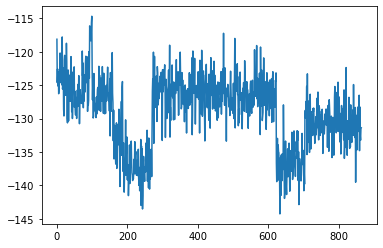

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 865, reward = -128.543015


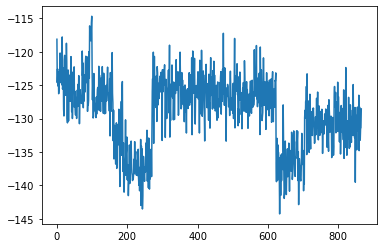

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 866, reward = -130.916931


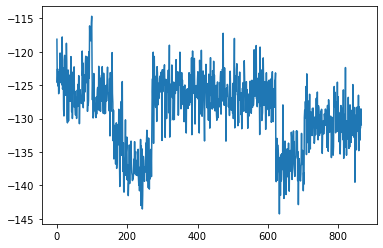

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 867, reward = -129.396713


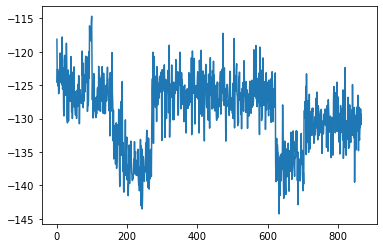

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 868, reward = -132.362991


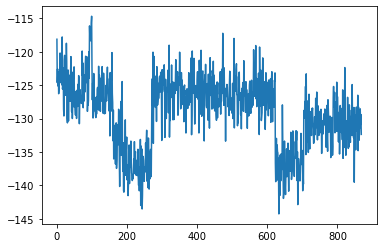

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 869, reward = -132.527512


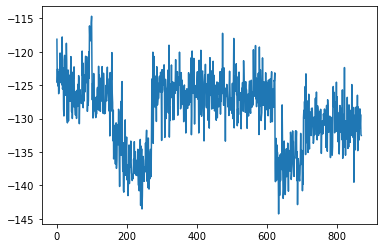

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 870, reward = -130.144974


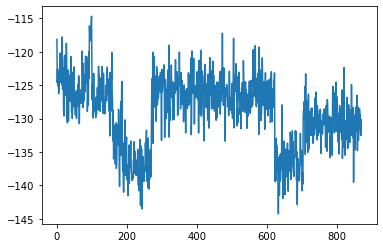

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 871, reward = -136.353210


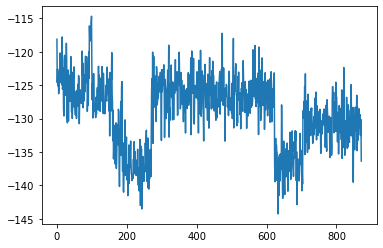

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 872, reward = -128.584351


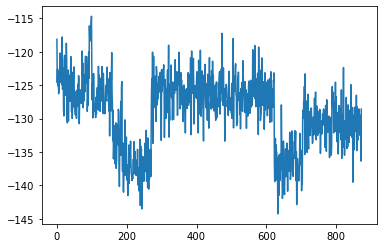

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 873, reward = -130.622833


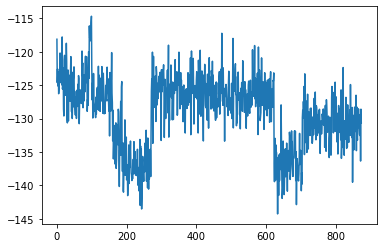

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 874, reward = -133.994980


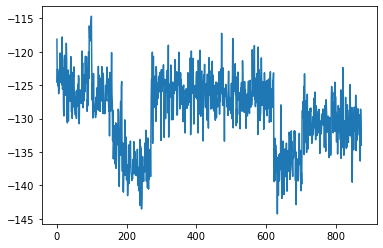

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 875, reward = -127.132080


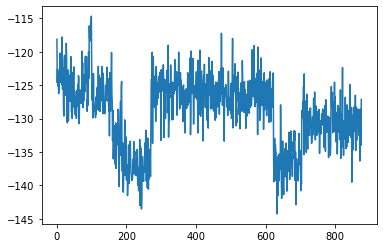

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 876, reward = -132.894272


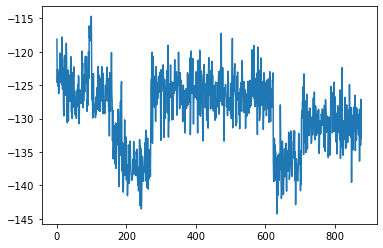

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 877, reward = -128.321136


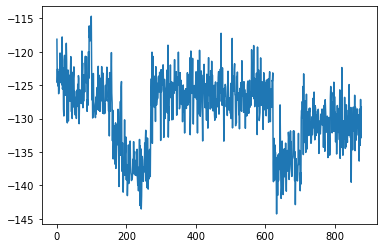

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 878, reward = -129.912125


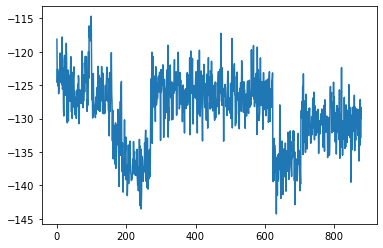

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 879, reward = -131.543777


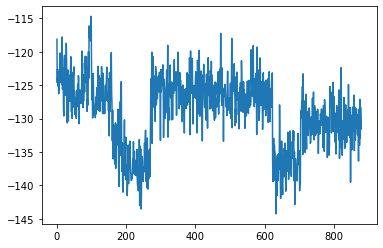

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 880, reward = -132.092789


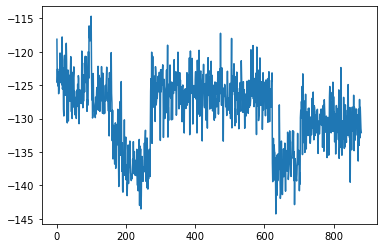

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 881, reward = -131.543381


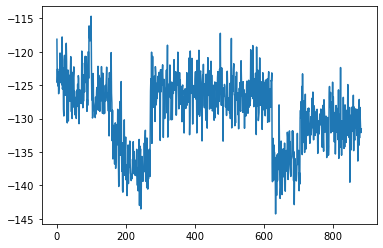

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 882, reward = -131.768204


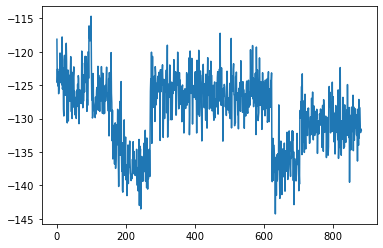

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 883, reward = -126.996109


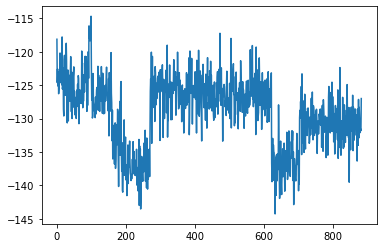

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 884, reward = -132.021423


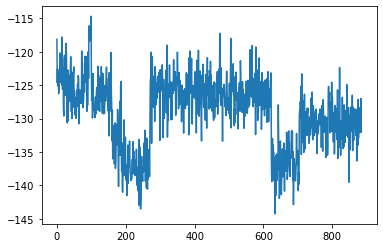

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 885, reward = -134.027878


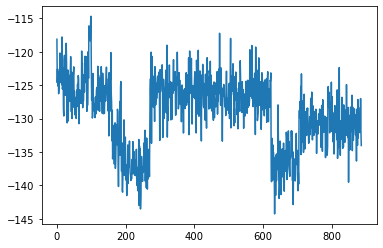

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 886, reward = -127.661720


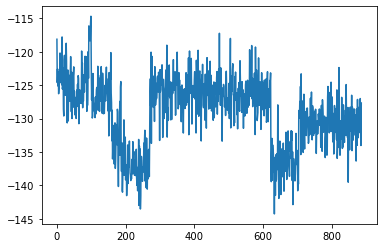

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 887, reward = -131.041245


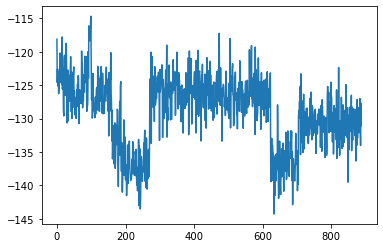

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 888, reward = -132.220673


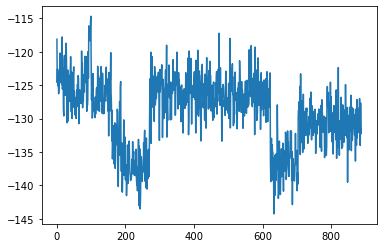

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 889, reward = -132.551300


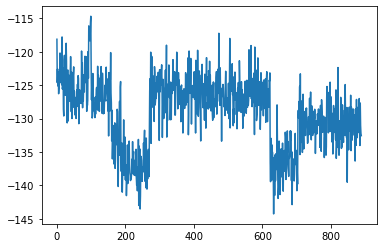

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 890, reward = -126.046394


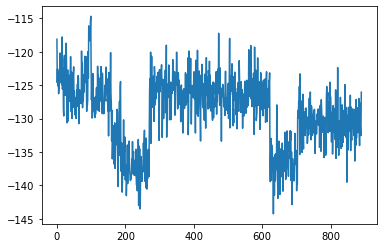

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 891, reward = -129.583511


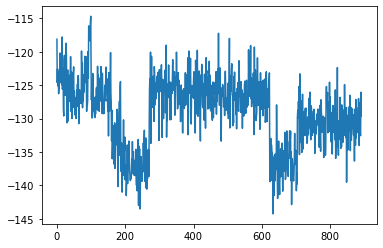

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 892, reward = -133.245850


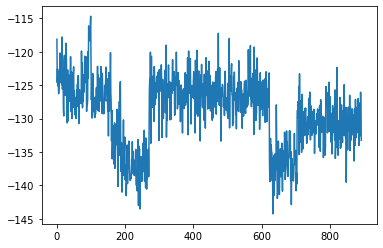

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 893, reward = -131.506973


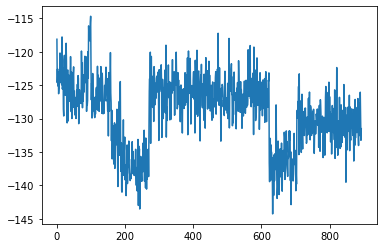

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 894, reward = -132.634552


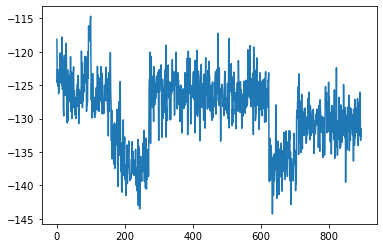

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 895, reward = -130.053528


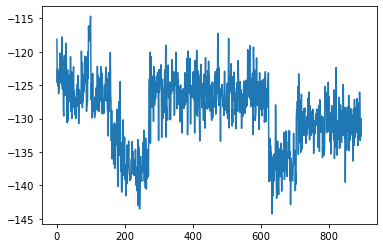

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 896, reward = -133.535187


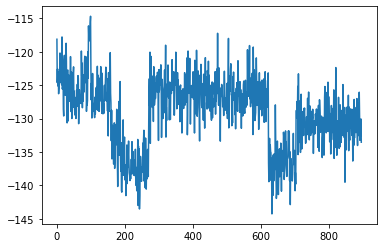

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 897, reward = -133.725449


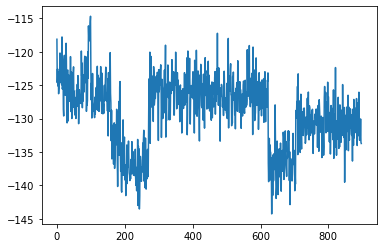

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 898, reward = -129.660019


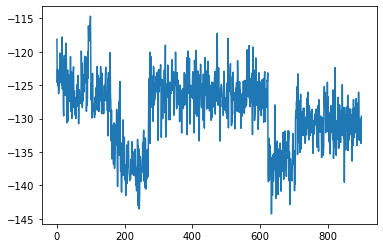

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 899, reward = -130.477142


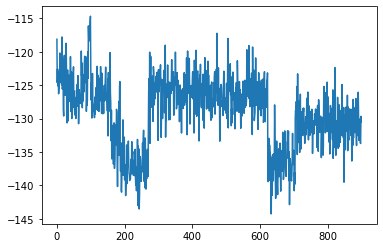

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 900, reward = -137.421555


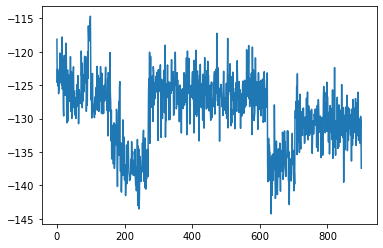

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 901, reward = -127.261406


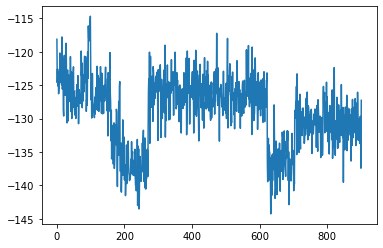

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 902, reward = -129.343430


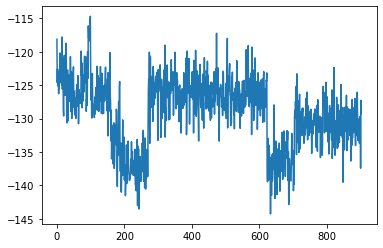

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 903, reward = -131.532135


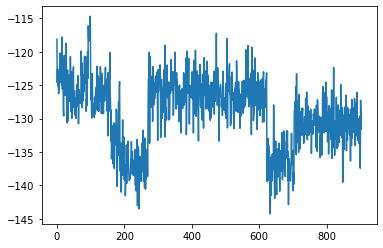

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 904, reward = -132.870193


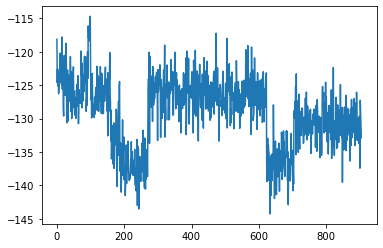

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 905, reward = -134.591095


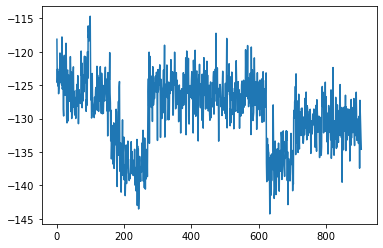

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 906, reward = -128.394180


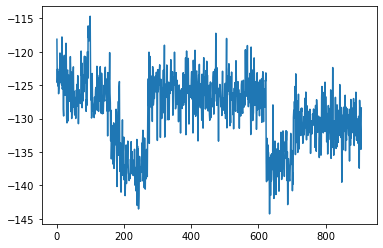

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 907, reward = -128.500458


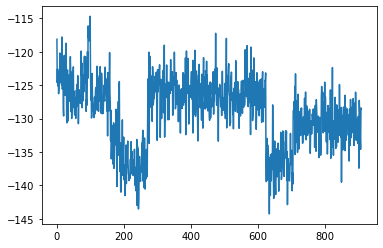

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 908, reward = -133.218979


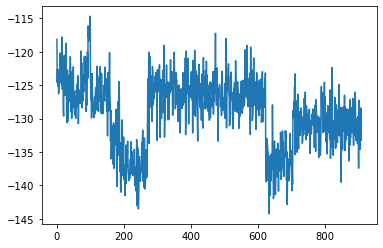

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 909, reward = -130.298767


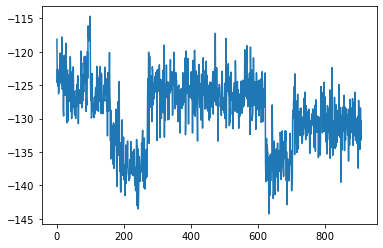

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 910, reward = -134.841843


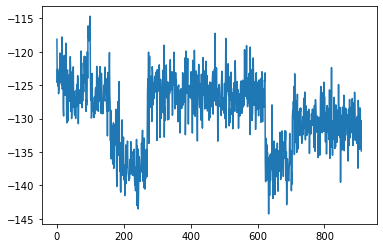

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 911, reward = -133.462128


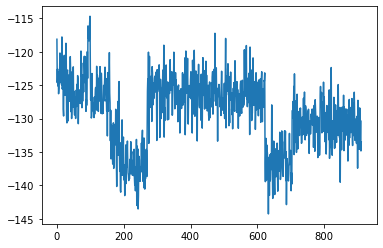

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 912, reward = -134.633255


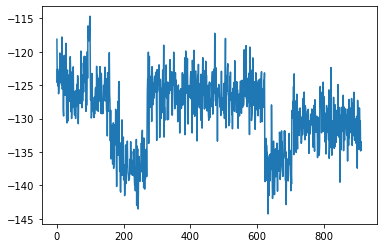

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 913, reward = -129.353821


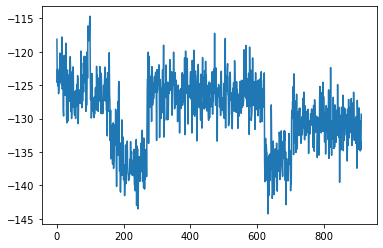

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 914, reward = -131.296799


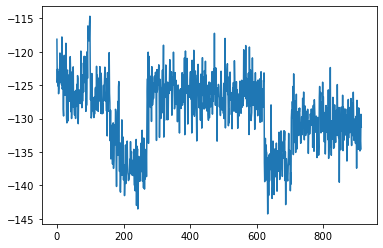

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 915, reward = -130.855408


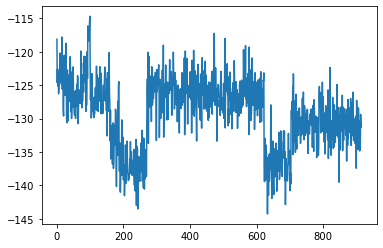

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 916, reward = -134.104401


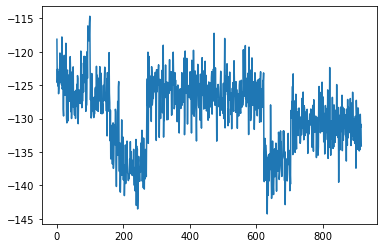

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 917, reward = -132.318436


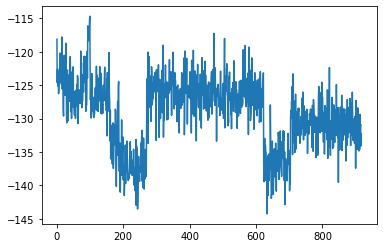

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 918, reward = -130.504349


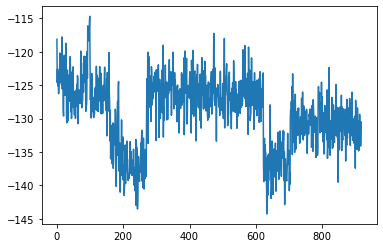

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 919, reward = -132.027618


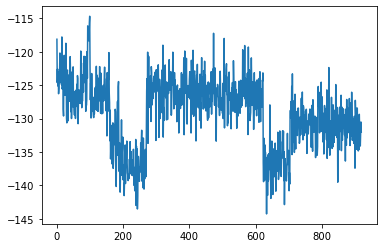

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 920, reward = -129.428009


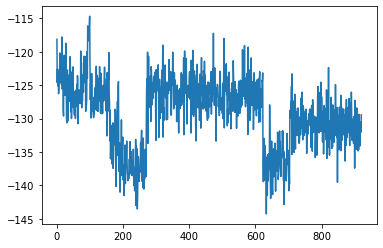

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 921, reward = -125.573601


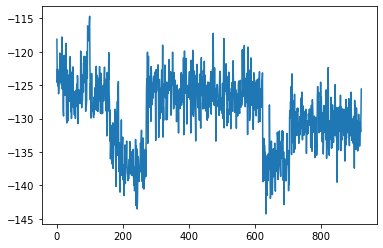

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 922, reward = -131.282547


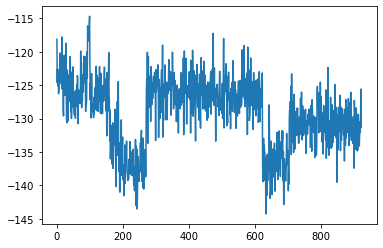

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 923, reward = -129.688416


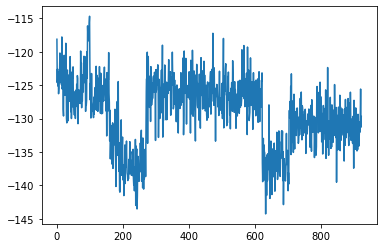

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 924, reward = -132.426865


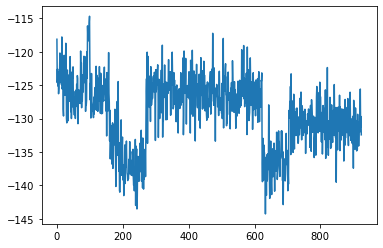

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 925, reward = -130.494965


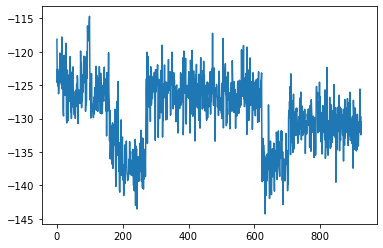

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 926, reward = -131.167419


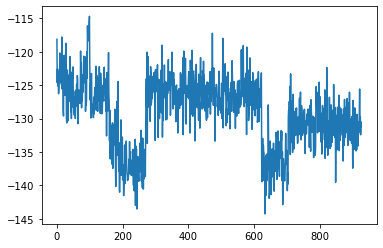

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 927, reward = -131.437622


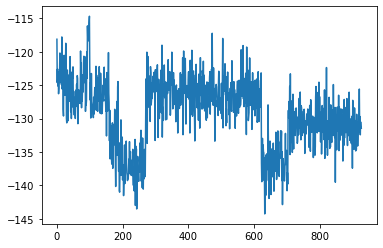

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 928, reward = -133.878891


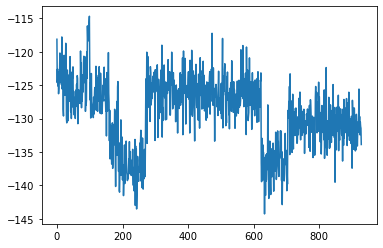

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 929, reward = -134.329147


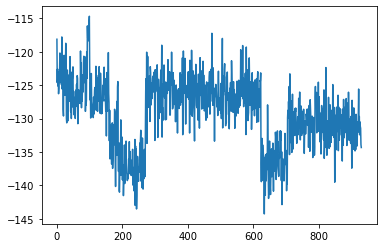

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 930, reward = -130.277237


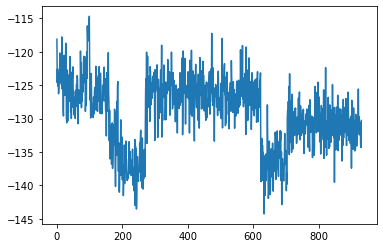

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 931, reward = -126.757790


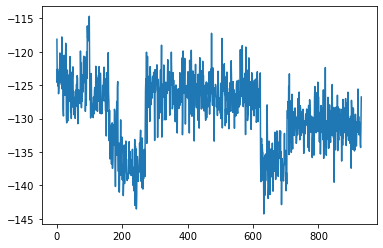

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 932, reward = -129.401993


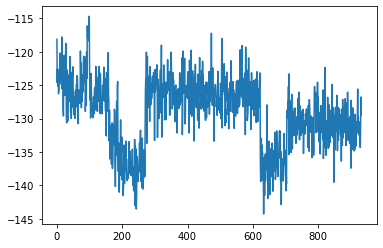

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 933, reward = -133.302582


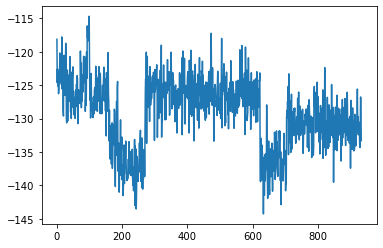

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 934, reward = -130.767761


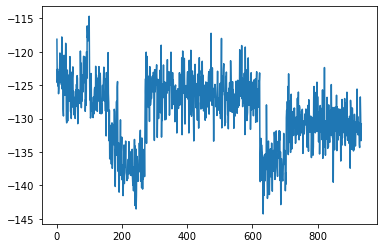

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 935, reward = -121.311729


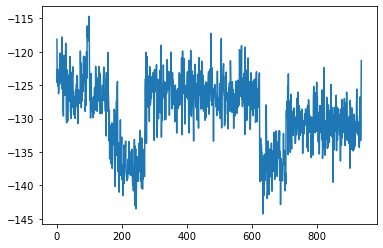

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 936, reward = -130.835968


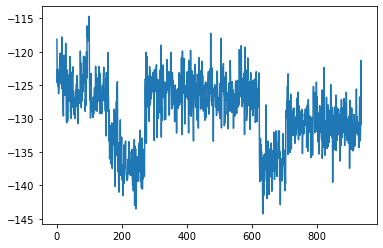

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 937, reward = -132.339264


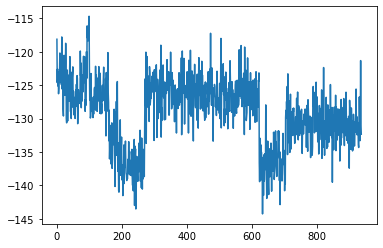

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 938, reward = -132.192429


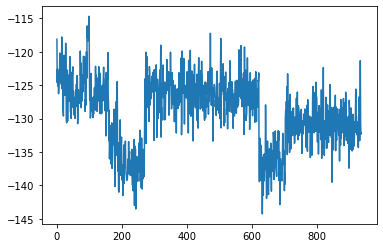

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 939, reward = -127.489975


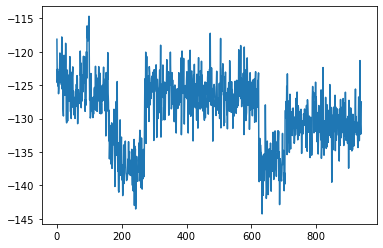

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 940, reward = -131.615982


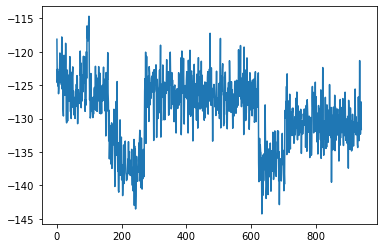

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 941, reward = -127.910347


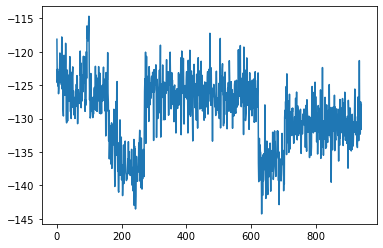

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 942, reward = -129.361435


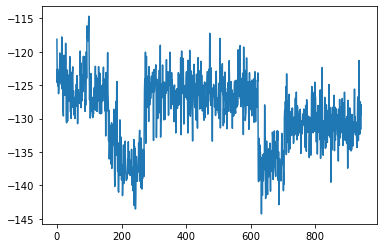

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 943, reward = -128.756561


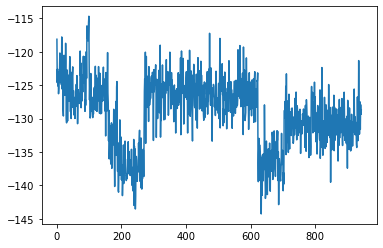

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 944, reward = -130.234863


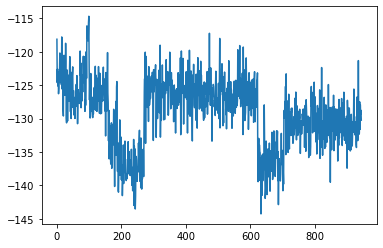

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 945, reward = -130.238770


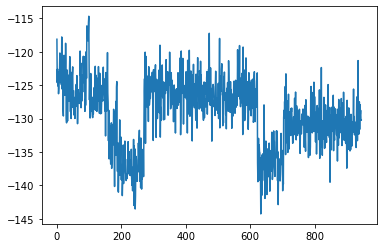

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 946, reward = -129.399689


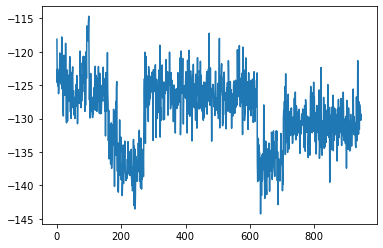

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 947, reward = -132.162277


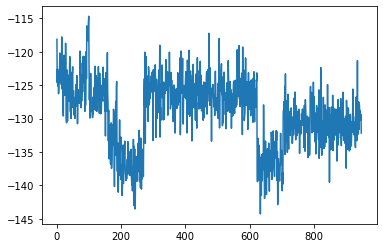

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 948, reward = -127.762077


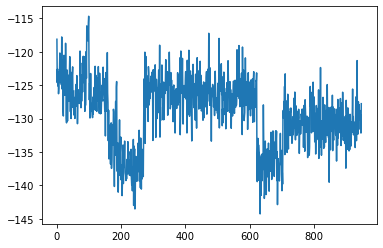

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 949, reward = -134.161804


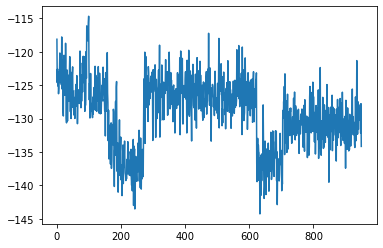

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 950, reward = -128.397858


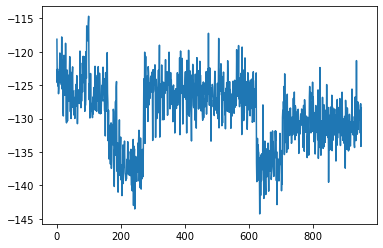

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 951, reward = -132.517273


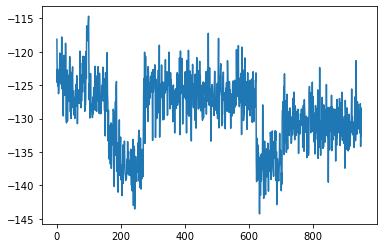

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 952, reward = -134.032440


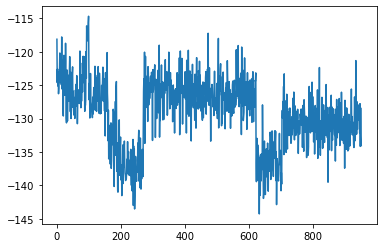

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 953, reward = -131.031296


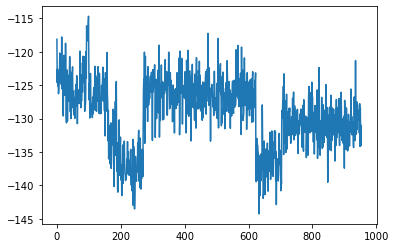

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 954, reward = -129.338028


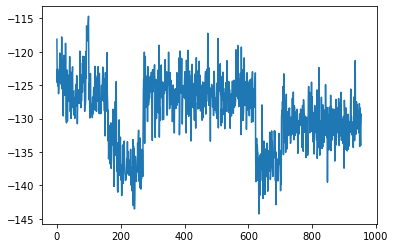

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 955, reward = -130.181931


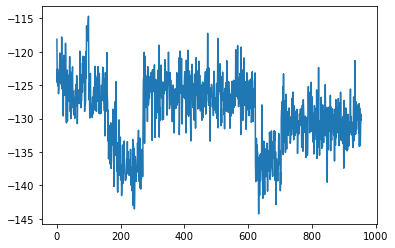

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 956, reward = -129.266479


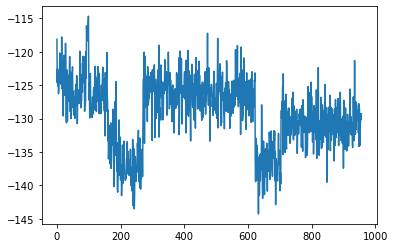

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 957, reward = -125.732796


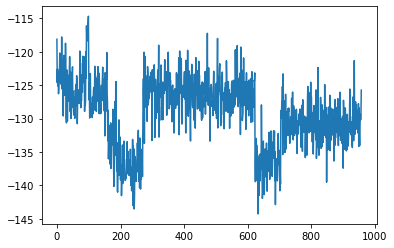

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 958, reward = -128.798630


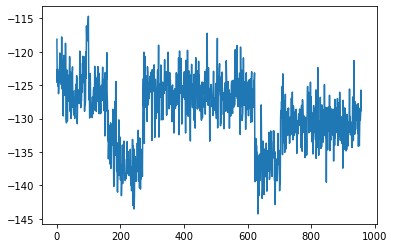

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 959, reward = -128.315048


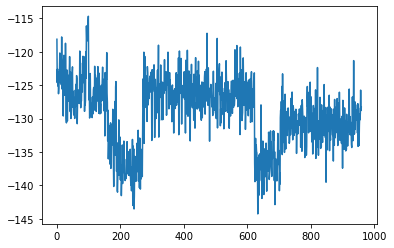

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 960, reward = -122.804611


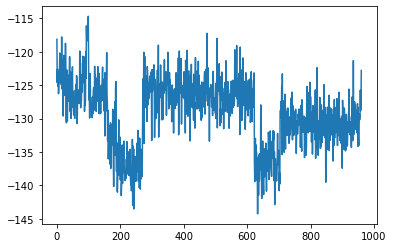

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 961, reward = -120.745193


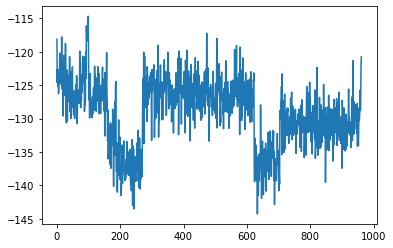

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 962, reward = -126.562546


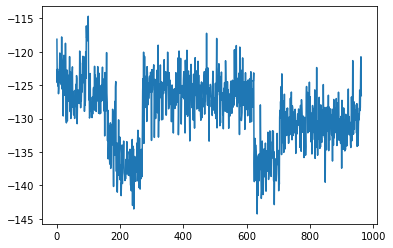

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 963, reward = -124.498093


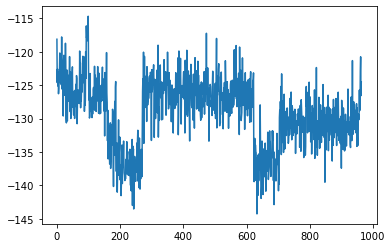

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 964, reward = -126.040718


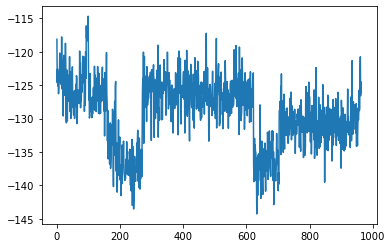

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 965, reward = -124.876549


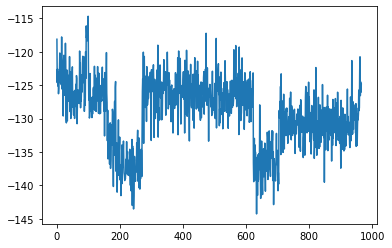

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 966, reward = -128.523041


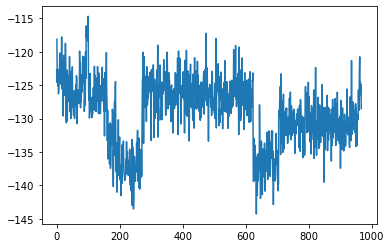

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 967, reward = -124.209595


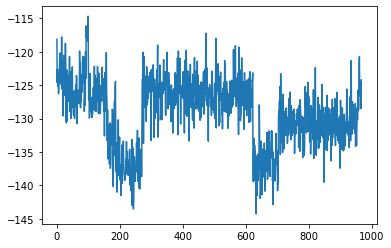

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 968, reward = -121.850983


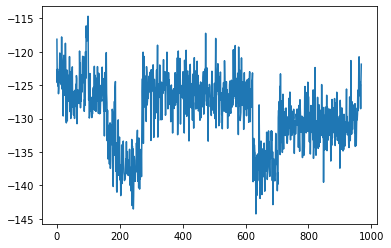

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 969, reward = -130.315613


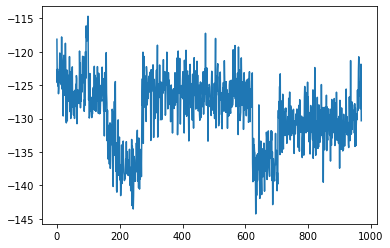

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 970, reward = -127.299950


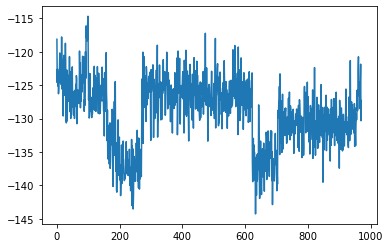

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 971, reward = -129.324081


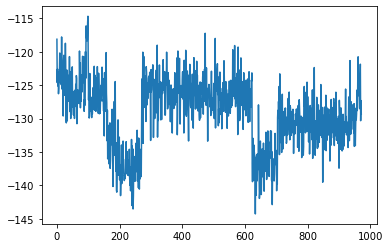

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 972, reward = -127.079910


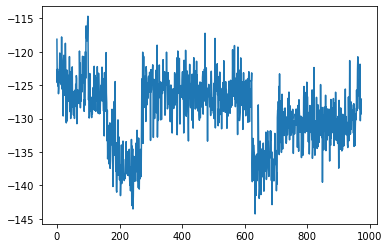

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 973, reward = -127.824036


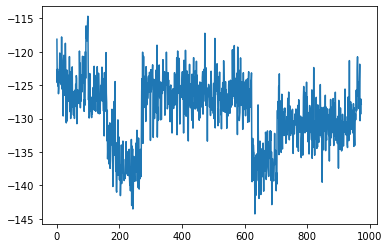

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 974, reward = -122.523872


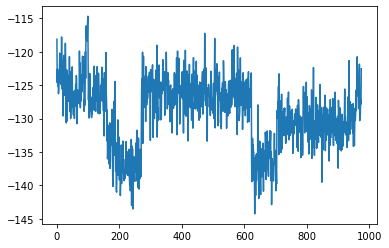

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 975, reward = -129.584442


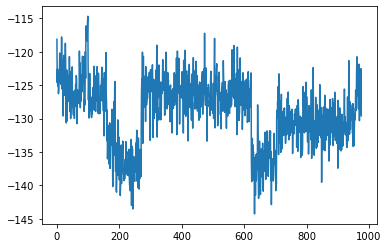

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 976, reward = -128.166122


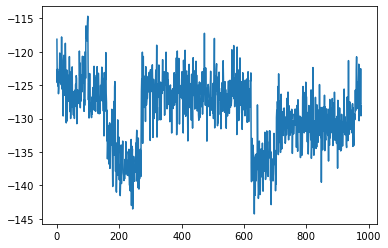

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 977, reward = -124.468491


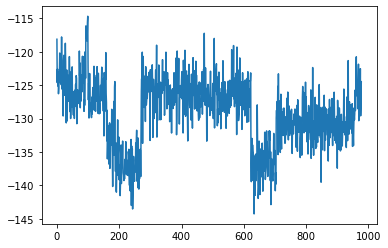

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 978, reward = -127.486877


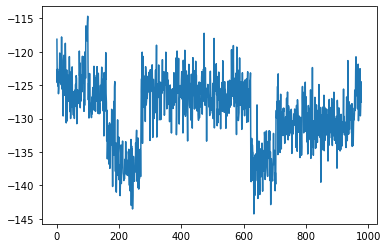

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 979, reward = -123.521797


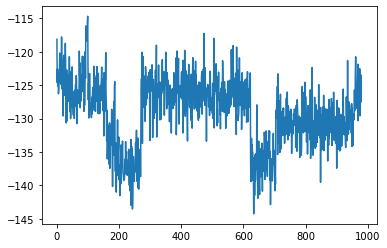

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 980, reward = -127.192268


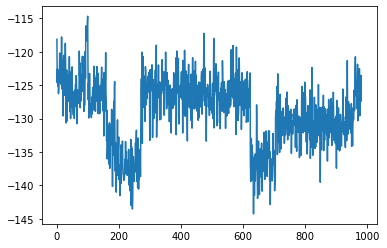

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 981, reward = -126.090927


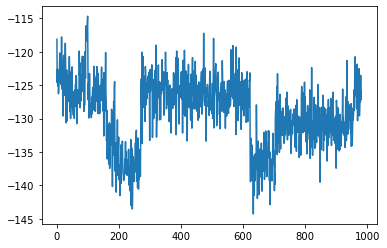

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 982, reward = -127.704643


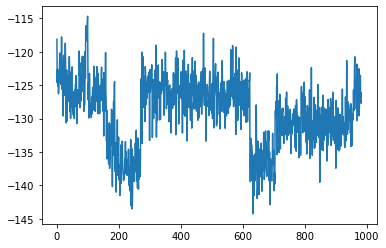

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 983, reward = -128.972015


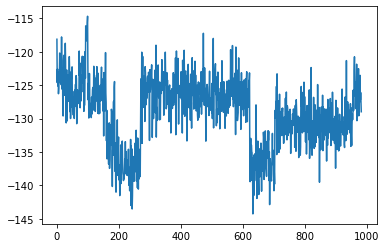

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 984, reward = -126.511742


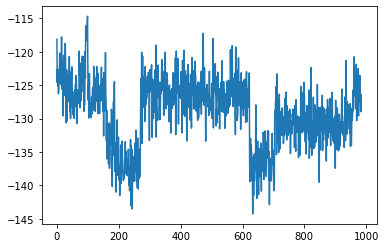

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 985, reward = -125.857536


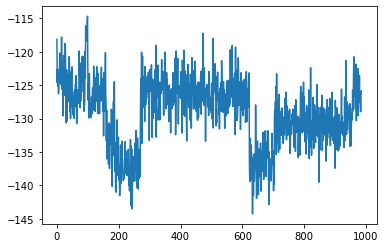

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 986, reward = -123.779930


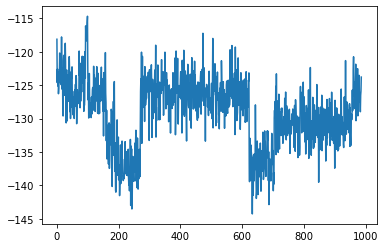

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 987, reward = -128.626907


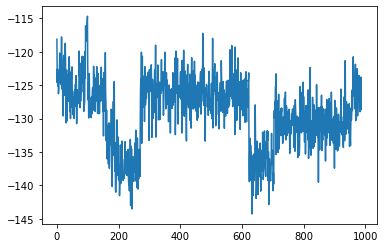

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 988, reward = -125.017418


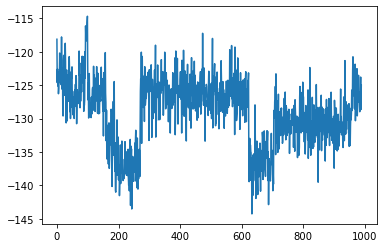

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 989, reward = -129.378006


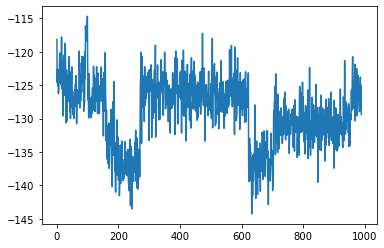

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 990, reward = -127.983047


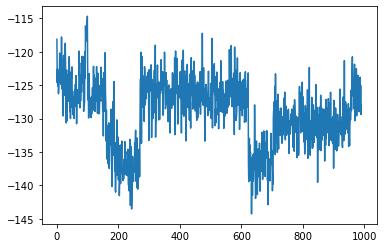

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 991, reward = -130.815521


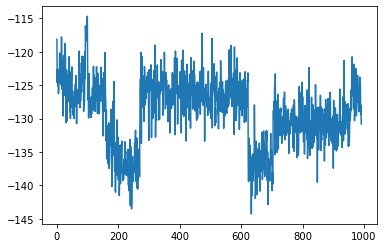

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 992, reward = -122.395248


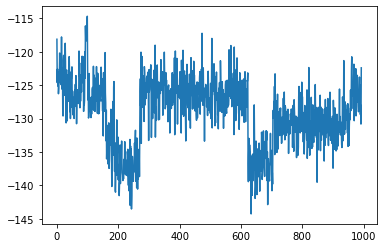

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 993, reward = -124.277191


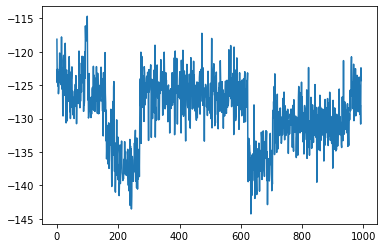

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 994, reward = -129.834778


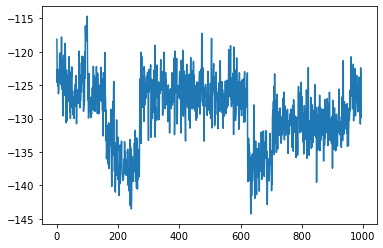

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 995, reward = -124.259796


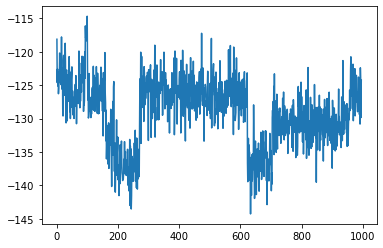

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 996, reward = -127.897659


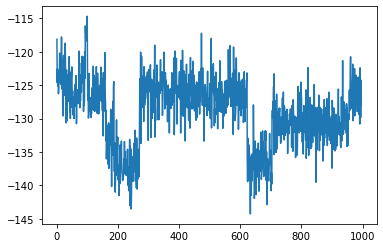

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 997, reward = -125.237244


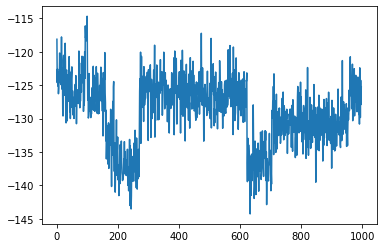

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 998, reward = -126.345581


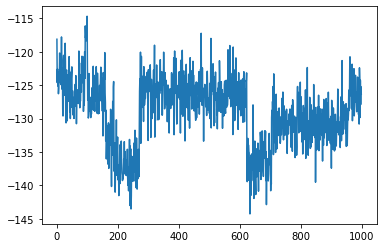

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 999, reward = -120.690407


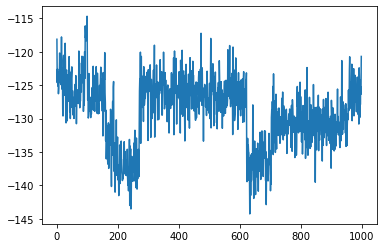

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1000, reward = -126.157875


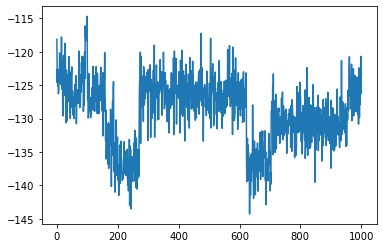

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1001, reward = -128.081696


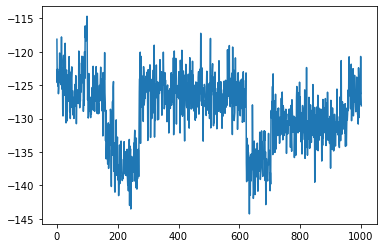

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1002, reward = -126.935890


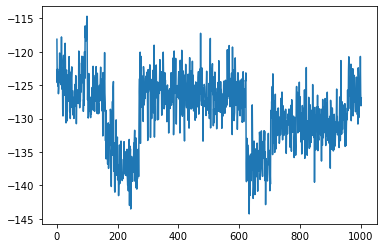

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1003, reward = -129.047745


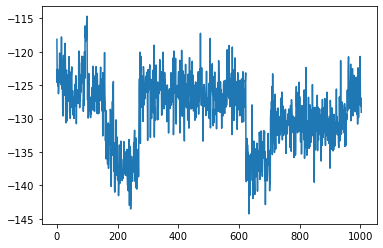

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1004, reward = -130.103989


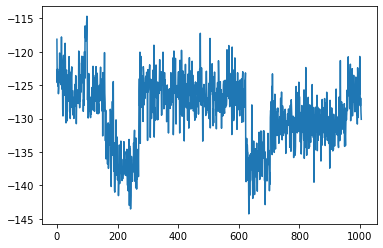

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1005, reward = -125.491753


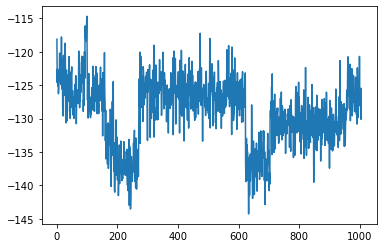

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1006, reward = -123.675804


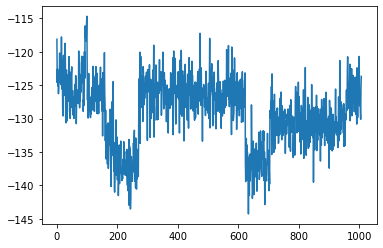

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1007, reward = -119.931374


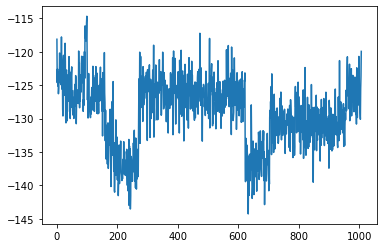

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1008, reward = -125.595497


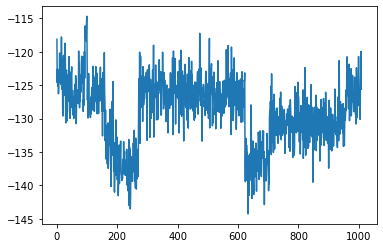

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1009, reward = -126.292442


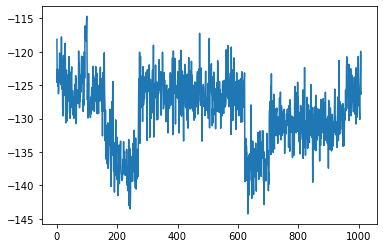

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1010, reward = -124.542107


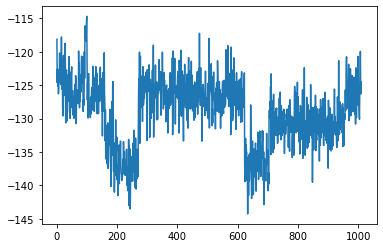

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1011, reward = -126.638489


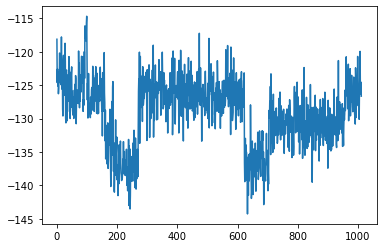

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1012, reward = -130.662735


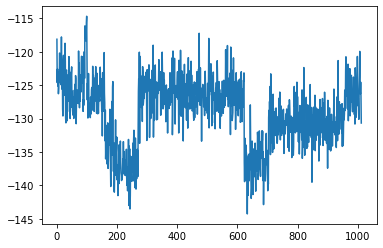

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1013, reward = -125.162300


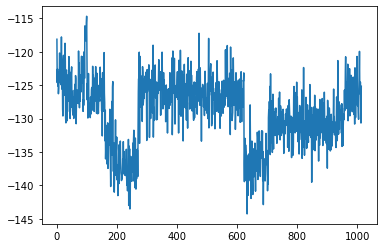

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1014, reward = -128.728439


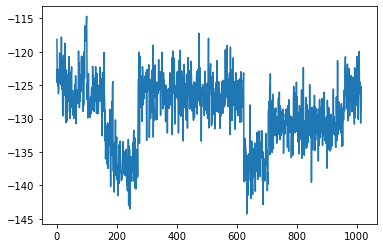

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1015, reward = -124.395096


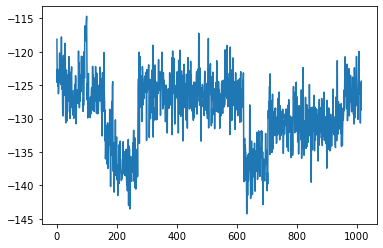

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1016, reward = -125.405220


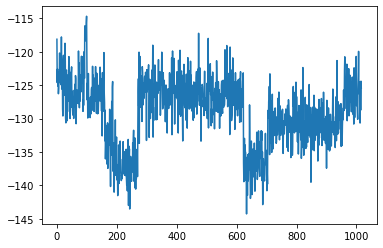

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1017, reward = -128.765335


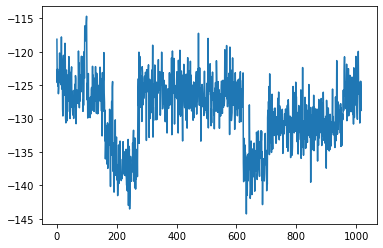

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1018, reward = -124.656746


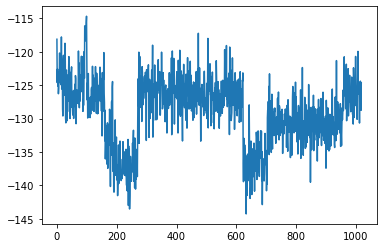

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1019, reward = -119.946388


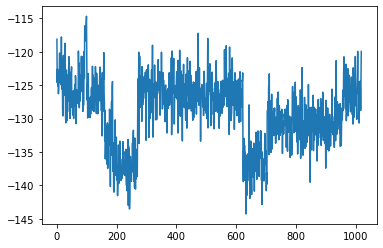

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1020, reward = -124.167198


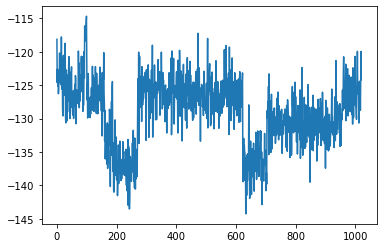

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1021, reward = -124.304474


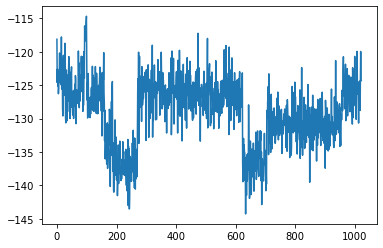

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1022, reward = -125.990768


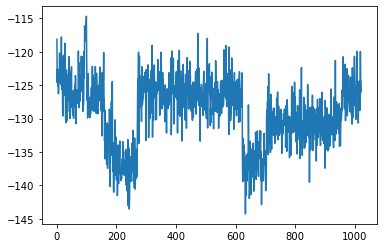

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1023, reward = -125.592850


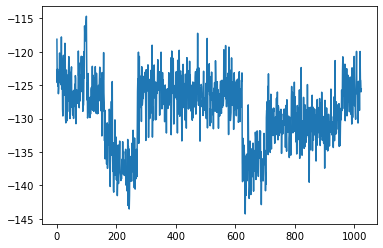

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1024, reward = -128.714355


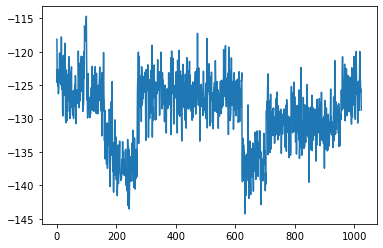

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1025, reward = -125.638481


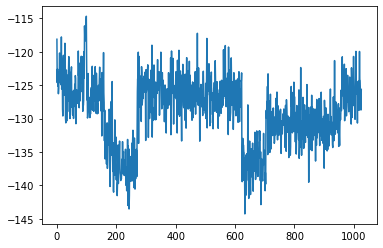

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1026, reward = -122.191788


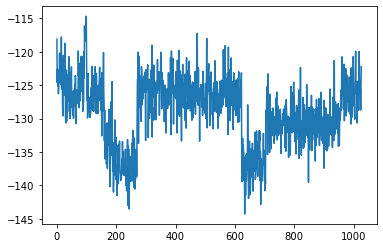

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1027, reward = -125.310417


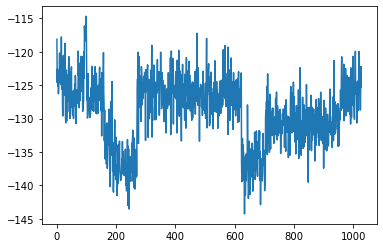

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1028, reward = -122.841782


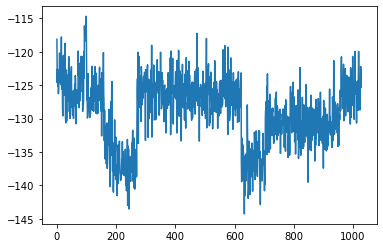

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1029, reward = -124.063187


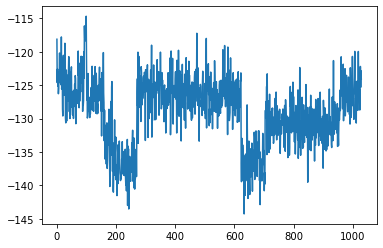

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1030, reward = -124.619644


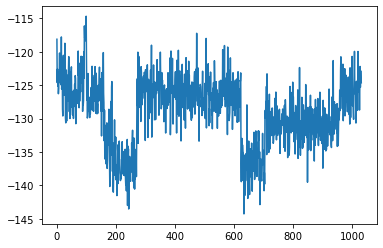

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1031, reward = -126.325569


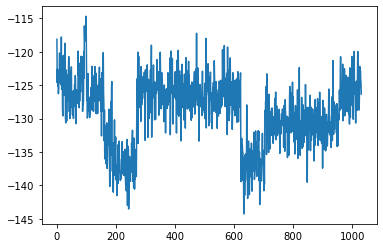

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1032, reward = -124.807312


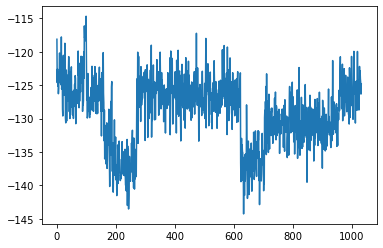

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1033, reward = -127.288269


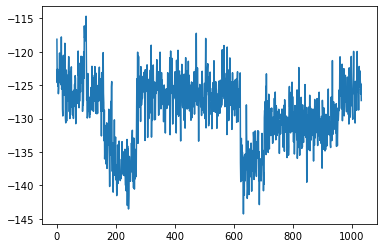

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1034, reward = -125.194534


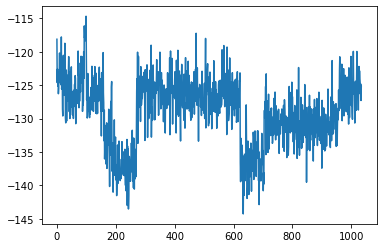

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1035, reward = -126.952164


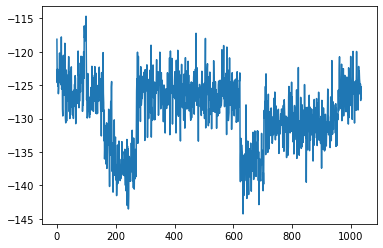

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1036, reward = -123.539108


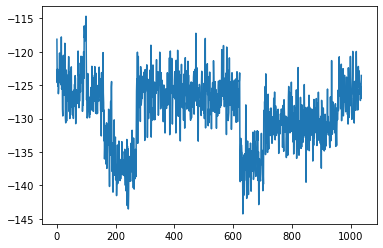

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1037, reward = -126.734970


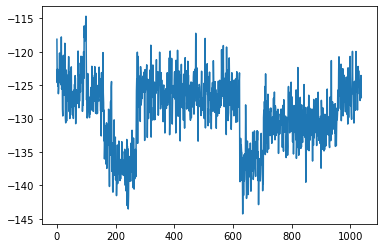

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1038, reward = -126.923561


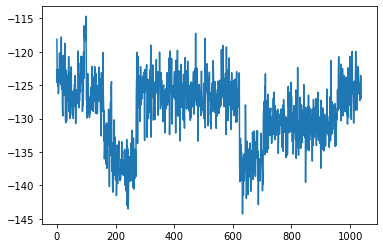

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1039, reward = -122.117554


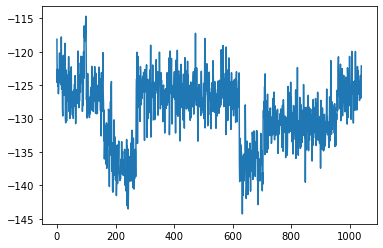

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1040, reward = -126.361359


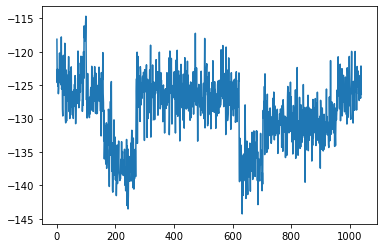

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1041, reward = -125.317642


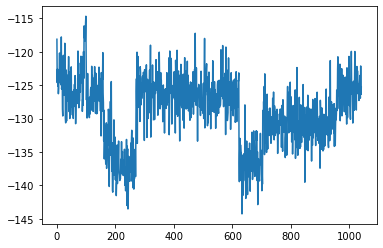

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1042, reward = -124.107391


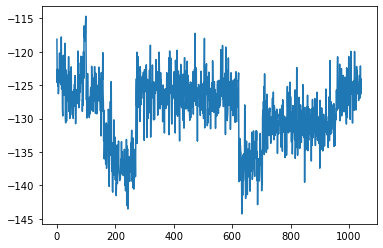

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1043, reward = -126.540161


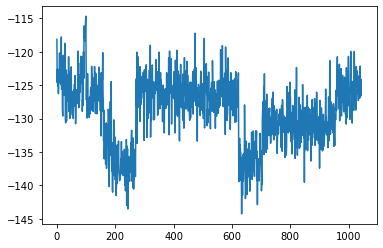

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1044, reward = -127.242325


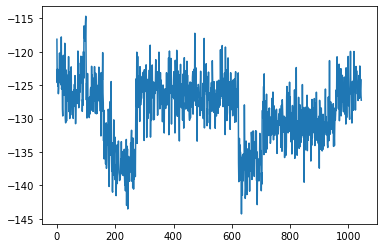

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1045, reward = -125.605743


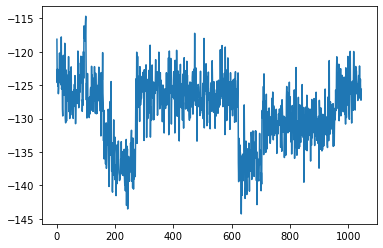

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1046, reward = -129.419662


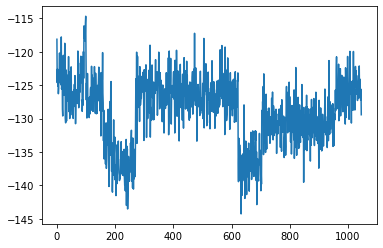

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1047, reward = -124.452721


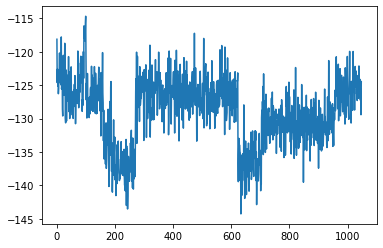

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1048, reward = -124.350121


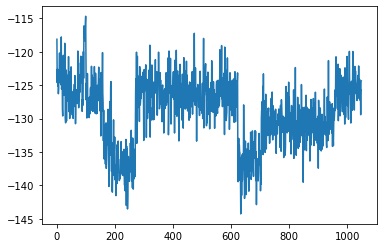

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1049, reward = -126.833687


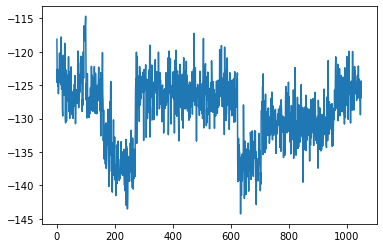

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1050, reward = -126.051697


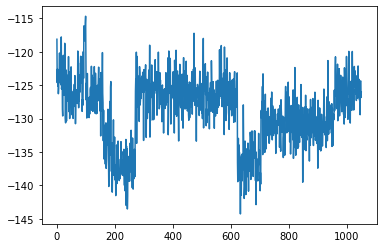

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1051, reward = -119.993469


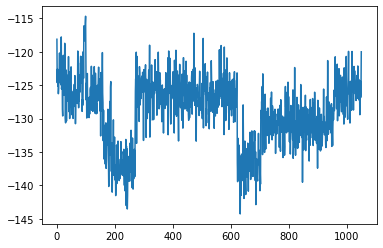

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1052, reward = -127.728004


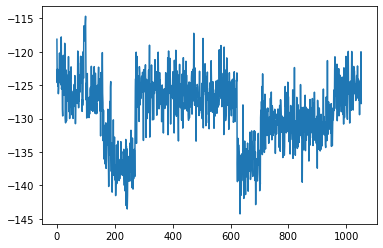

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1053, reward = -124.276817


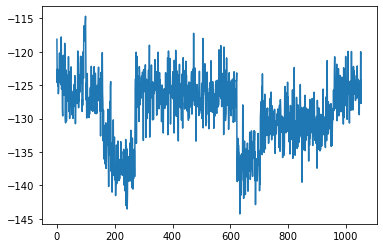

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1054, reward = -127.413643


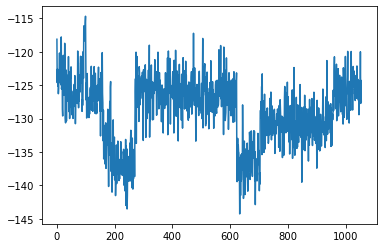

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1055, reward = -125.358307


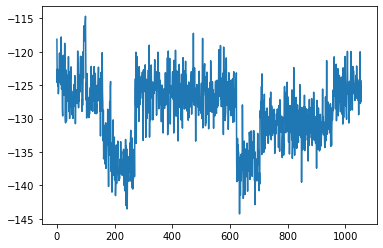

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1056, reward = -128.209702


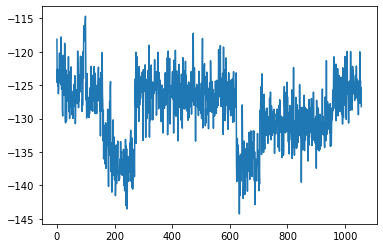

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1057, reward = -124.375420


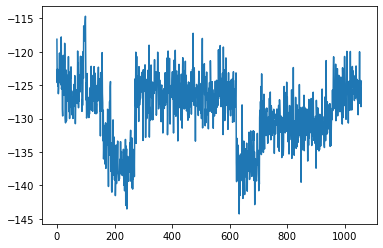

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1058, reward = -126.954758


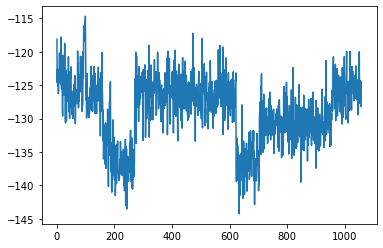

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1059, reward = -121.814285


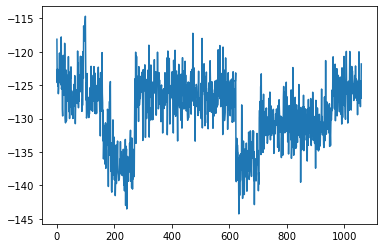

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1060, reward = -127.121529


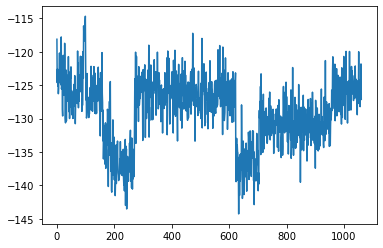

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1061, reward = -127.604271


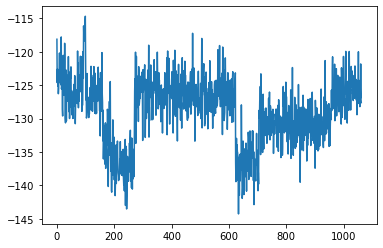

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1062, reward = -126.086021


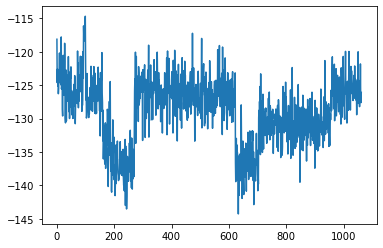

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1063, reward = -123.033577


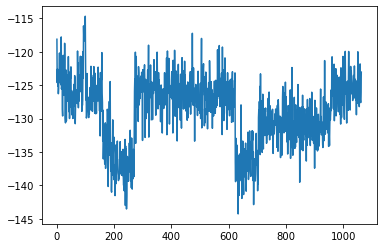

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1064, reward = -123.899879


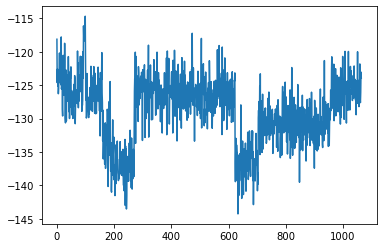

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1065, reward = -125.857712


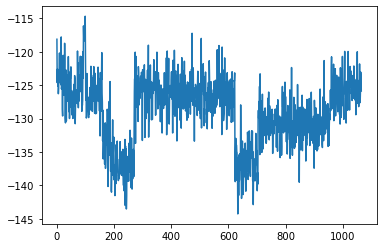

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1066, reward = -126.837440


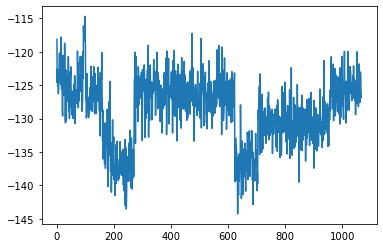

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1067, reward = -124.806450


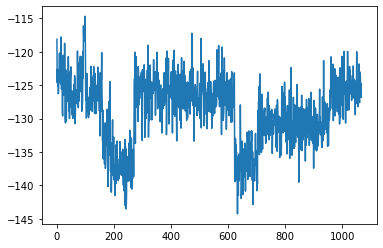

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1068, reward = -121.258797


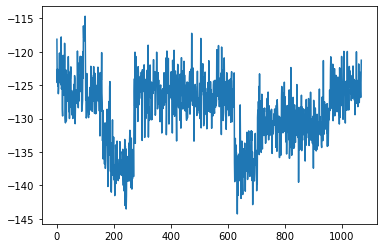

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1069, reward = -125.461670


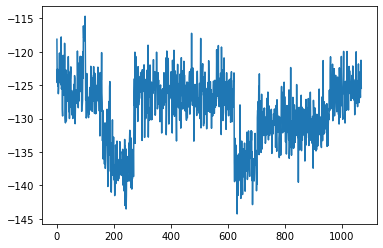

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1070, reward = -133.408966


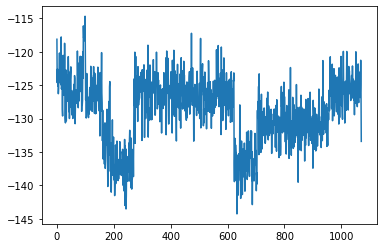

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1071, reward = -126.962845


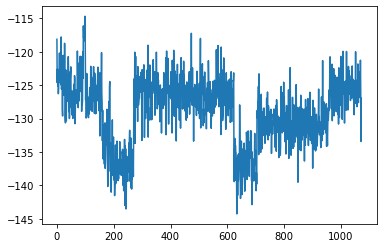

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1072, reward = -127.716492


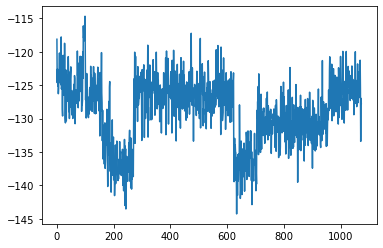

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1073, reward = -123.754181


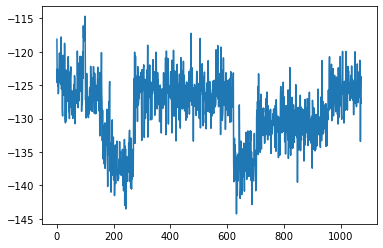

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1074, reward = -126.163223


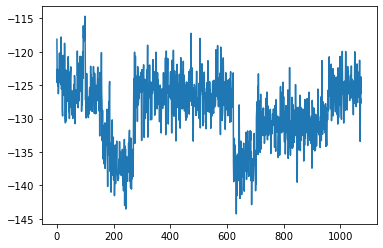

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1075, reward = -125.850090


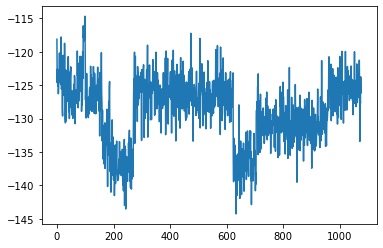

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1076, reward = -126.053345


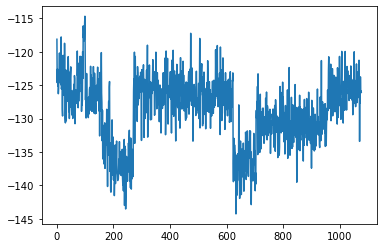

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1077, reward = -128.710785


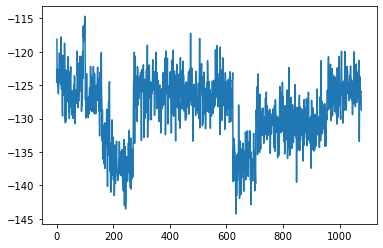

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1078, reward = -126.993561


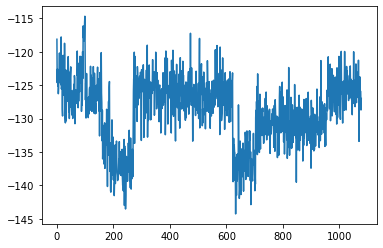

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1079, reward = -124.157700


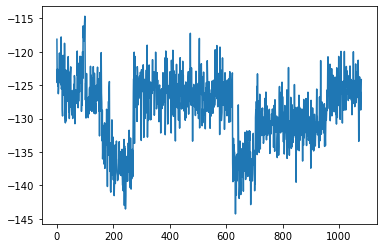

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1080, reward = -128.783493


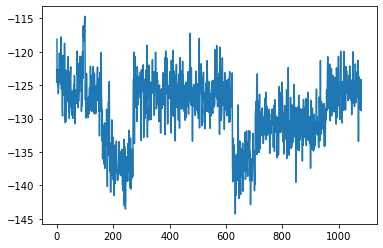

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1081, reward = -125.380272


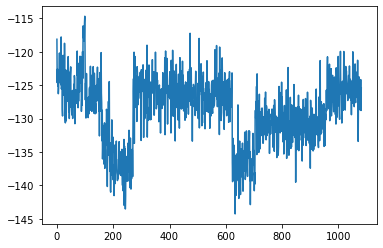

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1082, reward = -124.479301


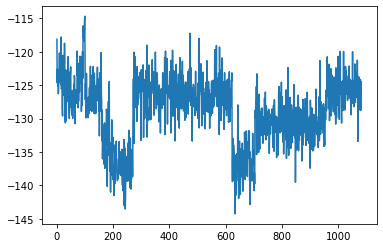

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1083, reward = -125.911209


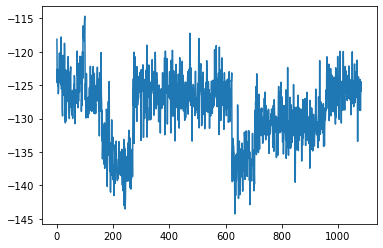

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1084, reward = -124.380341


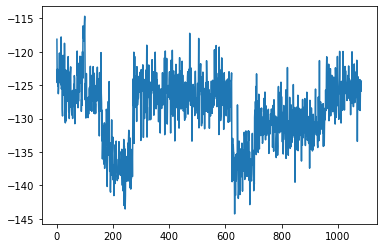

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1085, reward = -126.460457


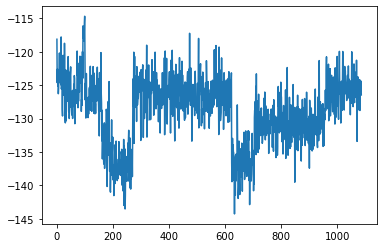

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1086, reward = -127.748482


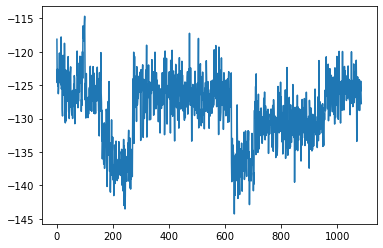

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1087, reward = -128.665558


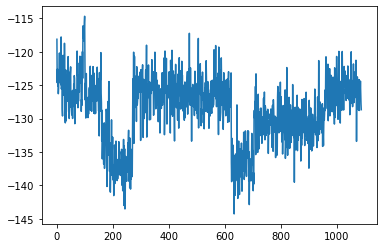

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1088, reward = -129.063370


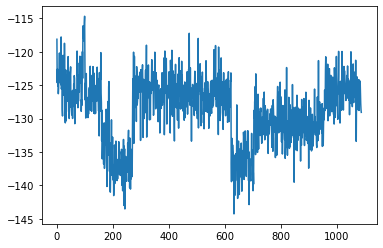

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1089, reward = -122.705627


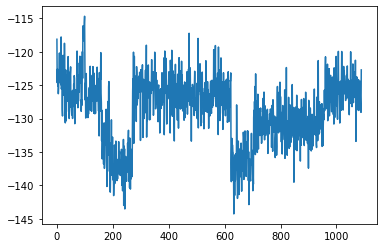

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1090, reward = -123.964714


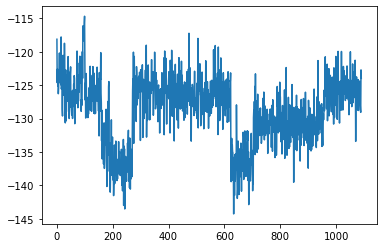

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1091, reward = -124.471642


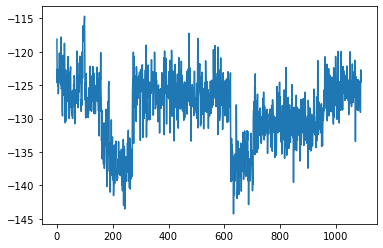

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1092, reward = -121.041748


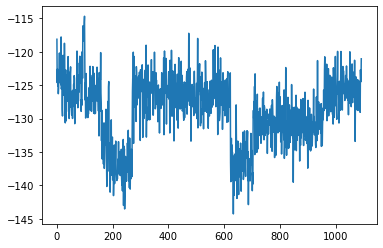

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1093, reward = -125.396744


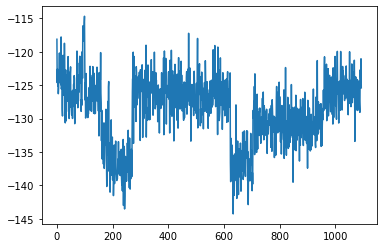

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1094, reward = -123.685699


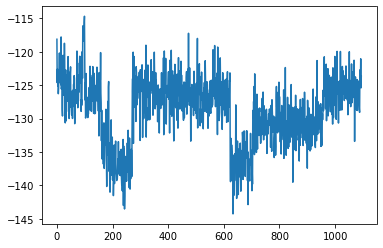

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1095, reward = -124.762581


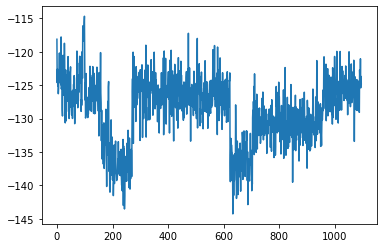

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1096, reward = -126.356194


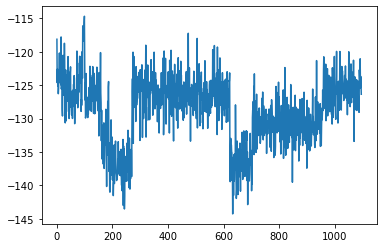

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1097, reward = -122.621643


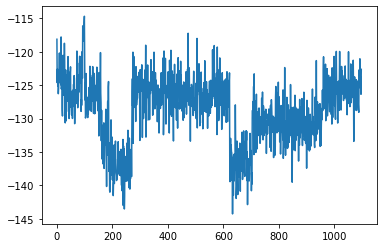

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1098, reward = -123.037865


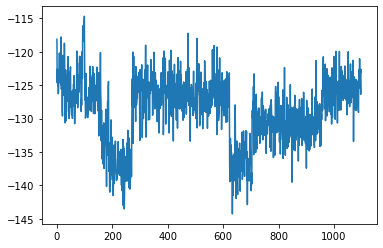

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1099, reward = -125.153358


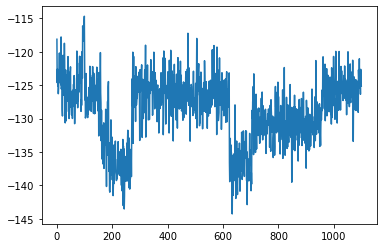

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1100, reward = -129.872986


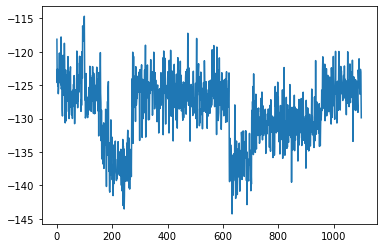

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1101, reward = -122.207207


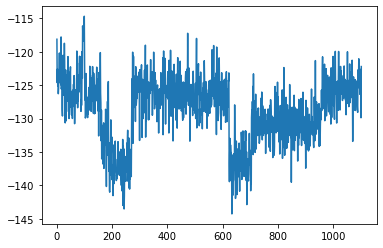

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1102, reward = -125.644997


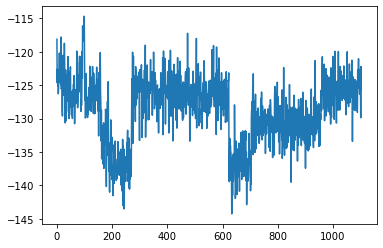

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1103, reward = -125.930595


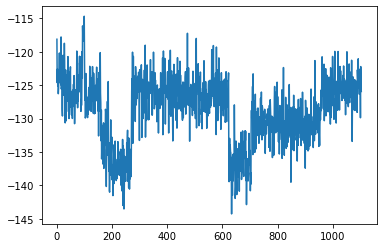

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1104, reward = -128.842682


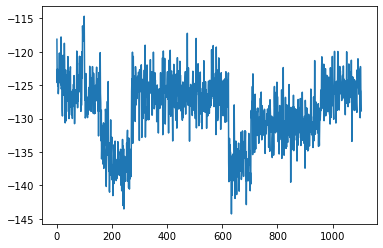

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1105, reward = -123.044571


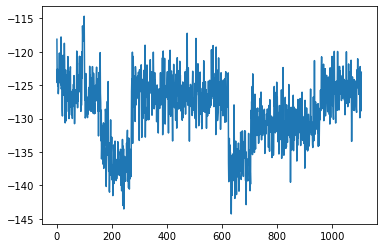

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1106, reward = -126.523560


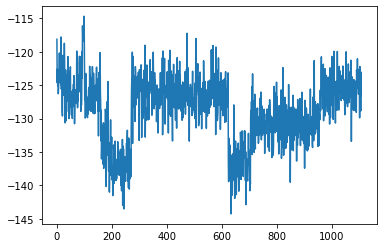

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1107, reward = -124.500786


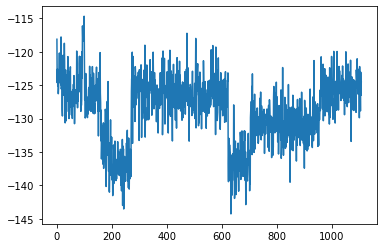

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1108, reward = -127.209206


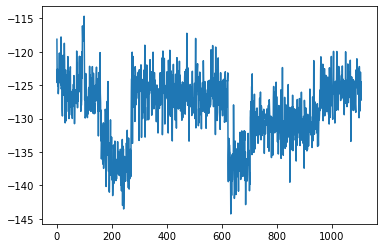

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1109, reward = -126.417305


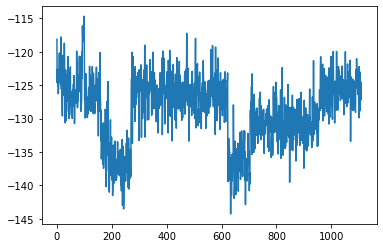

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1110, reward = -125.806595


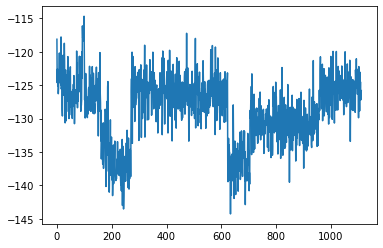

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1111, reward = -123.135788


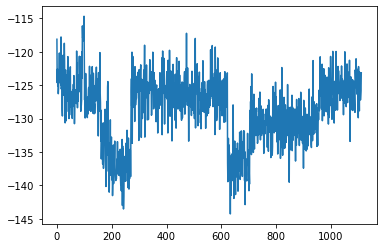

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1112, reward = -123.930466


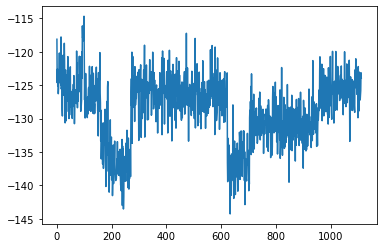

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1113, reward = -127.793327


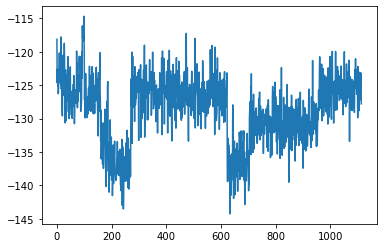

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1114, reward = -129.788193


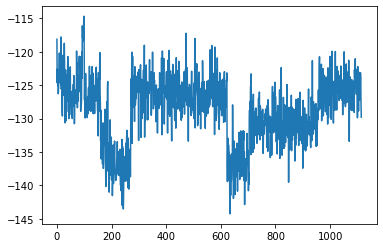

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1115, reward = -128.661194


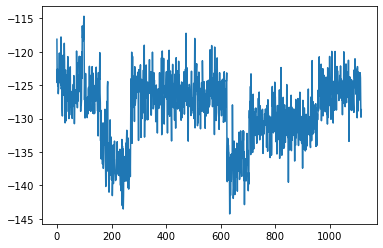

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1116, reward = -125.780212


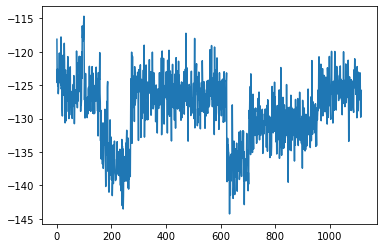

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1117, reward = -127.396225


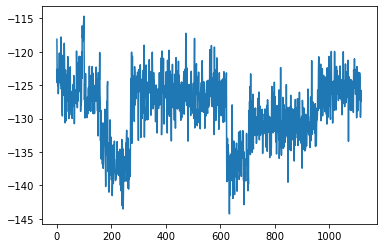

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1118, reward = -127.919403


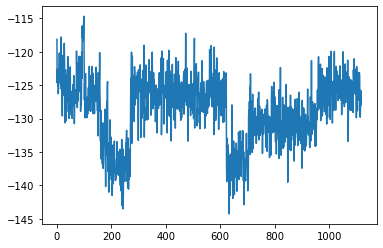

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1119, reward = -129.009323


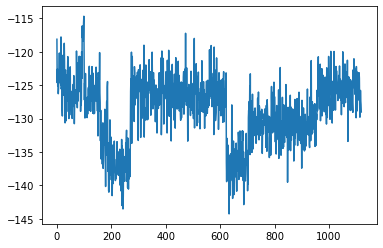

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1120, reward = -131.063828


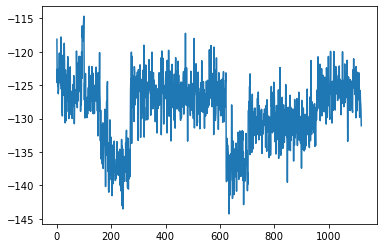

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1121, reward = -128.319351


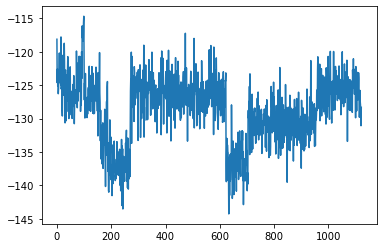

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1122, reward = -127.369286


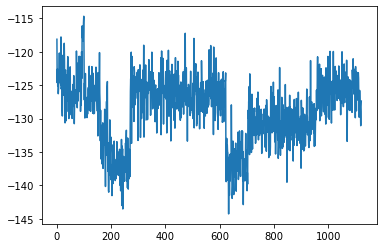

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1123, reward = -122.102547


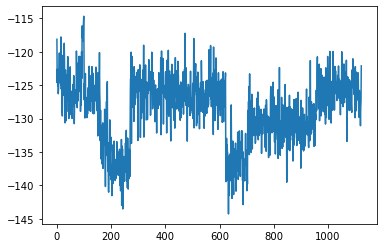

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1124, reward = -127.816055


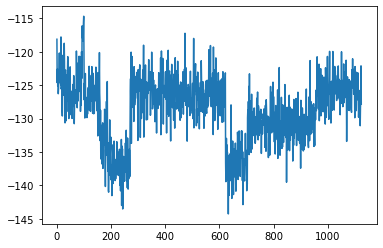

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1125, reward = -125.135422


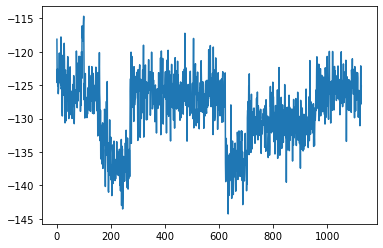

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1126, reward = -127.283478


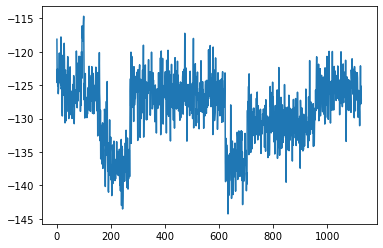

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1127, reward = -125.121582


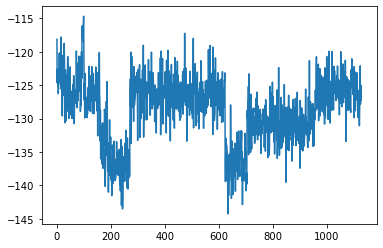

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1128, reward = -119.955589


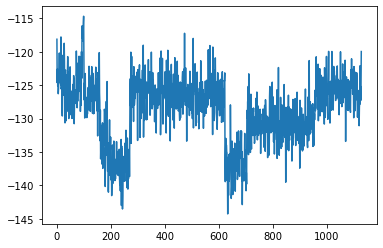

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1129, reward = -126.473038


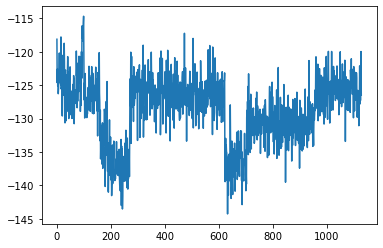

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1130, reward = -125.830780


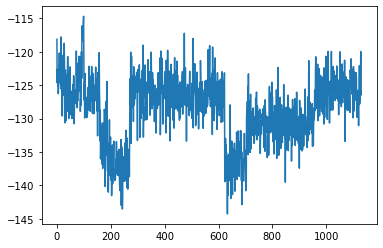

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1131, reward = -123.685982


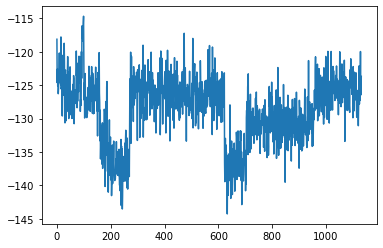

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1132, reward = -128.043427


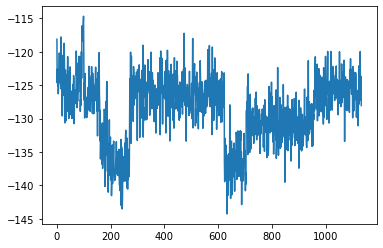

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1133, reward = -125.314644


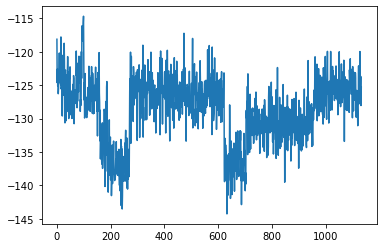

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1134, reward = -127.491402


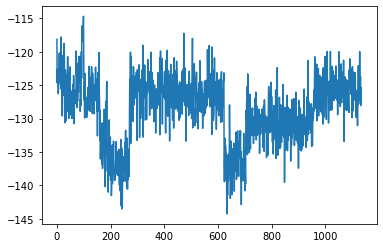

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1135, reward = -123.795906


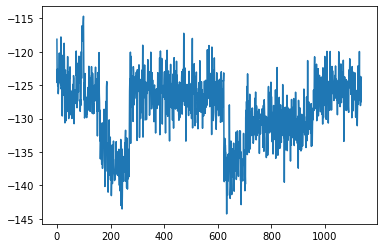

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1136, reward = -128.872726


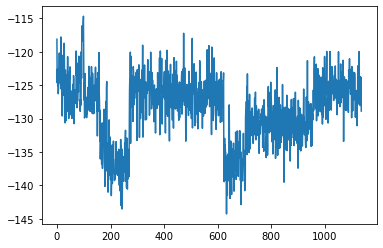

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1137, reward = -123.000740


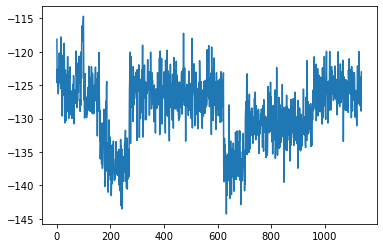

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1138, reward = -131.548248


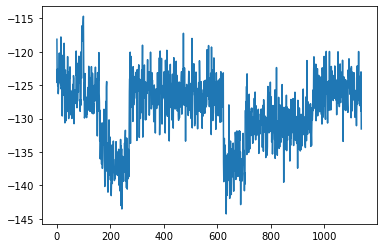

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1139, reward = -126.005142


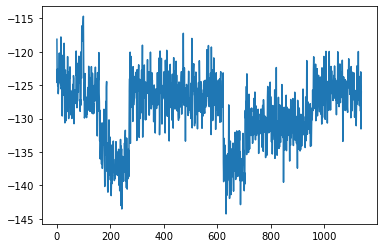

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1140, reward = -124.222252


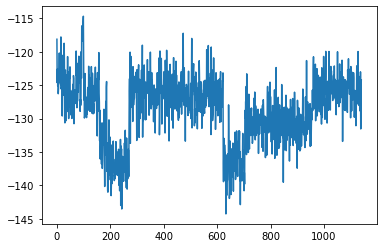

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1141, reward = -122.915405


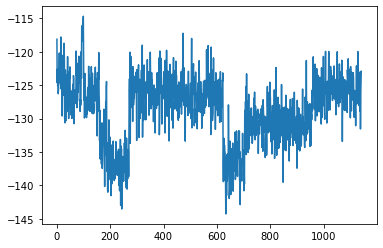

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1142, reward = -124.853668


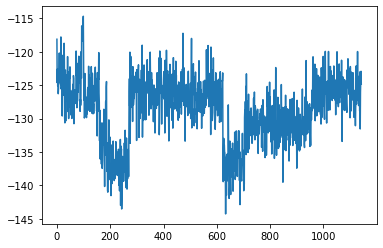

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1143, reward = -126.612755


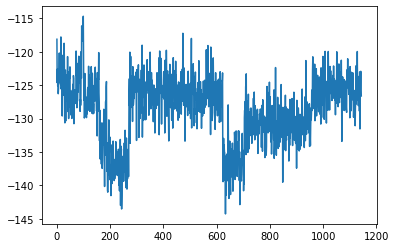

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1144, reward = -128.676453


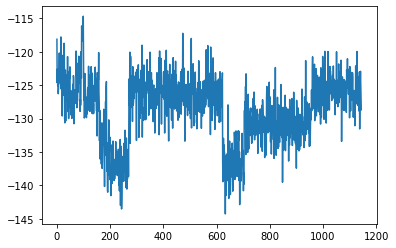

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1145, reward = -126.364182


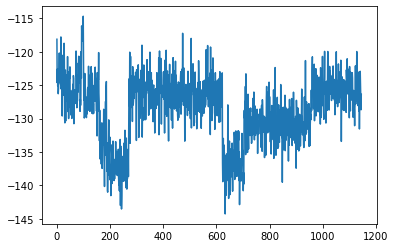

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1146, reward = -125.024796


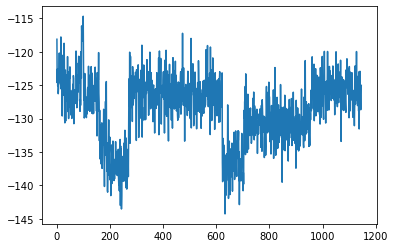

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1147, reward = -128.153687


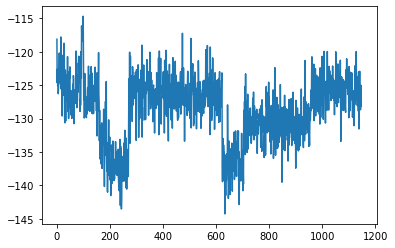

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1148, reward = -125.041283


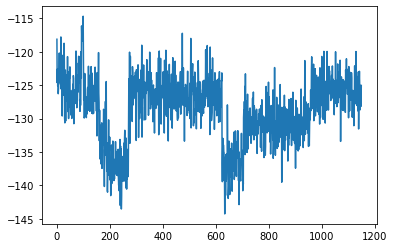

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1149, reward = -124.631165


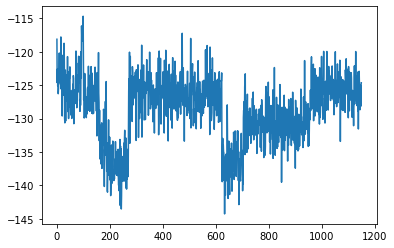

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1150, reward = -126.049698


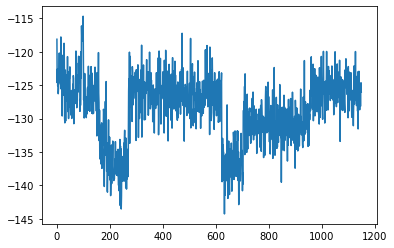

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1151, reward = -131.332764


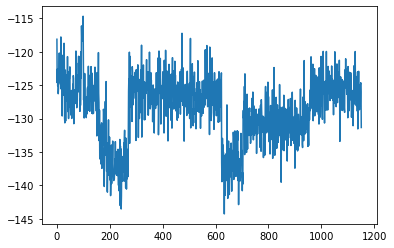

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1152, reward = -126.125801


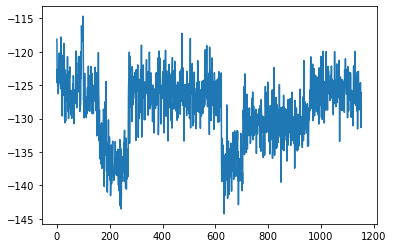

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1153, reward = -125.495888


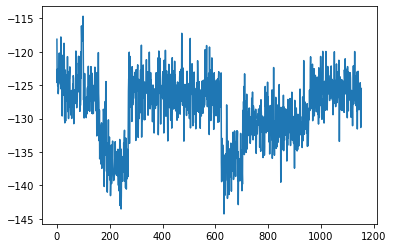

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1154, reward = -130.149475


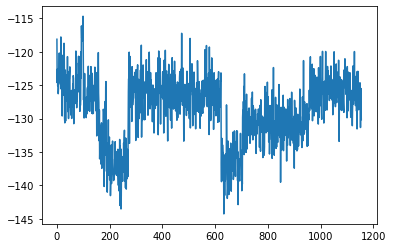

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1155, reward = -122.922943


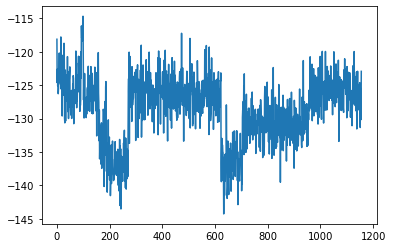

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1156, reward = -127.431450


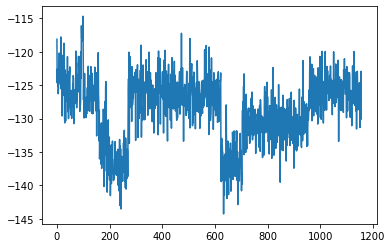

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1157, reward = -129.009644


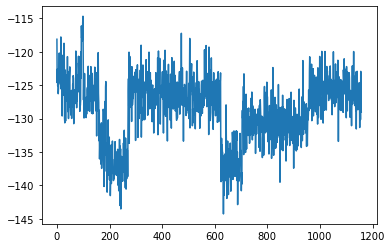

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1158, reward = -123.797905


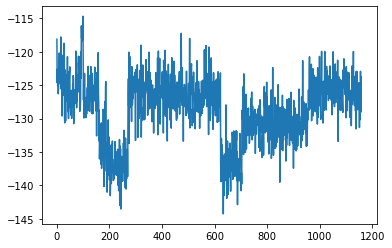

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1159, reward = -122.267693


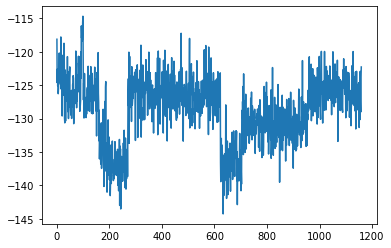

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1160, reward = -128.278305


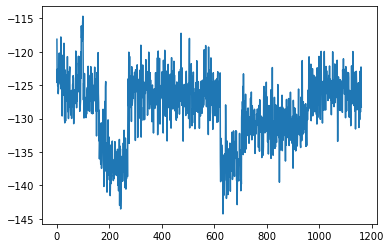

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1161, reward = -119.094627


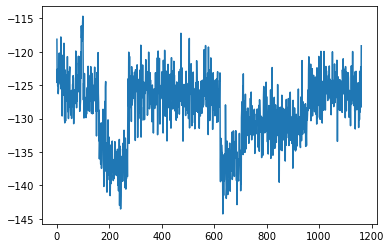

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1162, reward = -126.592903


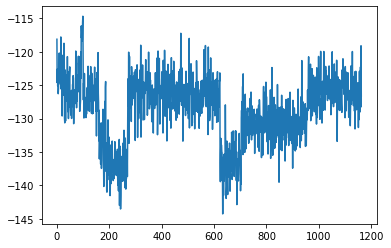

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1163, reward = -128.055420


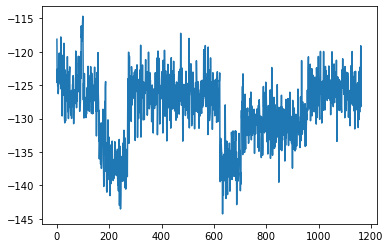

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1164, reward = -131.211136


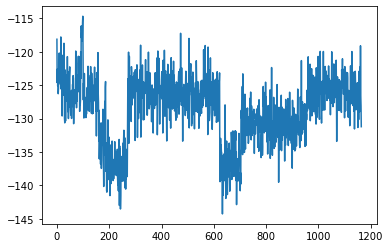

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1165, reward = -119.898270


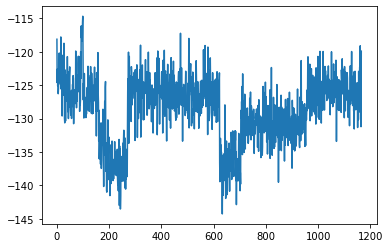

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1166, reward = -124.687859


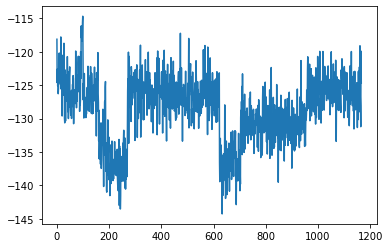

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1167, reward = -125.738846


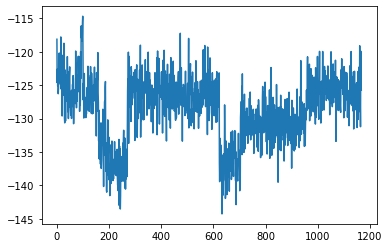

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1168, reward = -128.542068


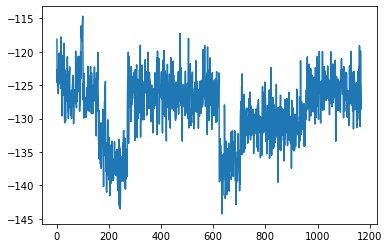

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1169, reward = -124.515976


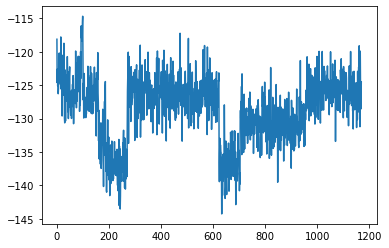

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1170, reward = -126.353554


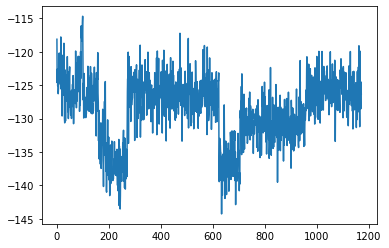

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1171, reward = -126.486153


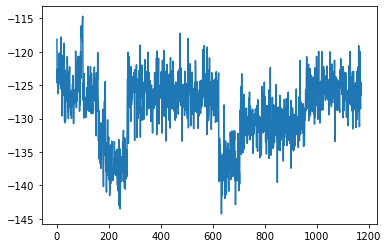

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1172, reward = -129.241974


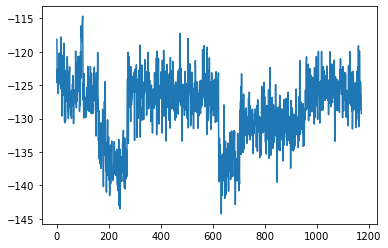

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1173, reward = -123.726601


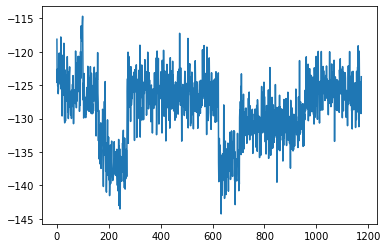

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1174, reward = -129.579239


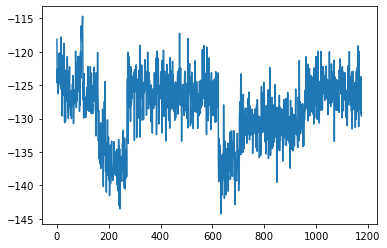

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1175, reward = -123.672173


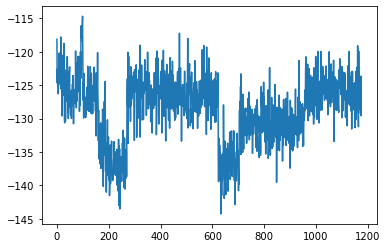

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1176, reward = -126.794731


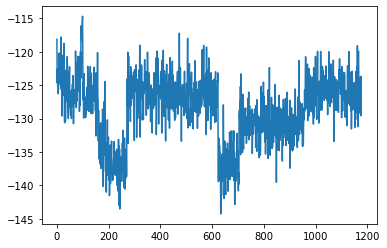

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1177, reward = -125.007652


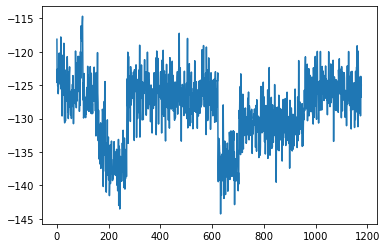

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1178, reward = -127.087440


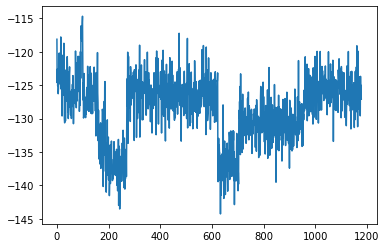

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1179, reward = -124.855888


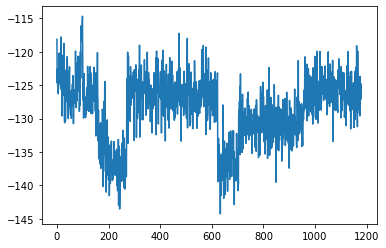

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1180, reward = -120.521111


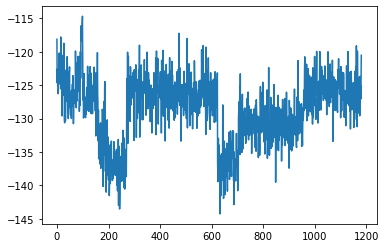

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1181, reward = -127.007202


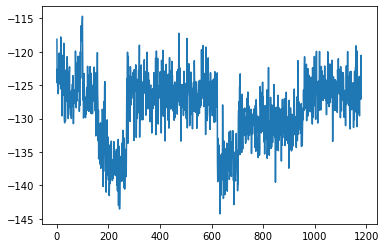

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1182, reward = -124.481430


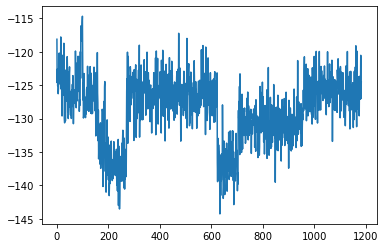

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1183, reward = -125.720428


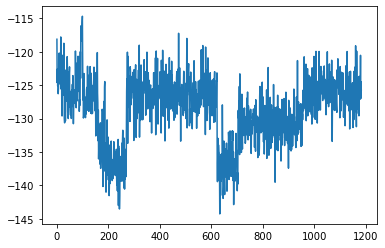

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1184, reward = -132.705963


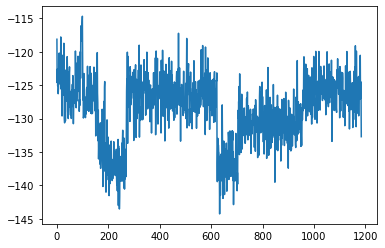

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1185, reward = -136.848190


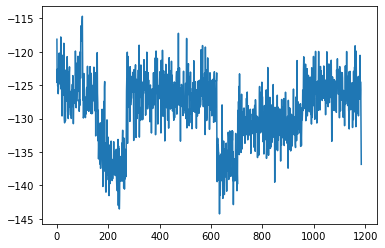

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1186, reward = -129.576614


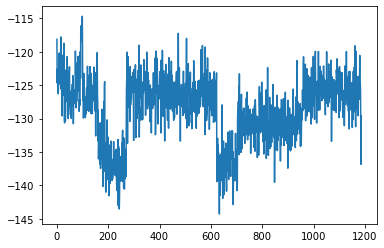

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1187, reward = -131.190506


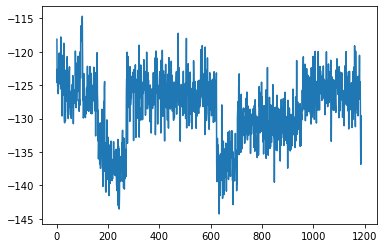

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1188, reward = -133.595139


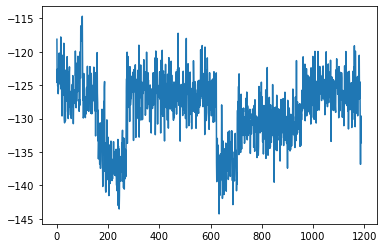

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1189, reward = -130.697266


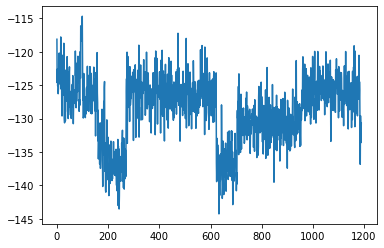

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1190, reward = -135.674545


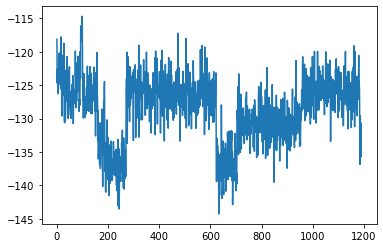

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1191, reward = -132.965164


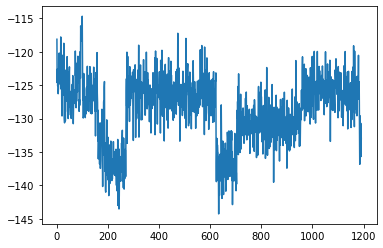

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1192, reward = -136.527603


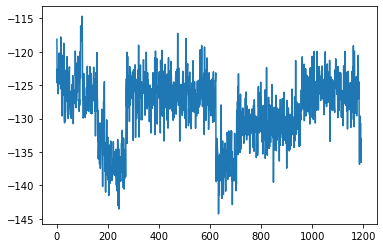

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1193, reward = -129.525681


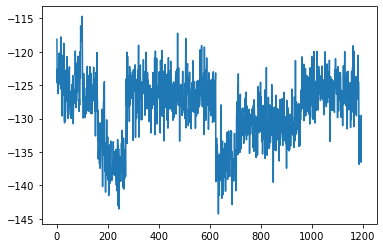

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1194, reward = -130.121902


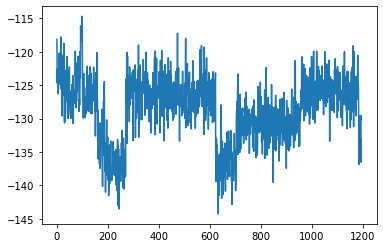

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1195, reward = -131.943756


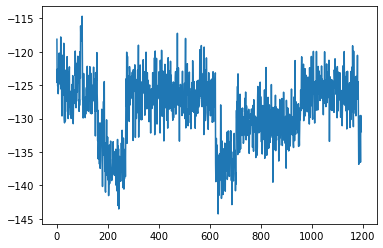

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1196, reward = -137.689438


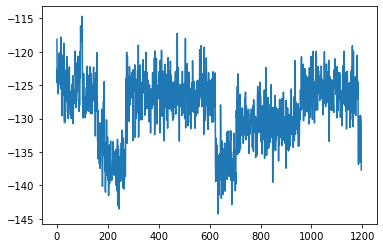

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1197, reward = -133.043396


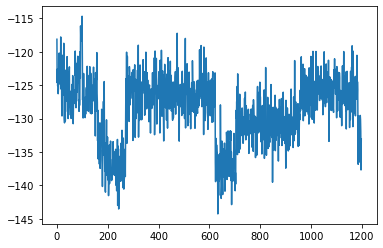

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1198, reward = -134.740067


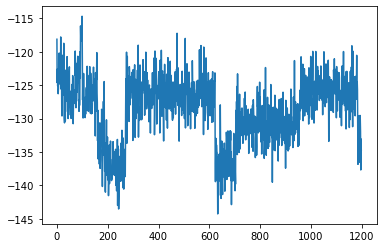

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1199, reward = -134.597763


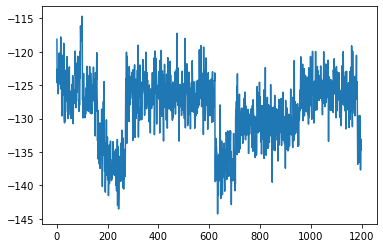

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1200, reward = -132.609528


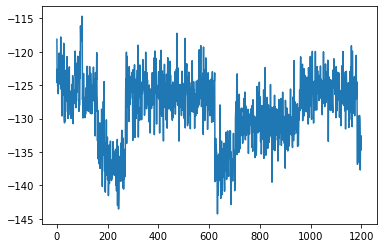

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1201, reward = -129.855621


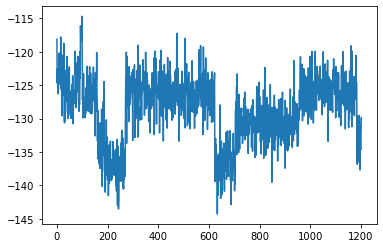

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1202, reward = -130.518372


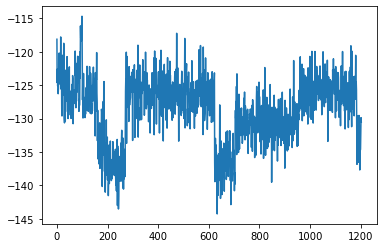

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1203, reward = -130.848999


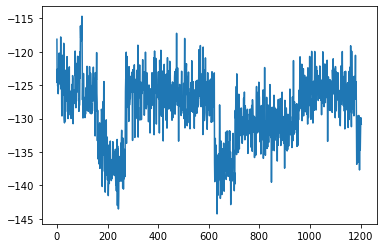

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1204, reward = -130.869354


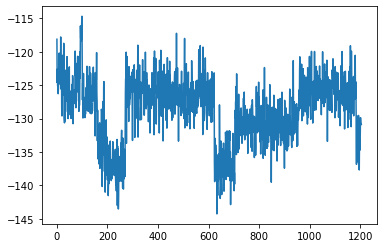

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1205, reward = -132.070053


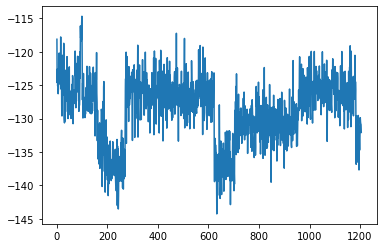

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1206, reward = -135.550018


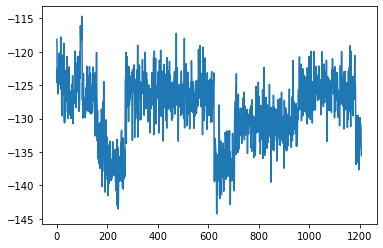

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1207, reward = -129.710449


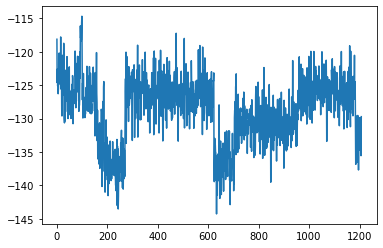

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1208, reward = -130.853226


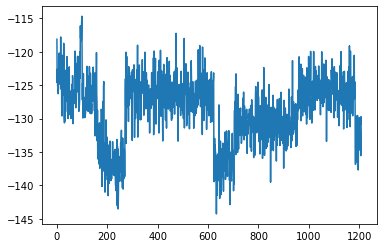

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1209, reward = -133.782944


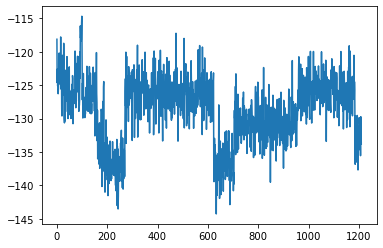

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1210, reward = -130.605270


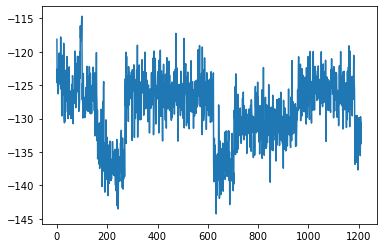

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1211, reward = -132.202667


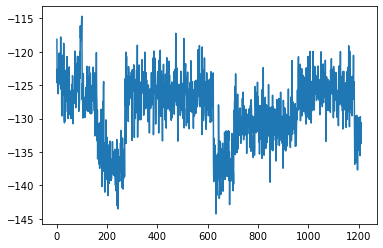

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1212, reward = -132.287048


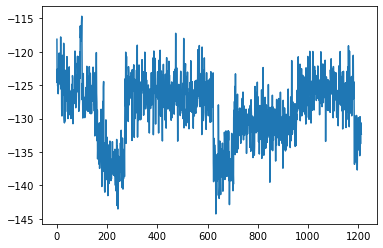

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1213, reward = -135.610703


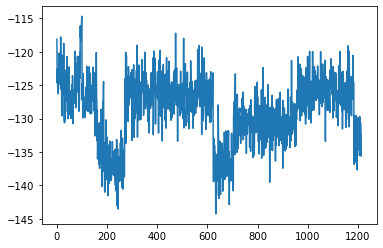

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1214, reward = -129.506287


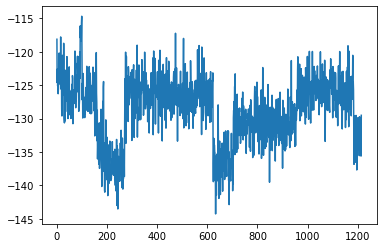

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1215, reward = -136.801926


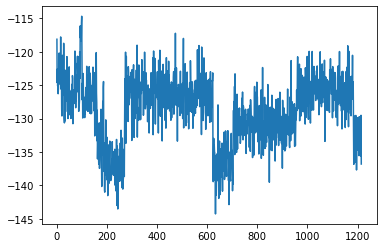

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1216, reward = -136.192291


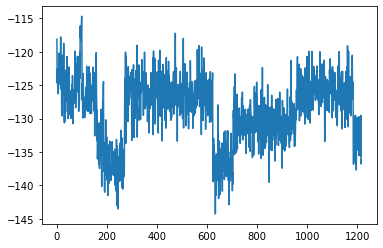

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1217, reward = -132.483963


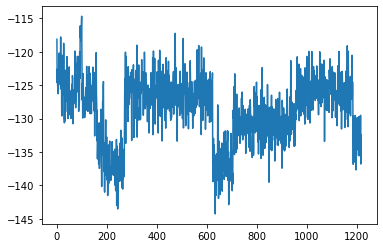

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1218, reward = -133.023270


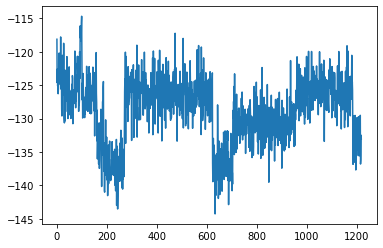

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1219, reward = -131.148026


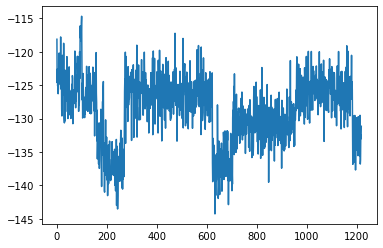

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1220, reward = -130.046158


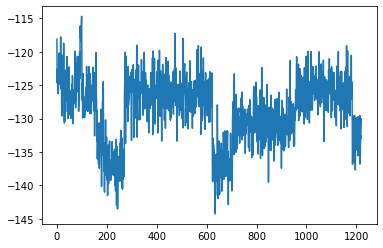

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1221, reward = -132.344528


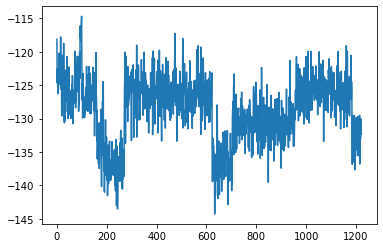

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1222, reward = -129.898819


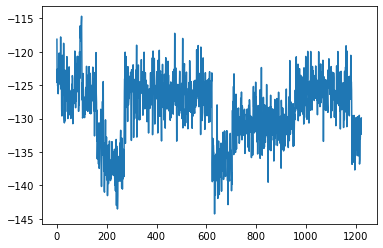

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1223, reward = -133.958084


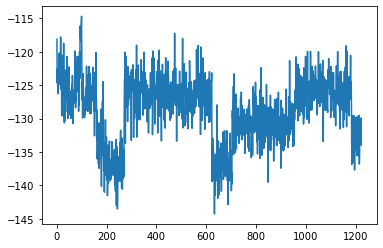

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1224, reward = -135.333420


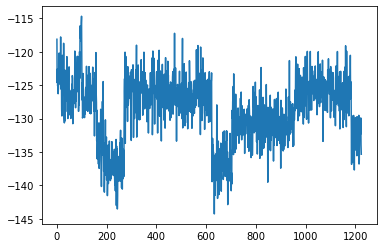

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1225, reward = -131.363480


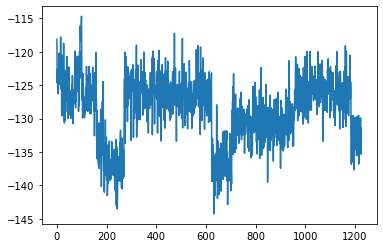

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1226, reward = -136.237228


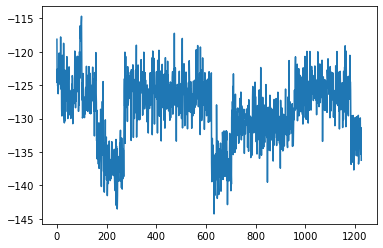

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1227, reward = -131.394333


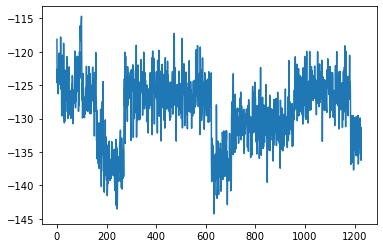

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1228, reward = -134.324615


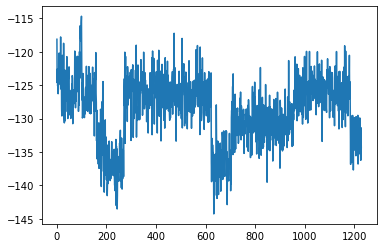

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1229, reward = -135.401901


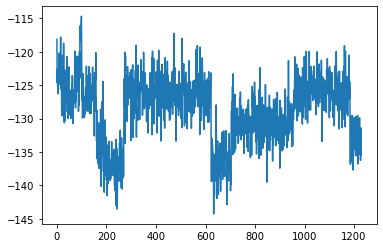

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1230, reward = -135.051895


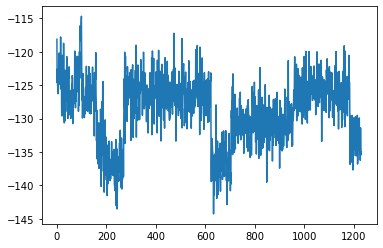

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1231, reward = -131.676392


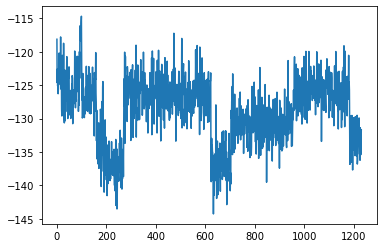

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1232, reward = -136.242325


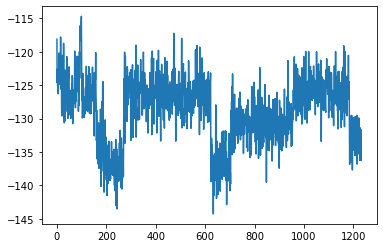

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1233, reward = -131.745285


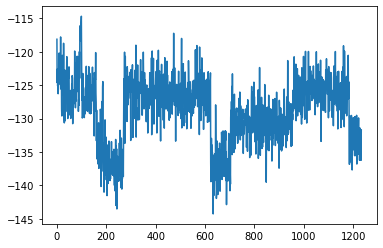

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1234, reward = -130.779068


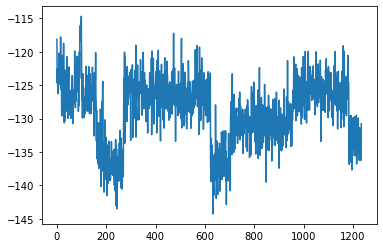

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1235, reward = -133.289871


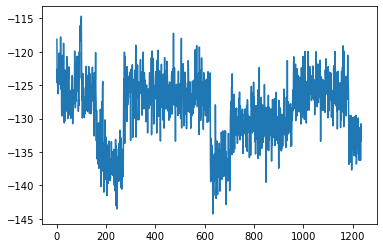

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1236, reward = -133.684036


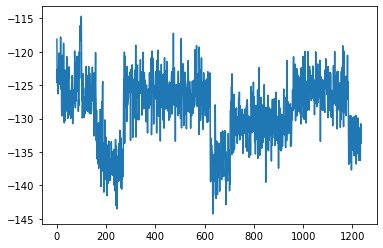

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1237, reward = -131.395401


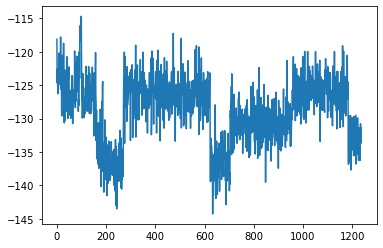

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1238, reward = -131.987900


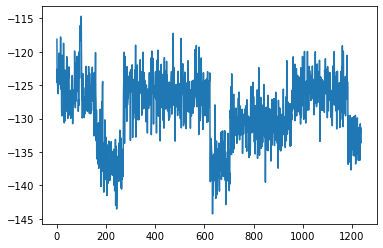

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1239, reward = -130.279068


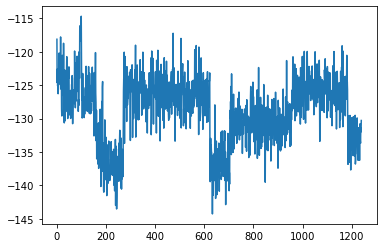

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1240, reward = -129.312958


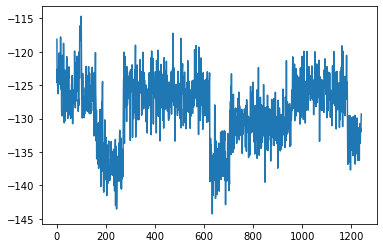

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1241, reward = -132.322968


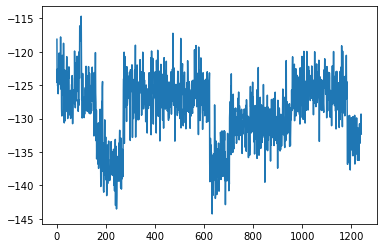

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1242, reward = -134.574875


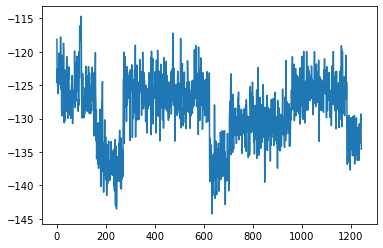

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1243, reward = -131.550339


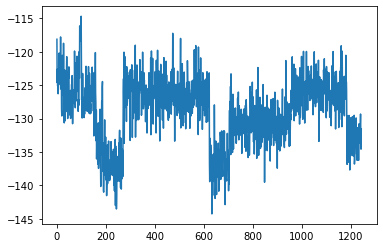

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1244, reward = -134.874741


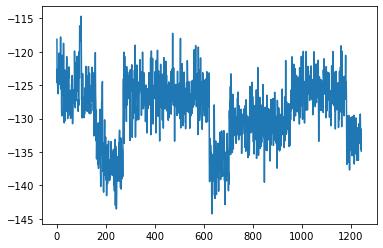

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1245, reward = -134.206253


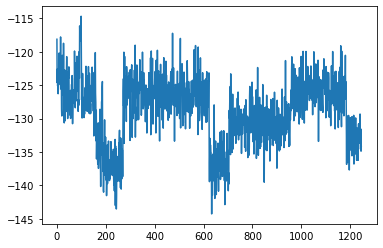

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1246, reward = -126.505089


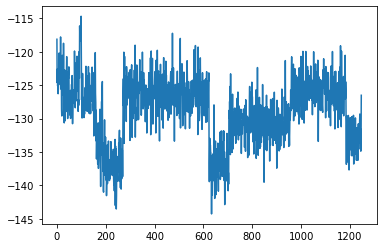

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1247, reward = -135.323120


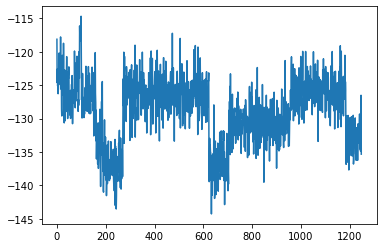

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1248, reward = -134.077087


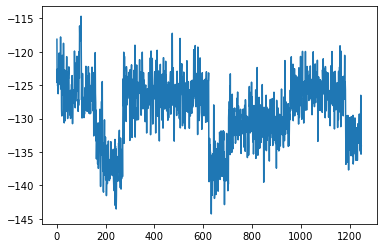

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1249, reward = -129.296539


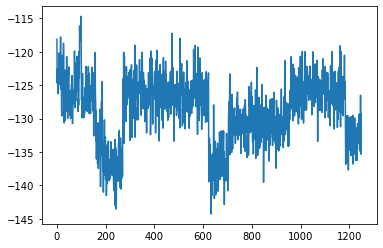

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1250, reward = -135.137924


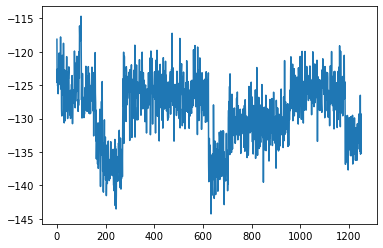

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1251, reward = -133.886505


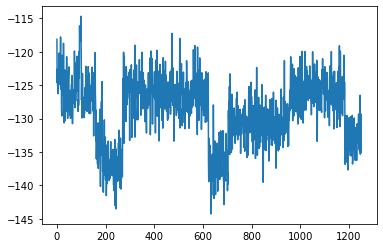

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1252, reward = -133.287445


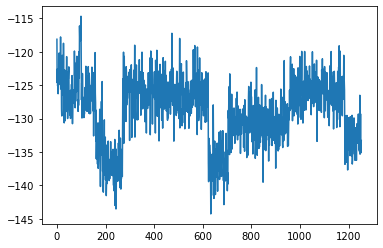

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1253, reward = -133.561584


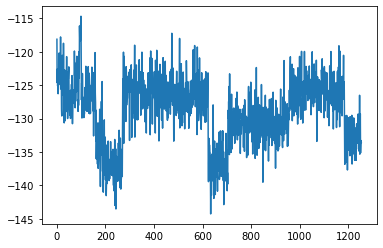

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1254, reward = -131.513382


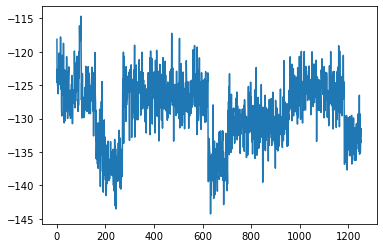

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1255, reward = -133.370621


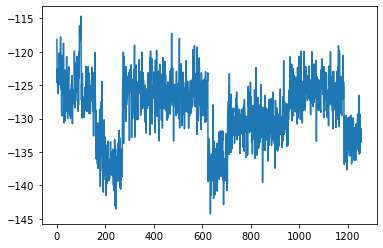

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1256, reward = -132.243927


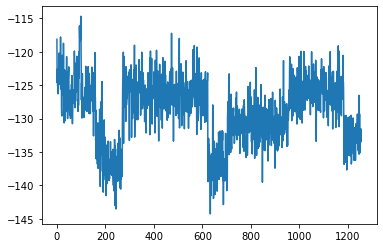

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1257, reward = -138.144348


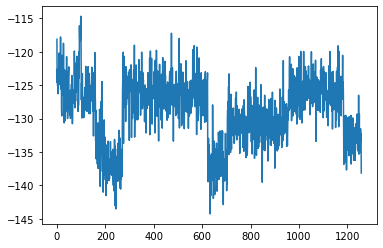

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1258, reward = -133.806870


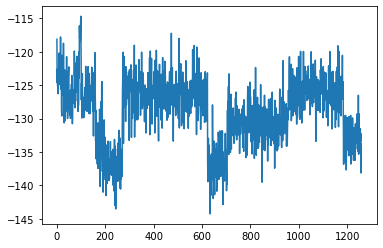

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1259, reward = -132.530792


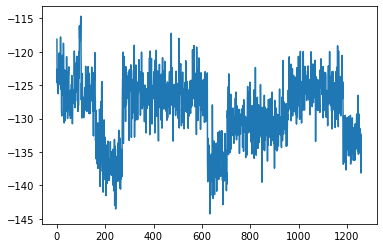

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1260, reward = -132.795685


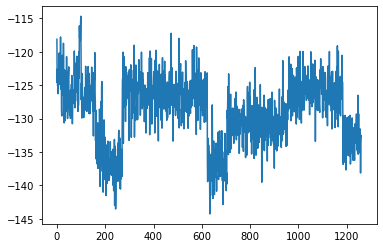

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1261, reward = -135.050827


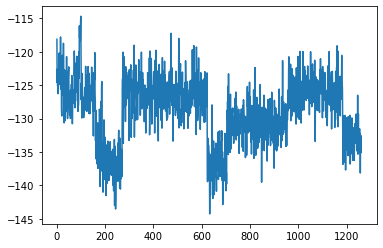

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1262, reward = -136.273987


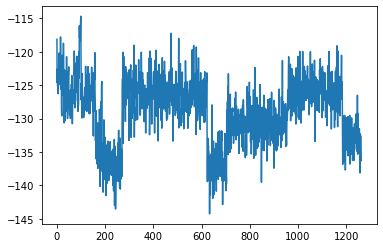

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1263, reward = -132.628143


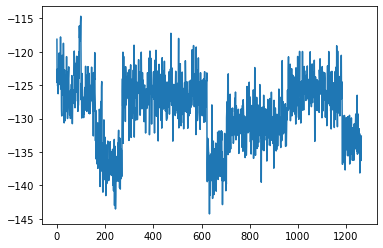

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1264, reward = -132.154984


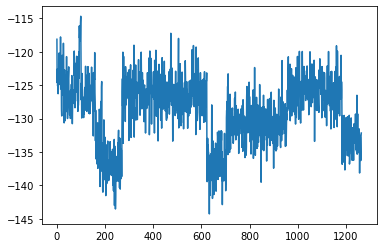

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1265, reward = -134.071457


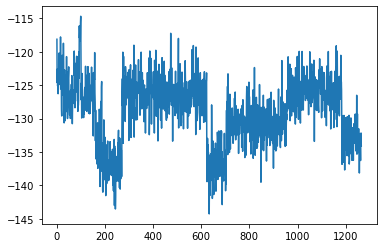

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1266, reward = -134.266739


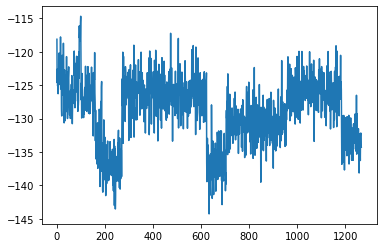

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1267, reward = -127.577843


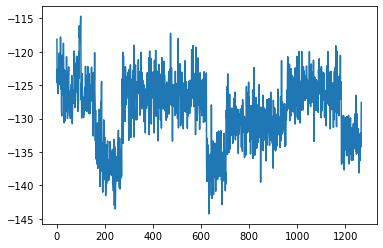

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1268, reward = -133.542816


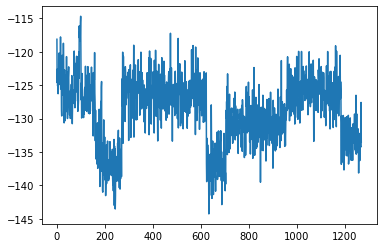

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1269, reward = -133.699570


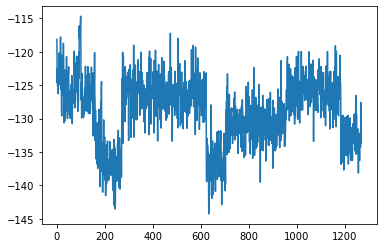

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1270, reward = -129.232224


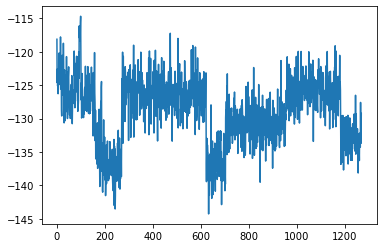

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1271, reward = -132.280975


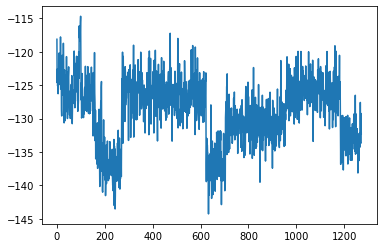

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1272, reward = -135.146790


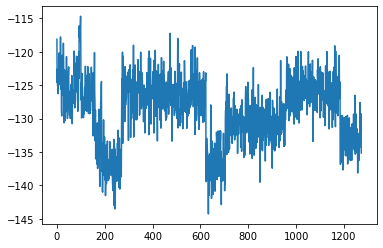

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1273, reward = -131.341965


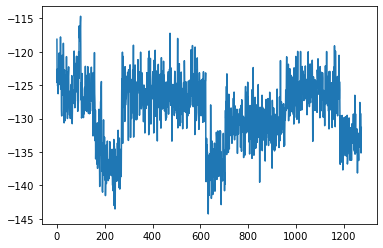

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1274, reward = -132.998398


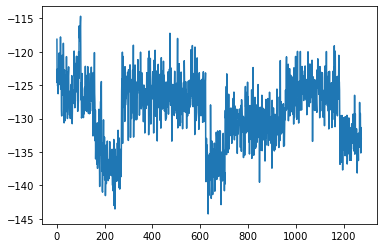

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1275, reward = -131.411118


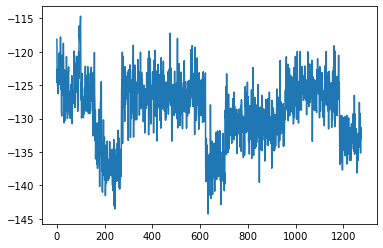

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1276, reward = -133.620331


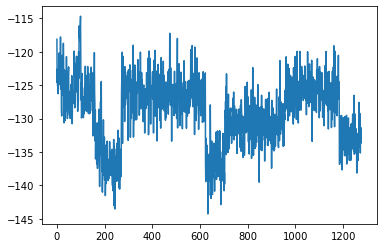

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1277, reward = -132.555801


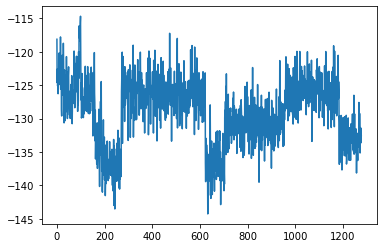

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1278, reward = -133.208420


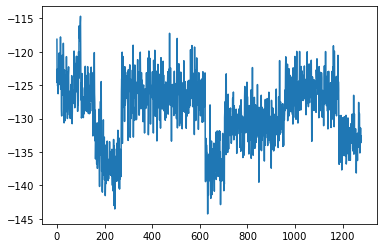

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1279, reward = -132.714767


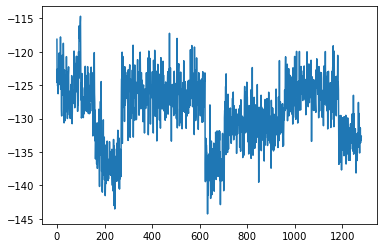

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1280, reward = -136.437897


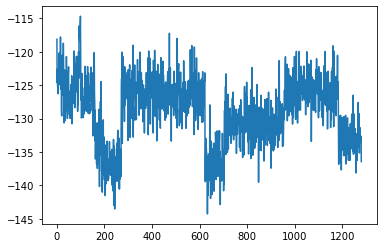

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1281, reward = -138.598557


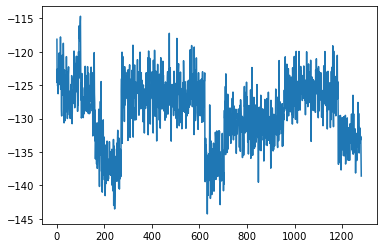

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1282, reward = -141.247589


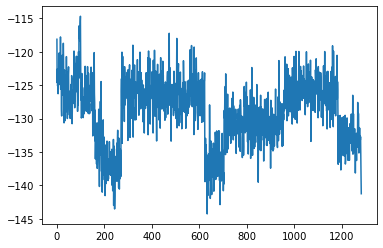

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1283, reward = -139.740463


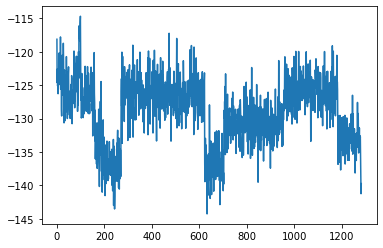

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1284, reward = -137.919220


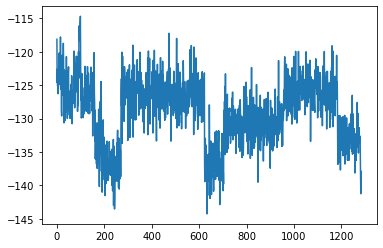

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1285, reward = -134.106155


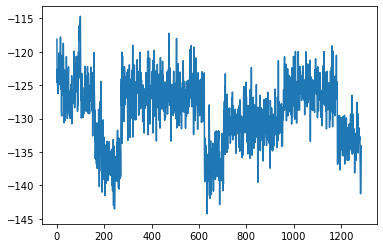

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1286, reward = -132.251480


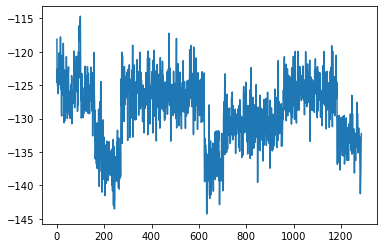

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1287, reward = -138.775131


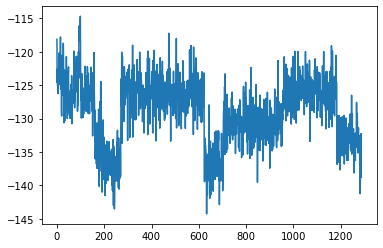

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1288, reward = -135.656769


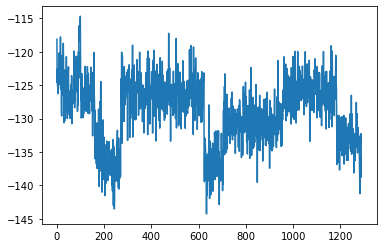

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1289, reward = -137.720764


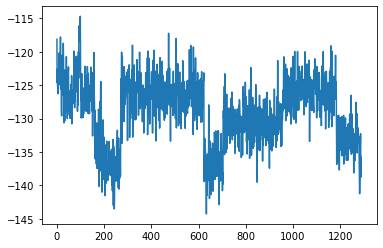

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1290, reward = -134.260757


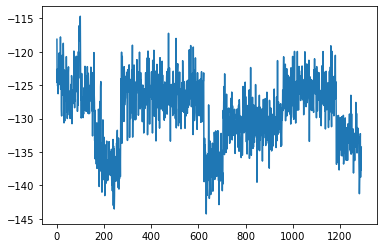

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1291, reward = -133.646454


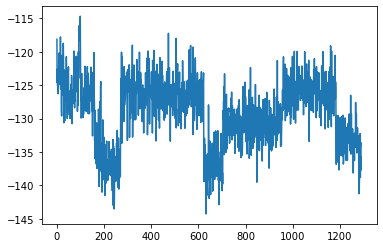

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1292, reward = -137.596039


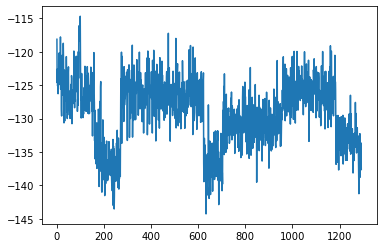

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1293, reward = -141.316879


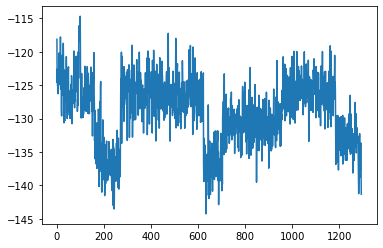

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1294, reward = -137.889282


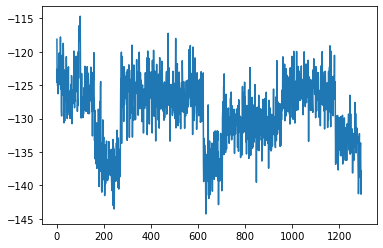

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1295, reward = -139.388504


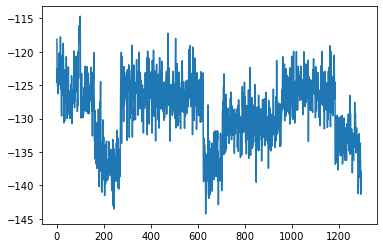

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1296, reward = -137.546539


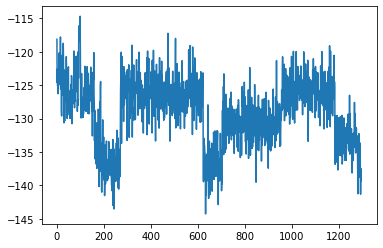

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1297, reward = -136.576065


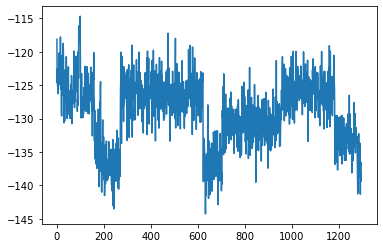

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1298, reward = -138.804886


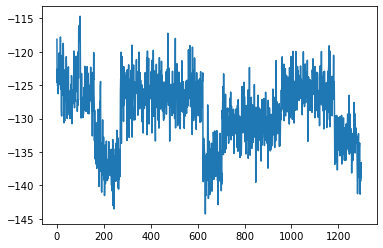

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 1299, reward = -132.649673


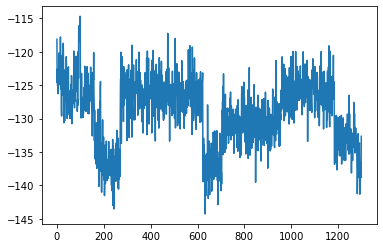

<ipython-input-11-404f78027d79>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


KeyboardInterrupt: 

In [15]:

for i_episode in range(n_episode):
    obs = env.reset()
    obs = np.stack(obs)
    if isinstance(obs, np.ndarray):
        obs = th.from_numpy(obs).float()
    total_reward = 0.0
    rr = np.zeros((n_agents,))

    done = False
    while not done:
        obs = obs.type(FloatTensor)
        action = maddpg.select_action(obs) # .data.cpu()
        aa = action.tolist()
        a = []
        # for i in aa:
        #     a.append(i.index(max(i)))
        #     # print(a)
        for i in aa:
            ssum = sum(i)
            i = [(p / ssum) for p in i]
            a.append(np.random.choice(np.arange(0, 8), p=i))
        obs_, reward, done, _ = env.step(a)
        
        reward = th.FloatTensor(reward).type(FloatTensor)
        obs_ = np.stack(obs_)
        obs_ = th.from_numpy(obs_).float()
        next_obs = obs_
        
        # total_reward += reward.sum()
        total_reward += reward[0]
        rr += reward.cpu().numpy()
        maddpg.memory.push(obs.data, action, next_obs, reward)
        obs = next_obs

        c_loss, a_loss = maddpg.update_policy()

    maddpg.episode_done += 1
    print('Episode: %d, reward = %f' % (i_episode, total_reward))
    reward_record.append(total_reward)
    
    plt.plot(np.arange(i_episode + 1), reward_record)
    plt.show()

    if maddpg.episode_done == maddpg.episodes_before_train:
        print('training now begins...')
        print('MADDPG on Network Balancing\n' +
              'scale_reward=%f\n' % scale_reward +
              'agent=%d' % n_agents +
              ' \nlr=0.001, 0.0001, sensor_range=0.3\n' +
              'servers=%d' % (num_servers))

    if i_episode % 10 == 1:
        th.save({
            'epoch': i_episode,
            'acotr_state_dict': [[maddpg.actors[i].state_dict()] for i in range(len(maddpg.actors))],
            'critic_state_dict': [[maddpg.critics[i].state_dict()] for i in range(len(maddpg.critics))],
            'acotr_target_state_dict': [[maddpg.actors_target[i].state_dict()] for i in range(len(maddpg.actors))],
            'critic_target_state_dict': [[maddpg.critics_target[i].state_dict()] for i in range(len(maddpg.critics))],
            'actor_optimizer_state_dict': [[maddpg.actor_optimizer[i].state_dict()] for i in range(len(maddpg.actor_optimizer))],
            'critic_optimizer_state_dict': [[maddpg.critic_optimizer[i].state_dict()] for i in range(len(maddpg.critic_optimizer))],
            }, PATH)
# env.close()

In [ ]:
    plt.plot(range(len(reward_record)),reward_record)
    plt.show()